<a href="https://colab.research.google.com/github/grecalde17gh/Tesis-IA---Portafolio-de-inversiones/blob/main/Portafolio_de_inversiones_vf.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Proyecto FINAL | Gustavo Recalde**

# **Portafolio de inversiones con modelos de Inteligencia Artificial**


# **INTRODUCCIÓN**

Este proyecto tiene como objetivo principal optimizar un portafolio de inversión utilizando redes neuronales LSTM y técnicas de Procesamiento de Lenguaje Natural (PLN). Se enfoca en combinar datos financieros históricos, análisis técnico (como medias móviles) y análisis de sentimientos extraídos de noticias relacionadas con el mercado.

## Tipos de datos utilizados:
1. **Datos financieros**: Precios históricos de acciones descargados desde Yahoo Finance.
2. **Indicadores técnicos**: Medias móviles calculadas para diferentes ventanas temporales (10, 30 y 60 días).
3. **Análisis de sentimientos**: Sentimientos derivados de noticias sobre las empresas.

## Resultados esperados:
- Predicción precisa de los precios de las acciones utilizando modelos LSTM.
- Optimización del portafolio basado en el Ratio de Sharpe, maximizando la relación entre retorno y riesgo.
- Evaluación de cómo el análisis de sentimientos impacta en la predicción y optimización.


## **Dependencias y Librerías**

Este proyecto utiliza varias librerías clave. A continuación, se describe su propósito:

- **pytorch-lightning**: Simplifica la implementación y entrenamiento de modelos LSTM, reduciendo la necesidad de codificación manual de las fases de entrenamiento.
- **vaderSentiment**: Realiza análisis de sentimientos en textos, optimizado para texto corto e informal.
- **yfinance**: Extrae datos históricos de precios de acciones directamente desde Yahoo Finance.
- **numpy y pandas**: Para la manipulación y análisis de datos.
- **matplotlib**: Para la visualización de datos y resultados.
- **scipy.optimize**: Realiza optimización matemática, útil para la construcción del portafolio.
- **transformers**: Biblioteca para modelos de PLN avanzados (por ejemplo, análisis de texto).

Estas dependencias son instaladas automáticamente al ejecutar la celda correspondiente.

## Configuración Inicial

La reproducibilidad es un aspecto clave en proyectos de aprendizaje profundo. Configurar una semilla fija asegura que los resultados del modelo puedan ser replicados en futuras ejecuciones, independientemente de la aleatoriedad inherente al entrenamiento.

### Función de las librerías clave:
- **torch**: Biblioteca base para construir y entrenar redes neuronales.
- **pandas y numpy**: Procesamiento y transformación de datos para su ingreso al modelo.
- **scipy.optimize**: Realiza la optimización del portafolio basado en métricas de rendimiento financiero.



In [1]:
!pip install pytorch-lightning
!pip install vaderSentiment
!pip install praw
!pip install asyncpraw
!pip install requests beautifulsoup4 lxml transformers
!pip install torch transformers tokenizers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 22.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.3/189.3 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 4.0 MB/s eta 0:00:00


### Librerias

In [2]:
# Importar librerías y configurar la semilla
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import yfinance as yf
import torch
import torch.nn as nn
import pytorch_lightning as pl
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.optimize import minimize
import os

# Configuración de la semilla para reproducibilidad
np.random.seed(4)
torch.manual_seed(4)


# **Visualizacon y comportamiento historico de algunas acciones**

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados.
Datos para MSFT descargados.
Datos para NVDA descargados.
Datos para AVGO descargados.


[*********************100%***********************]  1 of 1 completed


Datos para ORCL descargados.
Datos para AMD descargados.


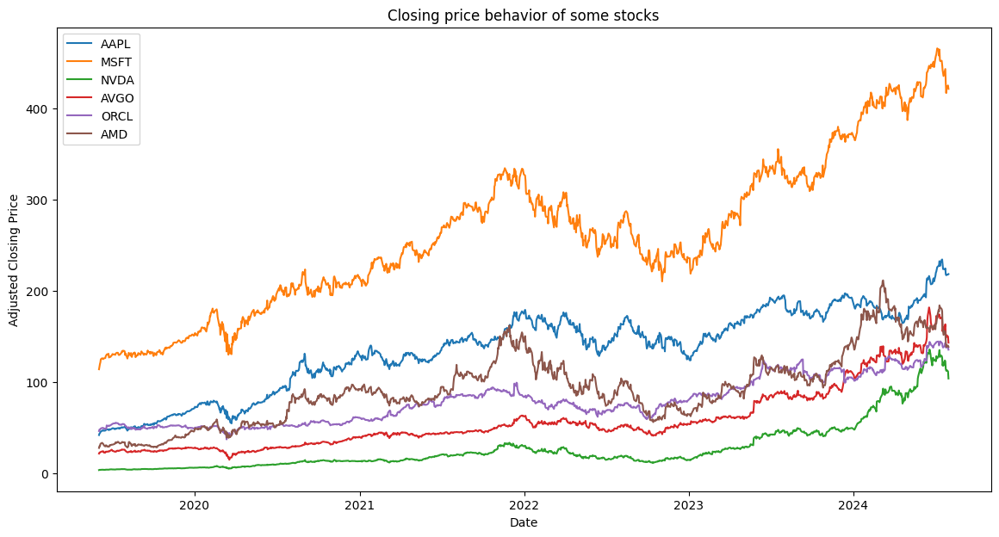

In [ ]:
import matplotlib.pyplot as plt
import yfinance as yf

# Lista de tickers
tickers0 = ['AAPL', 'MSFT', 'NVDA', 'AVGO', 'ORCL', 'AMD']

# Descargar datos de Yahoo Finance para cada ticker
def download_stock_data0(ticker):
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    data.dropna(inplace=True)  # Eliminar filas con valores NaN debido al cálculo de medias móviles
    return data

# Descargar y almacenar datos para cada ticker
stock_data0 = {}
for ticker in tickers0:
    stock_data0[ticker] = download_stock_data0(ticker)
    print(f"Datos para {ticker} descargados.")

# Graficar el comportamiento del precio de cierre ajustado de todas las acciones
plt.figure(figsize=(14, 7))
for ticker in tickers0:
    plt.plot(stock_data0[ticker].index, stock_data0[ticker]['Adj Close'], label=ticker)
plt.xlabel('Date')
plt.ylabel('Adjusted Closing Price')
plt.title('Closing price behavior of some stocks')
plt.legend()

# Guardar el gráfico en formato SVG
plt.savefig("stock_prices.svg", format="svg")

# Mostrar el gráfico
plt.show()

## **Recolección y Procesamiento de Datos**

1. **Selección de Tickers**: Se seleccionaron múltiples tickers de empresas tecnológicas de alto impacto en el mercado. Esto asegura un portafolio diversificado.
2. **Medias Móviles**:
   - **MA_10**: Media móvil de 10 días.
   - **MA_30**: Media móvil de 30 días.
   - **MA_60**: Media móvil de 60 días.
   Estas medias ayudan a suavizar las fluctuaciones diarias del precio, revelando tendencias a corto, mediano y largo plazo.
3. **Eliminación de datos faltantes (`dropna`)**: Es necesario para evitar inconsistencias durante el entrenamiento del modelo.


In [35]:
import matplotlib.pyplot as plt
import yfinance as yf

# Lista de tickers
tickers = [
    'AAPL', 'MSFT', 'NVDA', 'AVGO', 'ORCL', 'AMD', 'CSCO', 'ACN', 'ADBE',
    'TXN', 'IBM', 'QCOM', 'INTU', 'AMAT', 'MU', 'LRCX', 'NOW', 'PANW', 'SNPS',
    'CDNS', 'ANET', 'FTNT', 'KLAC', 'APH', 'TEL', 'MCHP', 'NXPI', 'ON', 'MPWR',
    'ADI', 'KEYS', 'CDW', 'ANSS', 'PAYC', 'GDDY', 'TYL', 'SSNC','JKHY', 'EPAM',
    'GLW', 'HPQ', 'DXC', 'IT', 'LDOS', 'AKAM', 'NTAP', 'VRSN', 'FFIV', 'XRX',
    'JNPR', 'CSGP', 'TRMB', 'GRMN', 'ZBRA', 'BR','VRSN', 'PTC', 'CTSH', 'HPE',
    'JNPR', 'MSI', 'TDY', 'WDC', 'STX'
]

# Descargar datos de Yahoo Finance para cada ticker
def download_stock_data(ticker):
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    data['MA_10'] = data['Adj Close'].rolling(window=10).mean()
    data['MA_30'] = data['Adj Close'].rolling(window=30).mean()
    data['MA_60'] = data['Adj Close'].rolling(window=60).mean()
    data.dropna(inplace=True)  # Eliminar filas con valores NaN debido al cálculo de medias móviles
    return data

# Descargar y almacenar datos para cada ticker
stock_data = {}
for ticker in tickers:
    stock_data[ticker] = download_stock_data(ticker)
    print(f"Datos para {ticker} descargados.")

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados.
Datos para MSFT descargados.
Datos para NVDA descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AVGO descargados.
Datos para ORCL descargados.
Datos para AMD descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CSCO descargados.
Datos para ACN descargados.
Datos para ADBE descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TXN descargados.
Datos para IBM descargados.
Datos para QCOM descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para INTU descargados.
Datos para AMAT descargados.
Datos para MU descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para LRCX descargados.
Datos para NOW descargados.
Datos para PANW descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para SNPS descargados.
Datos para CDNS descargados.
Datos para ANET descargados.
Datos para FTNT descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para KLAC descargados.
Datos para APH descargados.
Datos para TEL descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MCHP descargados.
Datos para NXPI descargados.
Datos para ON descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MPWR descargados.
Datos para ADI descargados.
Datos para KEYS descargados.
Datos para CDW descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ANSS descargados.
Datos para PAYC descargados.
Datos para GDDY descargados.
Datos para TYL descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para SSNC descargados.
Datos para JKHY descargados.
Datos para EPAM descargados.
Datos para GLW descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para HPQ descargados.
Datos para DXC descargados.
Datos para IT descargados.
Datos para LDOS descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AKAM descargados.
Datos para NTAP descargados.
Datos para VRSN descargados.
Datos para FFIV descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para XRX descargados.
Datos para JNPR descargados.
Datos para CSGP descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TRMB descargados.
Datos para GRMN descargados.
Datos para ZBRA descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para BR descargados.
Datos para VRSN descargados.
Datos para PTC descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CTSH descargados.
Datos para HPE descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para JNPR descargados.
Datos para MSI descargados.
Datos para TDY descargados.



[*********************100%***********************]  1 of 1 completed


Datos para WDC descargados.
Datos para STX descargados.


## Funciones Auxiliares

Se definieron varias funciones auxiliares para soportar el análisis y la visualización:

- **`graficar_predicciones`**: Crea gráficos que comparan los valores reales y predichos de las acciones.
- **Callback de pérdida (`LossLogger`)**: Registra la pérdida en cada época de entrenamiento.
- **`plot_loss`**: Muestra cómo evoluciona la pérdida a lo largo del entrenamiento.

Estas funciones facilitan la evaluación visual de los resultados del modelo.


In [4]:
# Función para graficar las predicciones con fechas en el eje x
def graficar_predicciones(real, prediccion, dates, ticker):
    plt.figure(figsize=(12, 6))
    plt.plot(dates, real, color='red', label='Real value of the share')
    plt.plot(dates[len(dates) - len(prediccion):], prediccion, color='blue', label='Action prediction')
    plt.xlabel('Date')
    plt.ylabel('Share value')
    plt.legend()
    plt.title(f'Predictions for {ticker}')
    plt.xticks(rotation=45)
    plt.show()

# Callback para registrar la pérdida durante el entrenamiento
class LossLogger(pl.Callback):
    def on_train_epoch_end(self, trainer, pl_module):
        logs = trainer.logged_metrics
        epoch = trainer.current_epoch
        loss = logs['train_loss_epoch'].item()
        if not hasattr(self, 'losses'):
            self.losses = []
        self.losses.append((epoch, loss))

# Función para graficar la pérdida durante el entrenamiento
def plot_loss(callback, ticker):
    epochs, losses = zip(*callback.losses)
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, losses, label='Training Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Loss during training for {ticker}')
    plt.legend()
    plt.show()

# Modelo 1: LSTM Usando Solo Datos Financieros

Este modelo utiliza únicamente datos financieros históricos como entrada. La arquitectura del modelo incluye:
- Una capa LSTM que captura patrones temporales en los precios de las acciones.
- Una capa totalmente conectada para generar las predicciones finales.

**Datos de entrada**:
- Precios ajustados diarios y medias móviles.

**Objetivo del modelo**:
- Predecir el precio de cierre ajustado para las acciones seleccionadas.


In [5]:
# Definir el modelo LSTM en PyTorch Lightning

class LSTMModel(pl.LightningModule):
    def __init__(self, input_size=4, hidden_layer_size=100, output_size=1, lr=0.001):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = nn.Linear(hidden_layer_size, output_size)
        self.lr = lr
        self.criterion = nn.MSELoss()

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1])
        return predictions

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('train_loss_epoch', loss, prog_bar=True, on_epoch=True, on_step=False)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)


## Entrenamiento del Modelo

### División de datos:
- **Entrenamiento**: 80% de los datos históricos.
- **Validación**: 20% restante para evaluar el desempeño del modelo.

### Métricas de evaluación:
- **RMSE** (Raíz del error cuadrático medio).
- **MAE** (Error absoluto medio).
- **R²** (Coeficiente de determinación).

Estas métricas cuantifican qué tan bien el modelo predice los precios de las acciones.


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Processing AAPL...


INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainable params
42.5 K    Total params
0.170     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for AAPL.


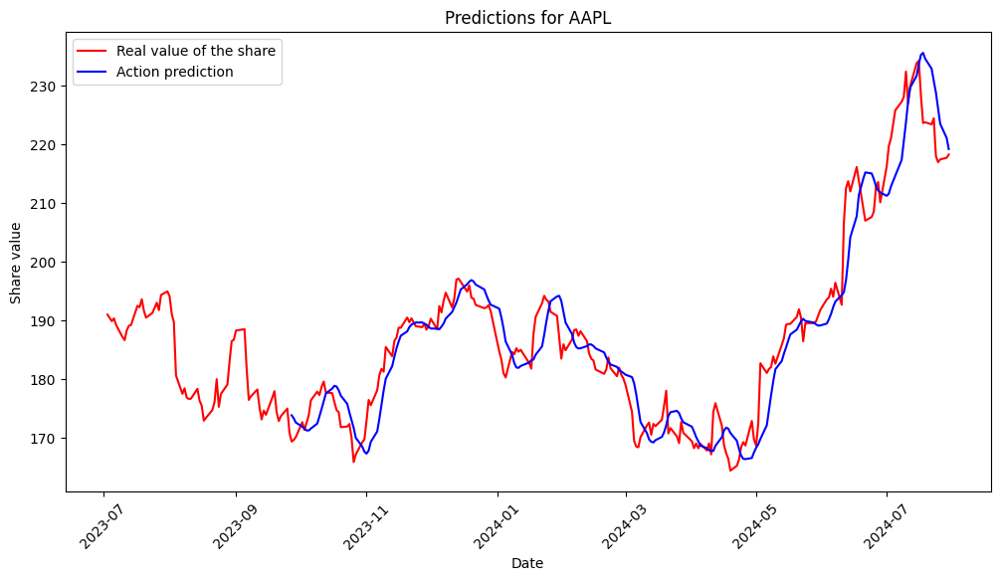

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for AAPL: 22.656641066254586
Normalized Mean Squared Error (Normalized MSE) for AAPL: 0.0006521297765394759
Mean Absolute Error (MAE) for AAPL: 3.702436595720713
R^2 Score for AAPL: 0.9174047449477711
Processing MSFT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for MSFT.


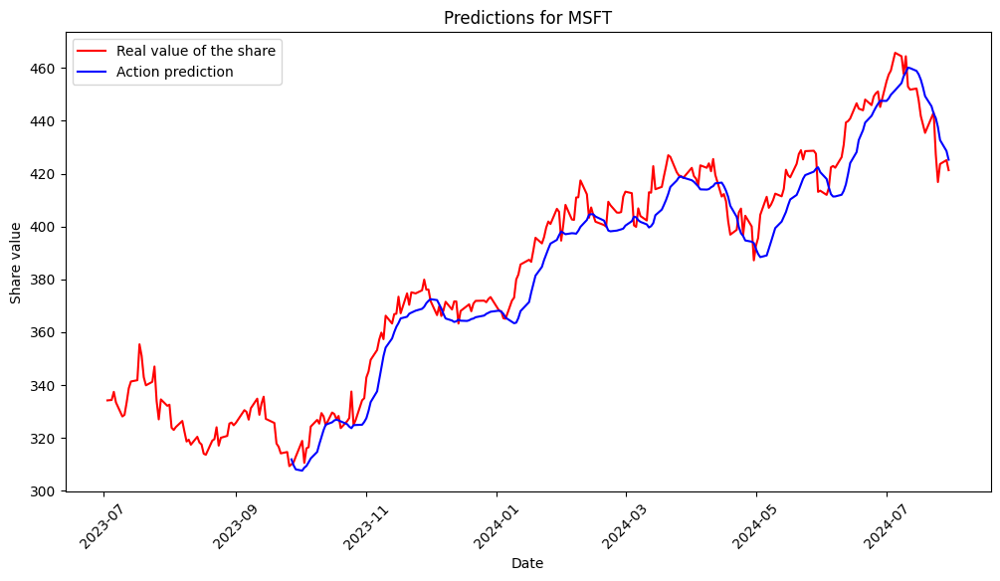

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for MSFT: 88.45982002798091
Normalized Mean Squared Error (Normalized MSE) for MSFT: 0.0006100578358378198
Mean Absolute Error (MAE) for MSFT: 7.873925757305518
R^2 Score for MSFT: 0.9357757175046241
Processing NVDA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for NVDA.


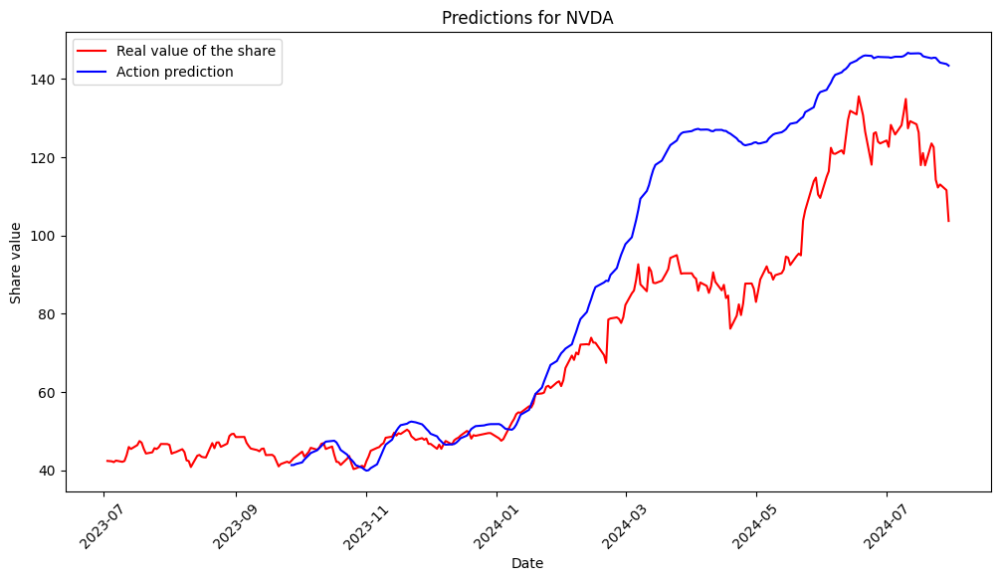

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for NVDA: 455.8090448426984
Normalized Mean Squared Error (Normalized MSE) for NVDA: 0.09181645217542828
Mean Absolute Error (MAE) for NVDA: 15.877178280587406
R^2 Score for NVDA: 0.45406702378055164
Processing AVGO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for AVGO.


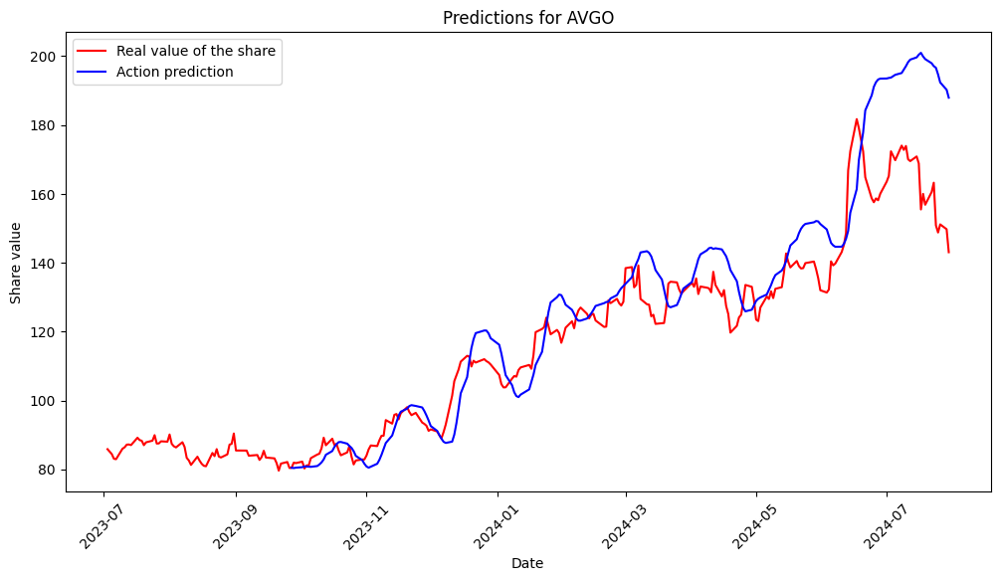

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for AVGO: 200.43127024740255
Normalized Mean Squared Error (Normalized MSE) for AVGO: 0.01541885563972279
Mean Absolute Error (MAE) for AVGO: 9.488338980477618
R^2 Score for AVGO: 0.6877471682651274
Processing ORCL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ORCL.


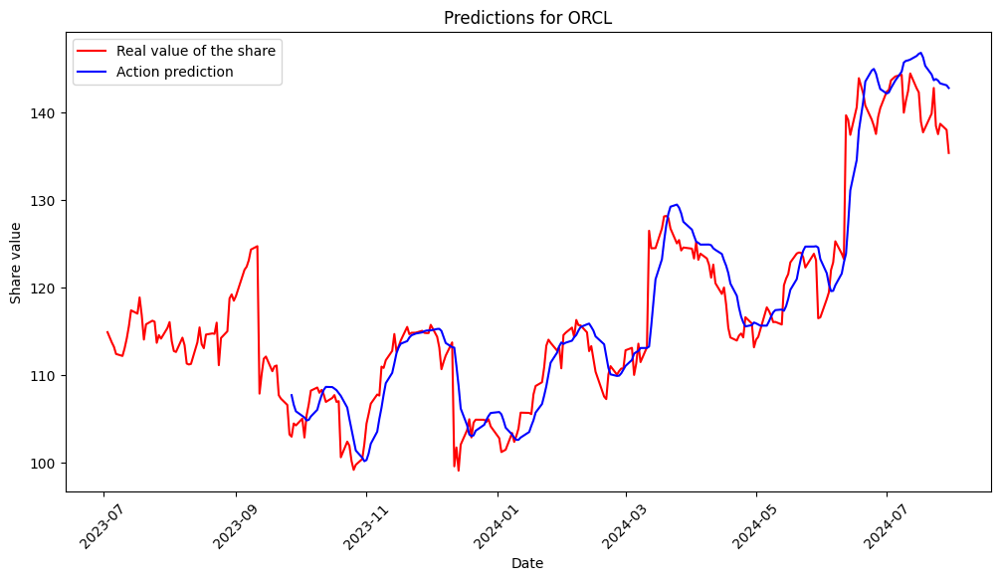

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ORCL: 14.272792570973882
Normalized Mean Squared Error (Normalized MSE) for ORCL: 0.001048060218904569
Mean Absolute Error (MAE) for ORCL: 2.7662168933986617
R^2 Score for ORCL: 0.903110658993764
Processing AMD...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for AMD.


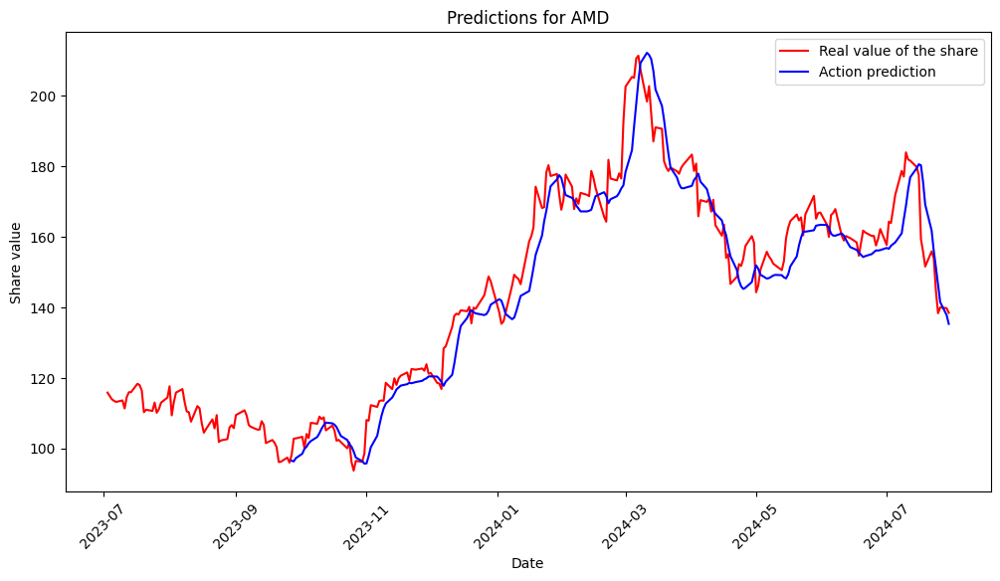

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for AMD: 58.31586903073731
Normalized Mean Squared Error (Normalized MSE) for AMD: 0.0028955762545132425
Mean Absolute Error (MAE) for AMD: 5.981933910723267
R^2 Score for AMD: 0.9241801944506527
Processing CSCO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for CSCO.


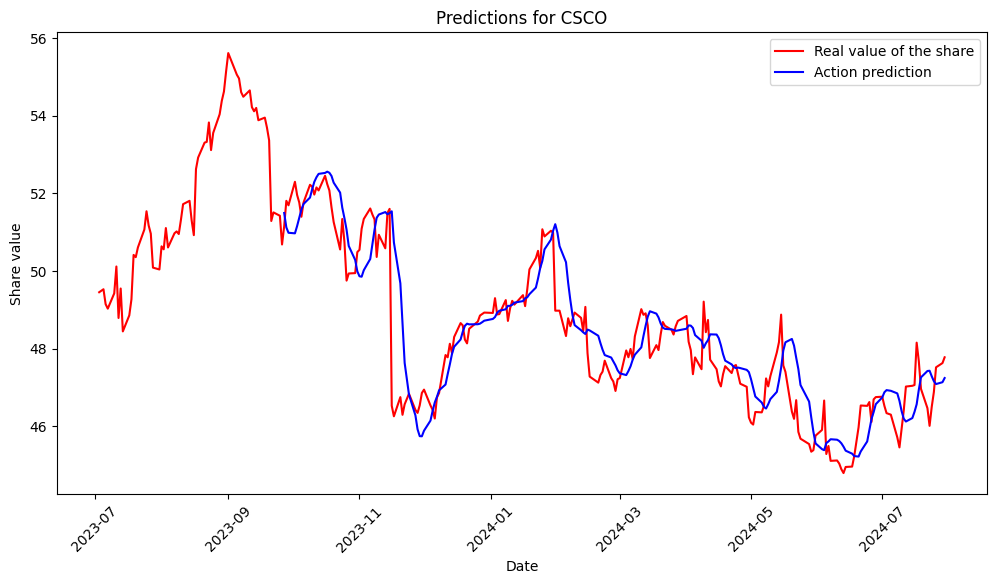

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for CSCO: 0.810715340868224
Normalized Mean Squared Error (Normalized MSE) for CSCO: 0.0003376241975999849
Mean Absolute Error (MAE) for CSCO: 0.6381788413055604
R^2 Score for CSCO: 0.7785184780743688
Processing ACN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ACN.


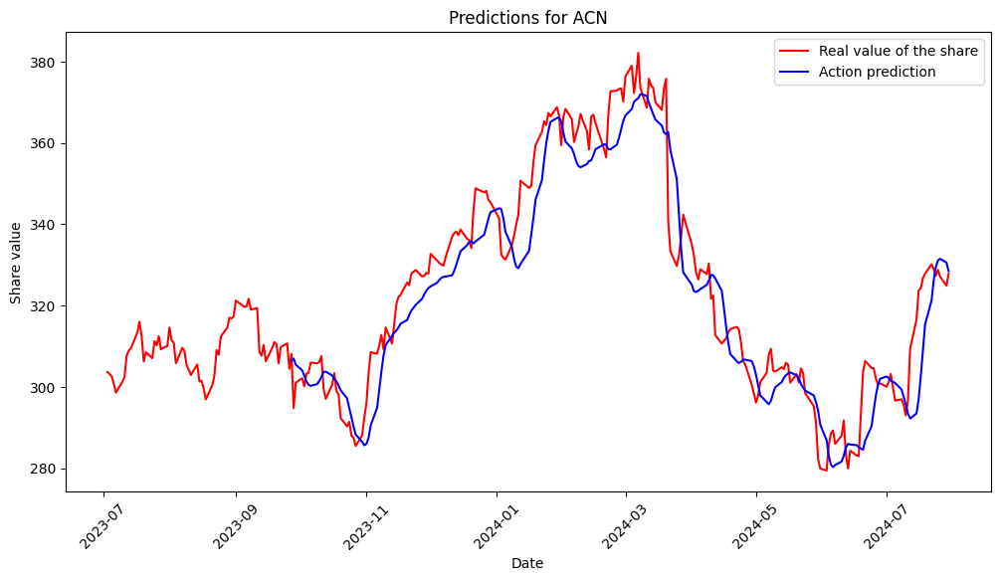

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Mean Squared Error (MSE) for ACN: 73.01737242910073
Normalized Mean Squared Error (Normalized MSE) for ACN: 0.0007066455011245344
Mean Absolute Error (MAE) for ACN: 6.810803452298559
R^2 Score for ACN: 0.9041105368344946
Processing ADBE...


/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainable params
42.5 K    Total params
0.170     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ADBE.


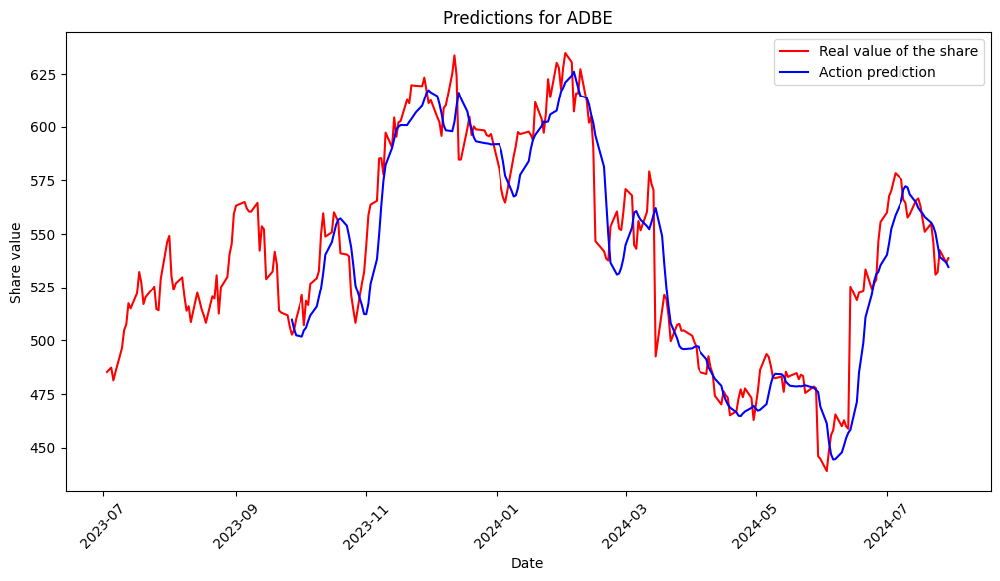

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ADBE: 275.2902926541599
Normalized Mean Squared Error (Normalized MSE) for ADBE: 0.0009414683498517193
Mean Absolute Error (MAE) for ADBE: 12.286936316500794
R^2 Score for ADBE: 0.8973724462583315
Processing TXN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for TXN.


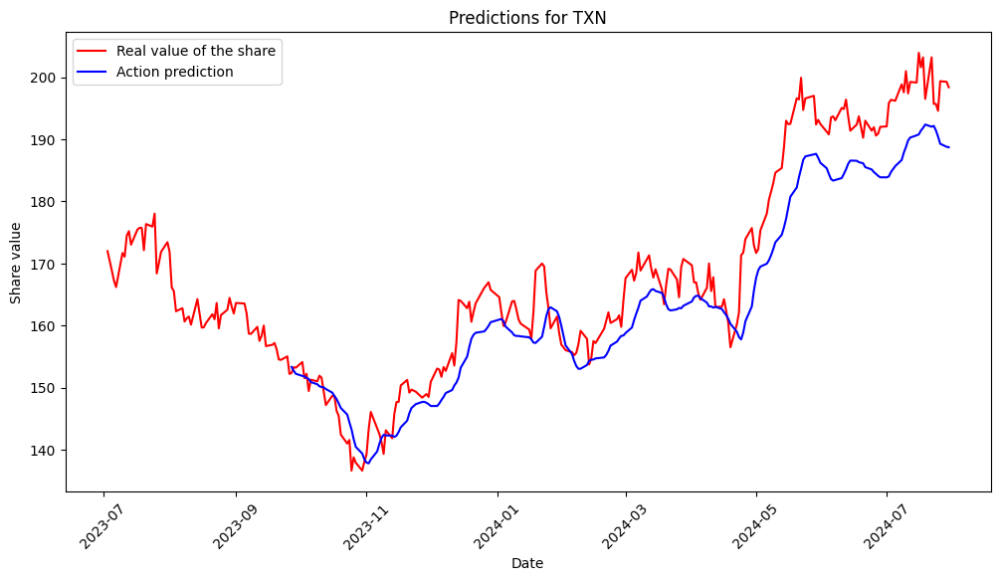

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for TXN: 43.448520480930895
Normalized Mean Squared Error (Normalized MSE) for TXN: 0.001550495667105054
Mean Absolute Error (MAE) for TXN: 5.348876118257041
R^2 Score for TXN: 0.8686516367342686
Processing IBM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for IBM.


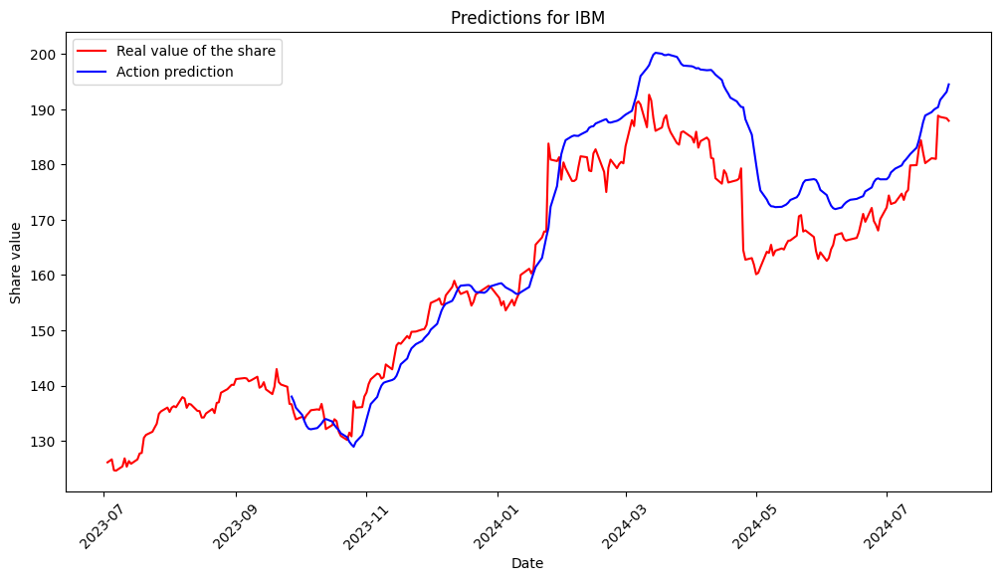

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for IBM: 68.5368602893048
Normalized Mean Squared Error (Normalized MSE) for IBM: 0.0027281136151149354
Mean Absolute Error (MAE) for IBM: 6.506328849221507
R^2 Score for IBM: 0.7603259243611217
Processing QCOM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for QCOM.


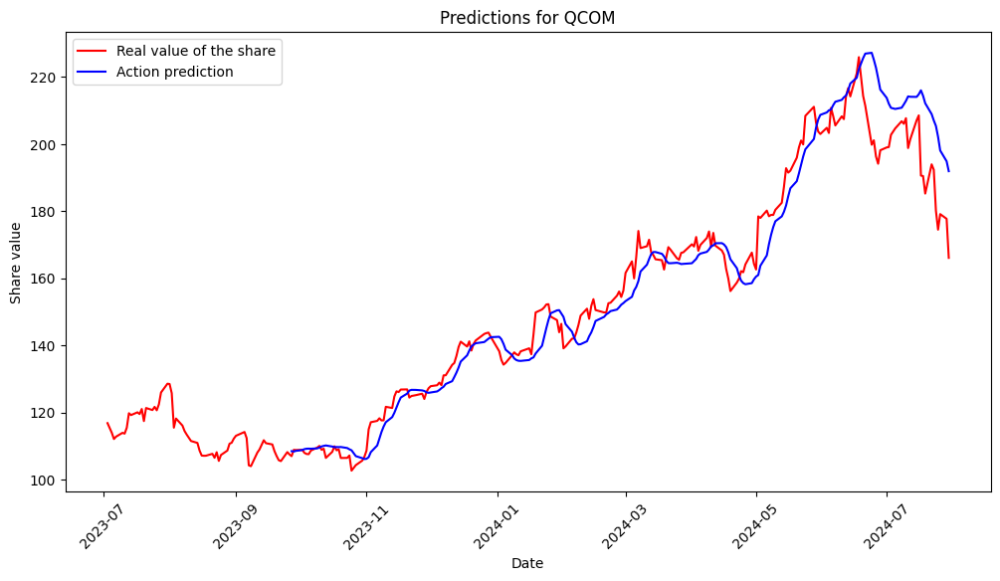

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for QCOM: 68.51213110143487
Normalized Mean Squared Error (Normalized MSE) for QCOM: 0.0031479087953658466
Mean Absolute Error (MAE) for QCOM: 5.742037749869007
R^2 Score for QCOM: 0.9339560388961817
Processing INTU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for INTU.


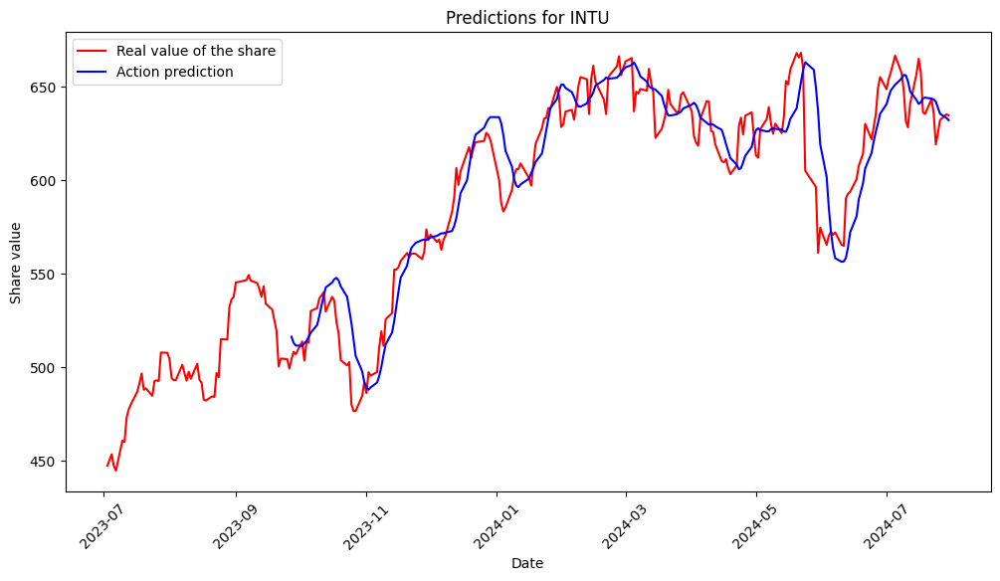

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for INTU: 304.6954076271336
Normalized Mean Squared Error (Normalized MSE) for INTU: 0.0009032195085322886
Mean Absolute Error (MAE) for INTU: 12.801261406776149
R^2 Score for INTU: 0.8771622692878883
Processing AMAT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for AMAT.


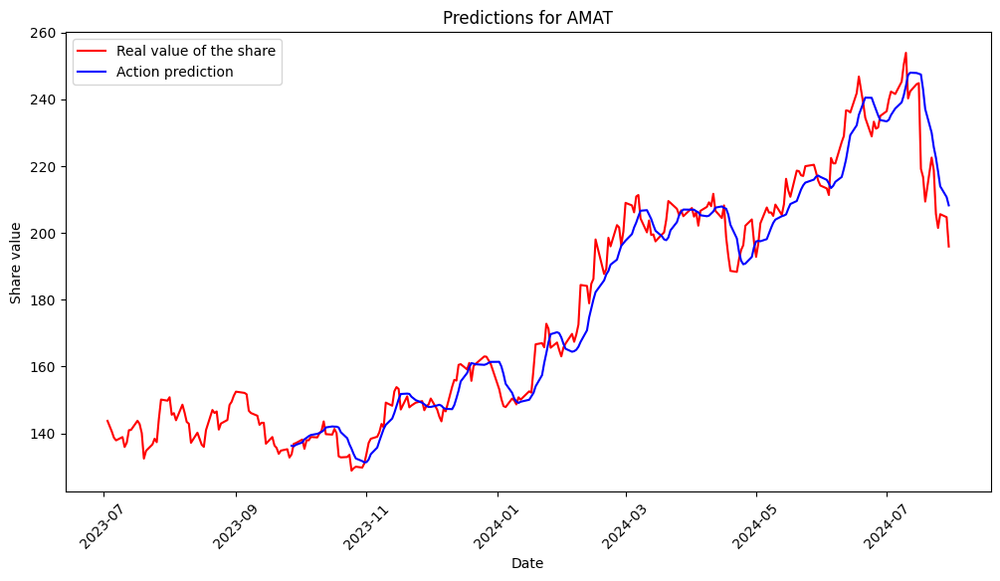

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for AMAT: 47.150557656011806
Normalized Mean Squared Error (Normalized MSE) for AMAT: 0.0015376365647725848
Mean Absolute Error (MAE) for AMAT: 5.102267747432566
R^2 Score for AMAT: 0.959858506988483
Processing MU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for MU.


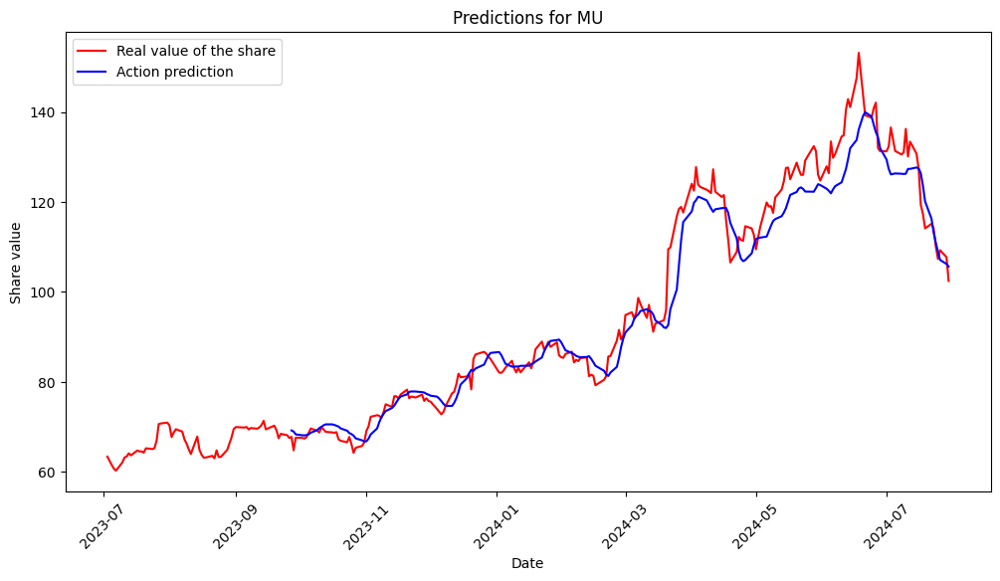

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for MU: 22.495279195828655
Normalized Mean Squared Error (Normalized MSE) for MU: 0.002675288325655327
Mean Absolute Error (MAE) for MU: 3.387362364536074
R^2 Score for MU: 0.9606324662905794
Processing LRCX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for LRCX.


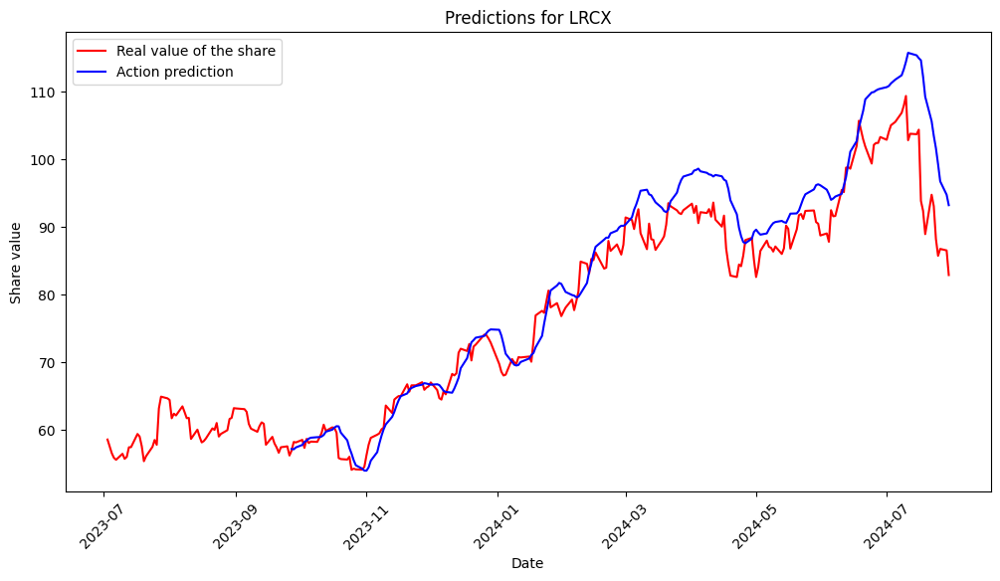

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for LRCX: 26.629938668596598
Normalized Mean Squared Error (Normalized MSE) for LRCX: 0.004618699905074433
Mean Absolute Error (MAE) for LRCX: 3.621463144955317
R^2 Score for LRCX: 0.8707316528670396
Processing NOW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for NOW.


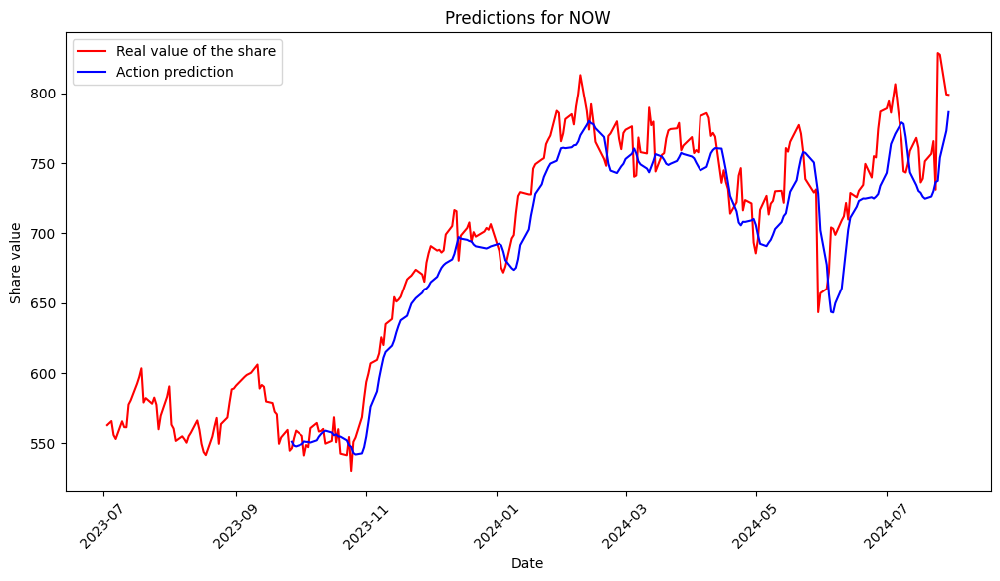

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for NOW: 631.524260601585
Normalized Mean Squared Error (Normalized MSE) for NOW: 0.0013659108867522455
Mean Absolute Error (MAE) for NOW: 20.5548121323505
R^2 Score for NOW: 0.8799722686078729
Processing PANW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for PANW.


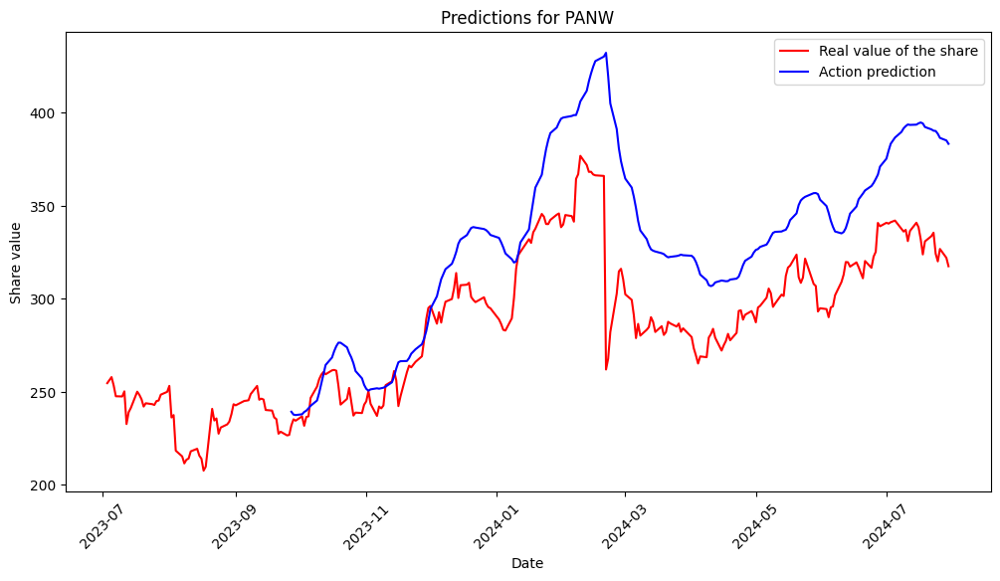

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for PANW: 1744.6003282054855
Normalized Mean Squared Error (Normalized MSE) for PANW: 0.02170182312053187
Mean Absolute Error (MAE) for PANW: 34.630825141289414
R^2 Score for PANW: -0.535329414654105
Processing SNPS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for SNPS.


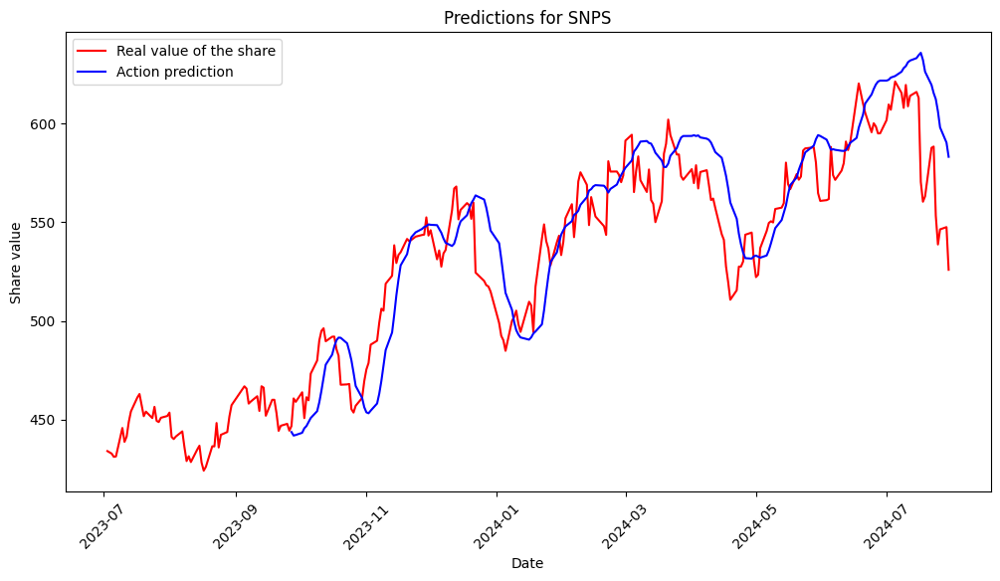

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for SNPS: 519.8334310125995
Normalized Mean Squared Error (Normalized MSE) for SNPS: 0.001895440403858251
Mean Absolute Error (MAE) for SNPS: 17.805959323631043
R^2 Score for SNPS: 0.6908955312007907
Processing CDNS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for CDNS.


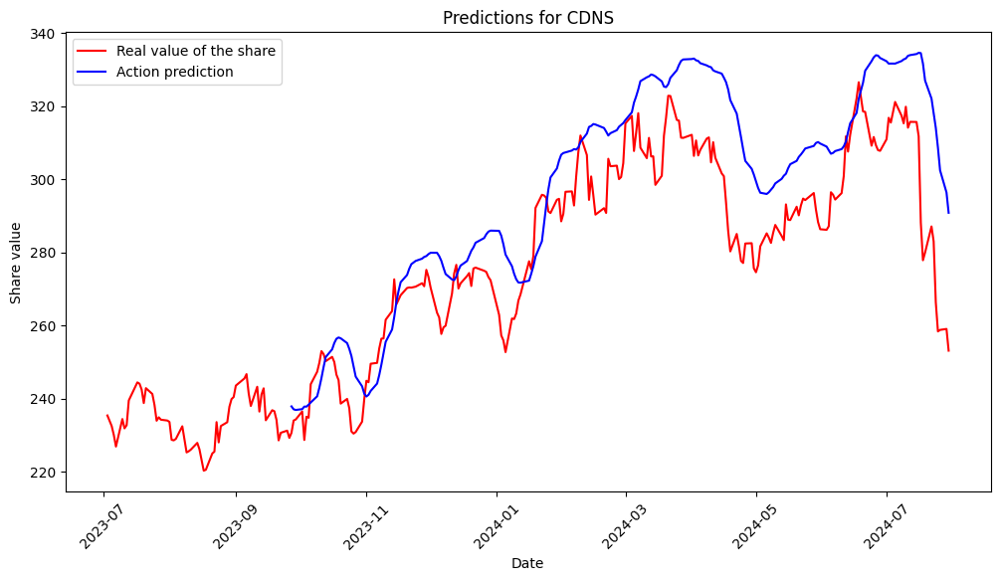

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for CDNS: 328.2246233463851
Normalized Mean Squared Error (Normalized MSE) for CDNS: 0.004418731394317468
Mean Absolute Error (MAE) for CDNS: 14.73012501250859
R^2 Score for CDNS: 0.454023873255893
Processing ANET...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ANET.


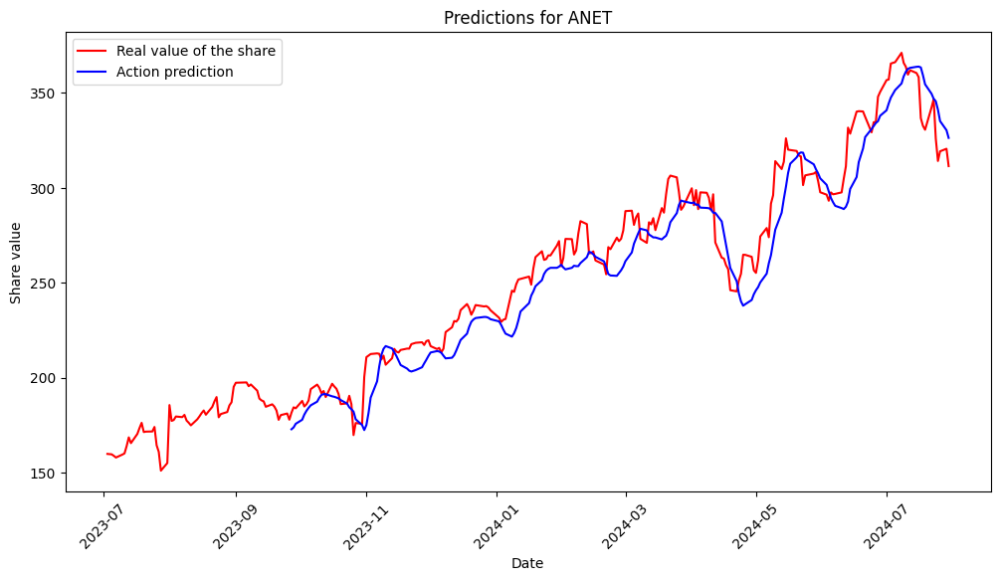

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ANET: 194.597899835782
Normalized Mean Squared Error (Normalized MSE) for ANET: 0.0031911242103904013
Mean Absolute Error (MAE) for ANET: 11.130252275666582
R^2 Score for ANET: 0.9194612781766576
Processing FTNT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for FTNT.


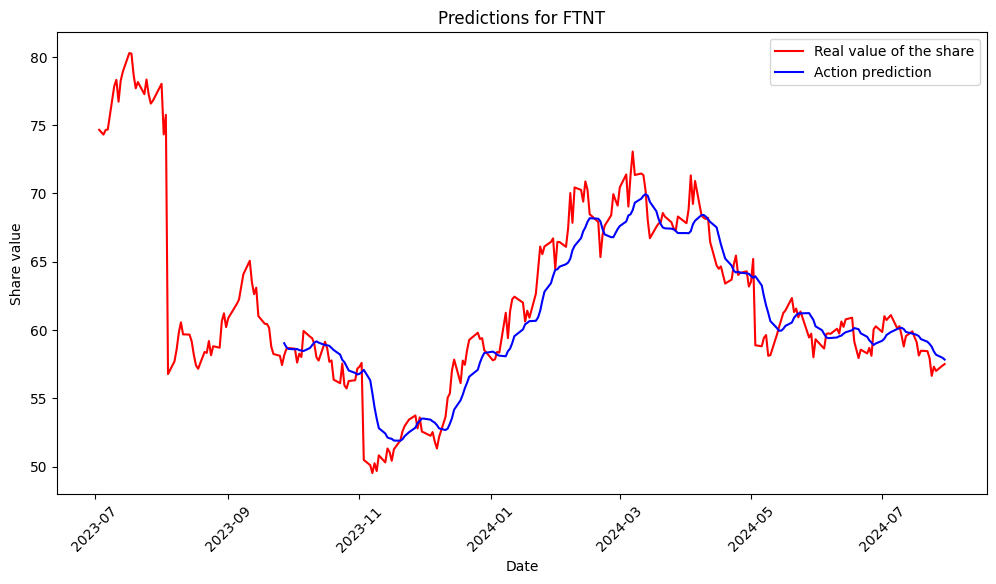

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for FTNT: 3.7201949614782297
Normalized Mean Squared Error (Normalized MSE) for FTNT: 0.0009601258867127032
Mean Absolute Error (MAE) for FTNT: 1.4577487520478585
R^2 Score for FTNT: 0.8801633245534256
Processing KLAC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for KLAC.


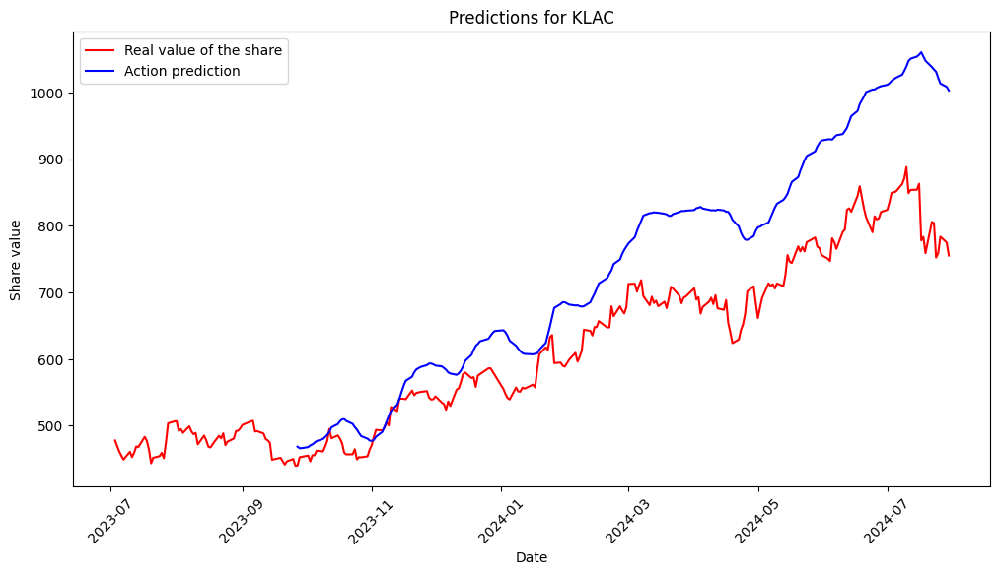

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for KLAC: 13555.655761510383
Normalized Mean Squared Error (Normalized MSE) for KLAC: 0.036741796752164206
Mean Absolute Error (MAE) for KLAC: 95.7473322594311
R^2 Score for KLAC: 0.00549882192254747
Processing APH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for APH.


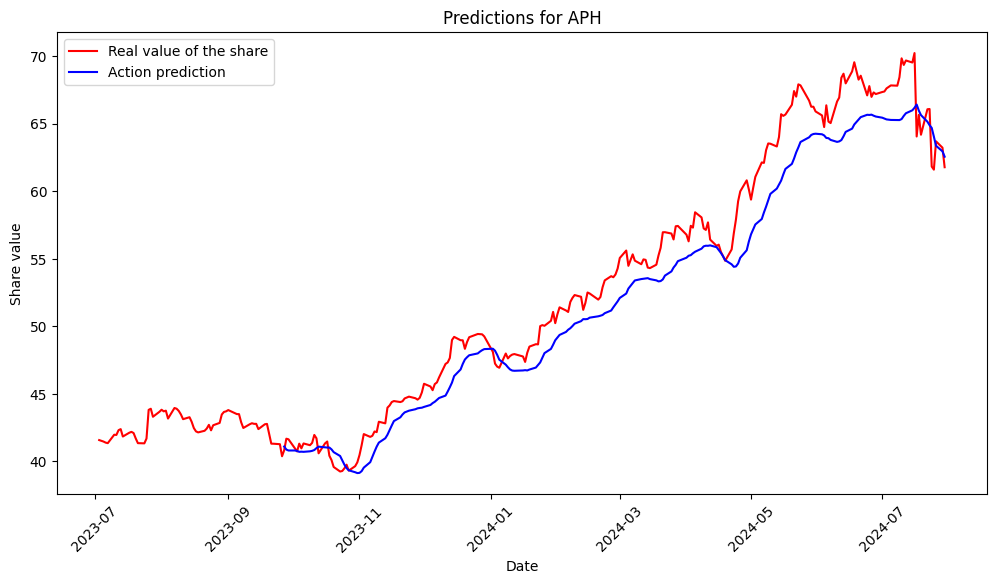

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for APH: 5.1207560757676305
Normalized Mean Squared Error (Normalized MSE) for APH: 0.0019265139366514607
Mean Absolute Error (MAE) for APH: 1.9024524999678019
R^2 Score for APH: 0.9402518689930005
Processing TEL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for TEL.


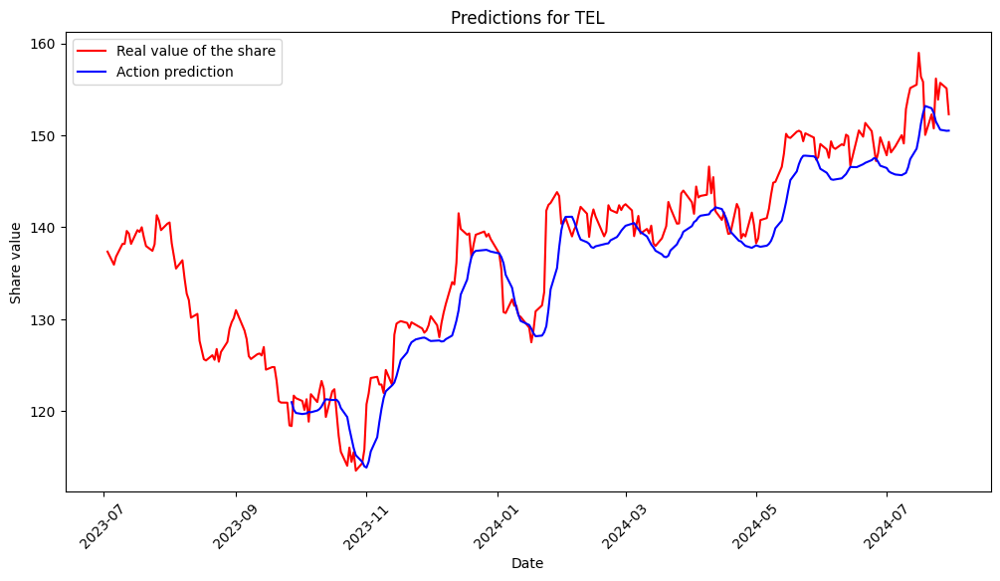

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for TEL: 13.466705264653438
Normalized Mean Squared Error (Normalized MSE) for TEL: 0.0007192395652636575
Mean Absolute Error (MAE) for TEL: 2.8863544817764866
R^2 Score for TEL: 0.879246528522031
Processing MCHP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for MCHP.


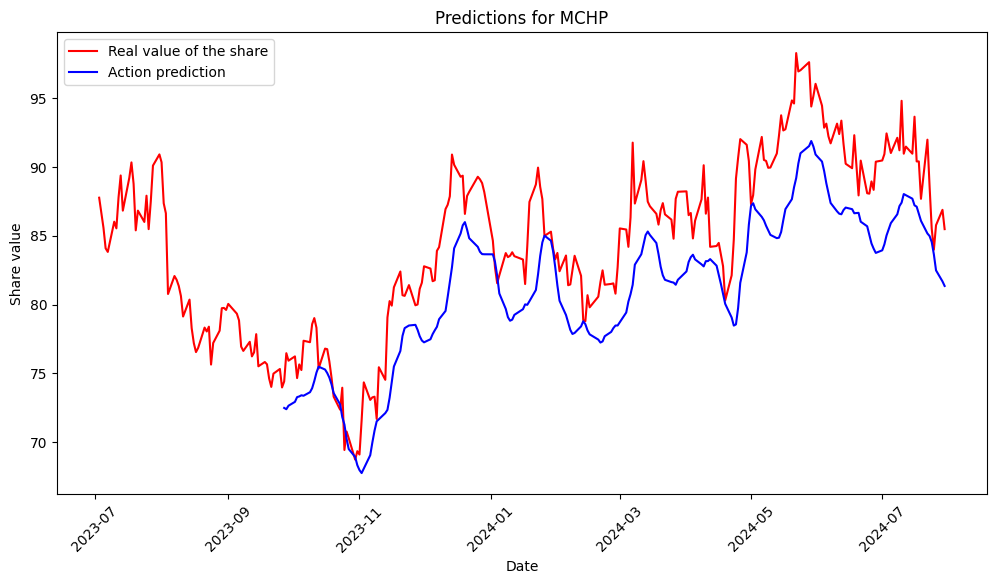

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for MCHP: 20.877252344742217
Normalized Mean Squared Error (Normalized MSE) for MCHP: 0.002940136986824606
Mean Absolute Error (MAE) for MCHP: 3.9777488769314995
R^2 Score for MCHP: 0.4840634999333423
Processing NXPI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for NXPI.


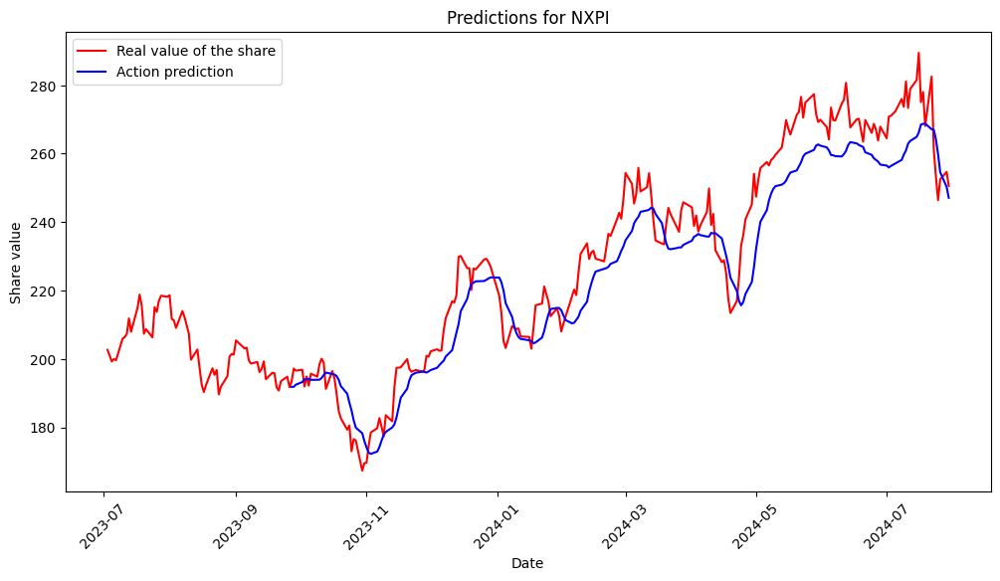

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for NXPI: 99.82332437120752
Normalized Mean Squared Error (Normalized MSE) for NXPI: 0.001972843210912432
Mean Absolute Error (MAE) for NXPI: 8.3739172750678
R^2 Score for NXPI: 0.8937761033211505
Processing ON...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ON.


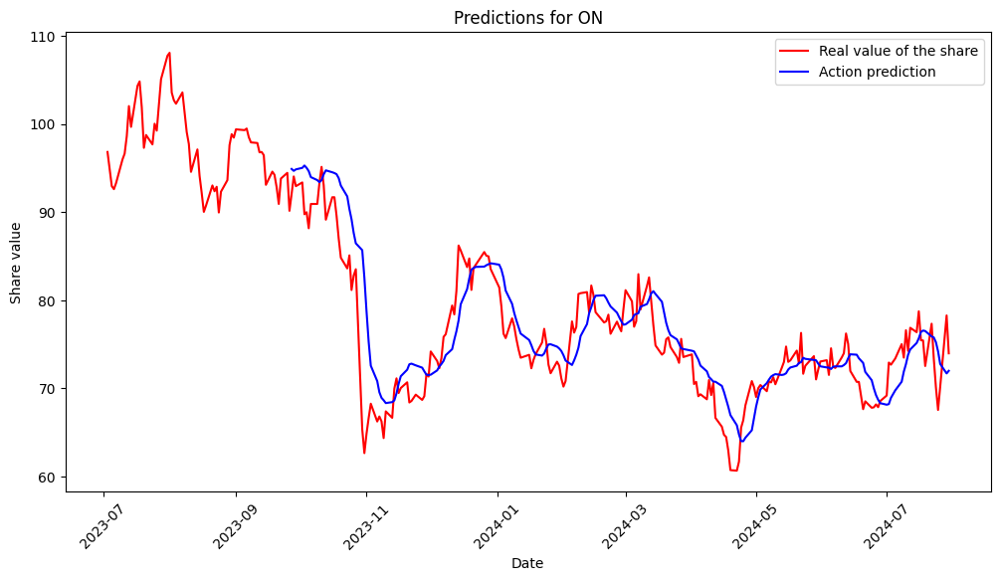

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ON: 15.073587594340923
Normalized Mean Squared Error (Normalized MSE) for ON: 0.002348148440589963
Mean Absolute Error (MAE) for ON: 2.8412139444517606
R^2 Score for ON: 0.6990722266254357
Processing MPWR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for MPWR.


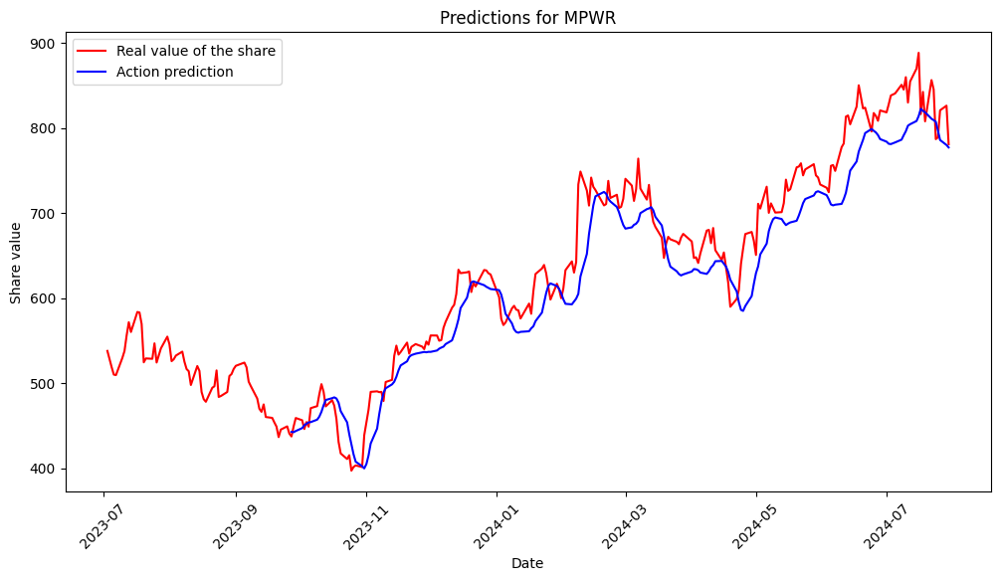

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for MPWR: 1394.1282566865327
Normalized Mean Squared Error (Normalized MSE) for MPWR: 0.003626868906203699
Mean Absolute Error (MAE) for MPWR: 29.760233485454755
R^2 Score for MPWR: 0.9022559690108115
Processing ADI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ADI.


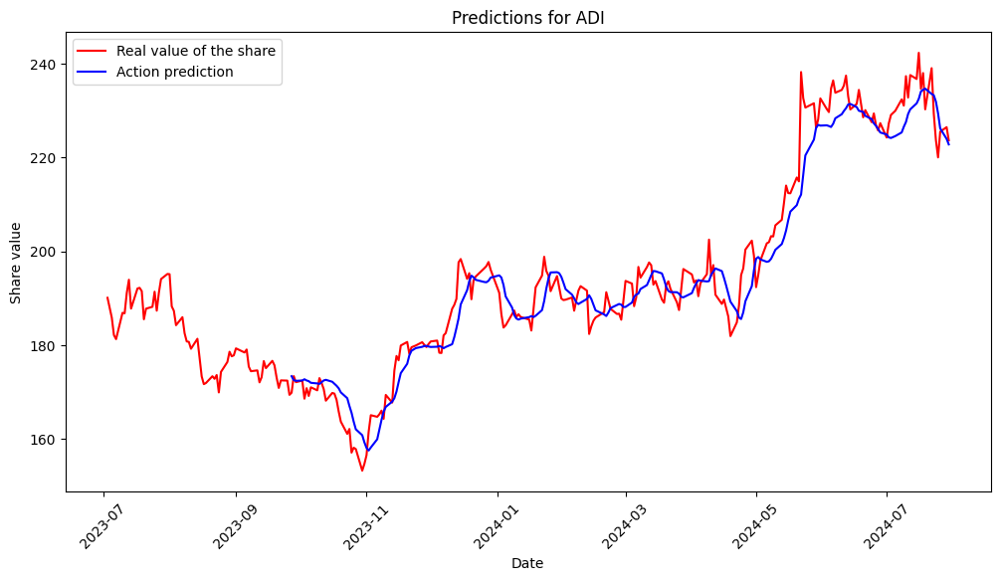

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ADI: 25.747459887518083
Normalized Mean Squared Error (Normalized MSE) for ADI: 0.0006923641393049938
Mean Absolute Error (MAE) for ADI: 3.8866620111260386
R^2 Score for ADI: 0.947034496740037
Processing KEYS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for KEYS.


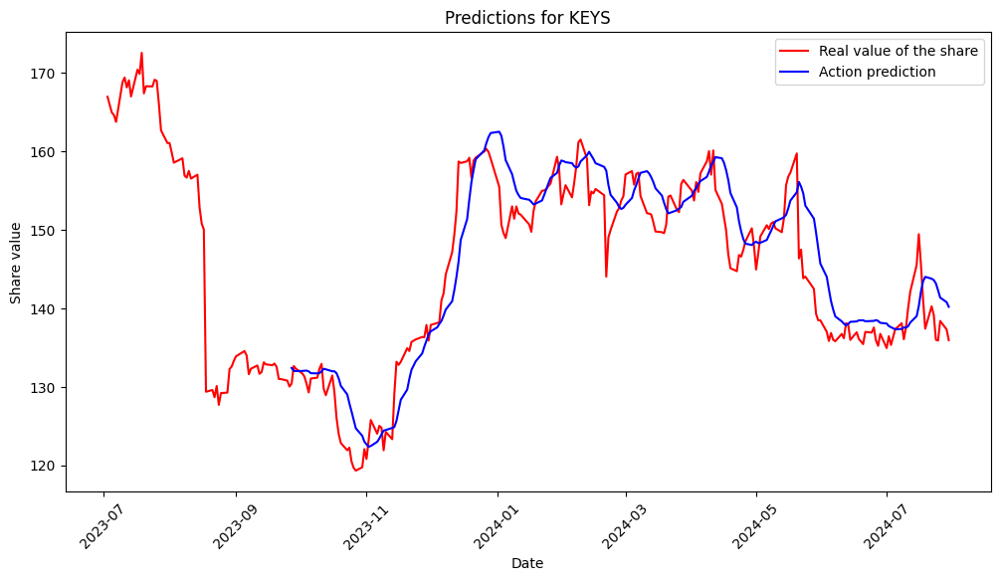

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for KEYS: 19.746562186604127
Normalized Mean Squared Error (Normalized MSE) for KEYS: 0.0009344935594374367
Mean Absolute Error (MAE) for KEYS: 3.39693645006314
R^2 Score for KEYS: 0.842875031300095
Processing CDW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for CDW.


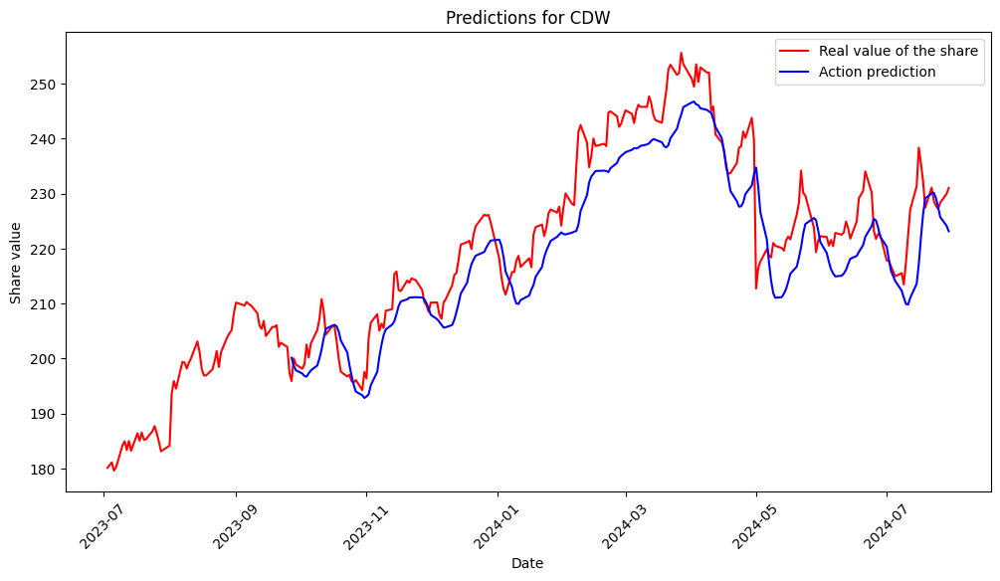

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for CDW: 49.284823456896596
Normalized Mean Squared Error (Normalized MSE) for CDW: 0.0010359190562968278
Mean Absolute Error (MAE) for CDW: 5.781223872358143
R^2 Score for CDW: 0.7844944461706573
Processing ANSS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ANSS.


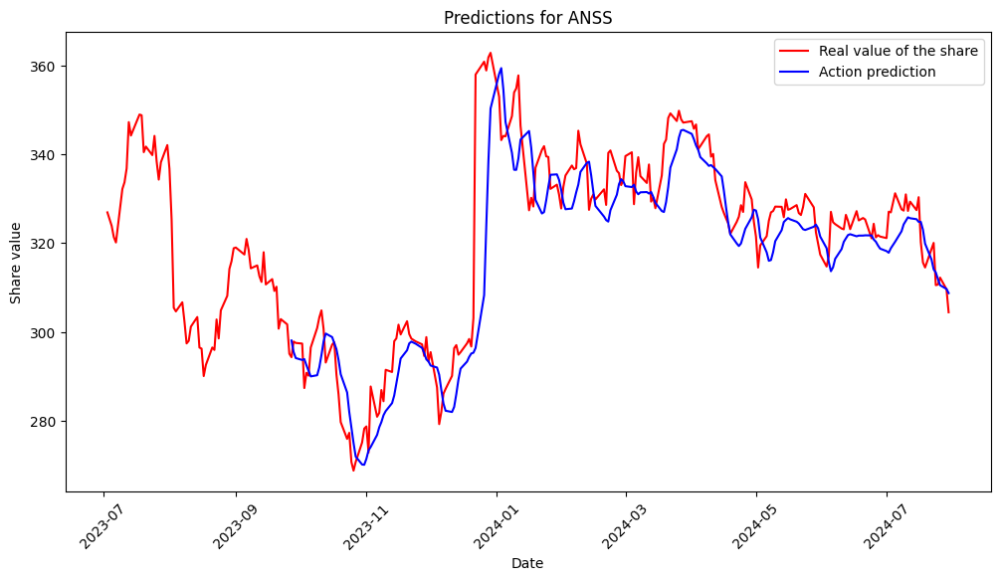

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ANSS: 87.96020654213274
Normalized Mean Squared Error (Normalized MSE) for ANSS: 0.0008606201152077373
Mean Absolute Error (MAE) for ANSS: 6.399890711561643
R^2 Score for ANSS: 0.8108229518437141
Processing PAYC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for PAYC.


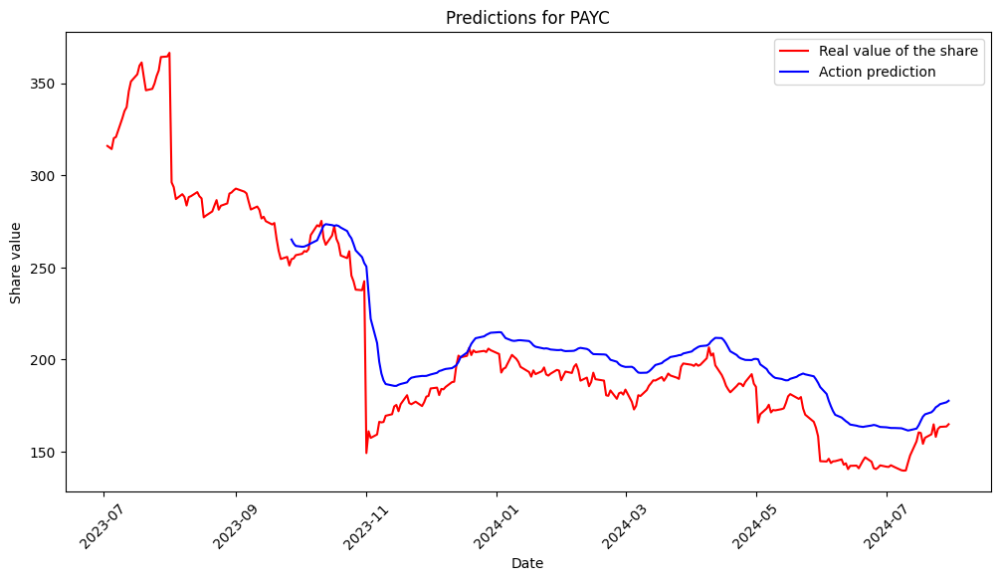

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for PAYC: 352.19659795582305
Normalized Mean Squared Error (Normalized MSE) for PAYC: 0.007765862953244907
Mean Absolute Error (MAE) for PAYC: 15.213985551859594
R^2 Score for PAYC: 0.6550932734792394
Processing GDDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for GDDY.


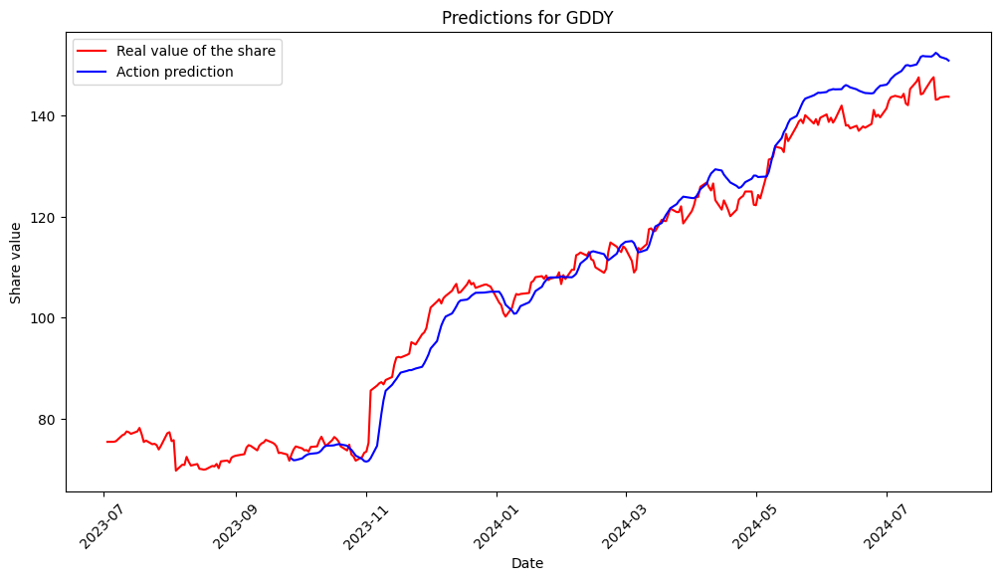

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for GDDY: 17.385263631259072
Normalized Mean Squared Error (Normalized MSE) for GDDY: 0.0015816791485117928
Mean Absolute Error (MAE) for GDDY: 3.334971678720151
R^2 Score for GDDY: 0.963053360588691
Processing TYL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for TYL.


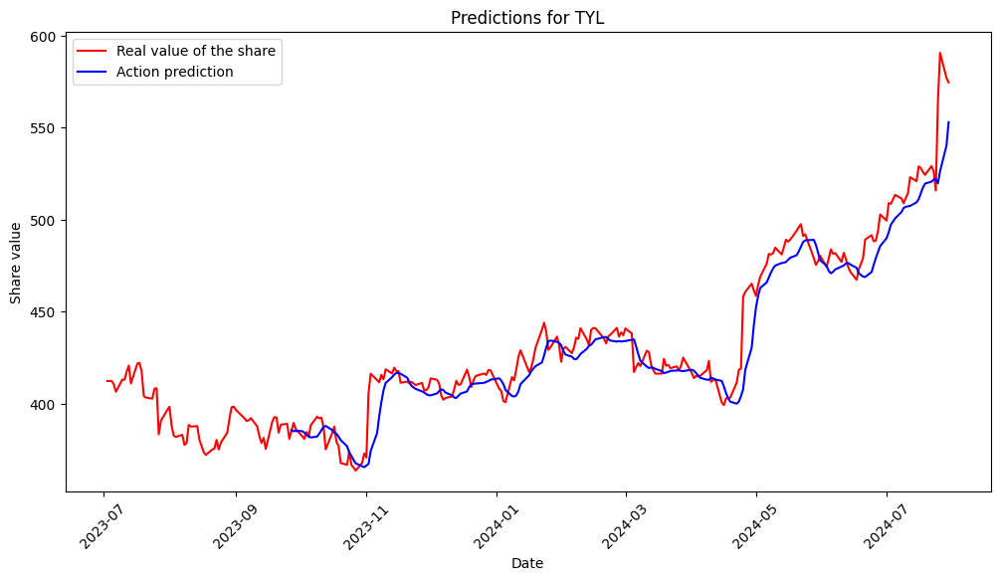

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for TYL: 147.02332772508768
Normalized Mean Squared Error (Normalized MSE) for TYL: 0.0008008825330684358
Mean Absolute Error (MAE) for TYL: 8.188257785336999
R^2 Score for TYL: 0.9258025234827981
Processing SSNC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for SSNC.


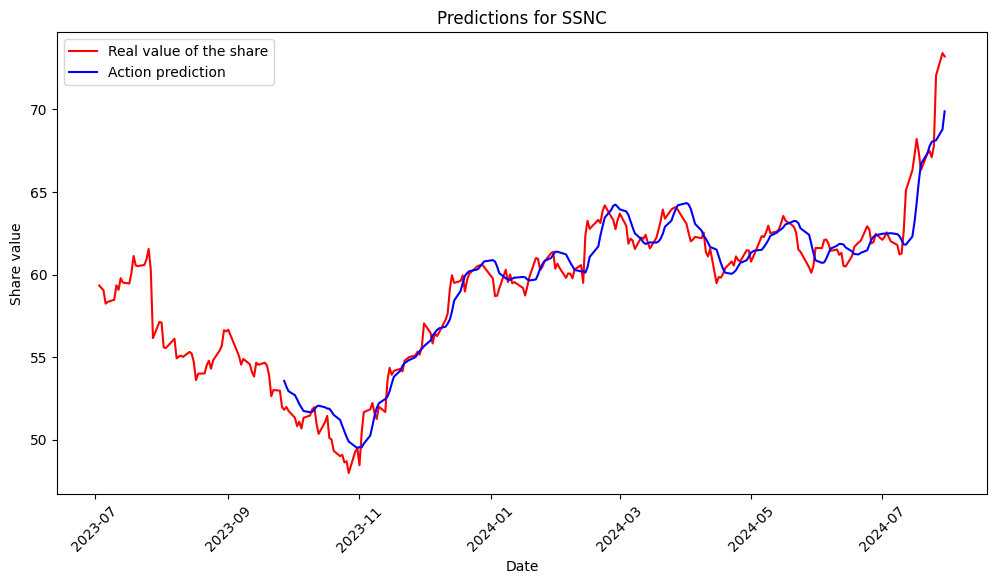

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for SSNC: 1.4129754925711213
Normalized Mean Squared Error (Normalized MSE) for SSNC: 0.000407766118932284
Mean Absolute Error (MAE) for SSNC: 0.8720361709786089
R^2 Score for SSNC: 0.9403791656084869
Processing JKHY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for JKHY.


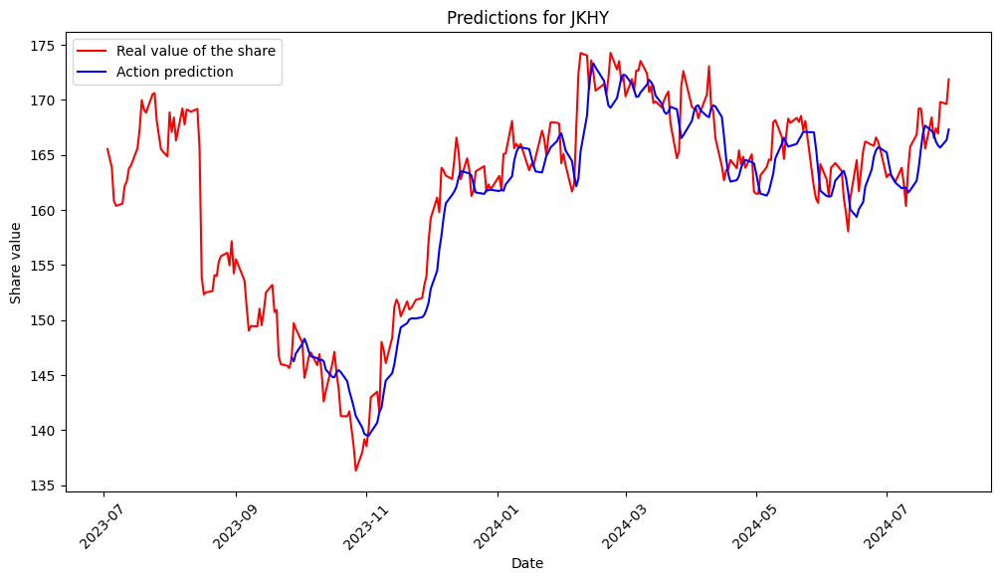

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for JKHY: 7.4505361096314235
Normalized Mean Squared Error (Normalized MSE) for JKHY: 0.00028615330937665806
Mean Absolute Error (MAE) for JKHY: 2.115583371598892
R^2 Score for JKHY: 0.9122478395722627
Processing EPAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for EPAM.


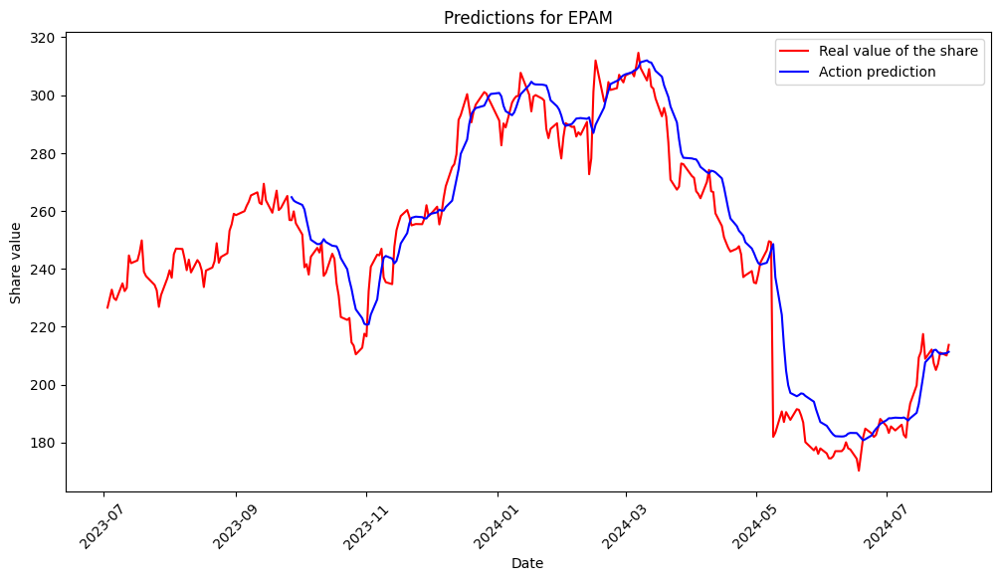

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for EPAM: 127.35833260141533
Normalized Mean Squared Error (Normalized MSE) for EPAM: 0.0020759073240190187
Mean Absolute Error (MAE) for EPAM: 8.166965630362279
R^2 Score for EPAM: 0.9315244449360297
Processing GLW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for GLW.


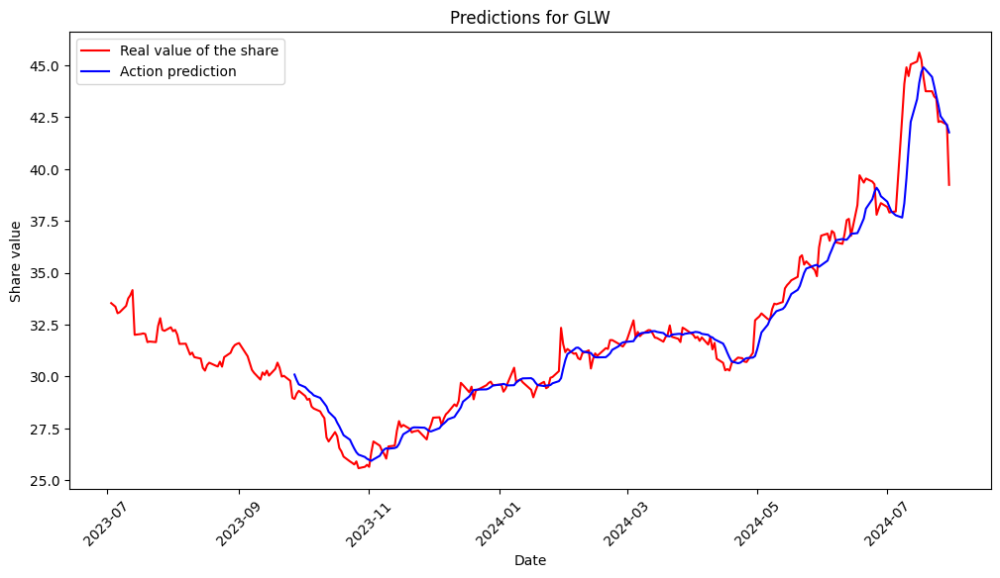

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for GLW: 0.9705671856977496
Normalized Mean Squared Error (Normalized MSE) for GLW: 0.00095019502763751
Mean Absolute Error (MAE) for GLW: 0.6094128322585554
R^2 Score for GLW: 0.9571087495372973
Processing HPQ...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for HPQ.


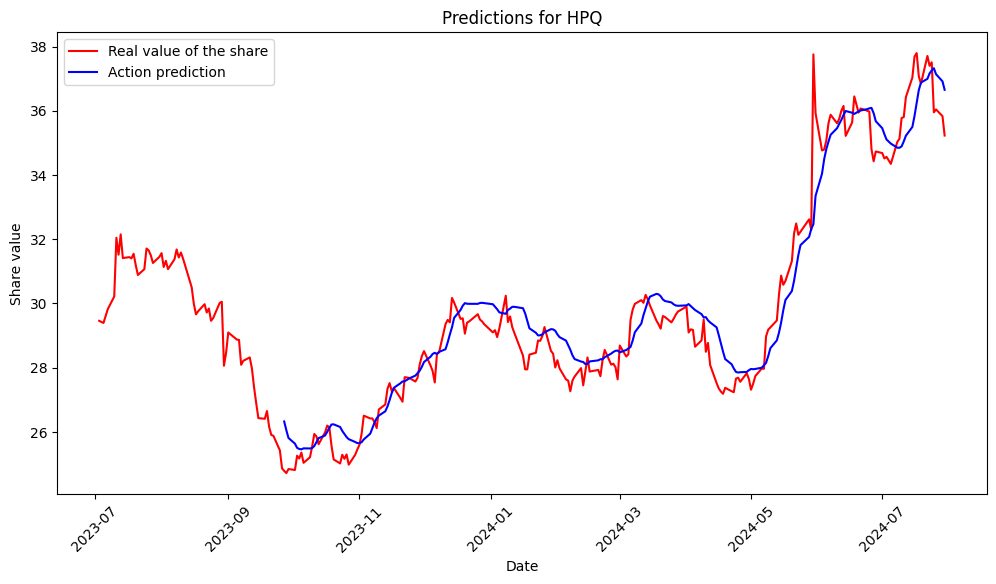

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for HPQ: 0.6953507612013538
Normalized Mean Squared Error (Normalized MSE) for HPQ: 0.0007885776559418679
Mean Absolute Error (MAE) for HPQ: 0.6245644718258214
R^2 Score for HPQ: 0.9420811064833854
Processing DXC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for DXC.


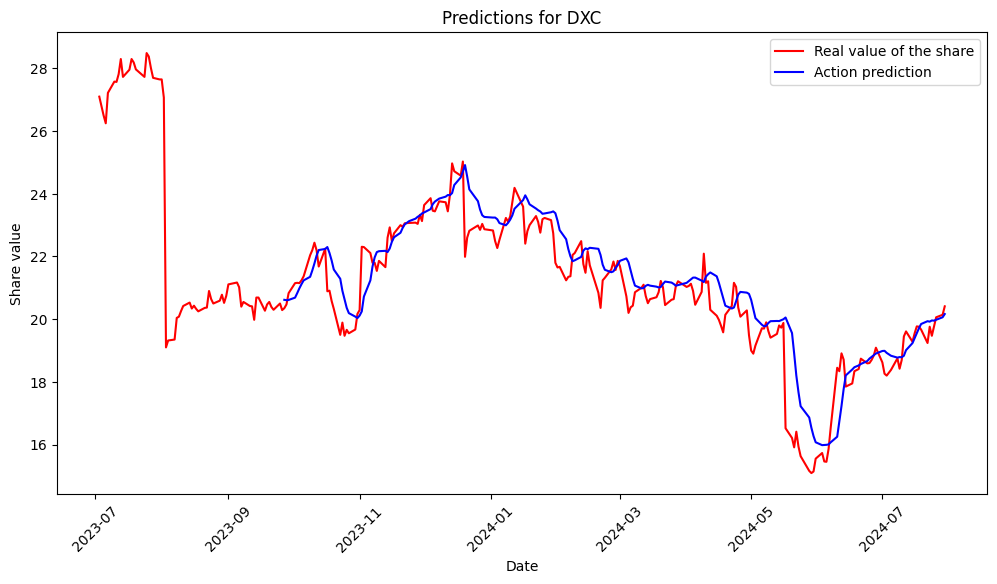

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for DXC: 0.7391084069612576
Normalized Mean Squared Error (Normalized MSE) for DXC: 0.001632326639879756
Mean Absolute Error (MAE) for DXC: 0.5993801589582389
R^2 Score for DXC: 0.8306661672511647
Processing IT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for IT.


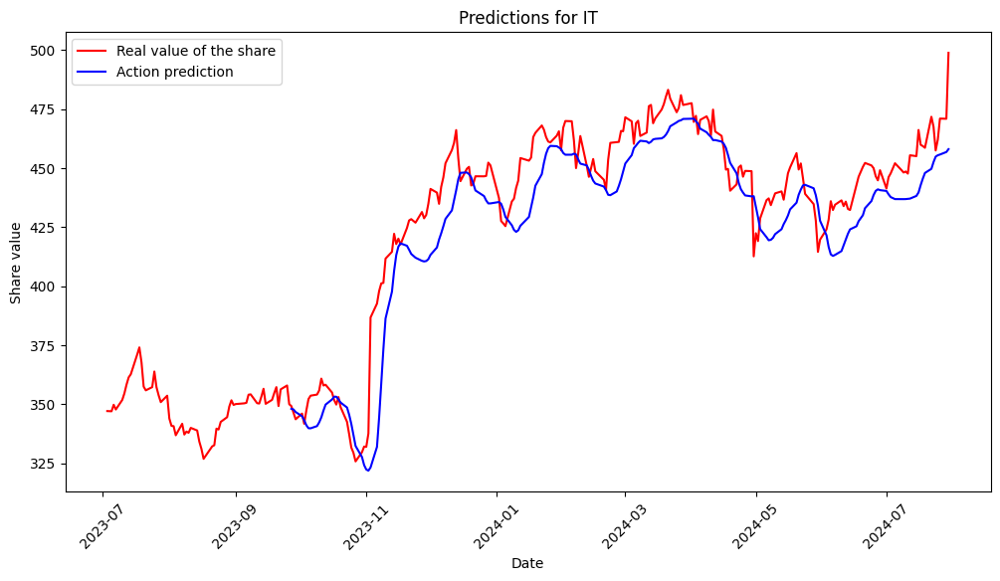

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for IT: 241.8225513790616
Normalized Mean Squared Error (Normalized MSE) for IT: 0.0013937822011580567
Mean Absolute Error (MAE) for IT: 12.265299553818313
R^2 Score for IT: 0.8408189945148665
Processing LDOS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for LDOS.


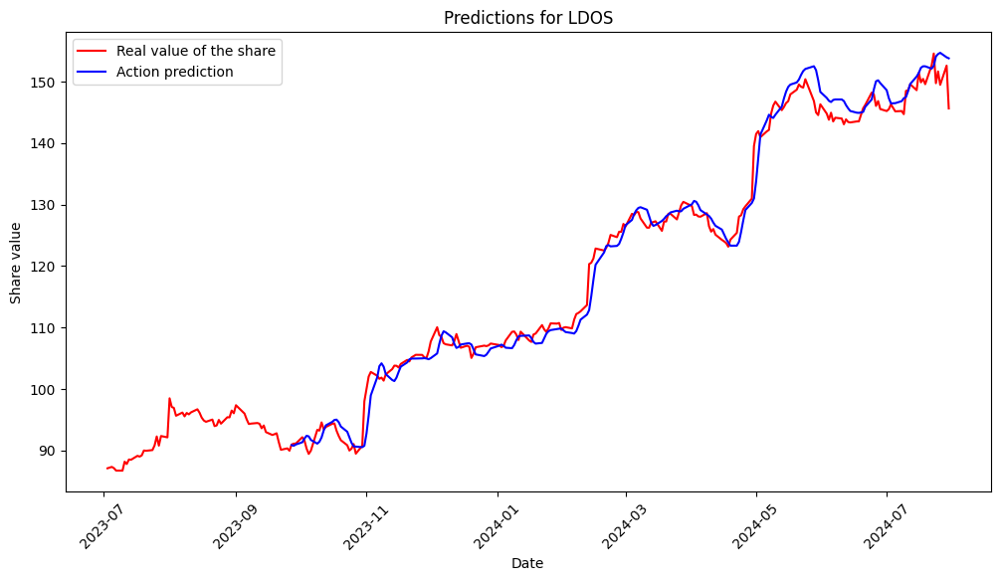

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for LDOS: 5.636327434586469
Normalized Mean Squared Error (Normalized MSE) for LDOS: 0.00042255667893038314
Mean Absolute Error (MAE) for LDOS: 1.7352477524894774
R^2 Score for LDOS: 0.9847767303602117
Processing AKAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for AKAM.


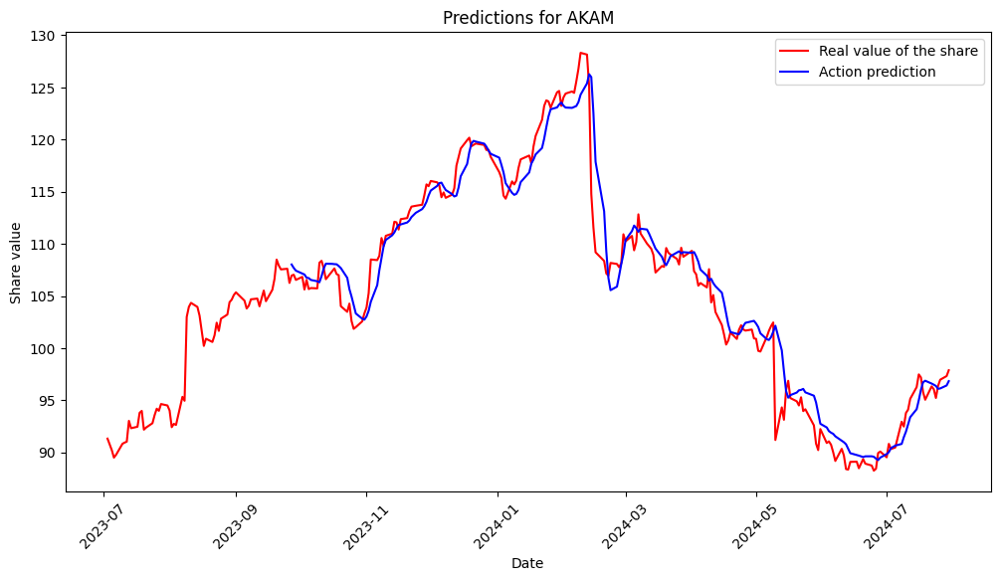

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for AKAM: 4.733765927963578
Normalized Mean Squared Error (Normalized MSE) for AKAM: 0.0004313087451888989
Mean Absolute Error (MAE) for AKAM: 1.4825698574992672
R^2 Score for AKAM: 0.9555773982655766
Processing NTAP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for NTAP.


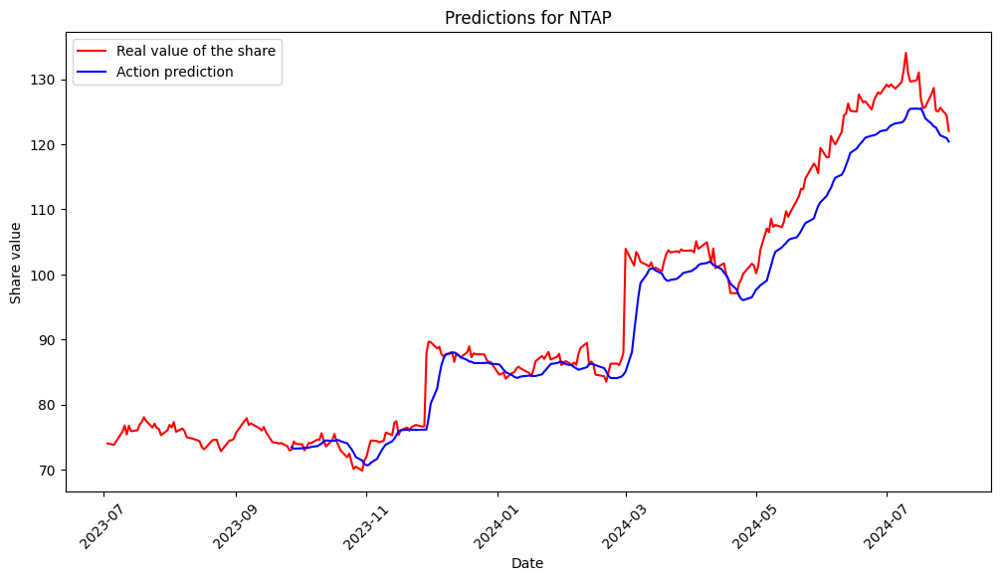

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for NTAP: 18.03052958823319
Normalized Mean Squared Error (Normalized MSE) for NTAP: 0.0021178227296377978
Mean Absolute Error (MAE) for NTAP: 3.060473704580836
R^2 Score for NTAP: 0.9455855535750256
Processing VRSN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for VRSN.


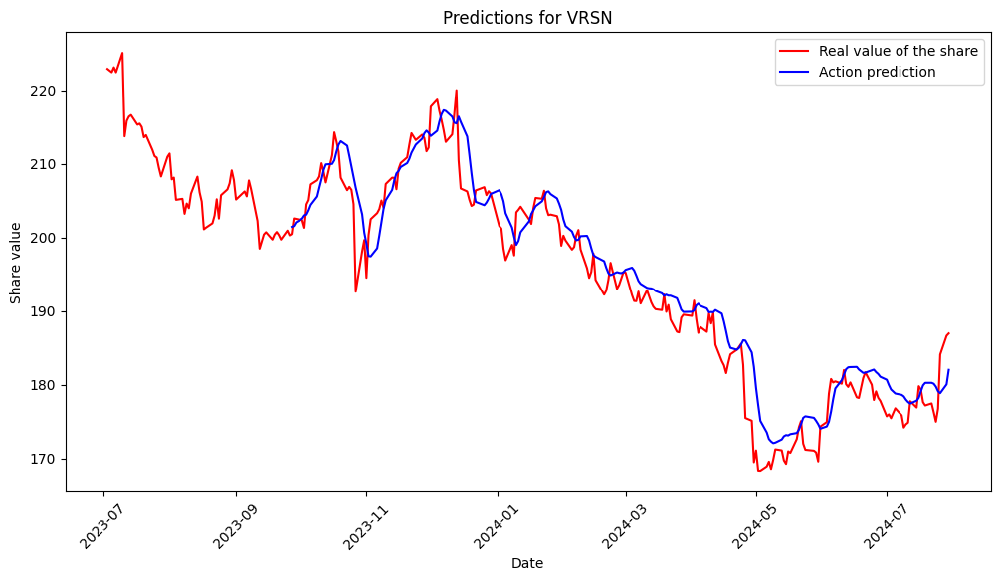

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for VRSN: 12.863364802009638
Normalized Mean Squared Error (Normalized MSE) for VRSN: 0.0003344578382075741
Mean Absolute Error (MAE) for VRSN: 2.800040530567624
R^2 Score for VRSN: 0.933568444743597
Processing FFIV...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for FFIV.


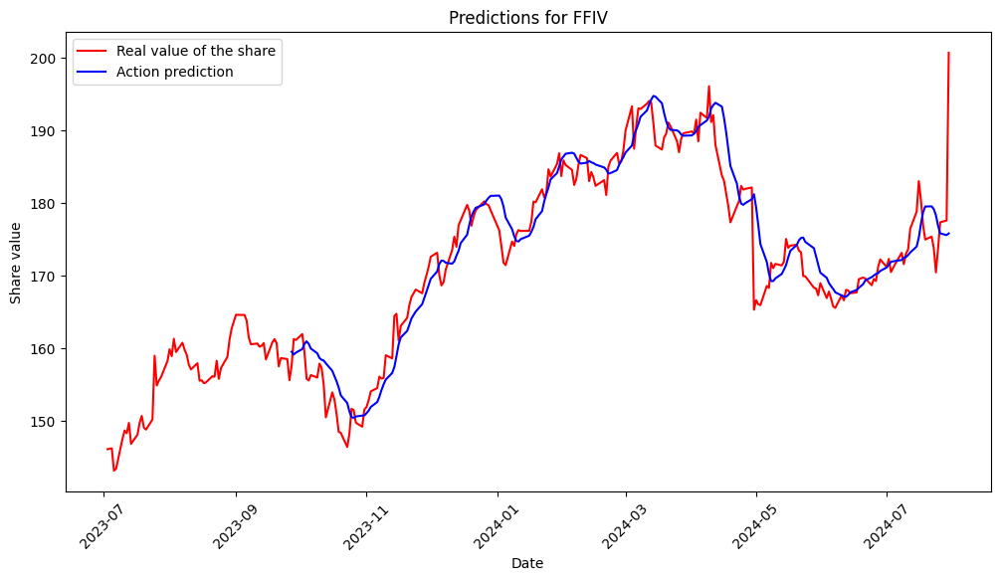

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for FFIV: 15.222645164290858
Normalized Mean Squared Error (Normalized MSE) for FFIV: 0.0005260872225437644
Mean Absolute Error (MAE) for FFIV: 2.6868064786234456
R^2 Score for FFIV: 0.8900991198519994
Processing XRX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for XRX.


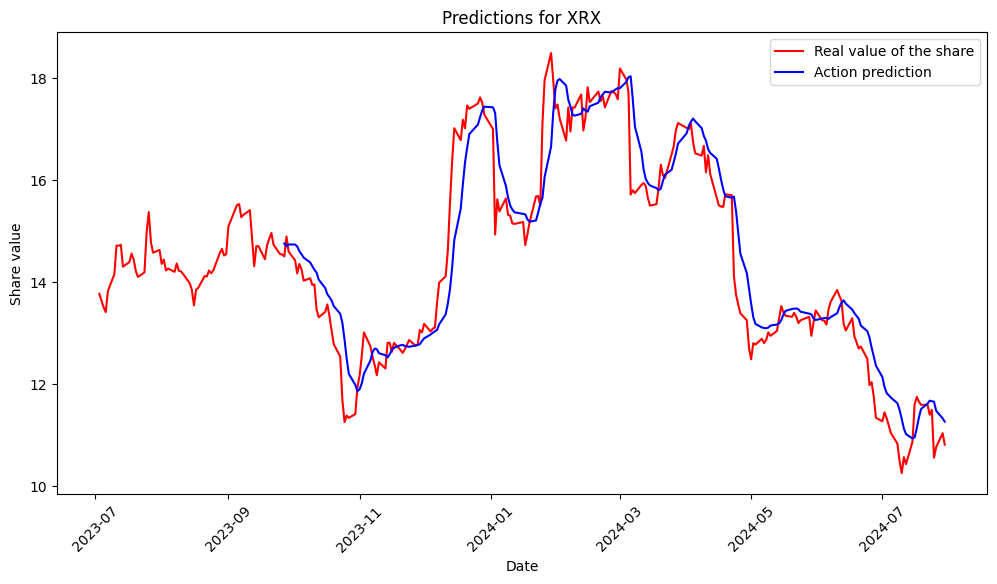

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for XRX: 0.45607521692737907
Normalized Mean Squared Error (Normalized MSE) for XRX: 0.002203989866914538
Mean Absolute Error (MAE) for XRX: 0.4851316377299733
R^2 Score for XRX: 0.9007540002309038
Processing JNPR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for JNPR.


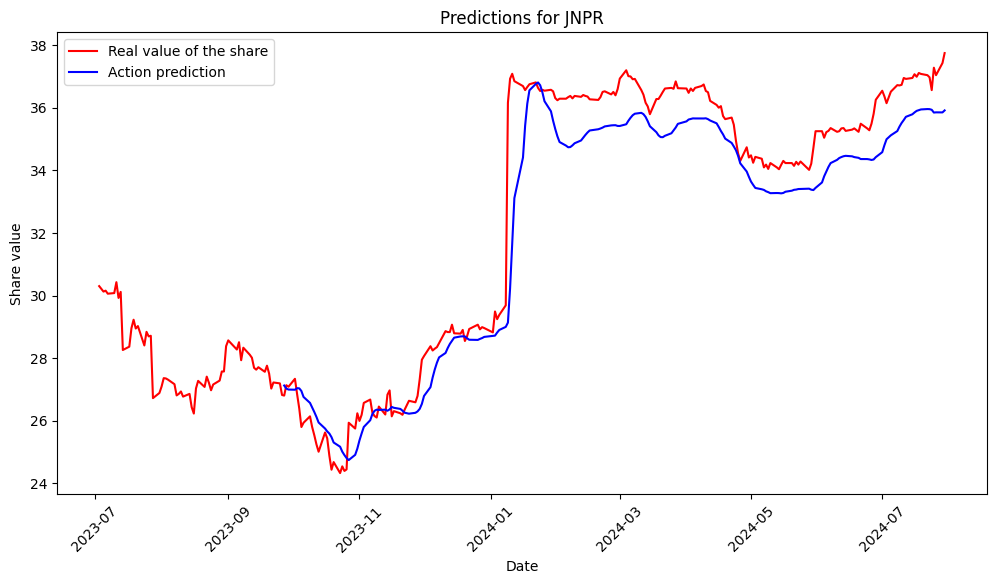

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for JNPR: 1.5567332371548215
Normalized Mean Squared Error (Normalized MSE) for JNPR: 0.0015339636405271927
Mean Absolute Error (MAE) for JNPR: 0.9393206674628717
R^2 Score for JNPR: 0.9189341246533519
Processing CSGP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for CSGP.


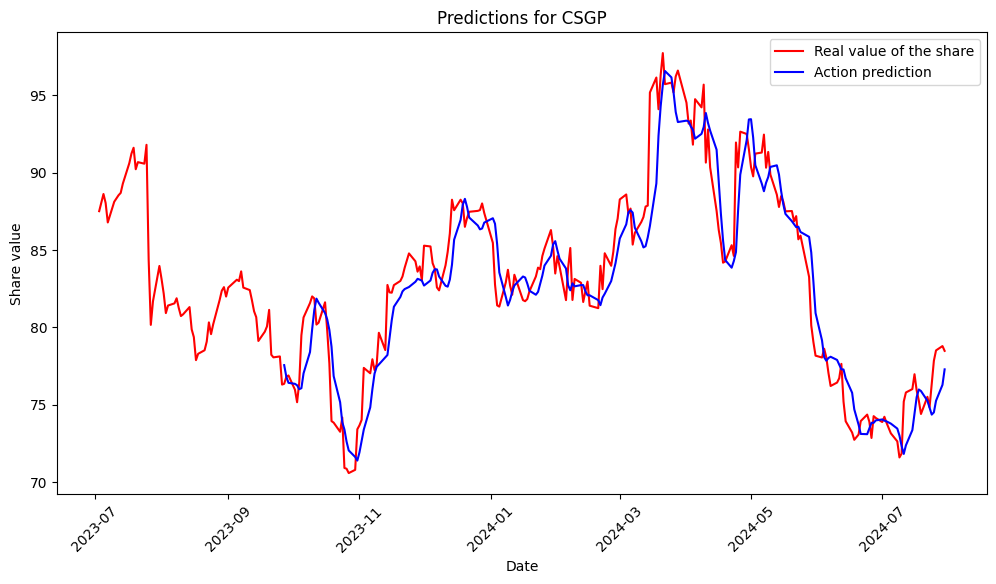

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for CSGP: 4.2025714540573205
Normalized Mean Squared Error (Normalized MSE) for CSGP: 0.0006102036146687377
Mean Absolute Error (MAE) for CSGP: 1.5796840657754174
R^2 Score for CSGP: 0.8985854003839383
Processing TRMB...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for TRMB.


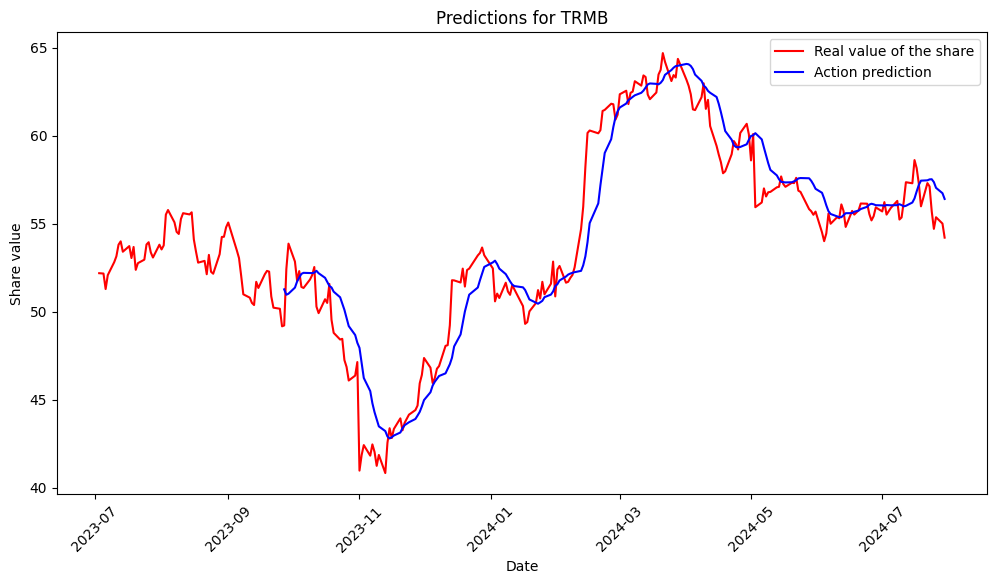

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for TRMB: 3.183139550668534
Normalized Mean Squared Error (Normalized MSE) for TRMB: 0.0010917101127457182
Mean Absolute Error (MAE) for TRMB: 1.3019833495164288
R^2 Score for TRMB: 0.9075991851617572
Processing GRMN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for GRMN.


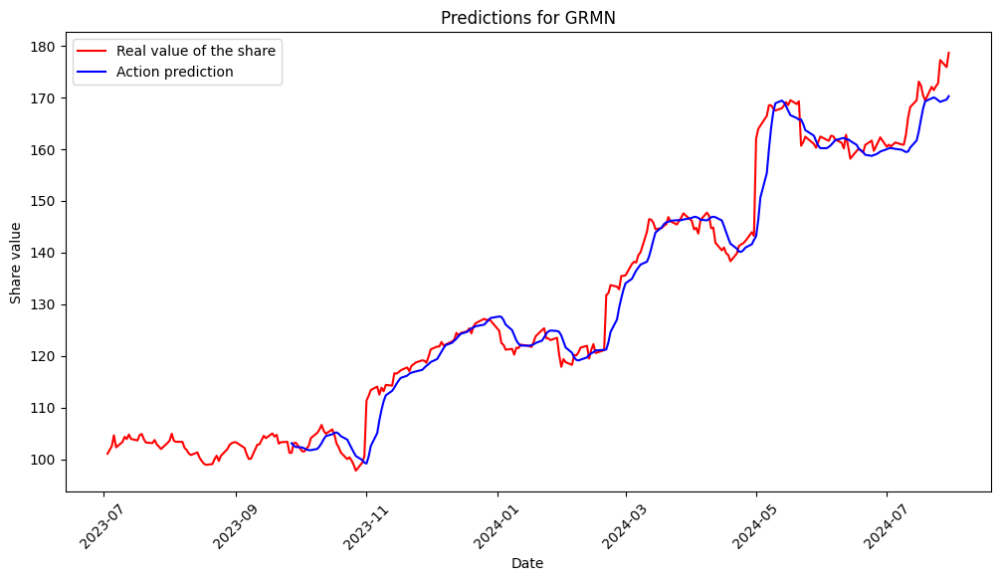

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for GRMN: 15.884306163901076
Normalized Mean Squared Error (Normalized MSE) for GRMN: 0.0009551068829256706
Mean Absolute Error (MAE) for GRMN: 2.632618712032784
R^2 Score for GRMN: 0.9675870570806921
Processing ZBRA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for ZBRA.


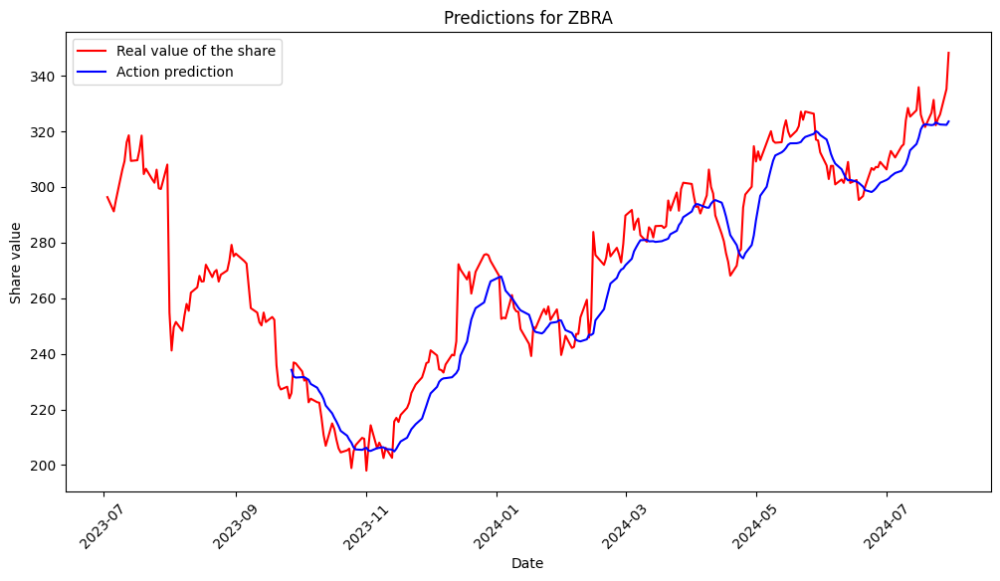

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for ZBRA: 111.8703786668245
Normalized Mean Squared Error (Normalized MSE) for ZBRA: 0.0015100117082350807
Mean Absolute Error (MAE) for ZBRA: 8.337182941754032
R^2 Score for ZBRA: 0.9250806341550292
Processing BR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for BR.


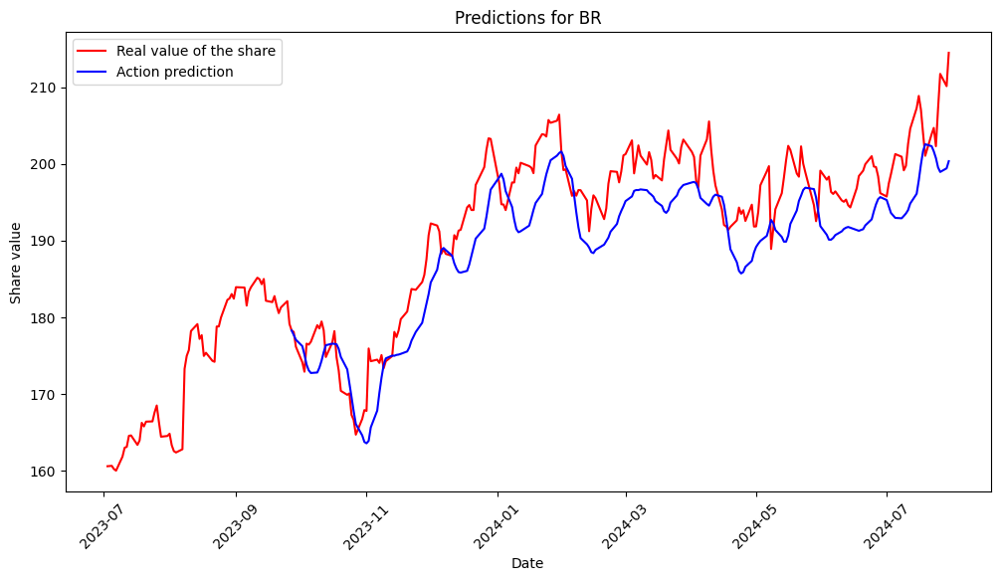

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-6-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for 

Mean Squared Error (MSE) for BR: 32.09635701035923
Normalized Mean Squared Error (Normalized MSE) for BR: 0.0008981831242317125
Mean Absolute Error (MAE) for BR: 4.870305856825451
R^2 Score for BR: 0.7037480510293246
Processing VRSN...
Model loaded for VRSN.


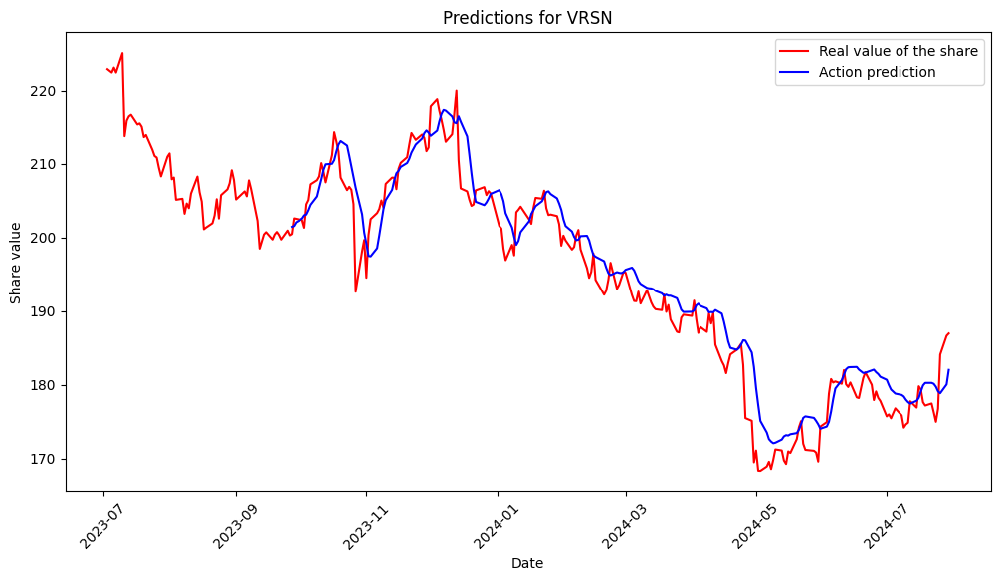

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for VRSN: 12.863364802009638
Normalized Mean Squared Error (Normalized MSE) for VRSN: 0.0003344578382075741
Mean Absolute Error (MAE) for VRSN: 2.800040530567624
R^2 Score for VRSN: 0.933568444743597
Processing PTC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for PTC.


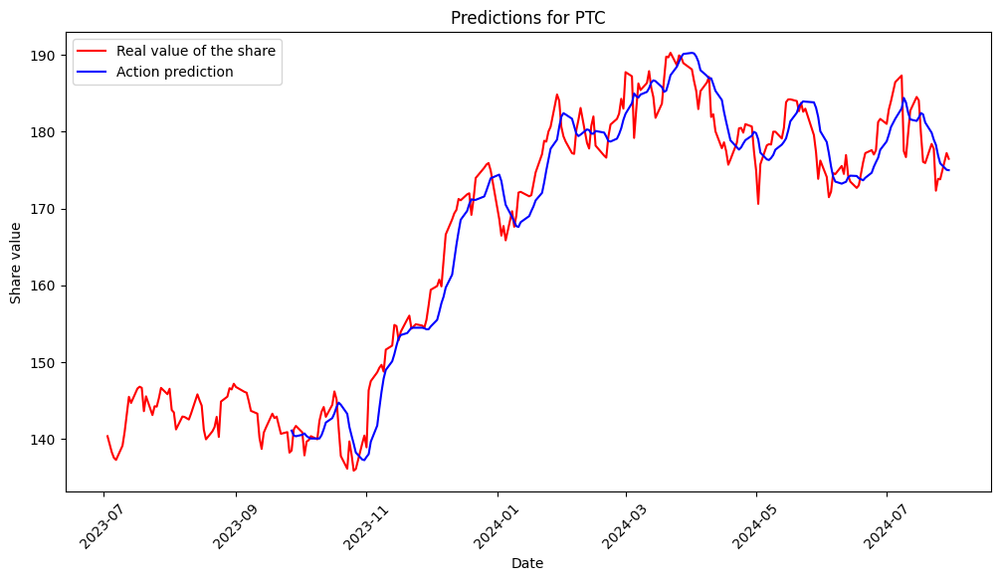

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for PTC: 11.862350343335459
Normalized Mean Squared Error (Normalized MSE) for PTC: 0.0004358703218651995
Mean Absolute Error (MAE) for PTC: 2.8785467058899505
R^2 Score for PTC: 0.9464219956065713
Processing CTSH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for CTSH.


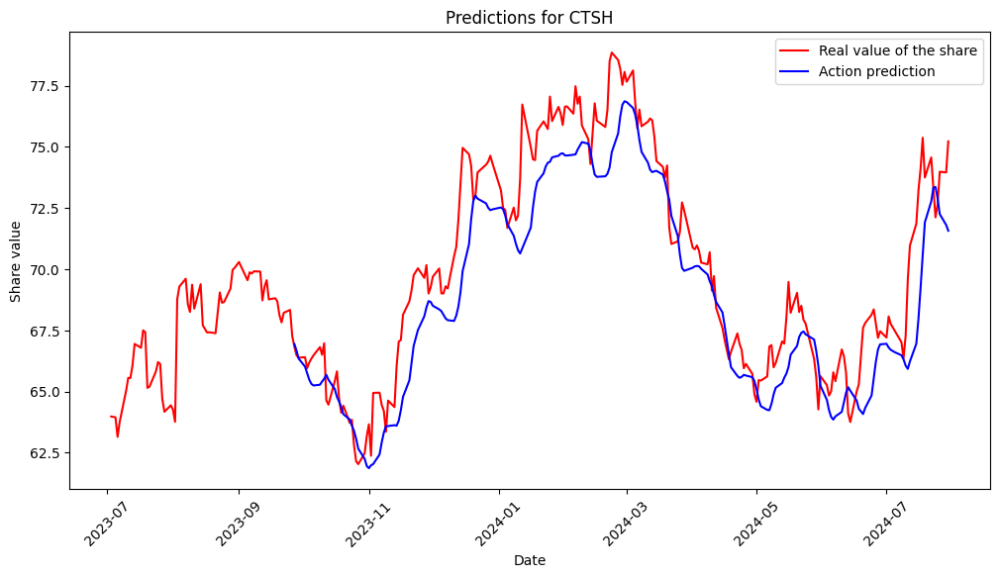

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for CTSH: 3.664898945995781
Normalized Mean Squared Error (Normalized MSE) for CTSH: 0.0007582141783858603
Mean Absolute Error (MAE) for CTSH: 1.501974888955594
R^2 Score for CTSH: 0.8151890154790249
Processing HPE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for HPE.


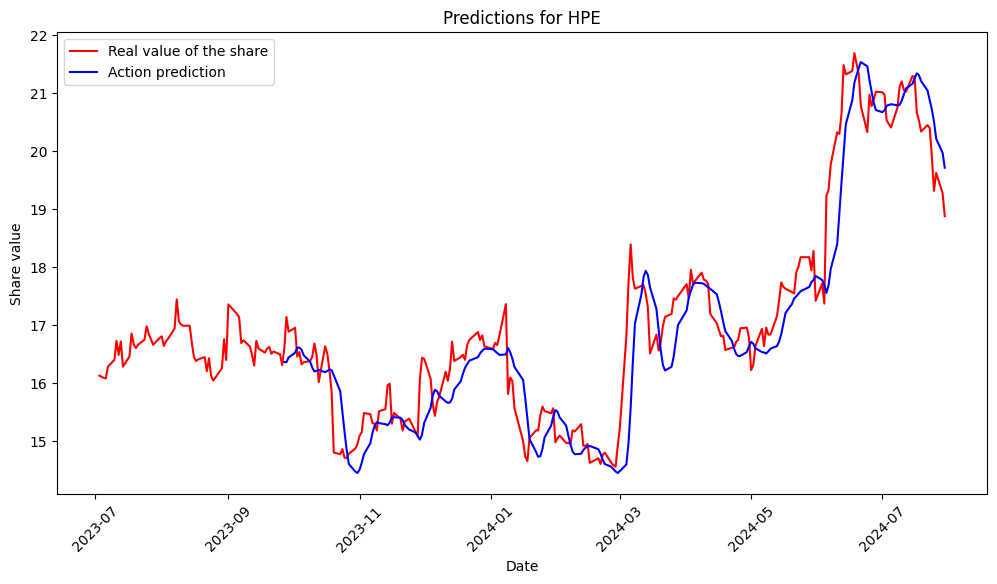

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-6-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for 

Mean Squared Error (MSE) for HPE: 0.418738711298468
Normalized Mean Squared Error (Normalized MSE) for HPE: 0.001455911948770152
Mean Absolute Error (MAE) for HPE: 0.4654519909150336
R^2 Score for HPE: 0.8855990078722282
Processing JNPR...
Model loaded for JNPR.


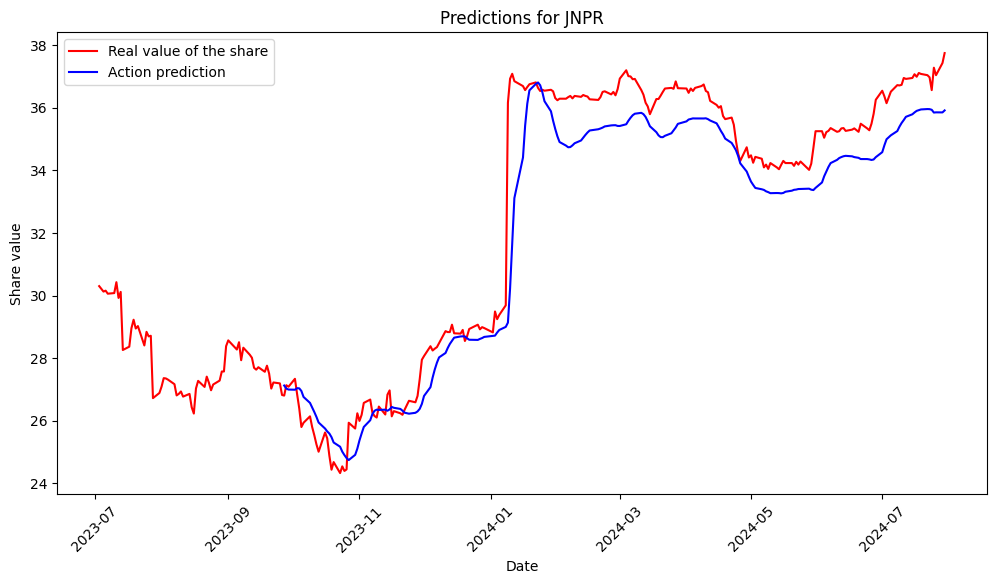

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for JNPR: 1.5567332371548215
Normalized Mean Squared Error (Normalized MSE) for JNPR: 0.0015339636405271927
Mean Absolute Error (MAE) for JNPR: 0.9393206674628717
R^2 Score for JNPR: 0.9189341246533519
Processing MSI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for MSI.


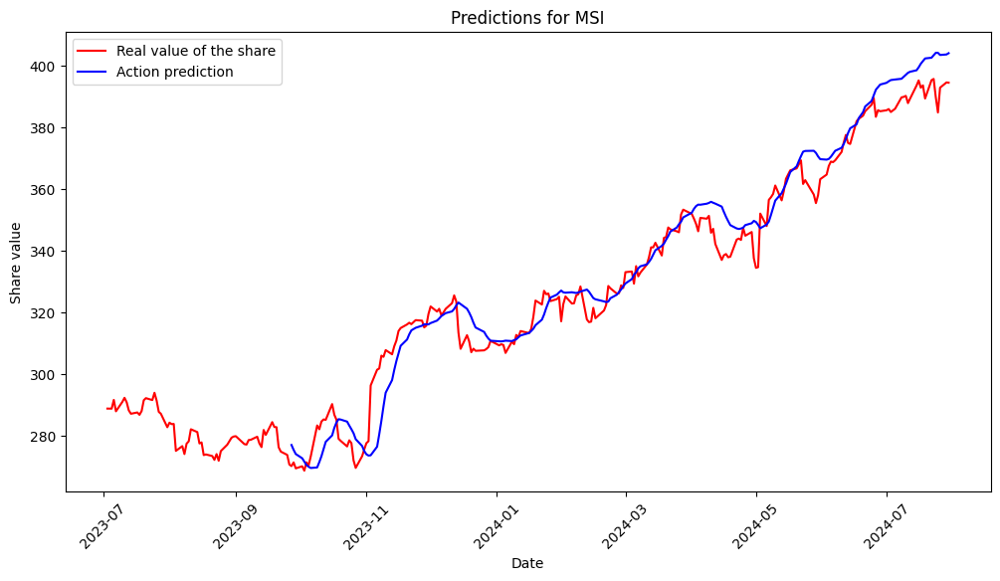

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for MSI: 52.3788094550858
Normalized Mean Squared Error (Normalized MSE) for MSI: 0.0005041108500991495
Mean Absolute Error (MAE) for MSI: 5.427615135380413
R^2 Score for MSI: 0.9541498439595789
Processing TDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for TDY.


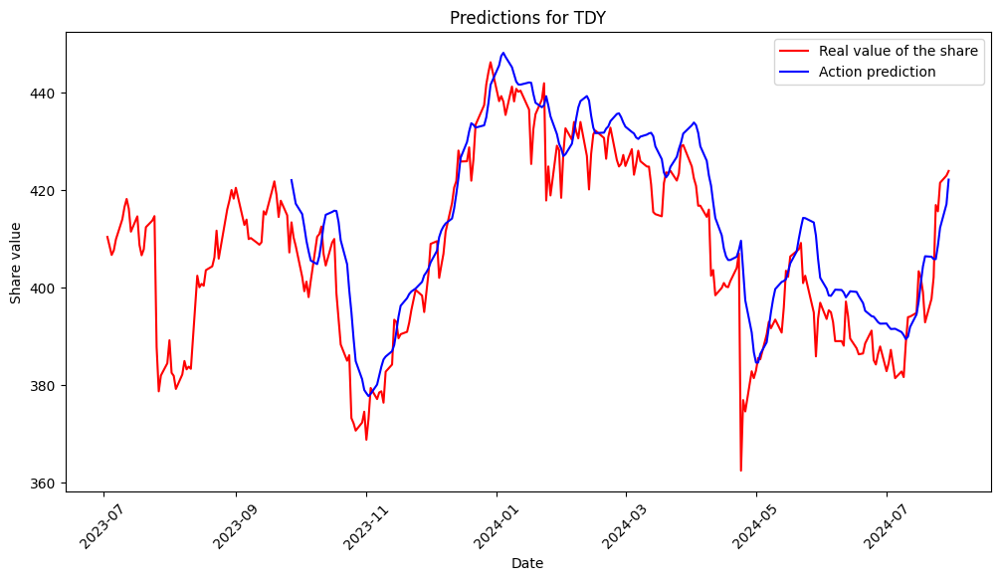

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for TDY: 86.63239437321772
Normalized Mean Squared Error (Normalized MSE) for TDY: 0.000522670372334673
Mean Absolute Error (MAE) for TDY: 7.157973190111648
R^2 Score for TDY: 0.7706654710654286
Processing WDC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for WDC.


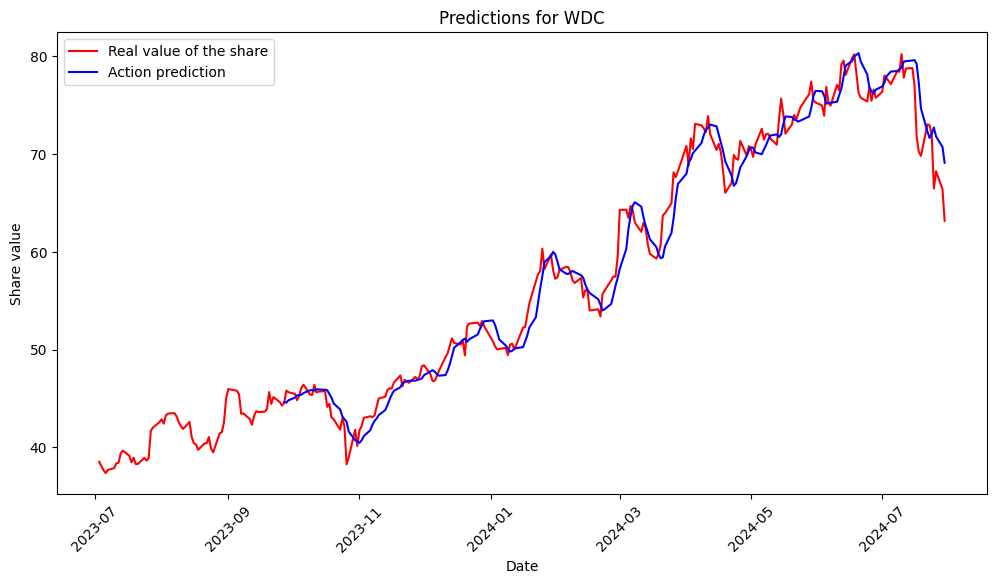

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.4 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.5 K    Trainable params
0         Non-trainabl

Mean Squared Error (MSE) for WDC: 3.7680263780000987
Normalized Mean Squared Error (Normalized MSE) for WDC: 0.0011888709590265536
Mean Absolute Error (MAE) for WDC: 1.4364926572297358
R^2 Score for WDC: 0.9746428715970756
Processing STX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Model saved for STX.


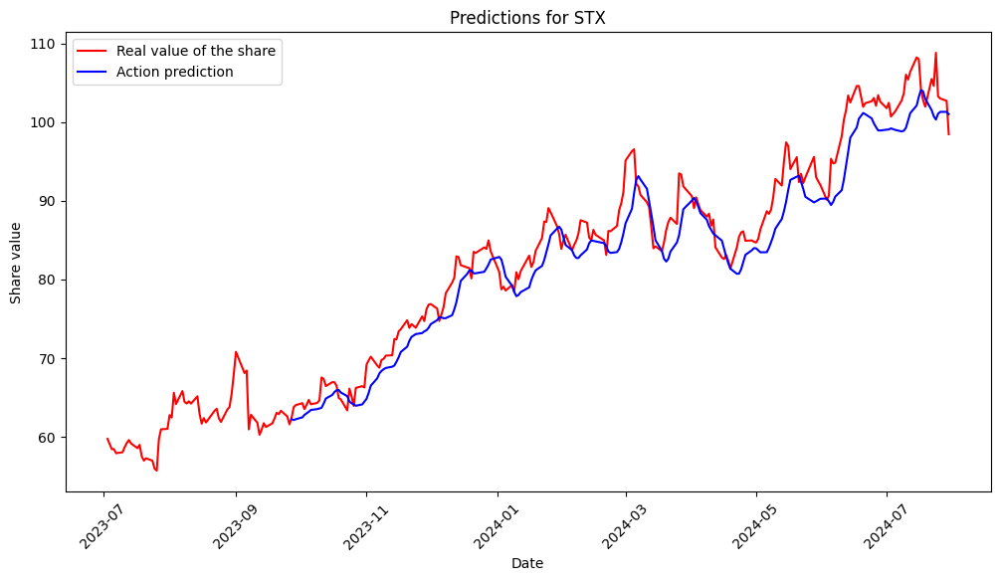

Mean Squared Error (MSE) for STX: 10.549579989819561
Normalized Mean Squared Error (Normalized MSE) for STX: 0.0016431373777723555
Mean Absolute Error (MAE) for STX: 2.625333968946561
R^2 Score for STX: 0.922968151040465
   ticker         mse  mse_normalizado        mae        r2
0    AAPL   22.656641         0.000652   3.702437  0.917405
1    MSFT   88.459820         0.000610   7.873926  0.935776
2    NVDA  455.809045         0.091816  15.877178  0.454067
3    AVGO  200.431270         0.015419   9.488339  0.687747
4    ORCL   14.272793         0.001048   2.766217  0.903111
..    ...         ...              ...        ...       ...
59   JNPR    1.556733         0.001534   0.939321  0.918934
60    MSI   52.378809         0.000504   5.427615  0.954150
61    TDY   86.632394         0.000523   7.157973  0.770665
62    WDC    3.768026         0.001189   1.436493  0.974643
63    STX   10.549580         0.001643   2.625334  0.922968

[64 rows x 5 columns]
           AAPL        MSFT        N

<ipython-input-6-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))


In [6]:
# Función para entrenar modelos y hacer predicciones para cada ticker
def train_and_predict(ticker):
    data = stock_data[ticker]

    # Sets de entrenamiento y validación
    set_entrenamiento = data[:'2023-06-30'].loc[:, ['Adj Close', 'MA_10', 'MA_30', 'MA_60']]
    set_validacion = data['2023-07-01':].loc[:, ['Adj Close', 'MA_10', 'MA_30', 'MA_60']]

    # Normalización del set de entrenamiento y validación
    sc = MinMaxScaler(feature_range=(0, 1))
    set_entrenamiento_escalado = sc.fit_transform(set_entrenamiento)
    set_validacion_escalado = sc.transform(set_validacion)

    # Calcular el precio promedio de la acción en el conjunto de validación
    precio_promedio_validacion = set_validacion['Adj Close'].mean()

    # Preparar datos para PyTorch
    time_step = 60
    X_train = []
    Y_train = []
    m = len(set_entrenamiento_escalado)

    for i in range(time_step, m):
        X_train.append(set_entrenamiento_escalado[i-time_step:i])
        Y_train.append(set_entrenamiento_escalado[i, 0])  # Usar solo la columna 'Adj Close'

    X_train, Y_train = np.array(X_train), np.array(Y_train)
    X_train = torch.tensor(X_train, dtype=torch.float32)
    Y_train = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1)

    train_dataset = TensorDataset(X_train, Y_train)
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

    model_path = f'{ticker}_model.pth'
    if os.path.exists(model_path):
        # Cargar modelo existente con weights_only=True para evitar el warning
        model = LSTMModel()
        model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
        print(f"Model loaded for {ticker}.")
        final_loss = 'N/A'  # Asignar valor indicativo si el modelo fue cargado y no entrenado
    else:
        # Entrenamiento del modelo
        model = LSTMModel()
        loss_logger = LossLogger()
        trainer = pl.Trainer(max_epochs=20, logger=False, callbacks=[loss_logger])
        trainer.fit(model, train_loader)

        # Guardar el modelo
        torch.save(model.state_dict(), model_path)
        print(f"Model saved for {ticker}.")

        # Graficar la pérdida durante el entrenamiento
        # plot_loss(loss_logger, ticker)

        # Asignar el último valor de pérdida después del entrenamiento
        # final_loss = loss_logger.losses[-1][1] if hasattr(loss_logger, 'losses') and loss_logger.losses else None

    # Preparar datos de validación para la predicción
    X_test = []
    for i in range(time_step, len(set_validacion_escalado)):
        X_test.append(set_validacion_escalado[i-time_step:i])

    X_test = np.array(X_test)
    X_test = torch.tensor(X_test, dtype=torch.float32)

    # Predicción
    model.eval()
    with torch.no_grad():
        prediccion = model(X_test).numpy()

    prediccion = sc.inverse_transform(np.concatenate([prediccion, np.zeros((prediccion.shape[0], 3))], axis=1))[:, 0]

    # Graficar las predicciones
    graficar_predicciones(set_validacion.values[:, 0], prediccion, set_validacion.index, ticker)

    # Calcular métricas de evaluación
    mse = mean_squared_error(set_validacion.values[time_step:, 0], prediccion)
    mae = mean_absolute_error(set_validacion.values[time_step:, 0], prediccion)
    r2 = r2_score(set_validacion.values[time_step:, 0], prediccion)

    # Normalizar el MSE usando el precio promedio del conjunto de validación
    mse_normalizado = float(mse / (precio_promedio_validacion ** 2))

    print(f"Mean Squared Error (MSE) for {ticker}: {mse}")
    print(f"Normalized Mean Squared Error (Normalized MSE) for {ticker}: {mse_normalizado}")
    print(f"Mean Absolute Error (MAE) for {ticker}: {mae}")
    print(f"R^2 Score for {ticker}: {r2}")

    return {
        "ticker": ticker,
        "mse": mse,
        "mse_normalizado": mse_normalizado,
        "mae": mae,
        "r2": r2,
        #"final_loss": final_loss,
        "prediccion": prediccion  # Añadir las predicciones a los resultados
    }

# Almacenar resultados
resultados = []
predicciones = {}

# Hacer predicciones para cada ticker y almacenar métricas
for ticker in tickers:
    print(f"Processing {ticker}...")
    resultado = train_and_predict(ticker)
    resultados.append(resultado)
    predicciones[ticker] = resultado['prediccion']

# Crear DataFrame con resultados
resultados_df = pd.DataFrame(resultados)
#resultados_df = resultados_df[['ticker', 'mse', 'mse_normalizado', 'mae', 'r2', 'final_loss']]
resultados_df = resultados_df[['ticker', 'mse', 'mse_normalizado', 'mae', 'r2']]

# Mostrar la tabla de resultados
print(resultados_df)

# Guardar las predicciones futuras en un DataFrame
future_prices_df = pd.DataFrame(predicciones)
print(future_prices_df)



In [7]:
# Mostrar todo el DataFrame
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(resultados_df)



   ticker           mse  mse_normalizado        mae        r2
0    AAPL     22.656641         0.000652   3.702437  0.917405
1    MSFT     88.459820         0.000610   7.873926  0.935776
2    NVDA    455.809045         0.091816  15.877178  0.454067
3    AVGO    200.431270         0.015419   9.488339  0.687747
4    ORCL     14.272793         0.001048   2.766217  0.903111
5     AMD     58.315869         0.002896   5.981934  0.924180
6    CSCO      0.810715         0.000338   0.638179  0.778518
7     ACN     73.017372         0.000707   6.810803  0.904111
8    ADBE    275.290293         0.000941  12.286936  0.897372
9     TXN     43.448520         0.001550   5.348876  0.868652
10    IBM     68.536860         0.002728   6.506329  0.760326
11   QCOM     68.512131         0.003148   5.742038  0.933956
12   INTU    304.695408         0.000903  12.801261  0.877162
13   AMAT     47.150558         0.001538   5.102268  0.959859
14     MU     22.495279         0.002675   3.387362  0.960632
15   LRC

# **MODELO 2. INCLUSION DE ANALISIS DE SENTIMIENTOS CON VADER**


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MSFT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para NVDA descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para AVGO descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CRM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ORCL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AMD descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para CSCO descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ACN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ADBE descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para TXN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para IBM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para QCOM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para INTU descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AMAT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MU descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para LRCX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NOW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para PANW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para SNPS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CDNS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ANET descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para FTNT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para KLAC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para APH descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para TEL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MCHP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NXPI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ON descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MPWR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ADI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para KEYS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CDW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ANSS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para PAYC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para GDDY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TYL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para SSNC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para JKHY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para EPAM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para GLW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para HPQ descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para DXC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para IT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para LDOS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AKAM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NTAP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para VRSN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para FFIV descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para XRX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para JNPR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para CSGP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para GRMN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ZBRA descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para BR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para VRSN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para PTC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CTSH descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para HPE descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para JNPR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MSI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para TDY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para WDC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para STX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AAPL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AAPL:
MSE: 23.07626262391162
MSE Normalizado: 0.0006569003119699106
MAE: 3.827892105123363
R²: 0.9158750055368624


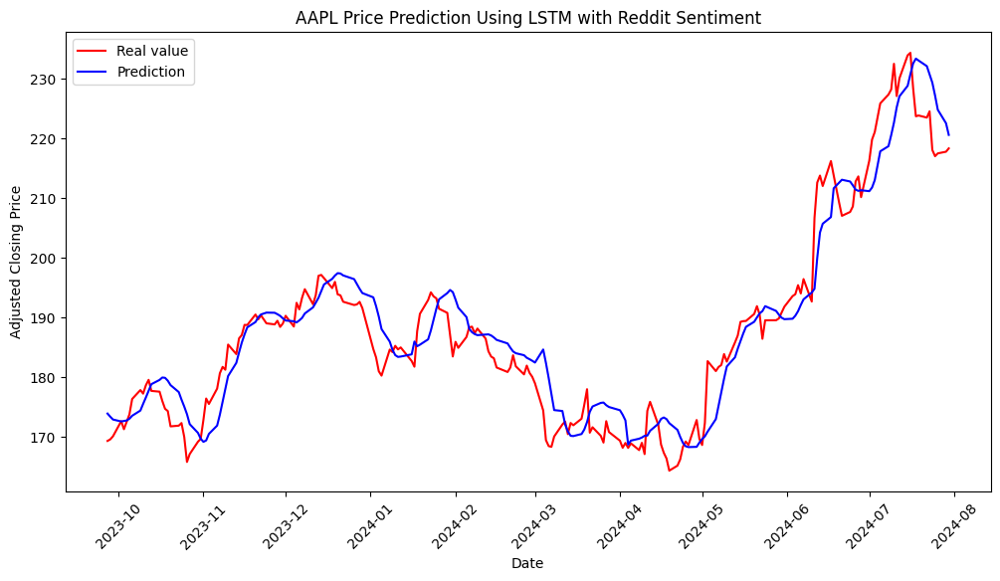

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MSFT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MSFT:
MSE: 57.3711625317338
MSE Normalizado: 0.0003660943162113153
MAE: 6.074002430605009
R²: 0.9583469436312019


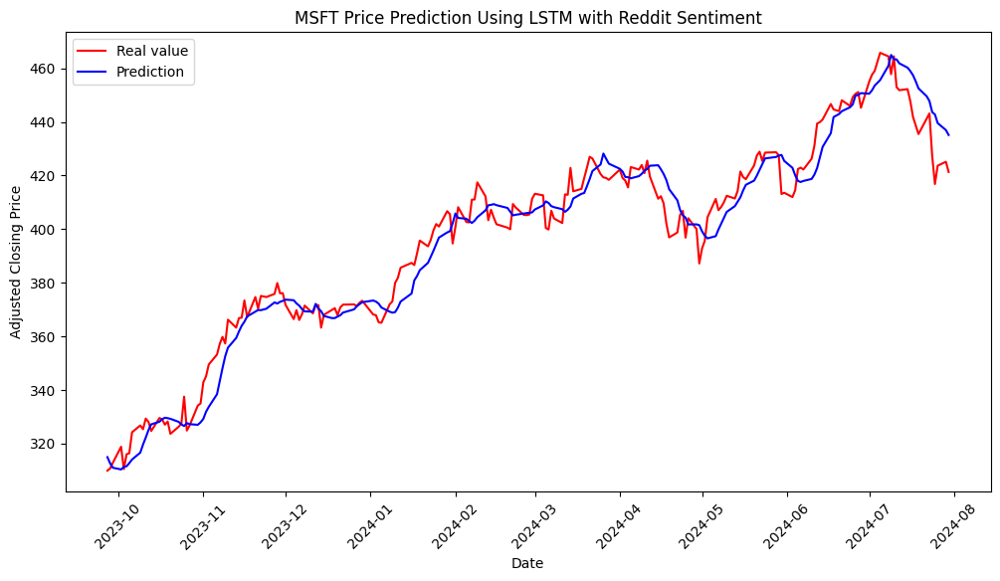

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NVDA...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NVDA:
MSE: 266.2575276415319
MSE Normalizado: 0.04406497016594387
MAE: 12.530501755518806
R²: 0.681097234078254


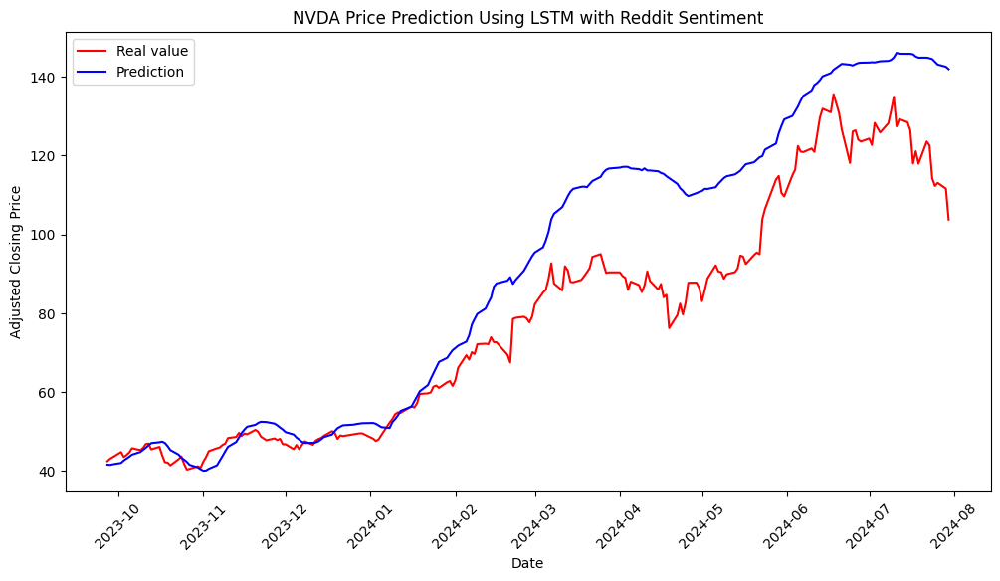

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AVGO...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AVGO:
MSE: 189.9173010579089
MSE Normalizado: 0.012713000940313838
MAE: 9.672816584625183
R²: 0.7041269247476254


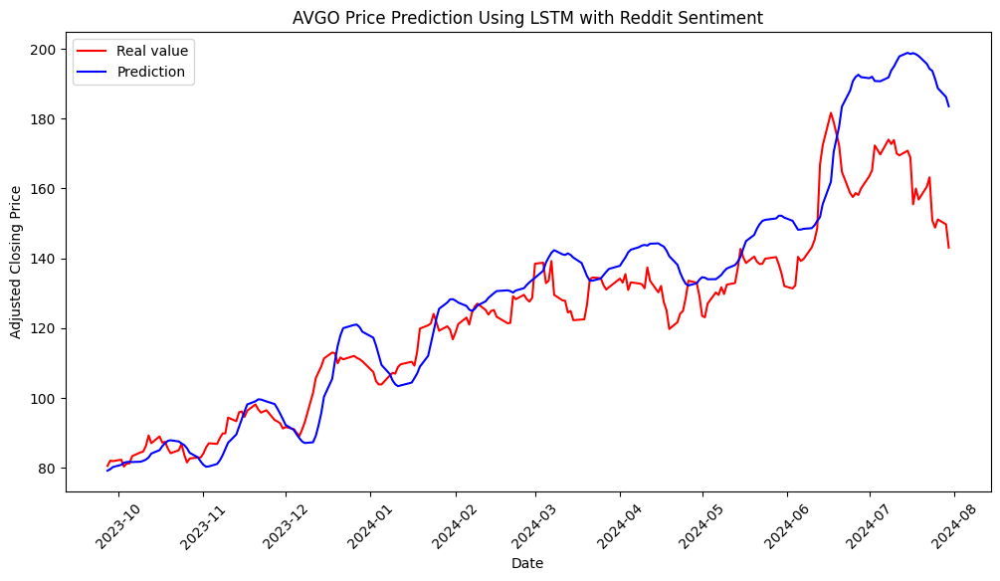

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CRM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CRM:
MSE: 67.23822693522479
MSE Normalizado: 0.0010086416305708156
MAE: 6.228965113610501
R²: 0.9357351292106284


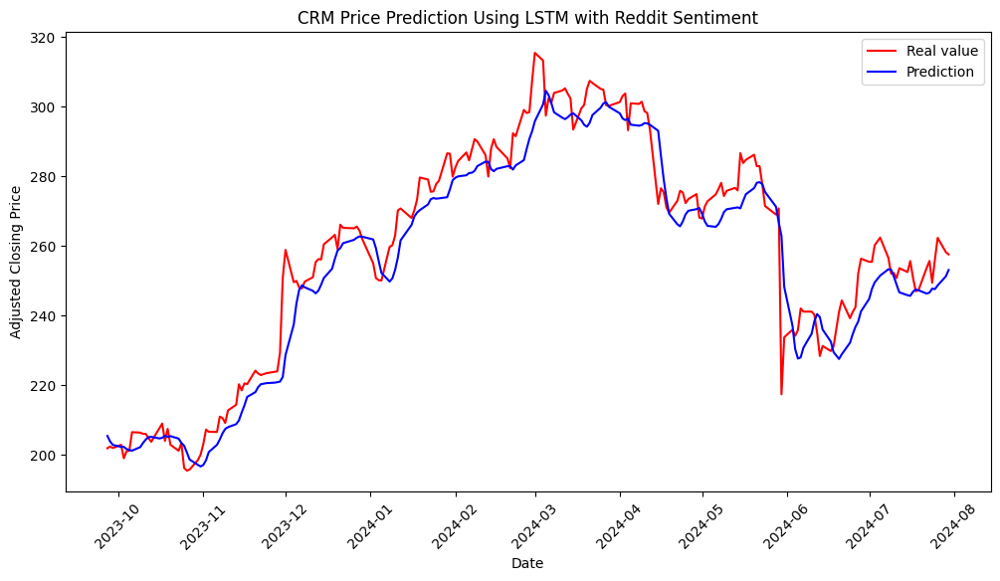

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ORCL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ORCL:
MSE: 11.802729694314973
MSE Normalizado: 0.0008570757819943397
MAE: 2.439469058074921
R²: 0.9198784236479912


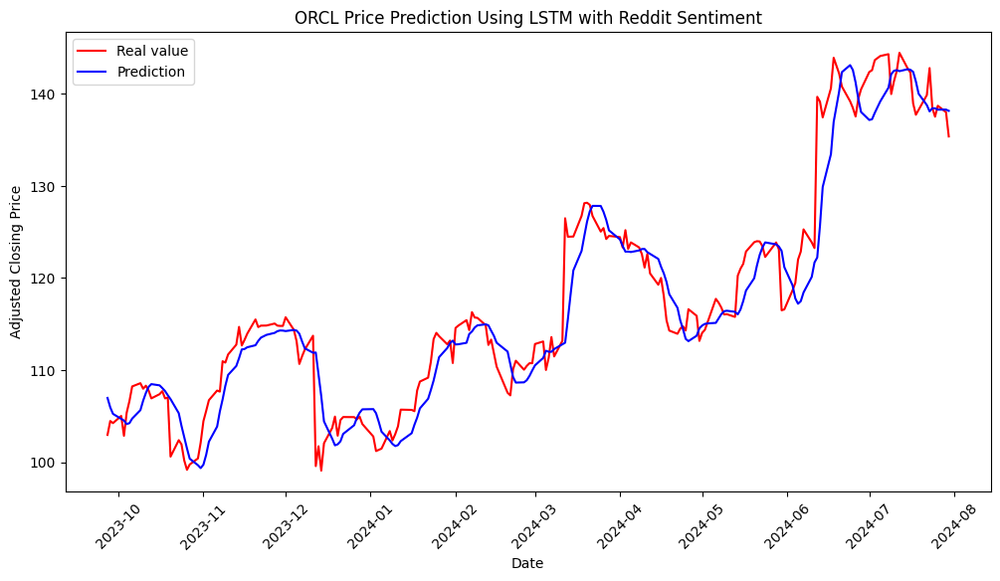

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AMD...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AMD:
MSE: 44.05136411489273
MSE Normalizado: 0.0019244363243919765
MAE: 5.084398425984456
R²: 0.942726295313987


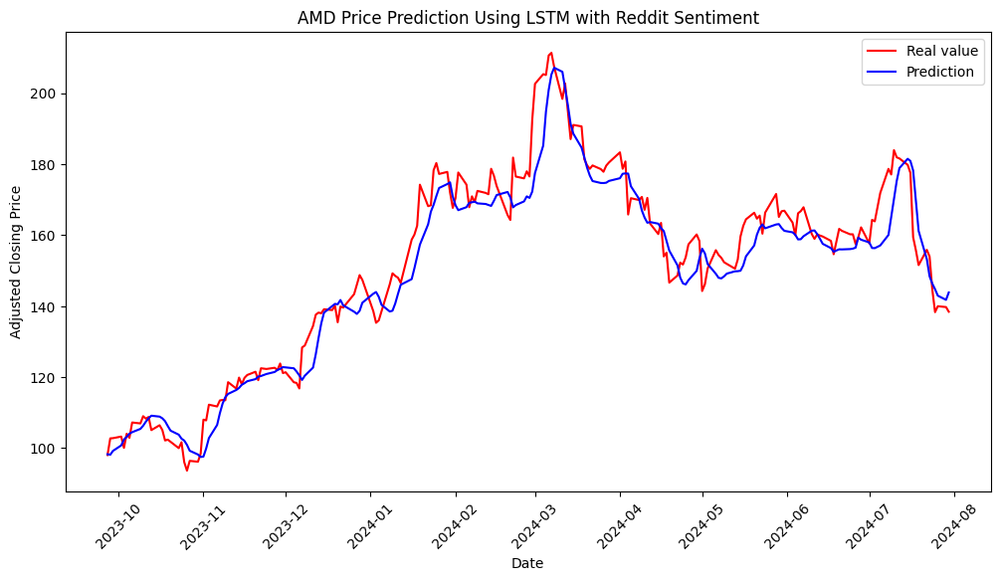

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CSCO...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CSCO:
MSE: 0.7132251453223304
MSE Normalizado: 0.0003072297069968
MAE: 0.6512892685162683
R²: 0.8051520333734853


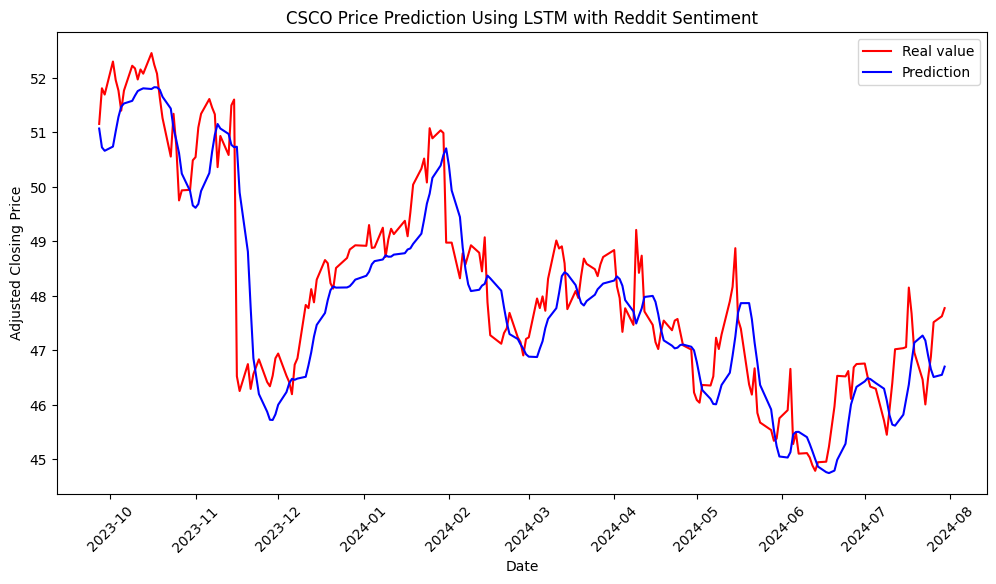

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ACN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ACN:
MSE: 88.06014419890737
MSE Normalizado: 0.0008338743378854986
MAE: 7.59945538532084
R²: 0.8843557508157082


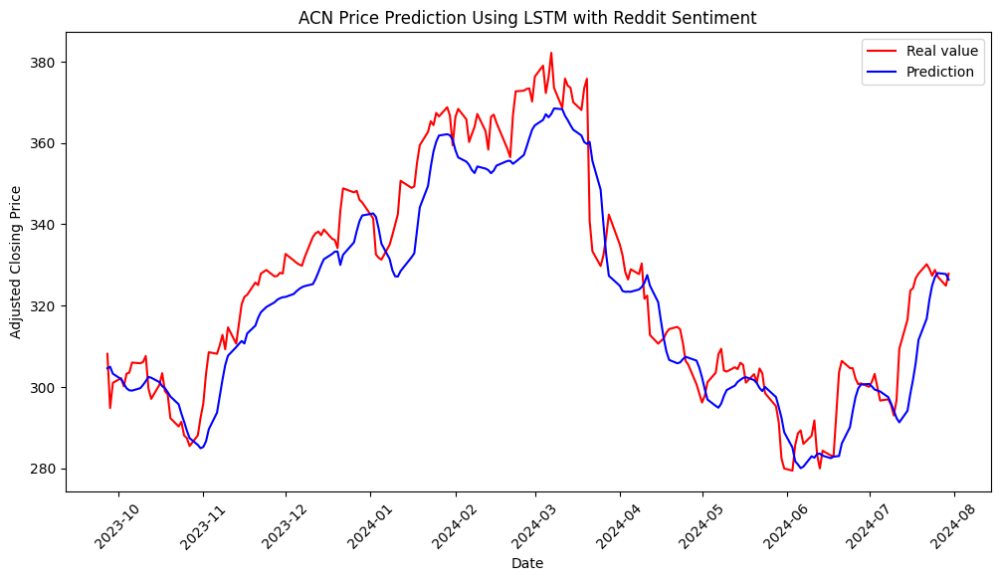

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ADBE...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ADBE:
MSE: 527.0850836599209
MSE Normalizado: 0.001774168015662025
MAE: 19.067077640453057
R²: 0.8035039585732993


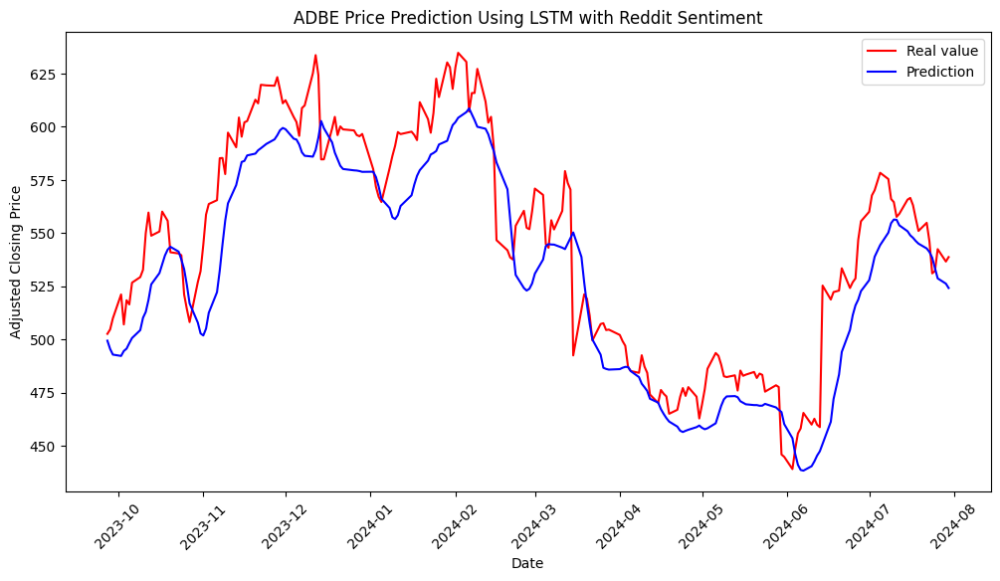

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TXN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TXN:
MSE: 17.693845835906878
MSE Normalizado: 0.0006254460385731322
MAE: 3.2787570126372287
R²: 0.9465100930126258


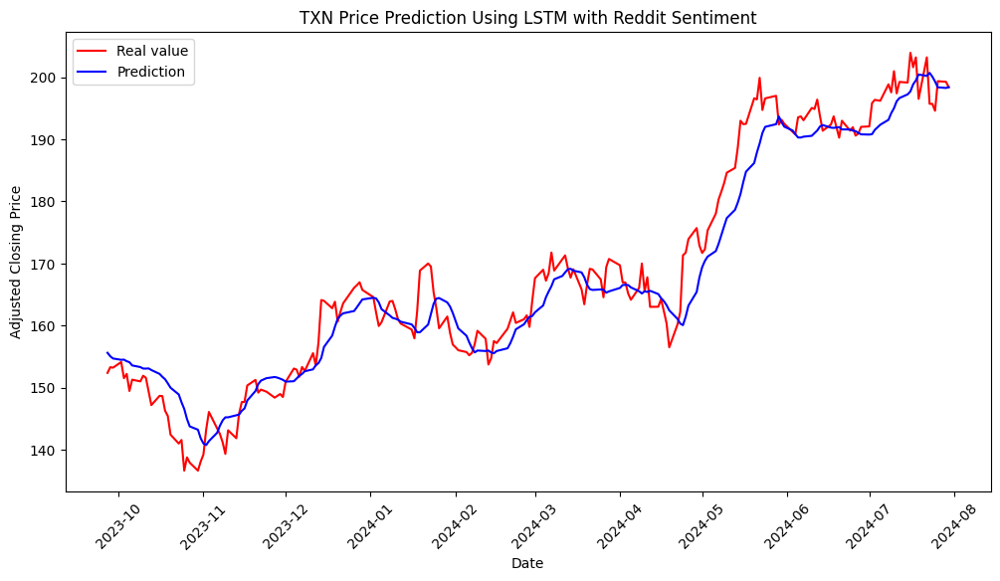

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando IBM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para IBM:
MSE: 13.232251190393175
MSE Normalizado: 0.00048521674163513195
MAE: 2.7124346011737823
R²: 0.9537266828078407


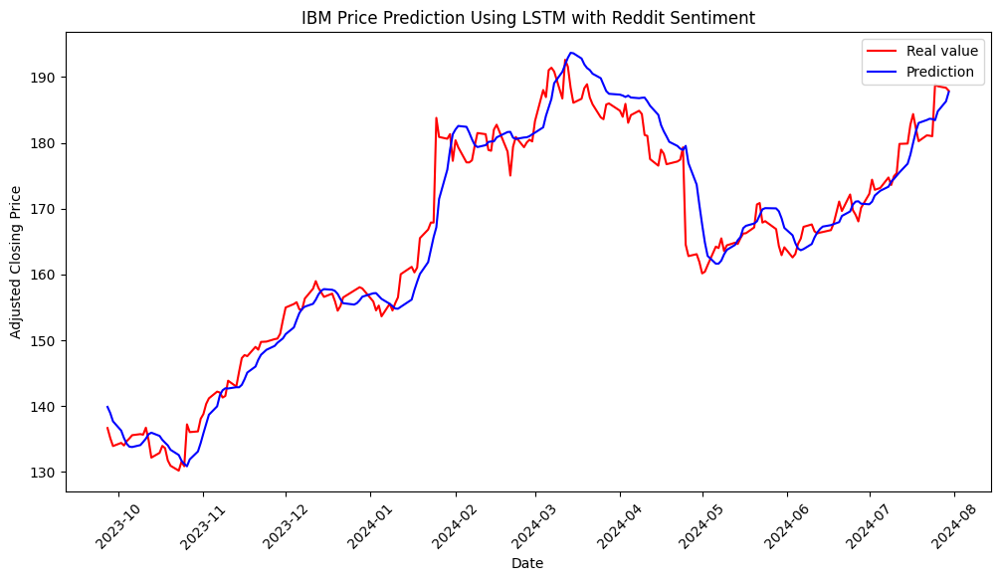

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando QCOM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para QCOM:
MSE: 40.90068588472694
MSE Normalizado: 0.001654155497587429
MAE: 5.062520889887846
R²: 0.960572773392605


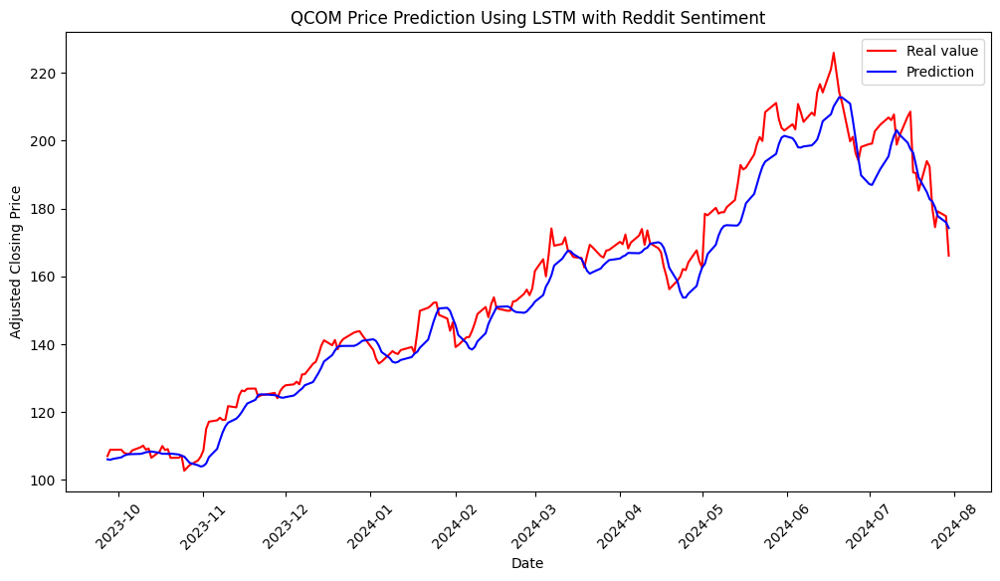

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando INTU...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para INTU:
MSE: 388.2975418893662
MSE Normalizado: 0.0010669960711676037
MAE: 16.357558807062986
R²: 0.8434581623970339


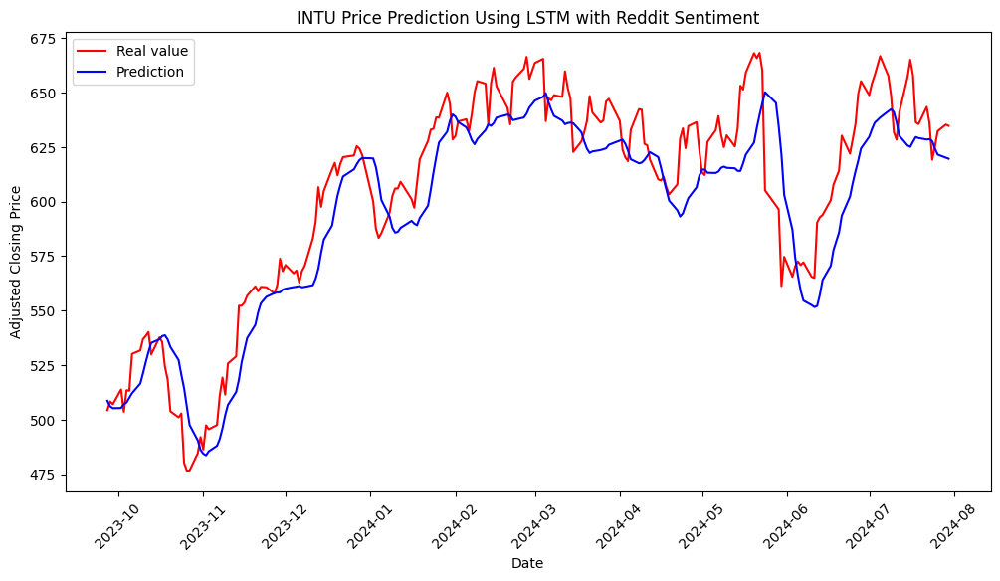

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AMAT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AMAT:
MSE: 198.17846300408334
MSE Normalizado: 0.005821997666654601
MAE: 11.793928093937328
R²: 0.831281344594708


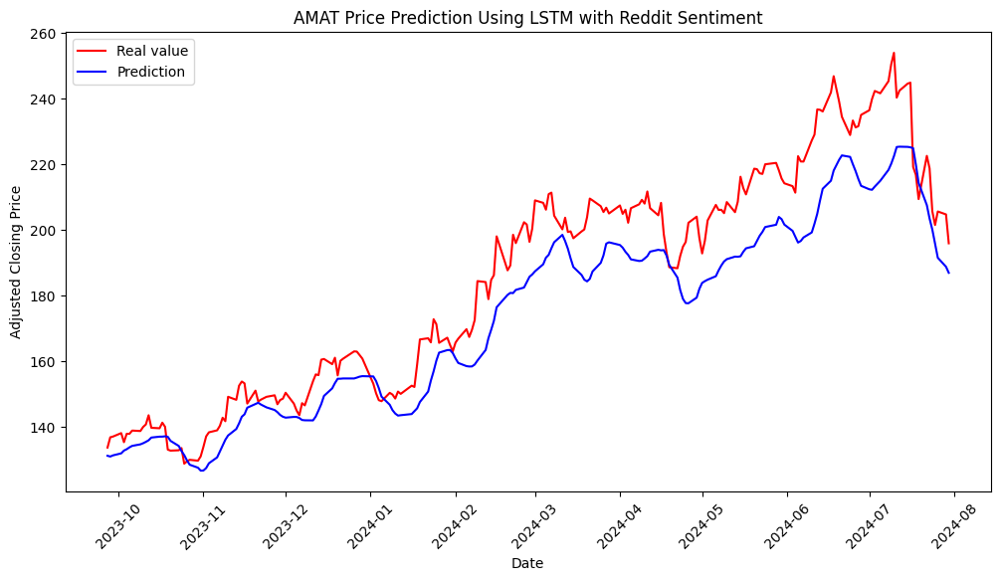

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MU...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MU:
MSE: 28.258245073468302
MSE Normalizado: 0.0028923827029350884
MAE: 3.9131257065327056
R²: 0.9505470708377985


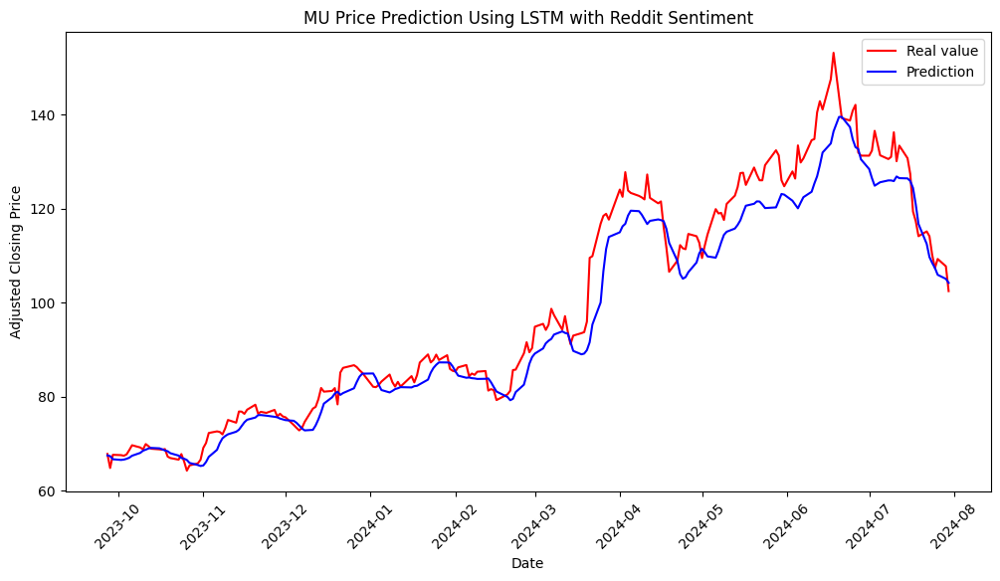

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando LRCX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para LRCX:
MSE: 57.04408715273308
MSE Normalizado: 0.00793391715598789
MAE: 5.845248322884816
R²: 0.7187404728266071


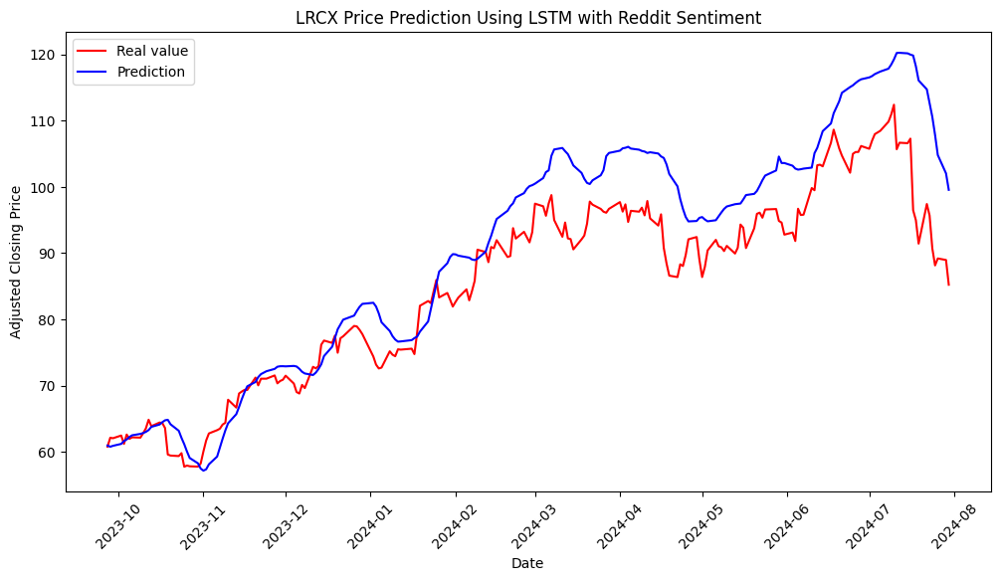

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NOW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NOW:
MSE: 486.34862285740405
MSE Normalizado: 0.0009624392855939284
MAE: 16.79372646421042
R²: 0.9075644032872917


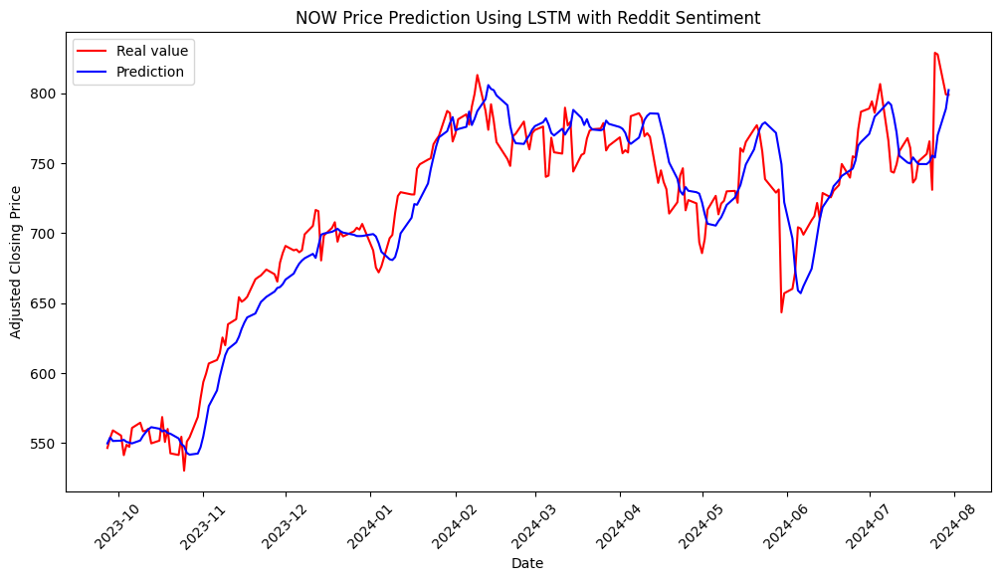

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PANW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PANW:
MSE: 784.200518511604
MSE Normalizado: 0.00890128837112903
MAE: 21.8027705201961
R²: 0.3098670775235266


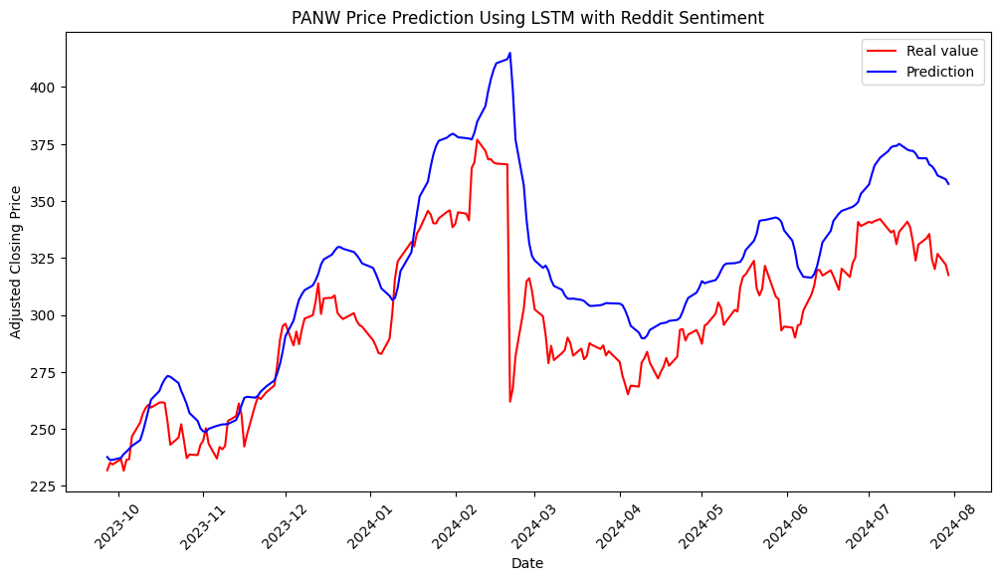

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando SNPS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para SNPS:
MSE: 322.2795343554395
MSE Normalizado: 0.0010831519839139263
MAE: 14.771226879406598
R²: 0.8083654526071061


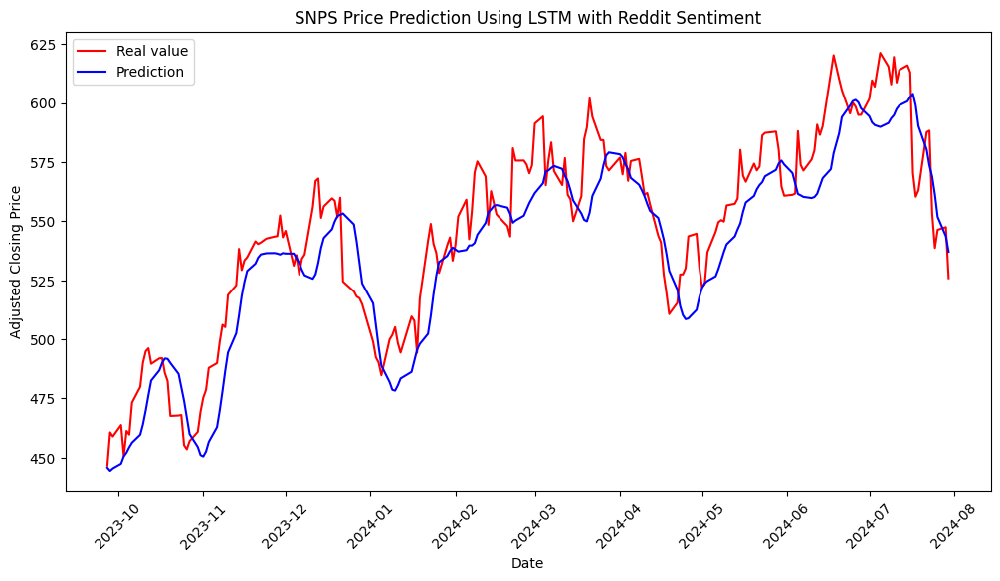

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CDNS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CDNS:
MSE: 87.11149637932449
MSE Normalizado: 0.0010840537402248254
MAE: 7.461465216190007
R²: 0.855096802600716


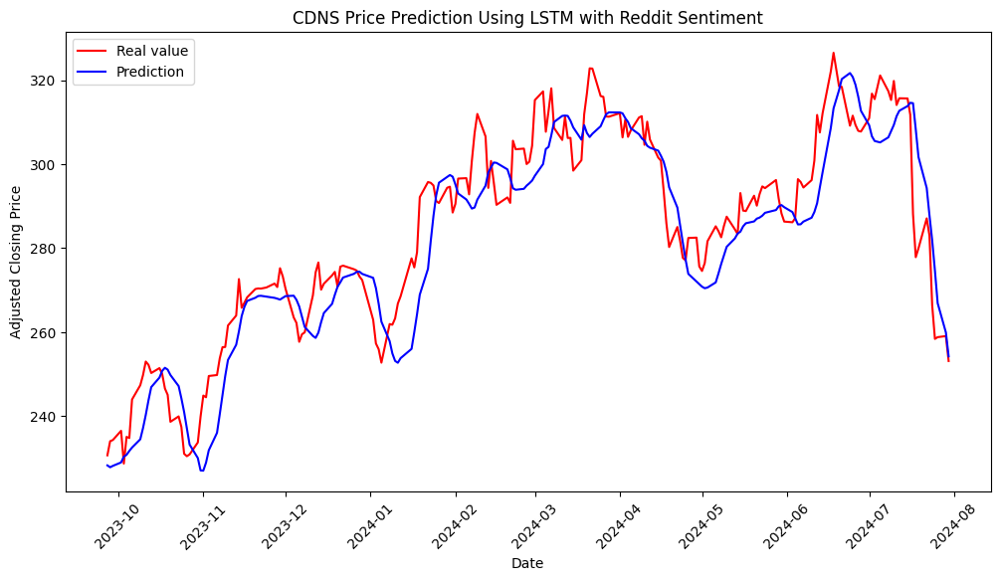

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ANET...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ANET:
MSE: 275.3107207138908
MSE Normalizado: 0.0038744425472955722
MAE: 13.016503312615633
R²: 0.8860564601710936


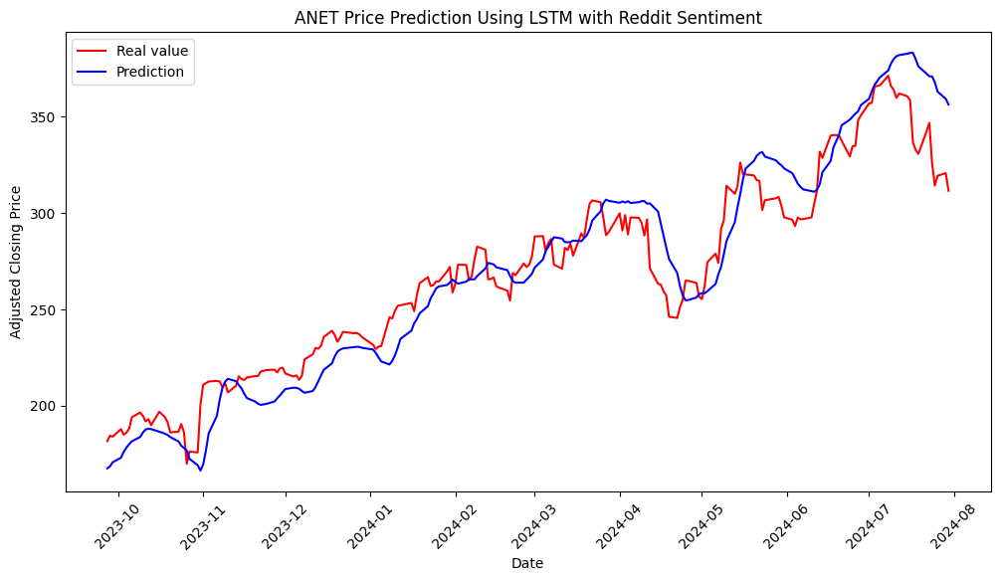

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando FTNT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para FTNT:
MSE: 5.816440611490979
MSE Normalizado: 0.0015624082500751704
MAE: 1.8573106985080126
R²: 0.812638070576668


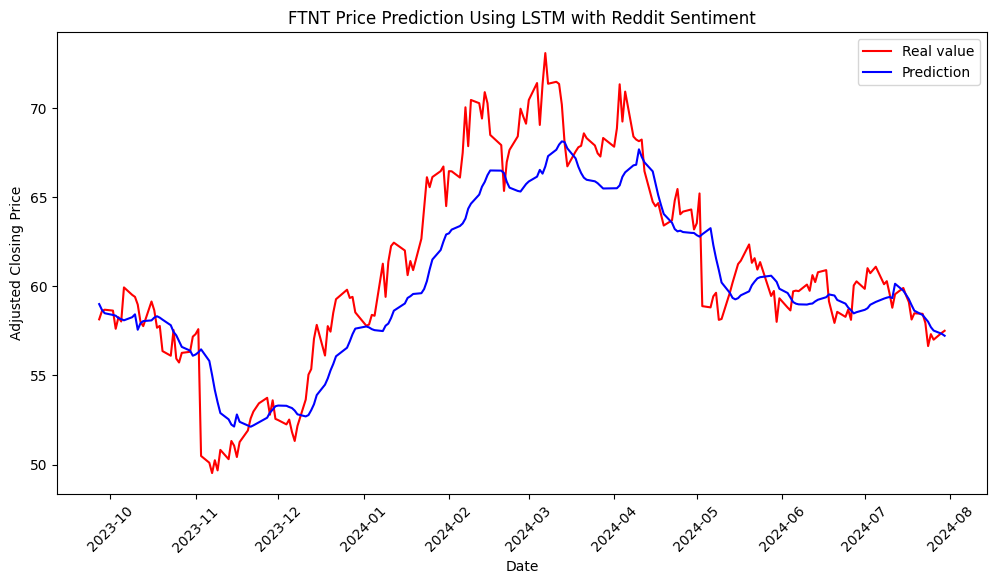

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando KLAC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para KLAC:
MSE: 1604.6306398519898
MSE Normalizado: 0.0038553208906724045
MAE: 29.116018024765207
R²: 0.8822773944664875


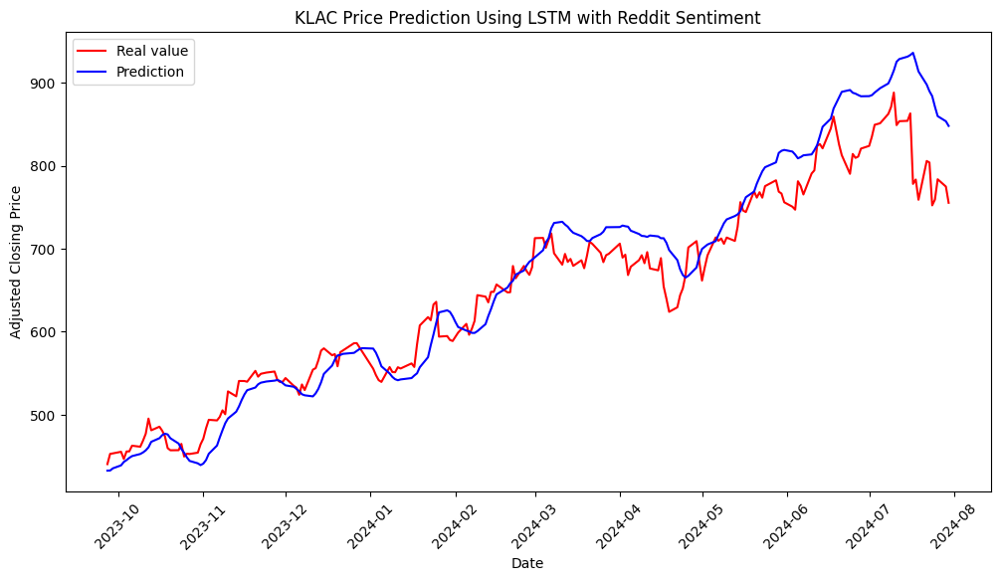

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando APH...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para APH:
MSE: 16.872320628065797
MSE Normalizado: 0.005765211012521165
MAE: 3.40412146089336
R²: 0.8031365659731133


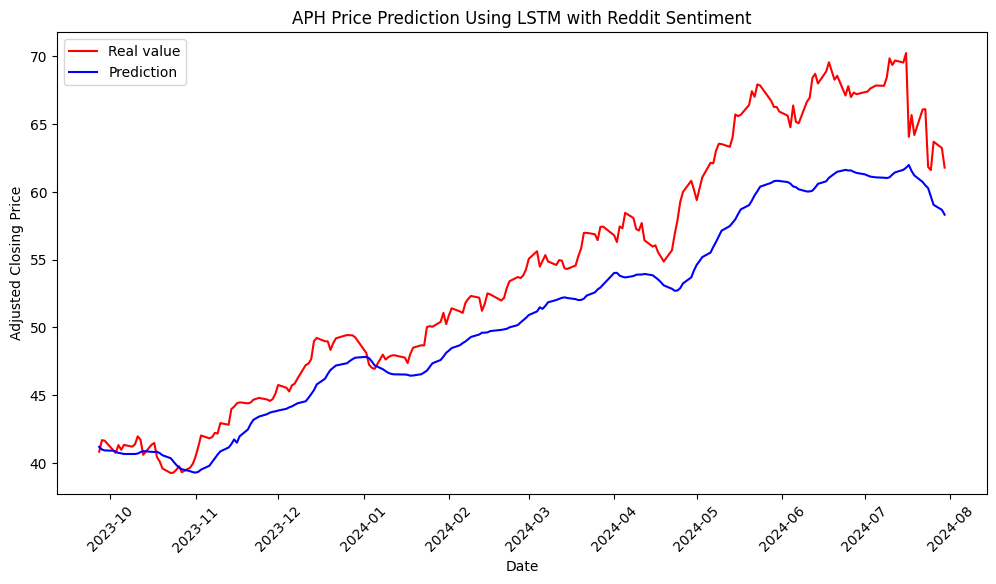

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TEL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TEL:
MSE: 10.068498964524894
MSE Normalizado: 0.0005262731516265766
MAE: 2.390915825847364
R²: 0.9097176156602284


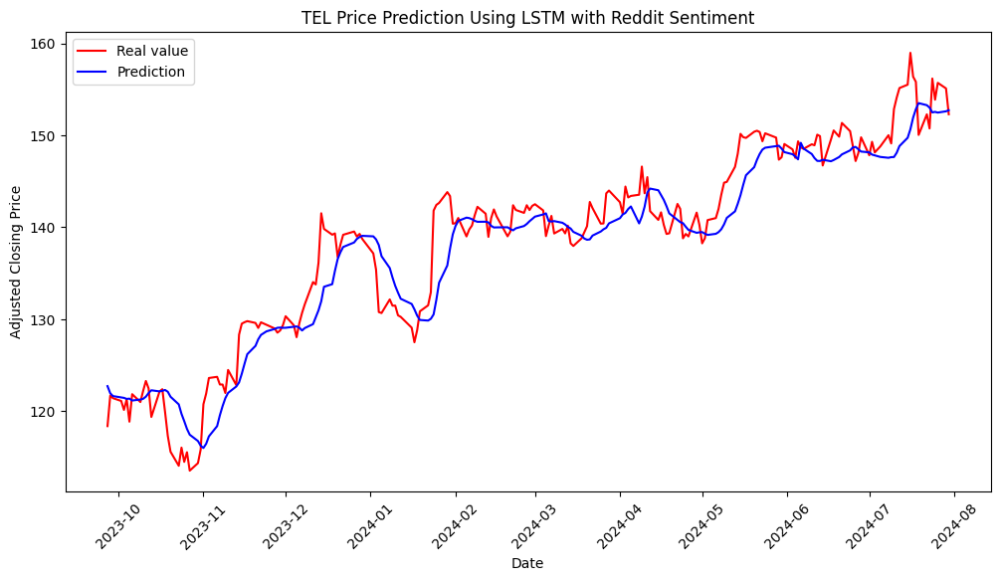

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MCHP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MCHP:
MSE: 9.26064016644709
MSE Normalizado: 0.0012799940493904965
MAE: 2.4088063246044453
R²: 0.7711431635929233


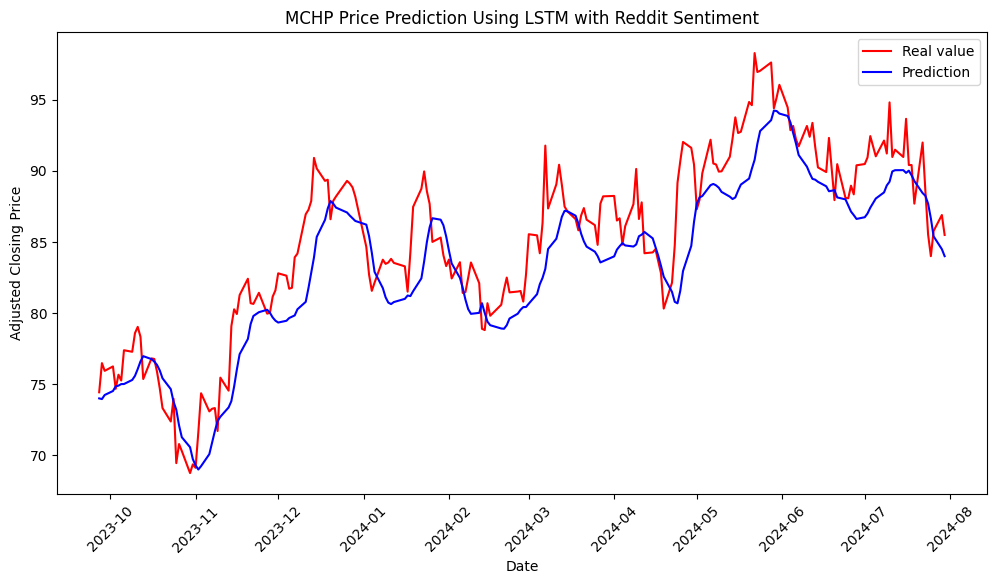

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NXPI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NXPI:
MSE: 51.31508488285632
MSE Normalizado: 0.0009602708790351432
MAE: 5.757495625299012
R²: 0.9453946387326331


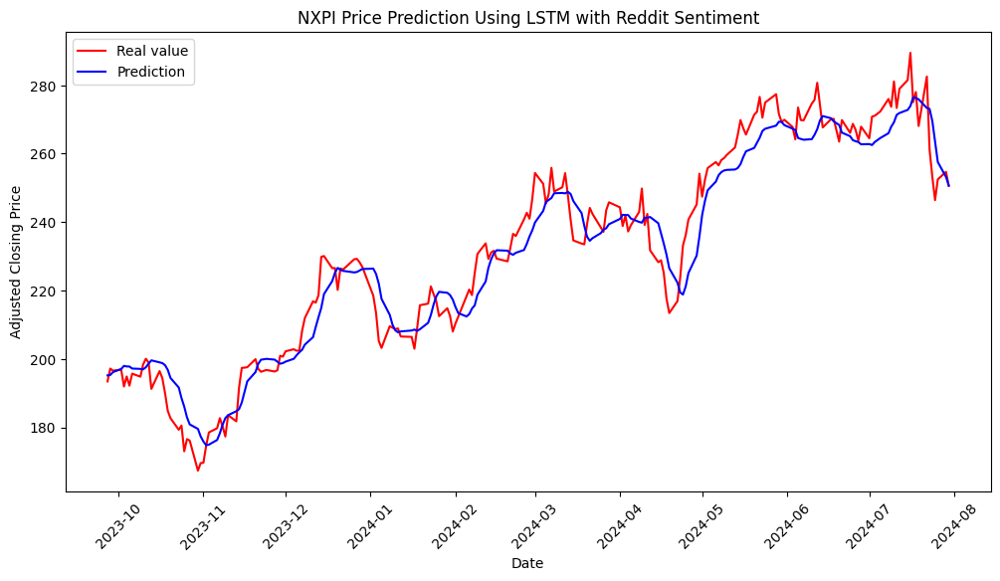

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ON...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ON:
MSE: 17.031966811194913
MSE Normalizado: 0.003010003152823172
MAE: 3.038677498880575
R²: 0.6599753166521162


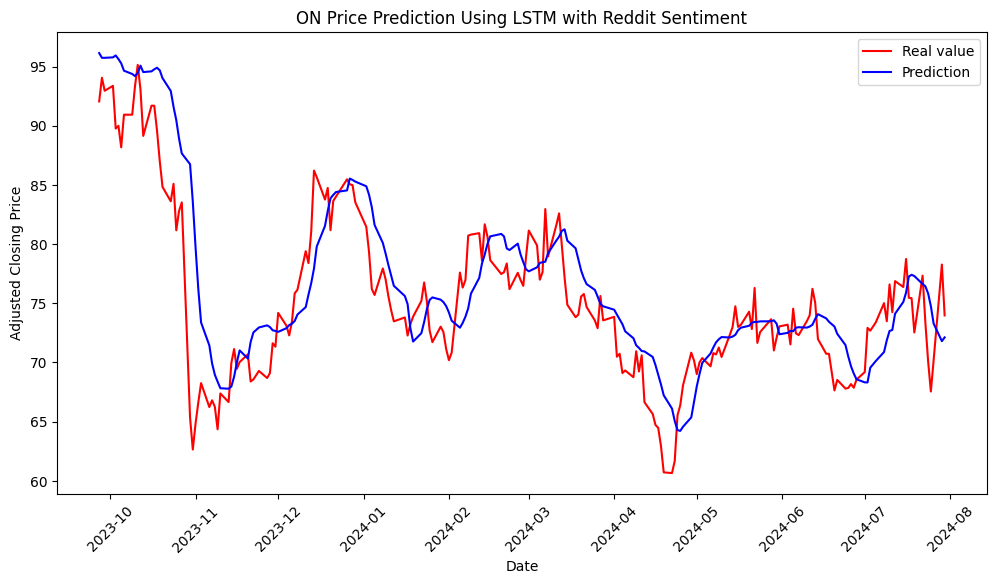

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MPWR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MPWR:
MSE: 1936.8897738203118
MSE Normalizado: 0.004566880504539246
MAE: 36.595944898834354
R²: 0.8642022966516858


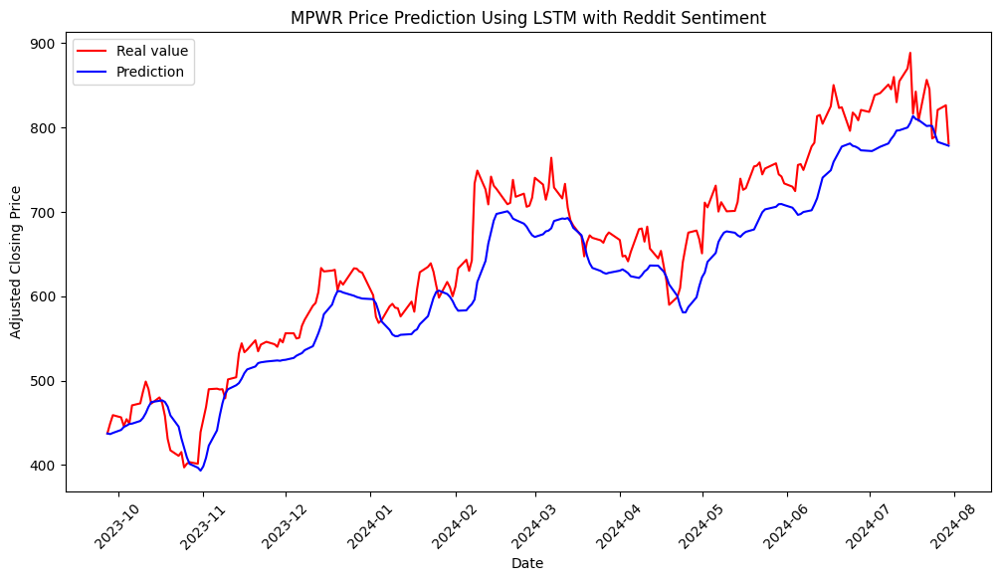

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ADI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ADI:
MSE: 58.190567594545605
MSE Normalizado: 0.0015119053026039367
MAE: 5.681510232393423
R²: 0.8802952711684341


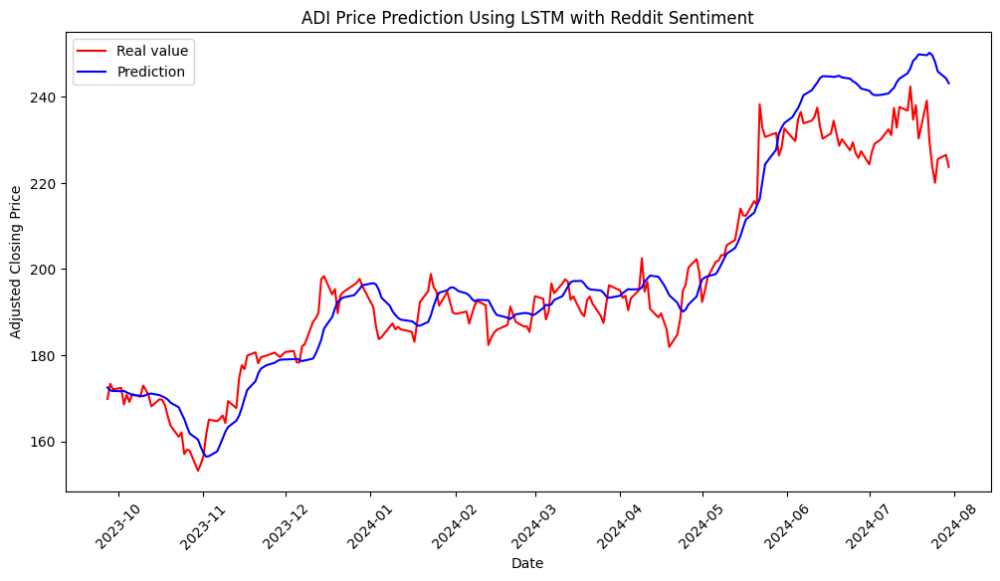

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando KEYS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para KEYS:
MSE: 14.474009881664493
MSE Normalizado: 0.0006946004191879234
MAE: 2.9624206104964026
R²: 0.8848291501007977


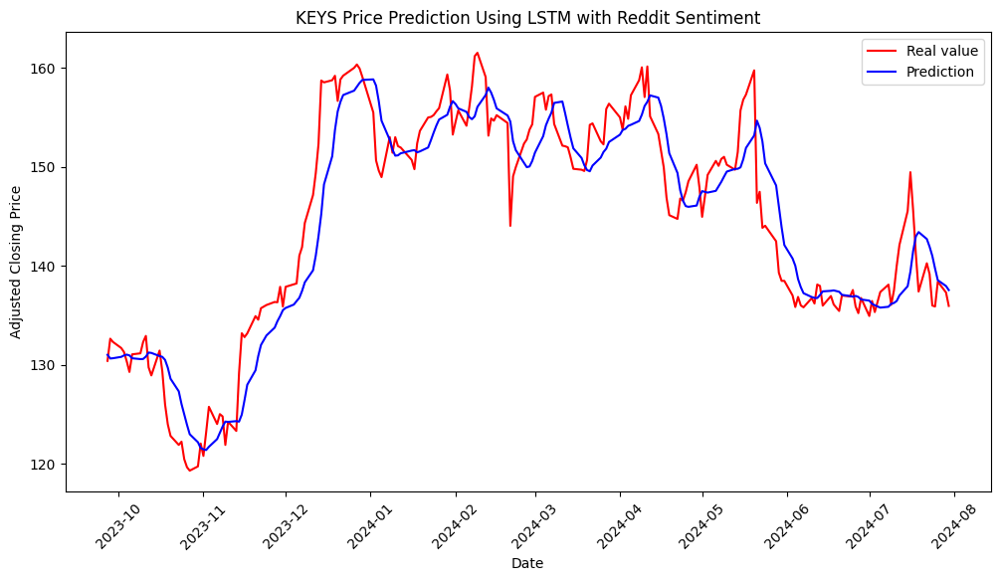

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CDW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CDW:
MSE: 126.86909635303655
MSE Normalizado: 0.0025199483813700347
MAE: 9.902660139388964
R²: 0.4452450614101563


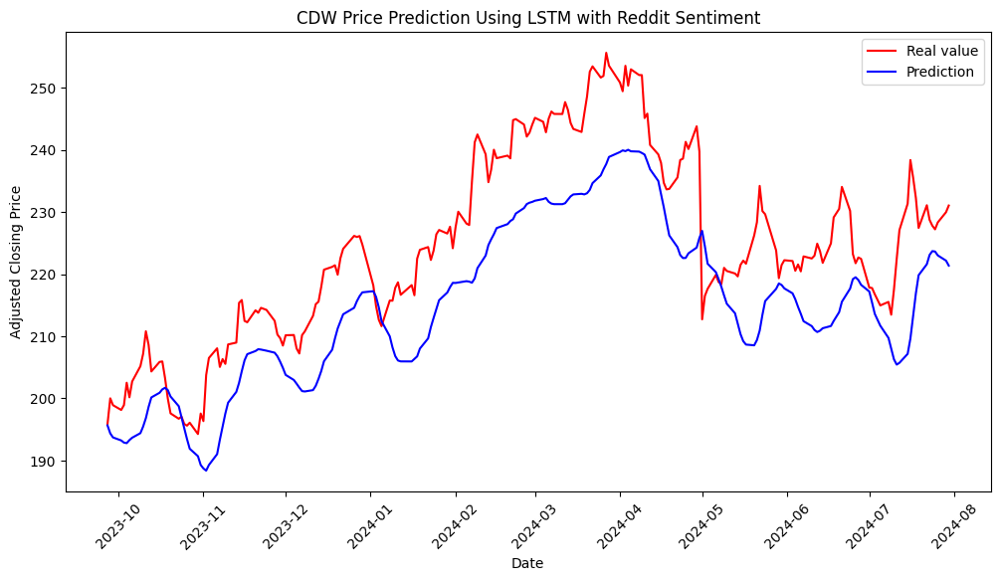

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ANSS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ANSS:
MSE: 74.82270727743035
MSE Normalizado: 0.000729321082995347
MAE: 5.563690971725177
R²: 0.8390779256409995


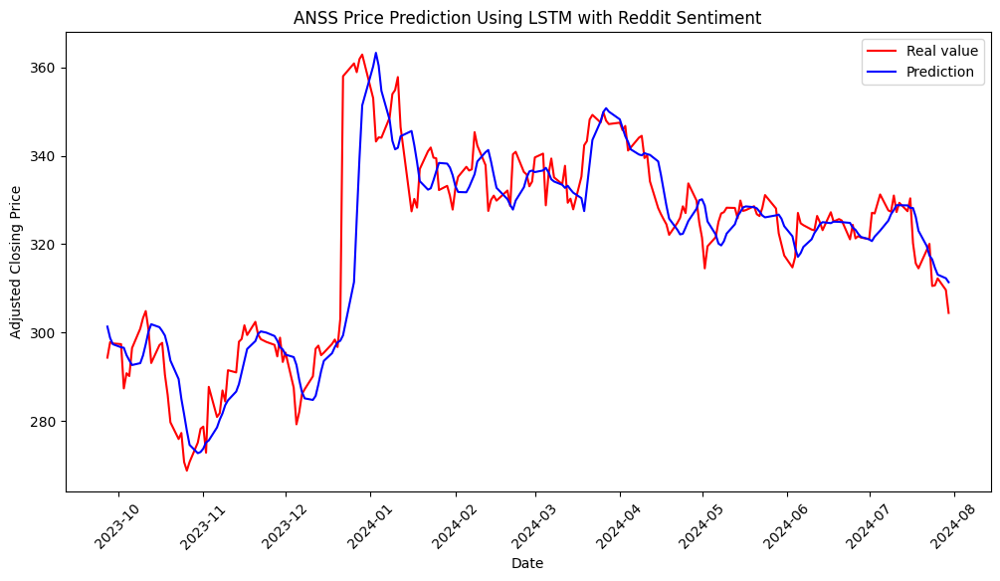

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PAYC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PAYC:
MSE: 385.84902549852336
MSE Normalizado: 0.011017936265186011
MAE: 16.33294436615888
R²: 0.6221374029191433


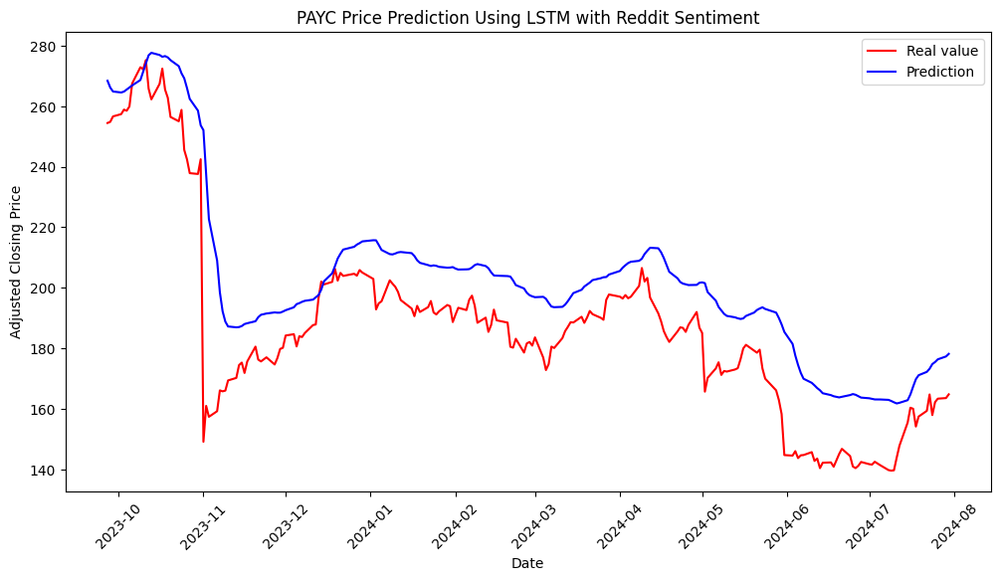

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GDDY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GDDY:
MSE: 15.187121518429615
MSE Normalizado: 0.001175341823418928
MAE: 3.2424539528976717
R²: 0.9677247860982529


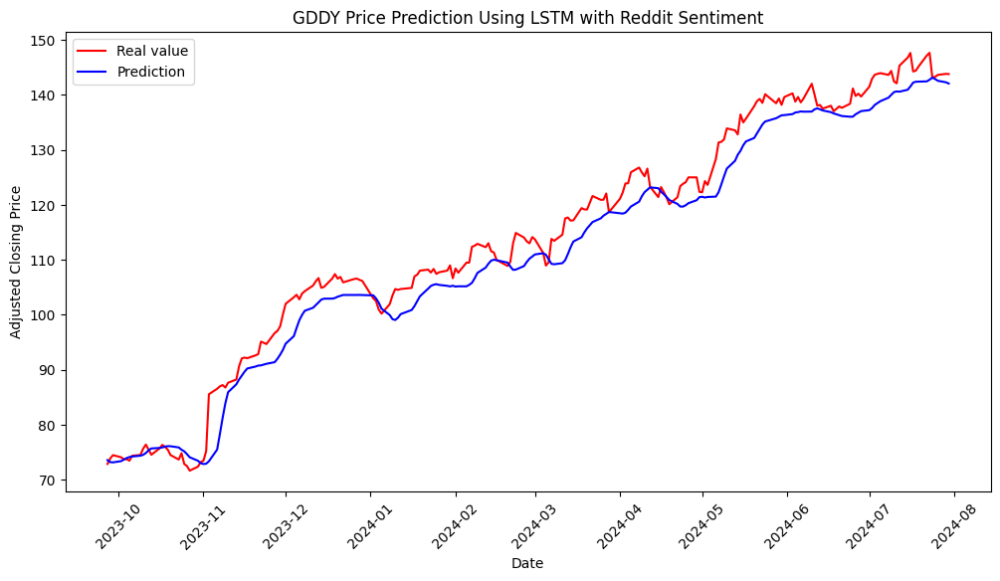

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TYL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TYL:
MSE: 130.51378103881933
MSE Normalizado: 0.0006785714954148022
MAE: 7.591742664720672
R²: 0.9341343081153332


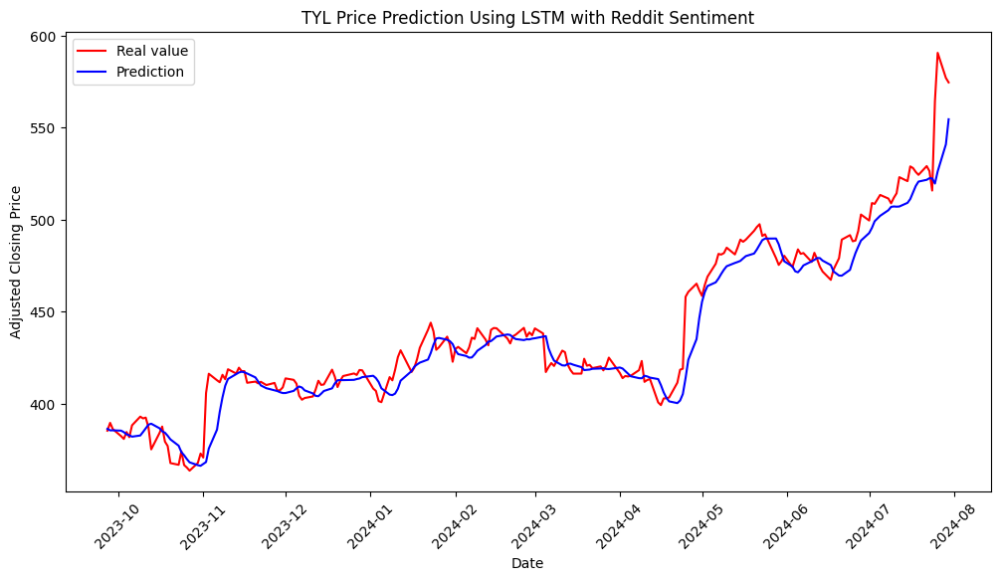

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando SSNC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para SSNC:
MSE: 2.246443589836734
MSE Normalizado: 0.0006327922486224388
MAE: 1.1371708256065192
R²: 0.9052107805383849


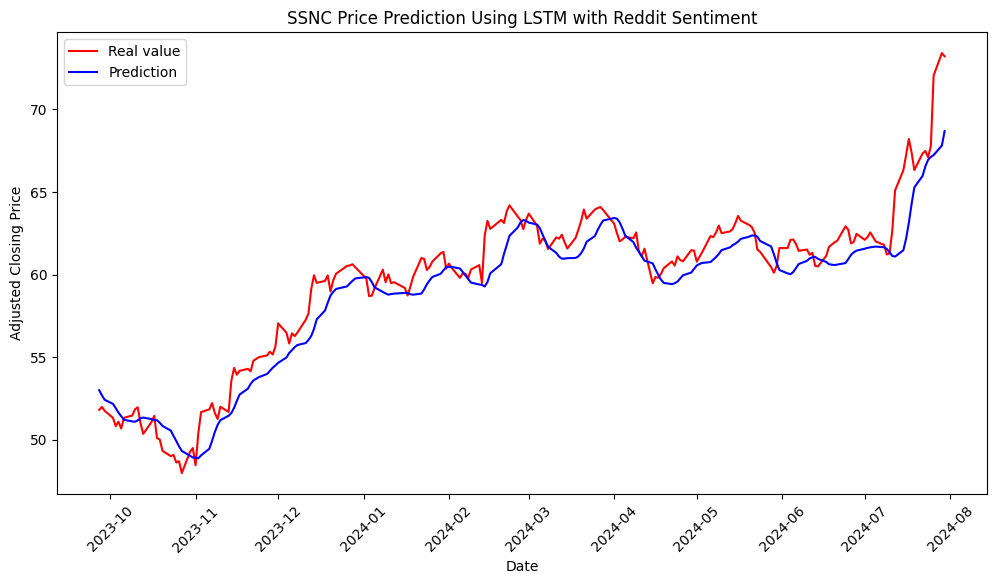

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JKHY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JKHY:
MSE: 8.087797676988751
MSE Normalizado: 0.0003085012655440407
MAE: 2.2329983273784286
R²: 0.9047421890133361


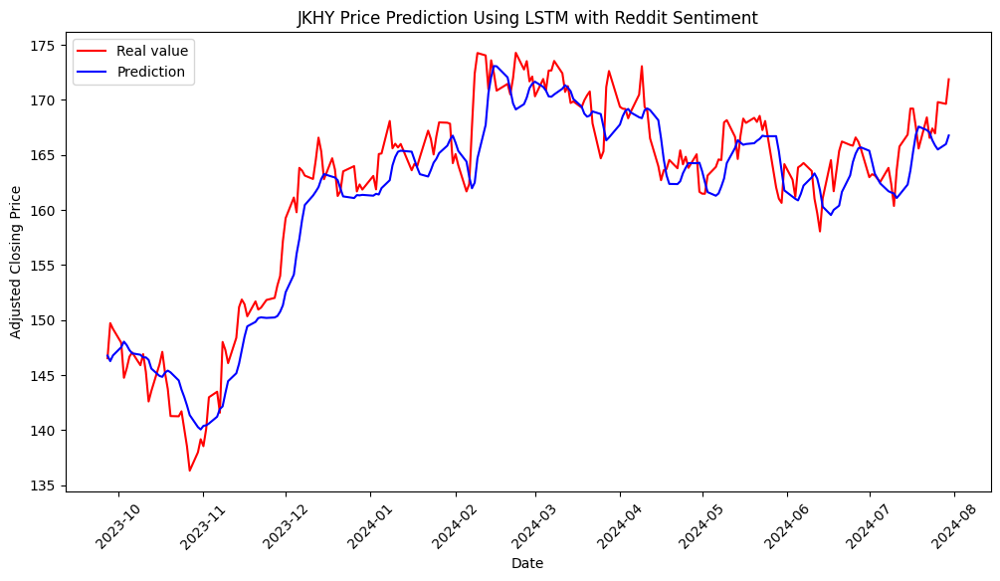

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando EPAM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para EPAM:
MSE: 169.78402745612433
MSE Normalizado: 0.0027600953823451995
MAE: 9.729738678483926
R²: 0.9087138212036762


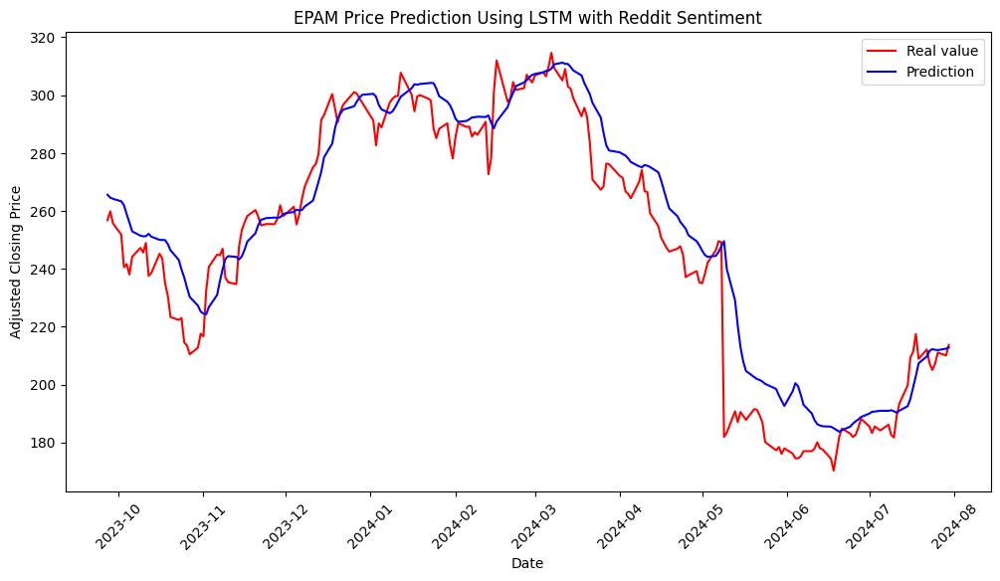

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GLW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GLW:
MSE: 1.4493681886654823
MSE Normalizado: 0.001404779402960101
MAE: 0.7773069683708752
R²: 0.9359496064026398


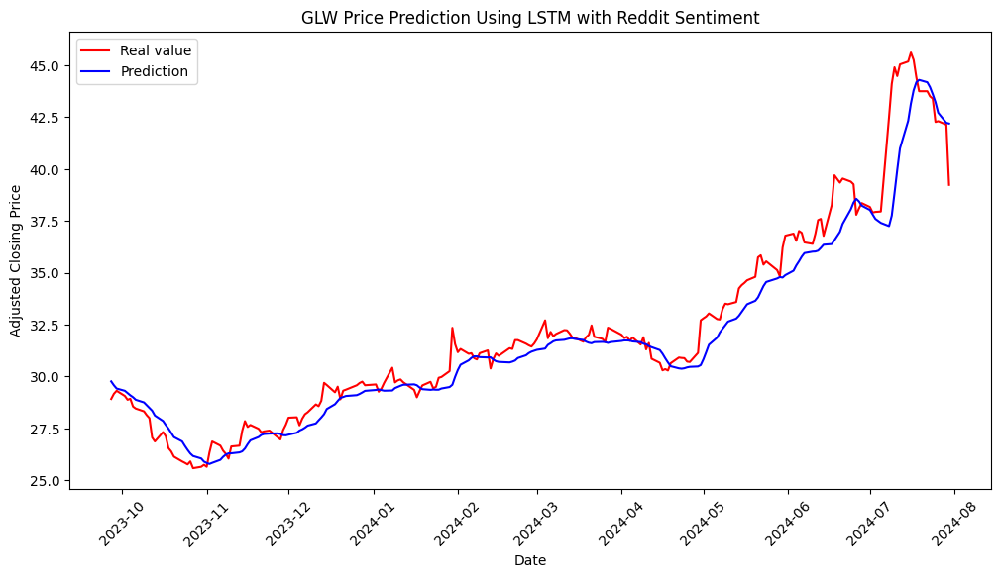

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando HPQ...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para HPQ:
MSE: 0.5975193029319562
MSE Normalizado: 0.0006773419712240198
MAE: 0.5515930637894447
R²: 0.9502299252143064


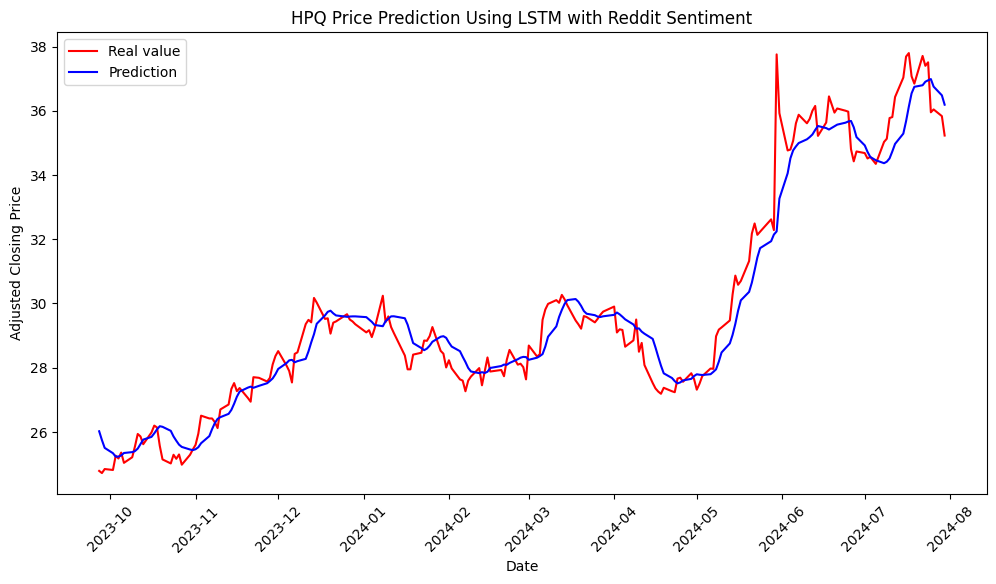

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando DXC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para DXC:
MSE: 0.690849531523288
MSE Normalizado: 0.0016014465771353242
MAE: 0.5847574030823253
R²: 0.8417225431022493


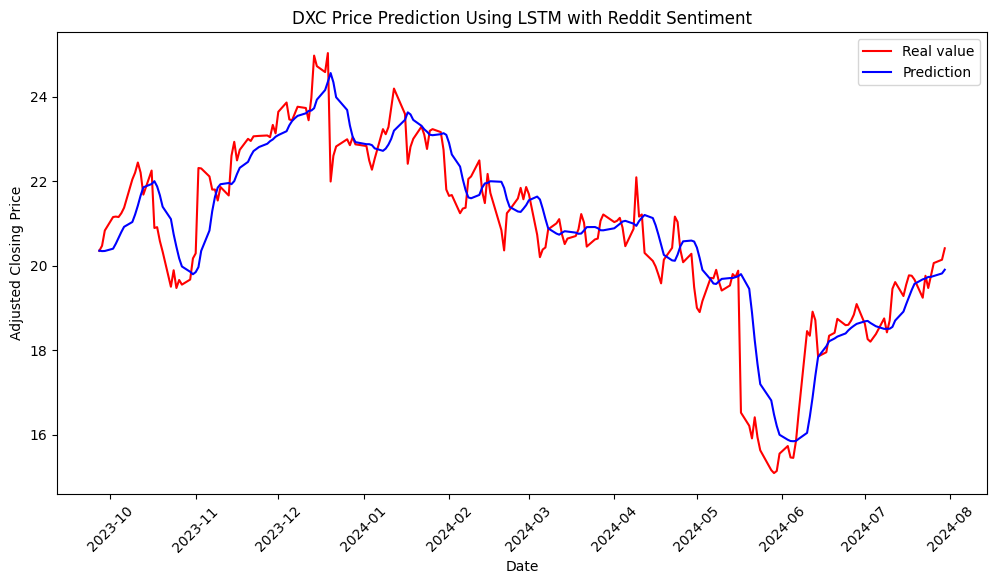

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando IT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para IT:
MSE: 1289.74169361095
MSE Normalizado: 0.006792343376386971
MAE: 33.41327302248324
R²: 0.1510205378518461


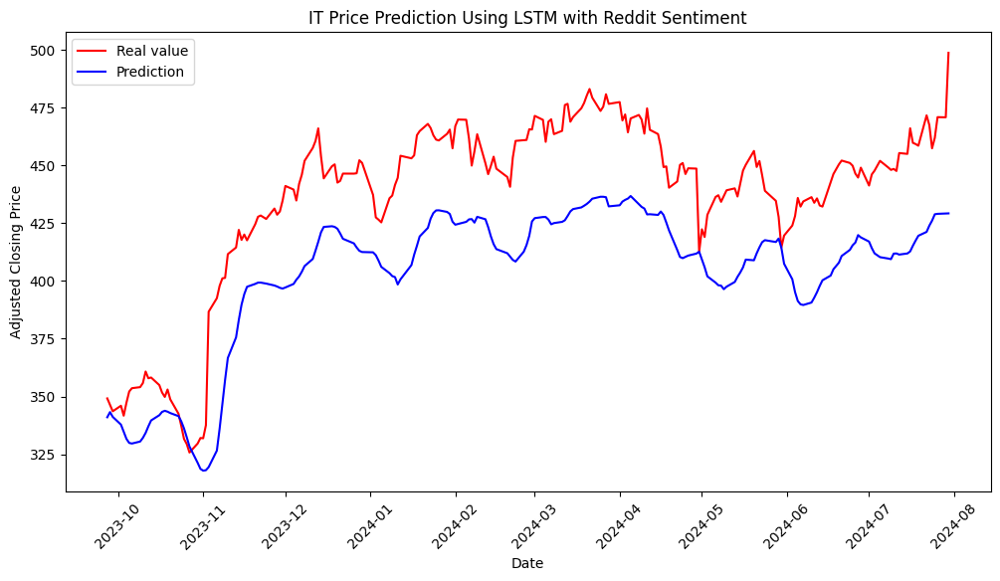

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando LDOS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para LDOS:
MSE: 36.62037993157264
MSE Normalizado: 0.0024629435391505805
MAE: 5.161814882630575
R²: 0.9010912892971671


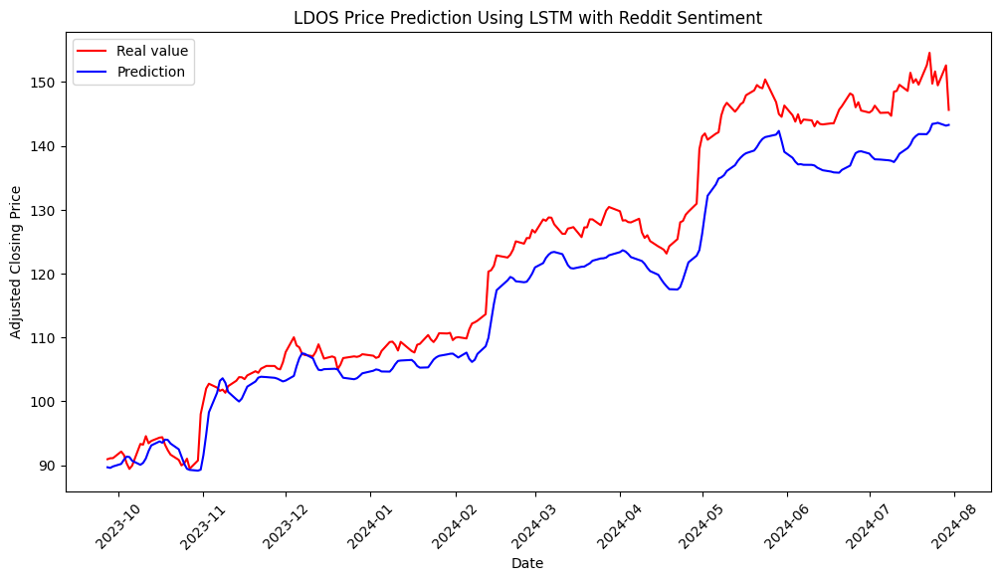

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AKAM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AKAM:
MSE: 5.802209546747429
MSE Normalizado: 0.0005130835552591733
MAE: 1.633941563615791
R²: 0.9455509106708806


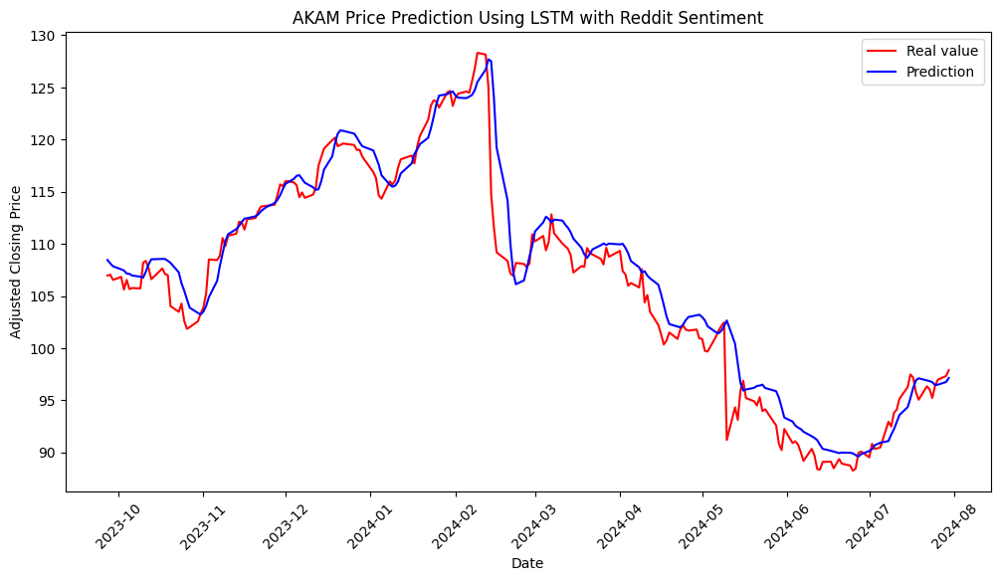

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NTAP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NTAP:
MSE: 9.419073118839403
MSE Normalizado: 0.0009997396333097255
MAE: 2.1227075410629497
R²: 0.9715741213112093


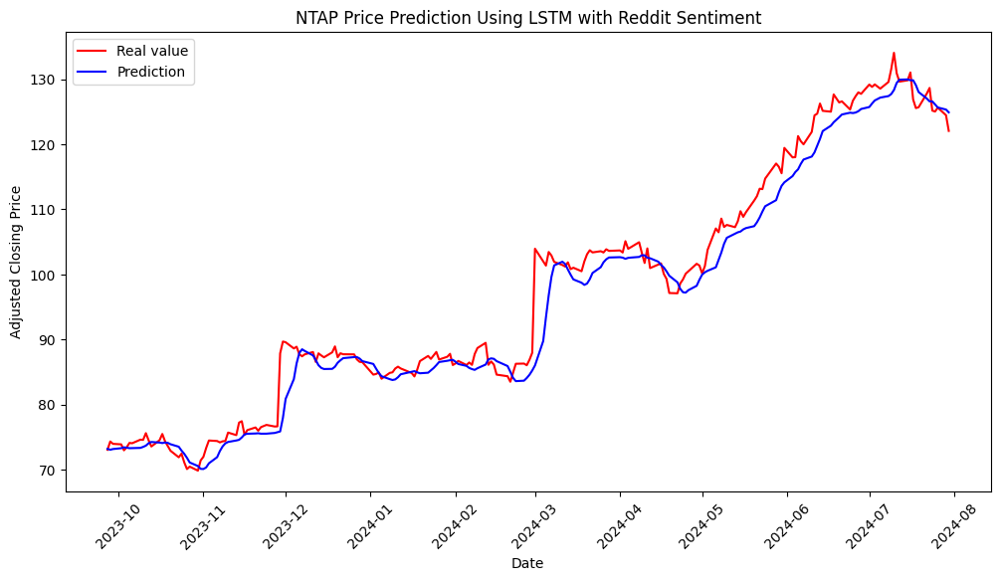

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando VRSN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para VRSN:
MSE: 11.714574756319594
MSE Normalizado: 0.00031529729299764814
MAE: 2.677429965447371
R²: 0.9395012555262268


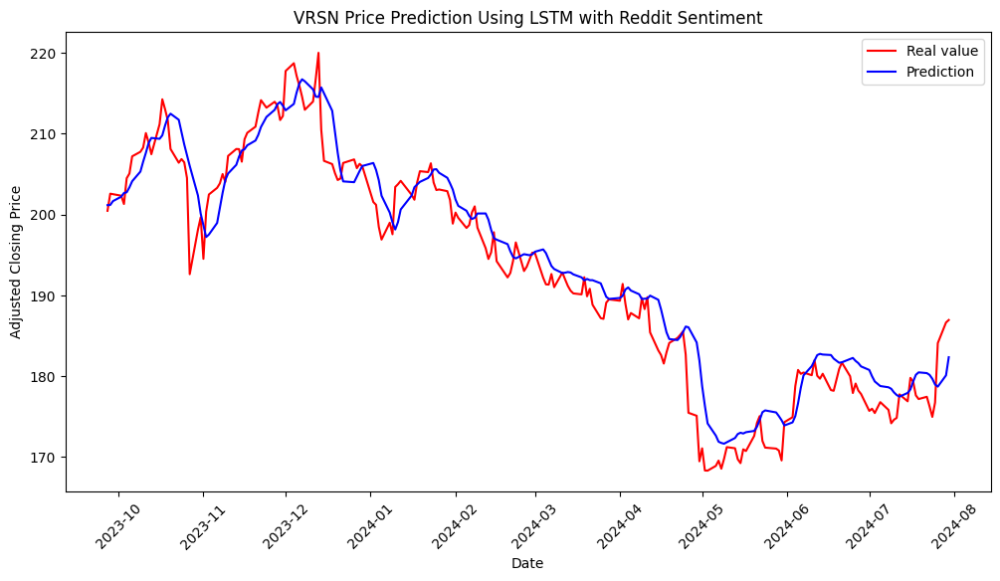

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando FFIV...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para FFIV:
MSE: 16.267892223011557
MSE Normalizado: 0.0005369824019163076
MAE: 2.767881301073115
R²: 0.882552890501861


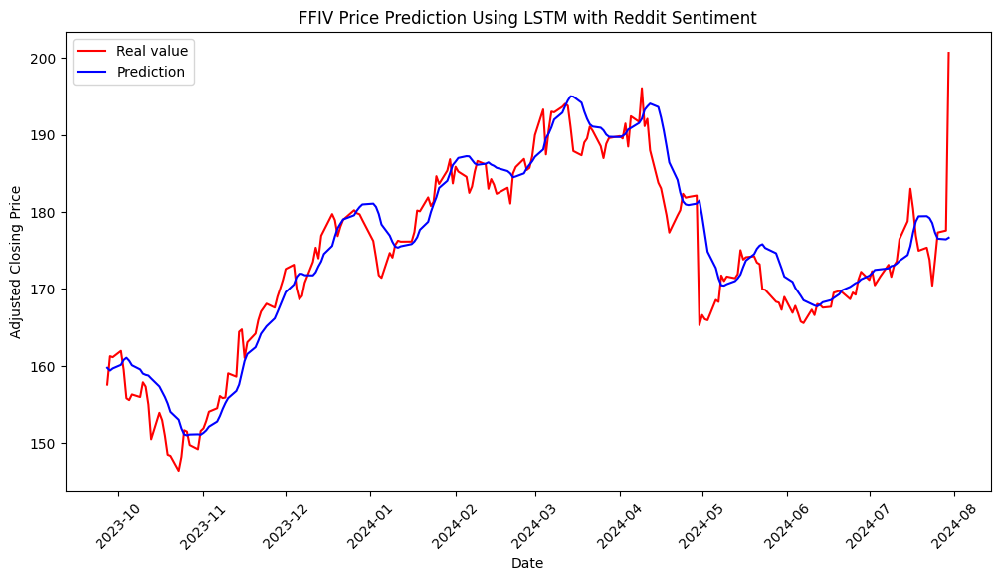

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando XRX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para XRX:
MSE: 0.4177304875884792
MSE Normalizado: 0.0020249622396502076
MAE: 0.46078934516946146
R²: 0.9090981435381082


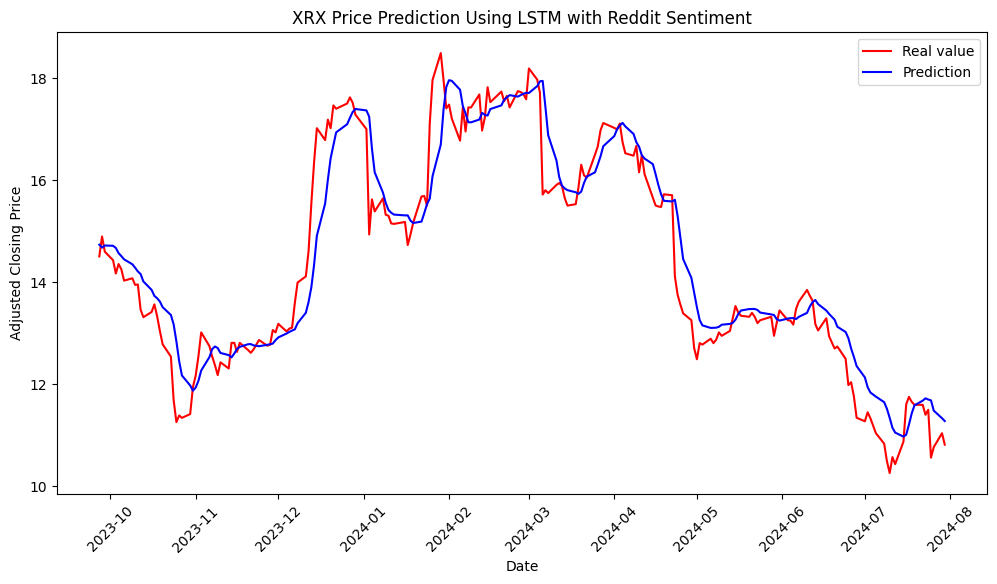

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JNPR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JNPR:
MSE: 2.0158062549224445
MSE Normalizado: 0.001855347816095715
MAE: 1.1253704833421139
R²: 0.8950281911173245


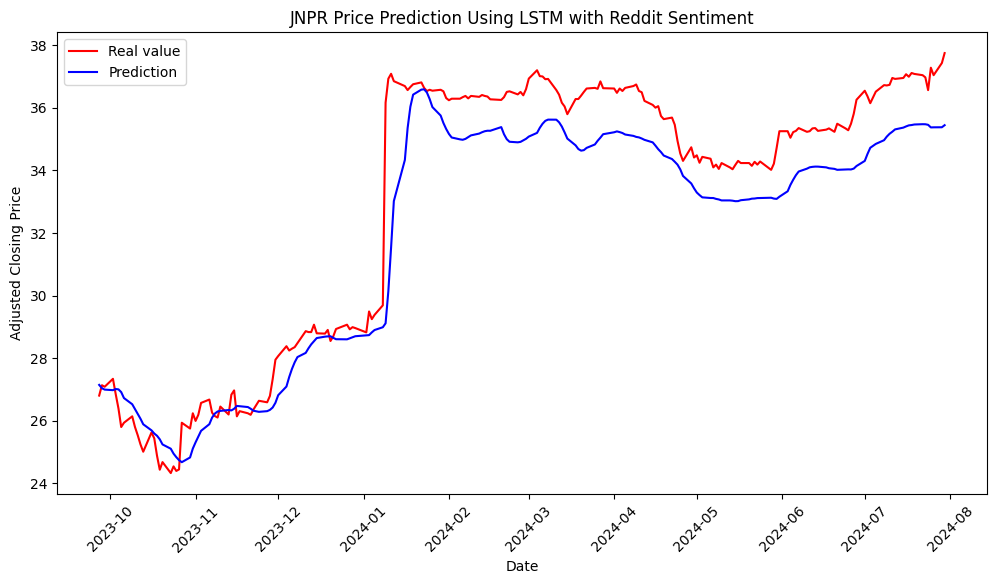

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CSGP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CSGP:
MSE: 4.533218110044914
MSE Normalizado: 0.0006589617245497375
MAE: 1.6513729020544288
R²: 0.8906063812053358


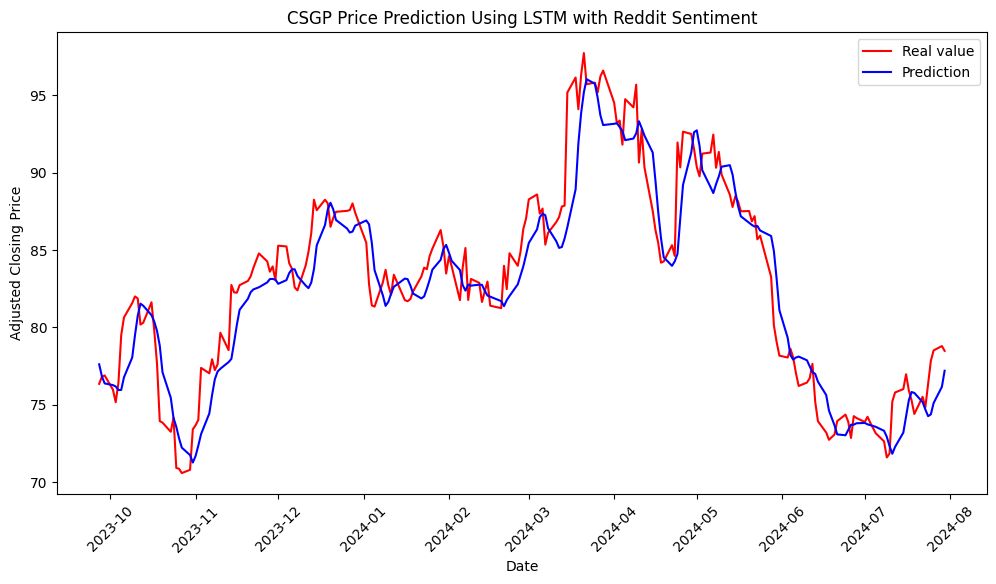

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GRMN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GRMN:
MSE: 40.70560318301156
MSE Normalizado: 0.002185547045926611
MAE: 4.9536310678596704
R²: 0.9169376145990557


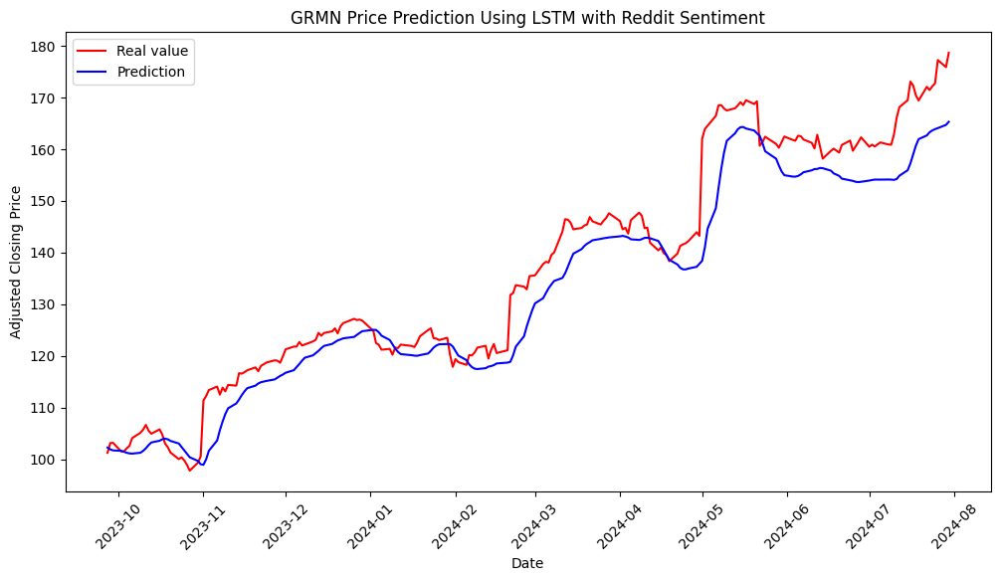

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ZBRA...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ZBRA:
MSE: 95.96541219453671
MSE Normalizado: 0.0012986925017251431
MAE: 7.578273617227922
R²: 0.9357321579640094


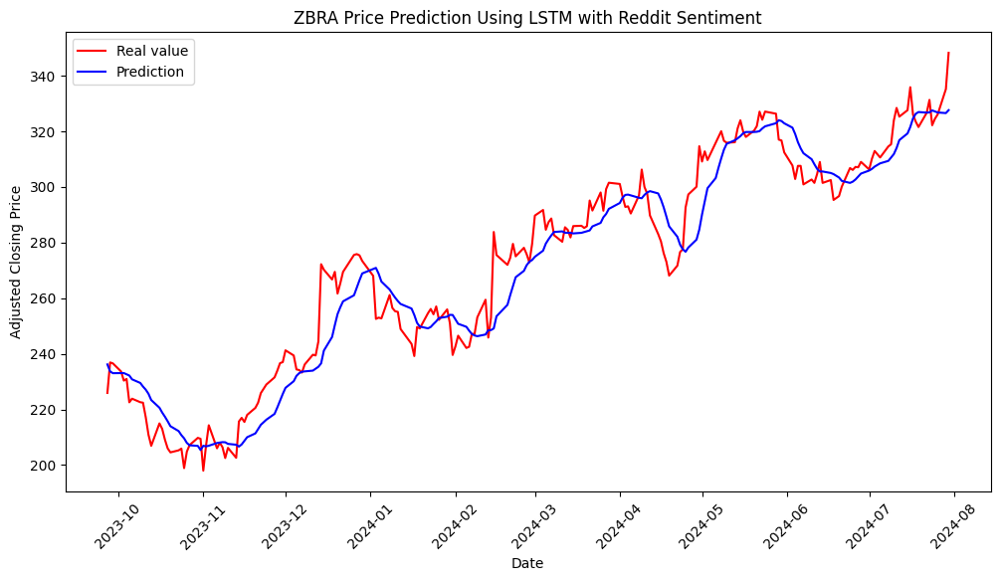

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando BR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para BR:
MSE: 85.02785535136397
MSE Normalizado: 0.002271604742366142
MAE: 8.393106141870934
R²: 0.21518627512406507


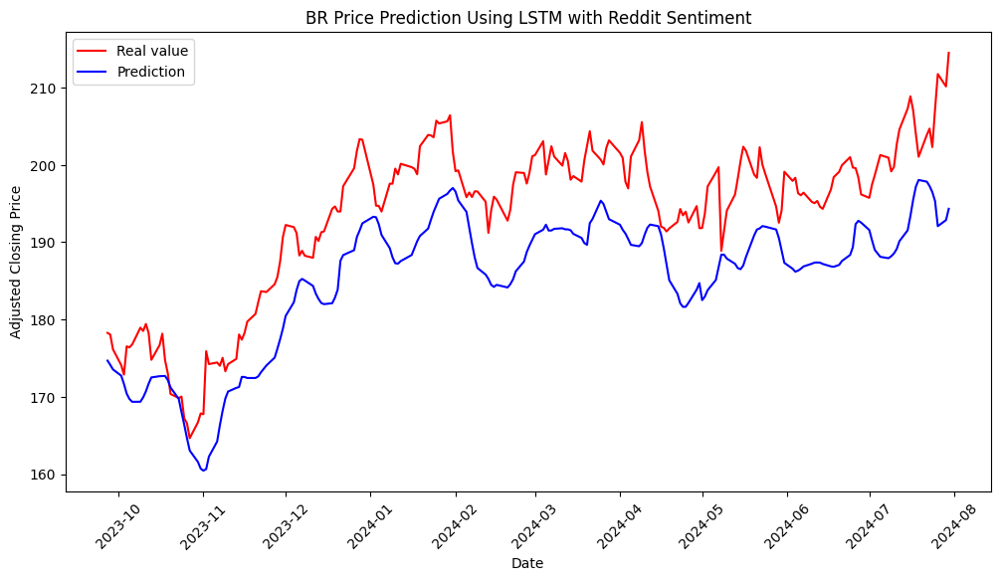

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando VRSN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para VRSN:
MSE: 12.640601197809291
MSE Normalizado: 0.0003402212562075322
MAE: 2.755076375870367
R²: 0.9347188849984857


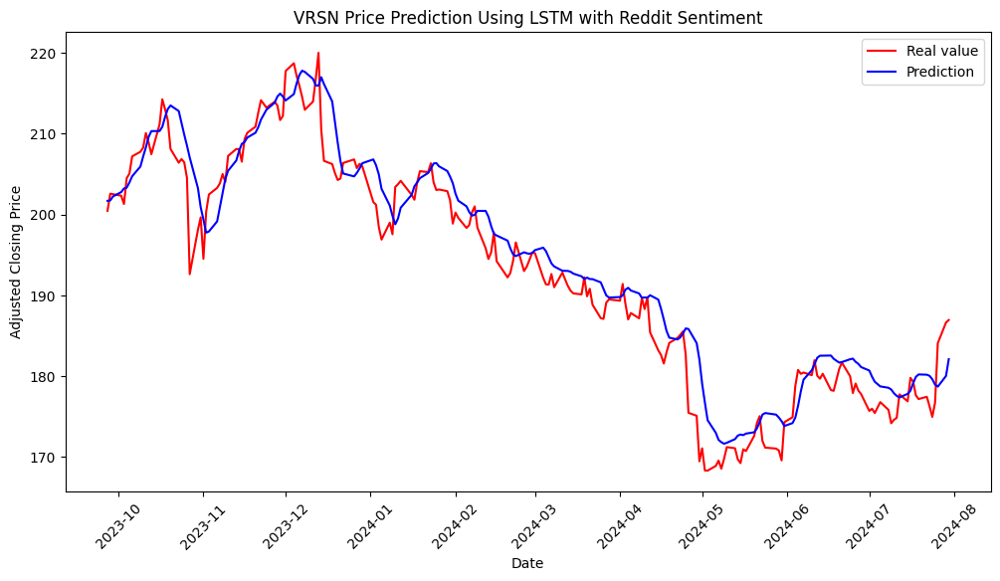

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PTC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PTC:
MSE: 53.659266403833065
MSE Normalizado: 0.0018312659873125719
MAE: 6.594649228495929
R²: 0.7576402375648984


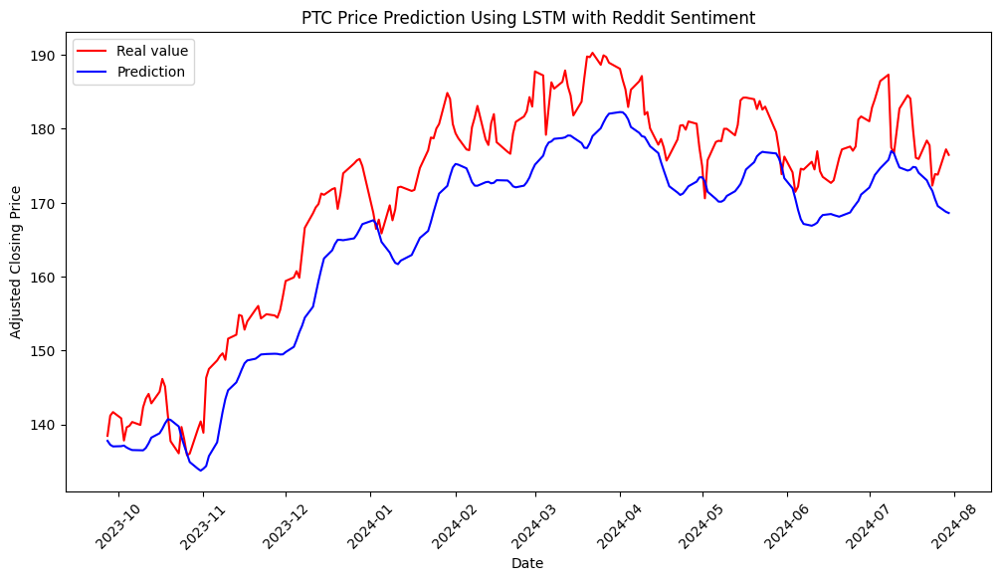

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CTSH...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CTSH:
MSE: 1.7868472054530444
MSE Normalizado: 0.00036371047892704727
MAE: 1.0208257719612295
R²: 0.9098941046277771


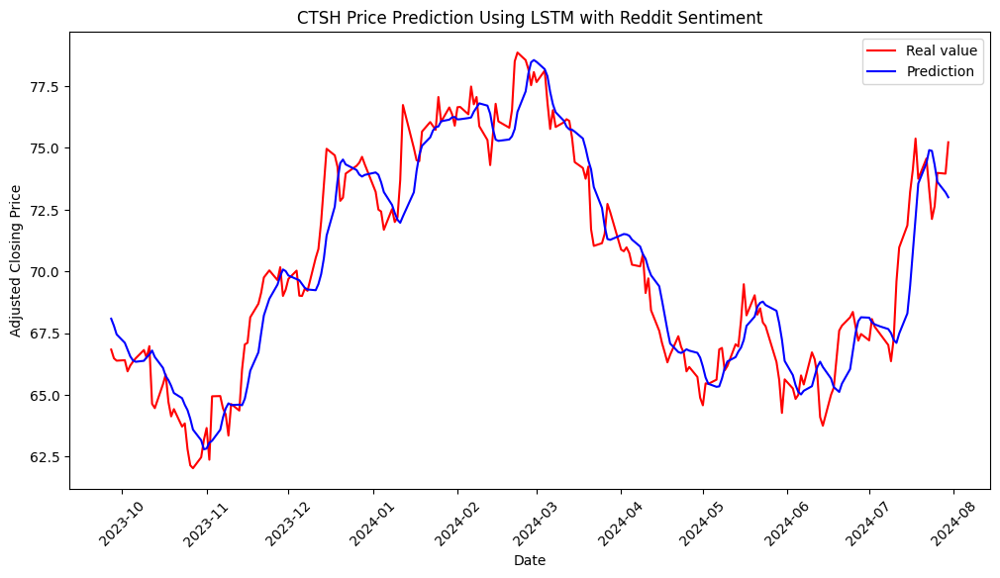

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando HPE...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para HPE:
MSE: 0.5119372909138683
MSE Normalizado: 0.0017595507441629436
MAE: 0.5157811682160249
R²: 0.8601368048980479


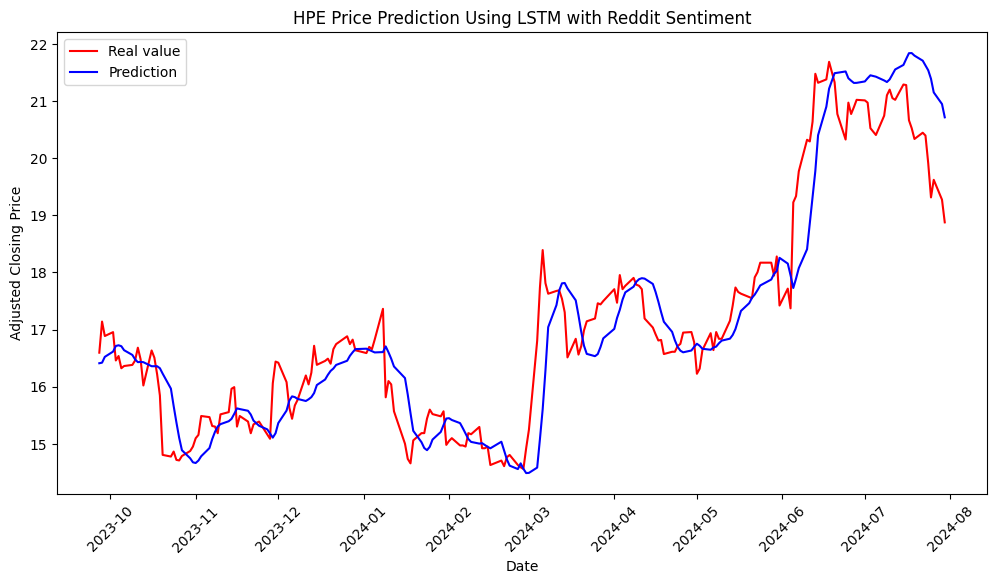

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JNPR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JNPR:
MSE: 1.1926631183985328
MSE Normalizado: 0.0010977269797904053
MAE: 0.7817181019097779
R²: 0.9378928383517873


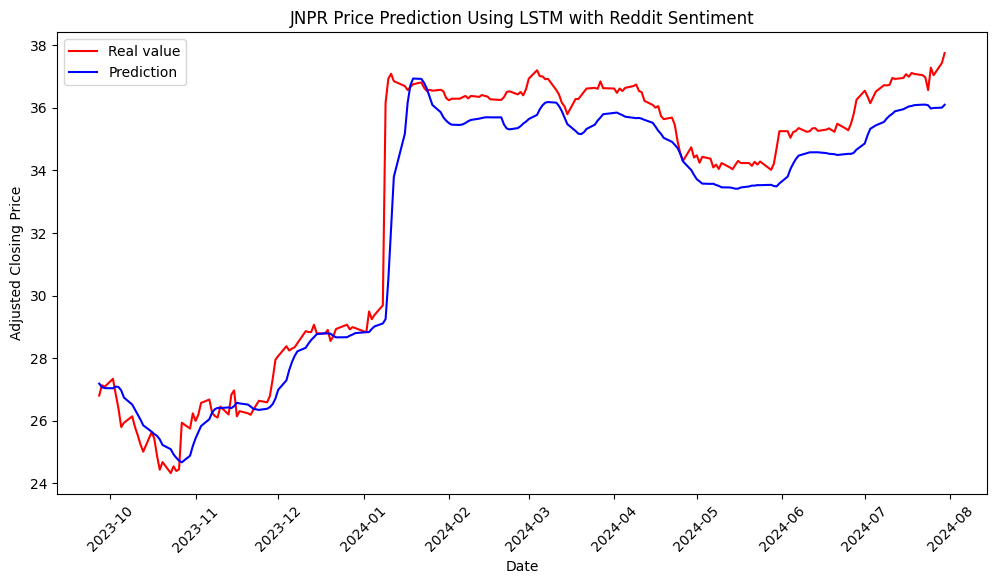

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MSI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MSI:
MSE: 48.451963506722024
MSE Normalizado: 0.00043452575118381606
MAE: 5.158181244233212
R²: 0.957587234613026


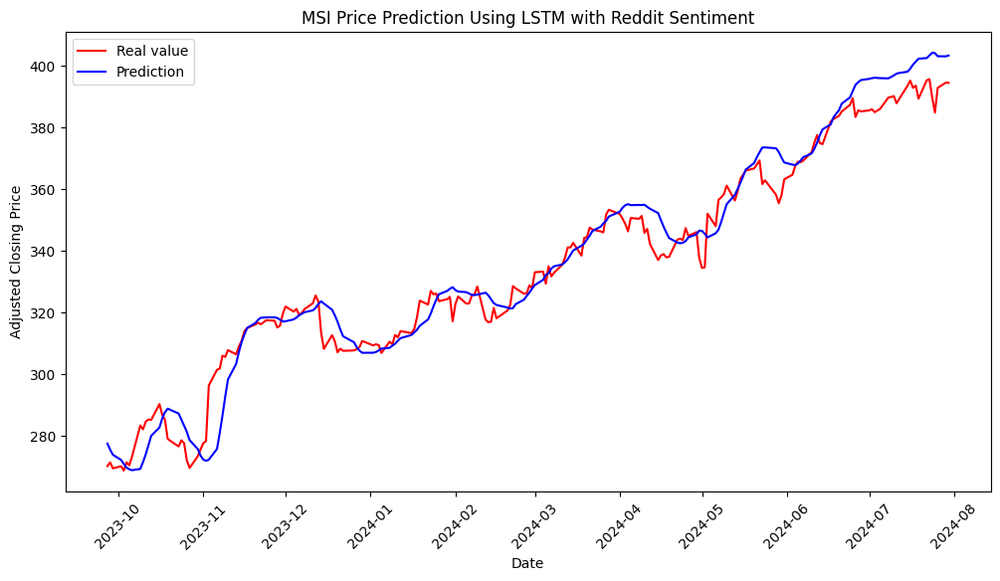

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TDY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TDY:
MSE: 54.54450537219831
MSE Normalizado: 0.0003283548666162376
MAE: 5.434968650279652
R²: 0.85560899550331


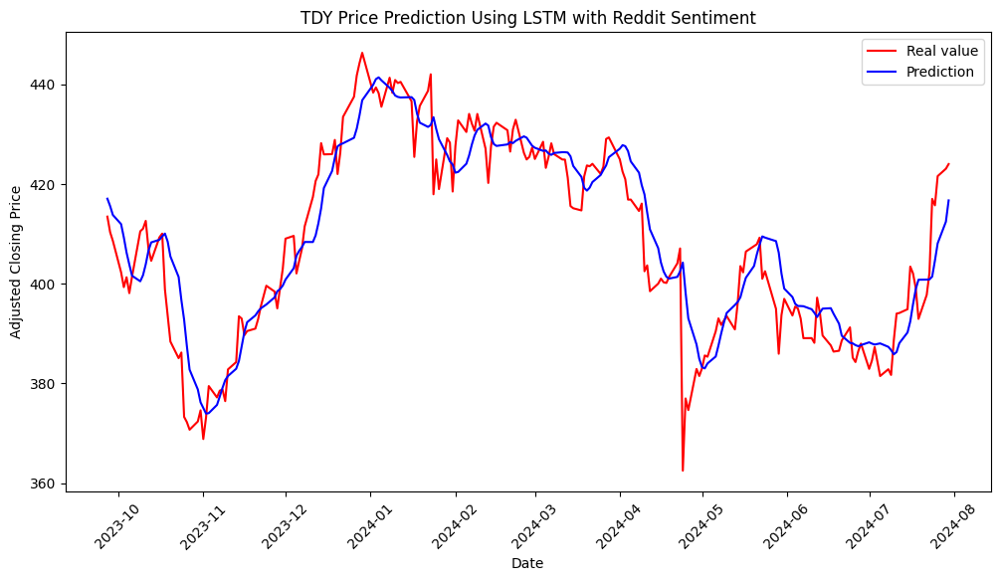

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando WDC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para WDC:
MSE: 4.735296256346358
MSE Normalizado: 0.0012941382253593885
MAE: 1.7513427560894101
R²: 0.9681335789210183


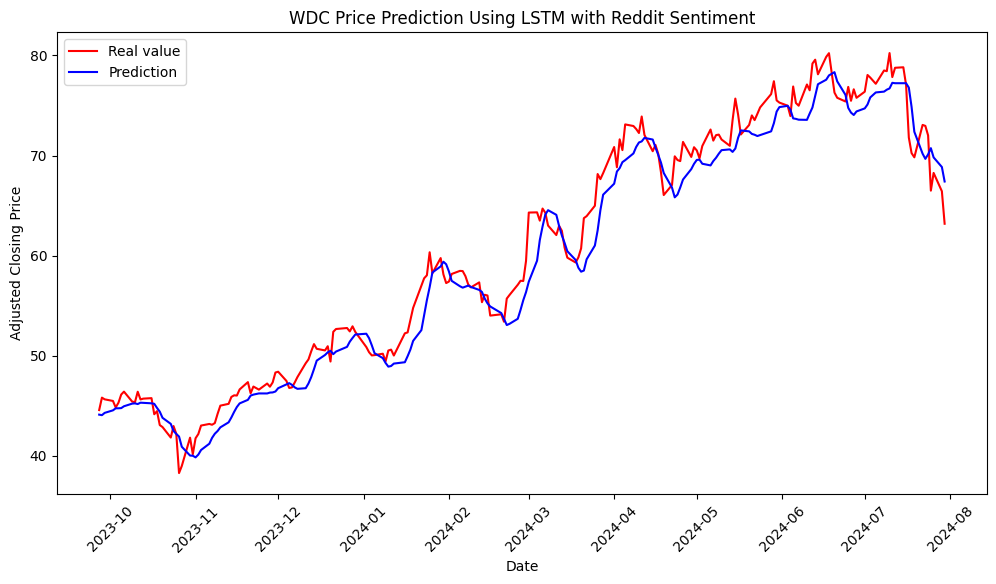

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando STX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para STX:
MSE: 5.11048949106106
MSE Normalizado: 0.0007017624162080162
MAE: 1.802276437665394
R²: 0.9626837791109158


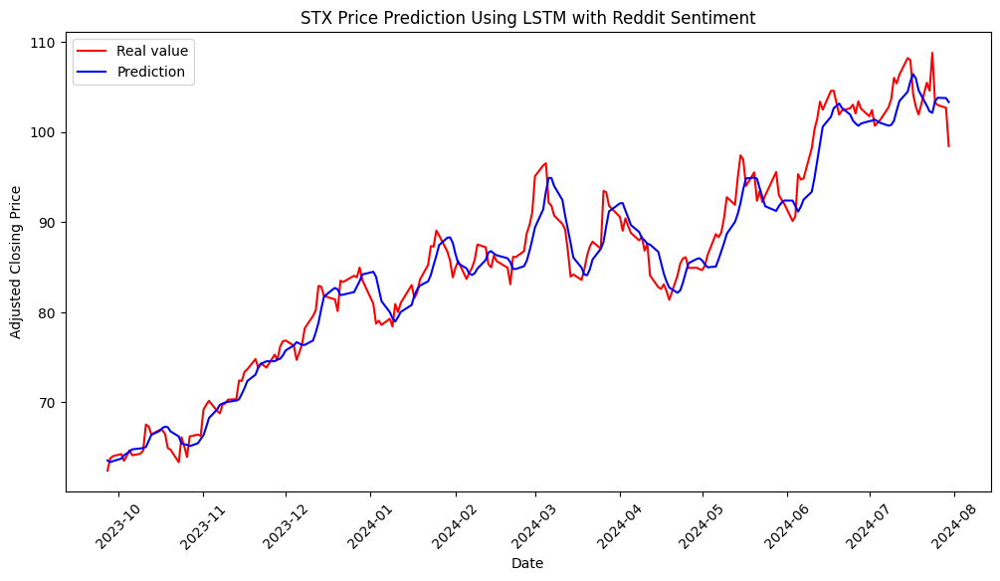


Resultados Finales:
             MSE  MSE_Normalizado        MAE        R2
AAPL   23.076263         0.000657   3.827892  0.915875
MSFT   57.371163         0.000366   6.074002  0.958347
NVDA  266.257528         0.044065  12.530502  0.681097
AVGO  189.917301         0.012713   9.672817  0.704127
CRM    67.238227         0.001009   6.228965  0.935735
...          ...              ...        ...       ...
HPE     0.511937         0.001760   0.515781  0.860137
MSI    48.451964         0.000435   5.158181  0.957587
TDY    54.544505         0.000328   5.434969  0.855609
WDC     4.735296         0.001294   1.751343  0.968134
STX     5.110489         0.000702   1.802276  0.962684

[62 rows x 4 columns]


In [ ]:
# **MODELO 2. INCLUSION DE ANALISIS DE SENTIMIENTOS CON VADER**
import yfinance as yf
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import pytorch_lightning as pl
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nest_asyncio
import asyncio
import asyncpraw
import datetime

# Configuración de credenciales de Reddit
cliente_id = "H3cf4dEtELCFz7w3z6eIKw"
cliente_secret = "lxNt3eDn3Y1XA57EIq3_Q92AQ_Ntyw"
usuario = "RoutineStrain7301"
contraseña = "Tavinr1717*"
user_agent = "proyectogustav"

nltk.download('vader_lexicon')
nest_asyncio.apply()

# Definir el dispositivo (CPU o GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Lista de tickers
tickers = [
    'AAPL', 'MSFT', 'NVDA', 'AVGO', 'CRM', 'ORCL', 'AMD', 'CSCO', 'ACN', 'ADBE',
    'TXN', 'IBM', 'QCOM', 'INTU', 'AMAT', 'MU', 'LRCX', 'NOW', 'PANW', 'SNPS',
    'CDNS', 'ANET', 'FTNT', 'KLAC', 'APH', 'TEL', 'MCHP', 'NXPI', 'ON', 'MPWR',
    'ADI', 'KEYS', 'CDW', 'ANSS', 'PAYC', 'GDDY', 'TYL', 'SSNC','JKHY', 'EPAM',
    'GLW', 'HPQ', 'DXC', 'IT', 'LDOS', 'AKAM', 'NTAP', 'VRSN', 'FFIV', 'XRX',
    'JNPR', 'CSGP', 'GRMN', 'ZBRA', 'BR','VRSN', 'PTC', 'CTSH', 'HPE',
    'JNPR', 'MSI', 'TDY', 'WDC', 'STX'
]
stock_data = {}

# 1. Descargar datos financieros de Yahoo Finance y aplanar el MultiIndex
for ticker in tickers:
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    # Aplanar el MultiIndex y remover el nombre del índice
    data.columns = data.columns.get_level_values(0)
    data.columns.name = None  # Eliminar el nombre del índice de columnas
    stock_data[ticker] = data
    print(f"Datos para {ticker} descargados. Columnas disponibles: {data.columns}")

# 2. Generar medias móviles y preparar datos financieros
def preparar_datos_financieros(stock_data):
    for ticker, data in stock_data.items():
        # Generar medias móviles y eliminar filas con NaN
        data['MA_10'] = data['Adj Close'].rolling(window=10).mean()
        data['MA_30'] = data['Adj Close'].rolling(window=30).mean()
        data['MA_60'] = data['Adj Close'].rolling(window=60).mean()
        data.dropna(inplace=True)
        stock_data[ticker] = data
    return stock_data

# Aplicar la preparación de datos financieros
stock_data = preparar_datos_financieros(stock_data)

# 3. Obtener y agregar sentimientos de Reddit
async def obtener_reddit_async(ticker, subreddit_nombre='WallStreetBets', limite=100):
    async with asyncpraw.Reddit(client_id=cliente_id,
                                client_secret=cliente_secret,
                                user_agent=user_agent,
                                username=usuario,
                                password=contraseña) as reddit:
        subreddit = await reddit.subreddit(subreddit_nombre)
        publicaciones = subreddit.search(ticker, limit=limite)
        datos = []
        async for post in publicaciones:
            datos.append({
                'titulo': post.title,
                'cuerpo': post.selftext,
                'fecha': post.created_utc
            })
        return datos

def agregar_sentimiento_reddit(stock_data):
    sia = SentimentIntensityAnalyzer()

    async def process_tickers():
        for ticker in tickers:
            data = stock_data[ticker]
            publicaciones = await obtener_reddit_async(ticker, subreddit_nombre='WallStreetBets', limite=100)

            # Calcular sentimiento por fecha
            sentimiento_por_fecha = {}
            for post in publicaciones:
                fecha = datetime.datetime.utcfromtimestamp(post['fecha']).strftime('%Y-%m-%d')
                full_text = post['titulo'] + ' ' + (post['cuerpo'] or '')
                sentimiento = sia.polarity_scores(full_text)['compound']
                if fecha in sentimiento_por_fecha:
                    sentimiento_por_fecha[fecha].append(sentimiento)
                else:
                    sentimiento_por_fecha[fecha] = [sentimiento]

            for fecha in sentimiento_por_fecha:
                sentimiento_por_fecha[fecha] = np.mean(sentimiento_por_fecha[fecha])

            # Crear la columna de sentimiento alineada con el mercado
            sentimientos = []
            for date in data.index.strftime('%Y-%m-%d'):
                sentimientos.append(sentimiento_por_fecha.get(date, 0))
            data['sentimiento_reddit'] = sentimientos
            stock_data[ticker] = data

    asyncio.run(process_tickers())
    return stock_data

# Aplicar la función para agregar sentimientos de Reddit
stock_data = agregar_sentimiento_reddit(stock_data)

# 4. Validación de columnas y procesamiento de datos para LSTM
features = ['Adj Close', 'MA_10', 'MA_30', 'MA_60', 'sentimiento_reddit']

def verificar_columnas(stock_data, features):
    for ticker, data in stock_data.items():
        missing_columns = [col for col in features if col not in data.columns]
        for col in missing_columns:
            data[col] = 0
        stock_data[ticker] = data
    return stock_data

# Verificar y preparar las columnas para todos los tickers
stock_data = verificar_columnas(stock_data, features)

# Función para preparar datos para el modelo LSTM
def preparar_datos_lstm(stock_data, ticker, features, time_step=60):
    data = stock_data[ticker]

    # Eliminar filas con valores NaN
    data = data.dropna(subset=features)

    # Dividir datos en entrenamiento y validación
    train_data = data.loc[:'2023-06-30', features]
    val_data = data.loc['2023-07-01':, features]

    # Escalado de los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train_data)
    val_scaled = scaler.transform(val_data)

    # Crear secuencias para LSTM
    X_train, Y_train = [], []
    for i in range(time_step, len(train_scaled)):
        X_train.append(train_scaled[i-time_step:i])
        Y_train.append(train_scaled[i, 0])  # Precio de cierre ajustado

    X_train = np.array(X_train)
    Y_train = np.array(Y_train)

    # Preparar datos de validación
    X_val, Y_val = [], []
    for i in range(time_step, len(val_scaled)):
        X_val.append(val_scaled[i-time_step:i])
        Y_val.append(val_scaled[i, 0])

    X_val = np.array(X_val)
    Y_val = np.array(Y_val)

    return X_train, Y_train, X_val, Y_val, scaler, val_data.index[time_step:]

# Definir el modelo LSTM
class LSTMModel(pl.LightningModule):
    def __init__(self, input_size=5, hidden_layer_size=100, output_size=1, lr=0.001):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = nn.Linear(hidden_layer_size, output_size)
        self.lr = lr
        self.criterion = nn.MSELoss()

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1])
        return predictions

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('train_loss', loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('val_loss', loss, prog_bar=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)

# 5. Entrenamiento y evaluación para cada ticker
results = {}

# Crear un DataFrame para almacenar las predicciones futuras
future_prices_df = pd.DataFrame()

for ticker in tickers:
    print(f"\nProcesando {ticker}...")

    # Preparar los datos para el modelo LSTM
    X_train, Y_train, X_val, Y_val, scaler, dates = preparar_datos_lstm(stock_data, ticker, features)
    batch_size = 32
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1)
    X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
    Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1)
    train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
    val_dataset = TensorDataset(X_val_tensor, Y_val_tensor)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instanciar y entrenar el modelo
    model = LSTMModel(input_size=5)
    trainer = pl.Trainer(max_epochs=20, logger=False, enable_checkpointing=False)
    trainer.fit(model, train_loader, val_loader)

    # Realizar predicciones
    model.eval()
    with torch.no_grad():
        predictions = model(X_val_tensor).cpu().numpy()
    predictions_extended = np.concatenate([predictions, np.zeros((predictions.shape[0], len(features)-1))], axis=1)
    predictions_descaled = scaler.inverse_transform(predictions_extended)[:, 0]

    Y_val_extended = np.concatenate([Y_val.reshape(-1, 1), np.zeros((Y_val.shape[0], len(features)-1))], axis=1)
    Y_val_descaled = scaler.inverse_transform(Y_val_extended)[:, 0]

    # Guardar resultados en el DataFrame
    df_ticker = pd.DataFrame({
        'Date': dates,
        'Ticker': ticker,
        'Real Value': Y_val_descaled,
        'Predicted Value': predictions_descaled
    })
    future_prices_df = pd.concat([future_prices_df, df_ticker], ignore_index=True)


    # Calcular métricas de evaluación
    mse = mean_squared_error(Y_val_descaled, predictions_descaled)
    mae = mean_absolute_error(Y_val_descaled, predictions_descaled)
    r2 = r2_score(Y_val_descaled, predictions_descaled)

    # Calcular MSE normalizado usando el precio promedio de validación
    precio_promedio_validacion = np.mean(Y_val_descaled)
    mse_normalizado = mse / (precio_promedio_validacion ** 2)

    print(f"Métricas de evaluación para {ticker}:")
    print(f"MSE: {mse}")
    print(f"MSE Normalizado: {mse_normalizado}")
    print(f"MAE: {mae}")
    print(f"R²: {r2}")

    # Graficar resultados
    plt.figure(figsize=(12, 6))
    plt.plot(dates, Y_val_descaled, color='red', label='Real value')
    plt.plot(dates, predictions_descaled, color='blue', label='Prediction')
    plt.title(f"{ticker} Price Prediction Using LSTM with Reddit Sentiment")
    plt.xlabel('Date')
    plt.ylabel('Adjusted Closing Price')
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()

    # Guardar resultados
    results[ticker] = {
        'MSE': mse,
        'MSE_Normalizado': mse_normalizado,
        'MAE': mae,
        'R2': r2
    }

# Mostrar todos los resultados
results_df = pd.DataFrame(results).T
print("\nResultados Finales:")
print(results_df)



In [28]:
import matplotlib.pyplot as plt
import yfinance as yf

# Lista de tickers
tickers = [
    'AAPL', 'MSFT', 'NVDA', 'AVGO', 'ORCL', 'AMD', 'CSCO', 'ACN', 'ADBE',
    'TXN', 'IBM', 'QCOM', 'INTU', 'AMAT', 'MU', 'LRCX', 'NOW', 'PANW', 'SNPS',
    'CDNS', 'ANET', 'FTNT', 'KLAC'
]

# Descargar datos de Yahoo Finance para cada ticker
def download_stock_data(ticker):
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    data['MA_10'] = data['Adj Close'].rolling(window=10).mean()
    data['MA_30'] = data['Adj Close'].rolling(window=30).mean()
    data['MA_60'] = data['Adj Close'].rolling(window=60).mean()
    data.dropna(inplace=True)  # Eliminar filas con valores NaN debido al cálculo de medias móviles
    return data

# Descargar y almacenar datos para cada ticker
stock_data = {}
for ticker in tickers:
    stock_data[ticker] = download_stock_data(ticker)
    print(f"Datos para {ticker} descargados.")

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados.
Datos para MSFT descargados.
Datos para NVDA descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para AVGO descargados.
Datos para ORCL descargados.
Datos para AMD descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CSCO descargados.
Datos para ACN descargados.
Datos para ADBE descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TXN descargados.
Datos para IBM descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para QCOM descargados.
Datos para INTU descargados.
Datos para AMAT descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MU descargados.
Datos para LRCX descargados.
Datos para NOW descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para PANW descargados.
Datos para SNPS descargados.
Datos para CDNS descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ANET descargados.
Datos para FTNT descargados.
Datos para KLAC descargados.


# Modelo 3: Análisis de Sentimientos con Transformadores (FinBERT)

Este modelo utiliza el análisis de sentimientos avanzado mediante el modelo **FinBERT** y técnicas de series temporales (LSTM) para predecir los precios de las acciones.

## Datos de Entrada
1. **Históricos Financieros**:
   - Precios ajustados diarios.
   - Indicadores técnicos: Medias móviles de 10, 30 y 60 días.
2. **Sentimientos de Noticias**:
   - **API de Yahoo Finance**:
     - Extraemos titulares de noticias relacionadas con las empresas seleccionadas para el análisis.
   - **API de Reddit**:
     - Obtenemos publicaciones y comentarios relevantes sobre las empresas para capturar el sentimiento de las redes sociales.
   - Ambos conjuntos de datos son procesados con el modelo **FinBERT** para determinar su impacto en el mercado.

## Proceso de Preparación de Datos
1. **Extracción de Noticias y Comentarios**:
   - **Yahoo Finance**:
     - Se obtienen titulares de noticias utilizando solicitudes a su API, especificando el ticker y el rango de fechas.
   - **Reddit**:
     - Se conecta a la API de Reddit utilizando `praw` para extraer publicaciones relacionadas con las acciones.
     - Las publicaciones y comentarios son organizados por fecha y texto relevante.
2. **Análisis de Sentimientos**:
   - Cada titular o publicación se procesa usando el modelo FinBERT:
     - Se generan probabilidades para los sentimientos: positivo, neutral y negativo.
     - El sentimiento neto se calcula como: \( \text{positivo} - \text{negativo} \).
   - Los puntajes promedio diarios de sentimiento para Yahoo Finance y Reddit se alinean con las fechas del mercado.
3. **Enriquecimiento del Conjunto de Datos**:
   - Se agregan dos columnas al conjunto de datos:
     - `sentimiento_noticias`: Promedio diario de sentimientos derivados de Yahoo Finance.
     - `sentimiento_reddit`: Promedio diario de sentimientos derivados de Reddit.

## Arquitectura del Modelo
- **Capa de Entrada**:
  - Combina las siguientes características:
    - Precios ajustados (`Adj Close`).
    - Medias móviles (`MA_10`, `MA_30`, `MA_60`).
    - Sentimientos derivados de:
      - Noticias (`sentimiento_noticias`).
      - Redes sociales (`sentimiento_reddit`).
- **Capa LSTM**:
  - Captura patrones temporales en las características combinadas.
- **Capa fully connected**:
  - Genera predicciones finales de precios.

## Entrenamiento
1. **División de Datos**:
   - Los datos se dividen en dos períodos:
     - **Entrenamiento**: un perido de 4 años, Hasta el 30 de junio de 2023.
     - **Validación**: el periodo de 1 año desde el 1 de julio de 2023.
2. **Escalado**:
   - Los datos se normalizan usando un escalador Min-Max para garantizar que todas las características estén en el mismo rango.
3. **Parámetros del Entrenamiento**:
   - Épocas: 20.
   - Tamaño del lote: 32.
   - Optimizador: Adam.
   - Función de pérdida: MSE.

## Métricas de Evaluación
- **MSE (Mean Squared Error)**.
- **MSE Normalizado*.
- **MAE (Mean Absolute Error)**.
- **R² (Coeficiente de Determinación)**.

## Visualización de Resultados
El modelo genera gráficos que comparan los precios reales y las predicciones para cada acción. Esto permite:
- Visualizar la precisión del modelo.
- Evaluar si las predicciones siguen las tendencias reales del mercado.

## Resultados
Al finalizar, se recopilan las métricas clave para cada acción y se almacenan en un DataFrame para análisis comparativo.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AAPL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para AAPL: 59.96617503466033, MAE: 6.552963052965894, R2: 0.7657462227370962


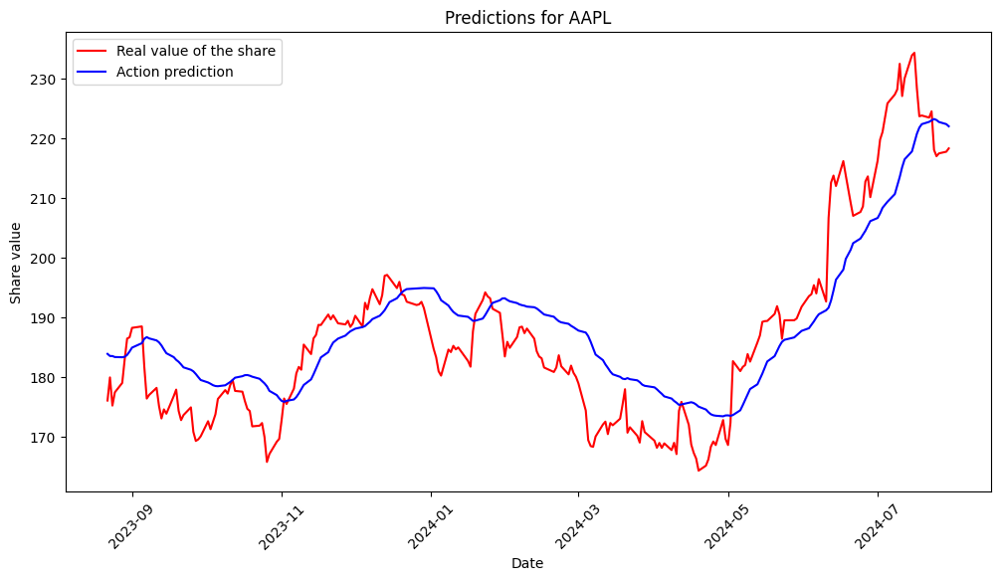

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MSFT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para MSFT: 203.80881765009545, MAE: 12.09201110034858, R2: 0.8817758035931879


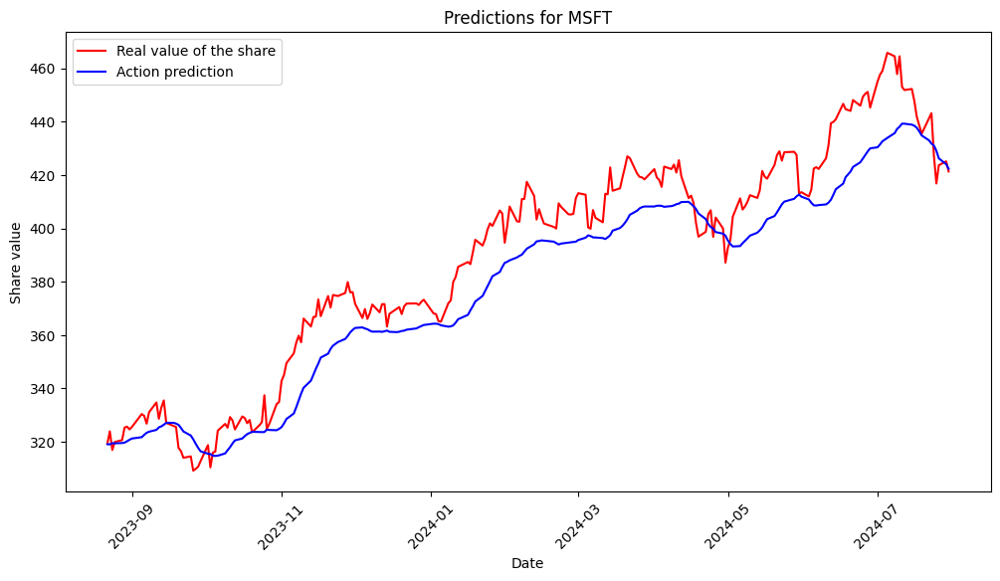

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NVDA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para NVDA: 50.12801838253867, MAE: 4.821944762212447, R2: 0.9407160109377755


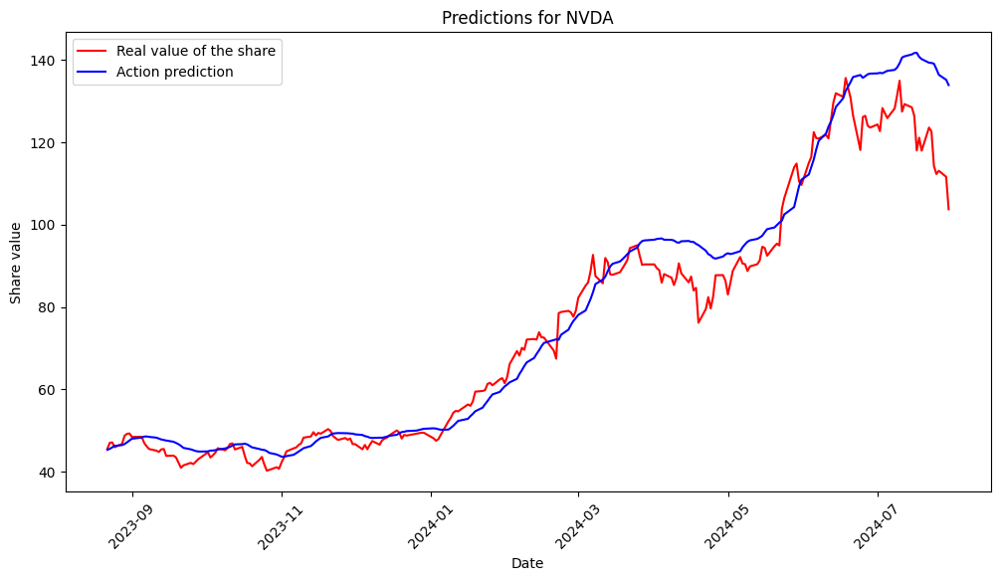

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AVGO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para AVGO: 53.955416280469635, MAE: 5.46926025255292, R2: 0.9242559875989237


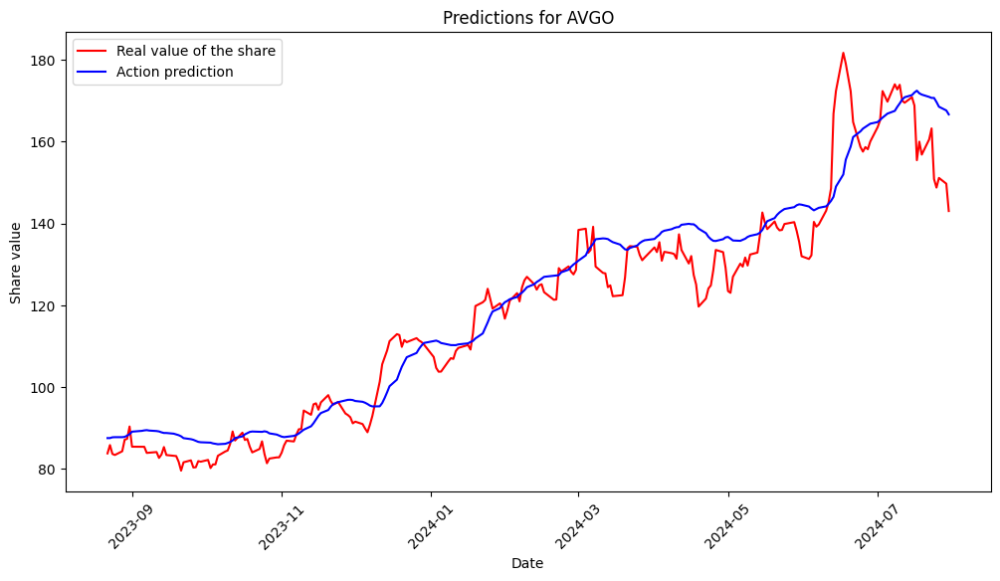


Entrenando modelo para ORCL...


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ORCL: 30.543815039840574, MAE: 4.287666580210031, R2: 0.7758021117162952


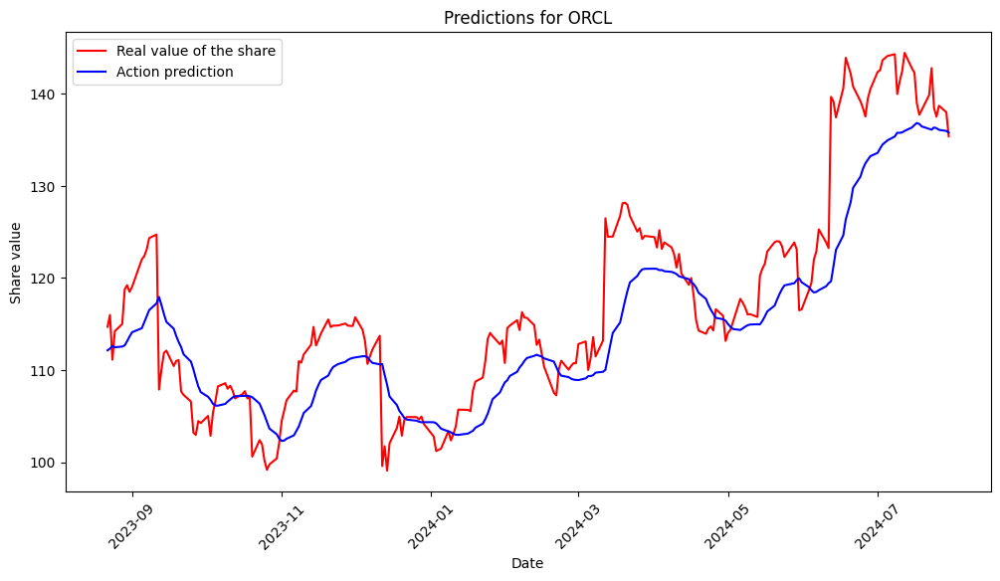

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AMD...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para AMD: 70.79509703993489, MAE: 6.533579436876634, R2: 0.9215085376756128


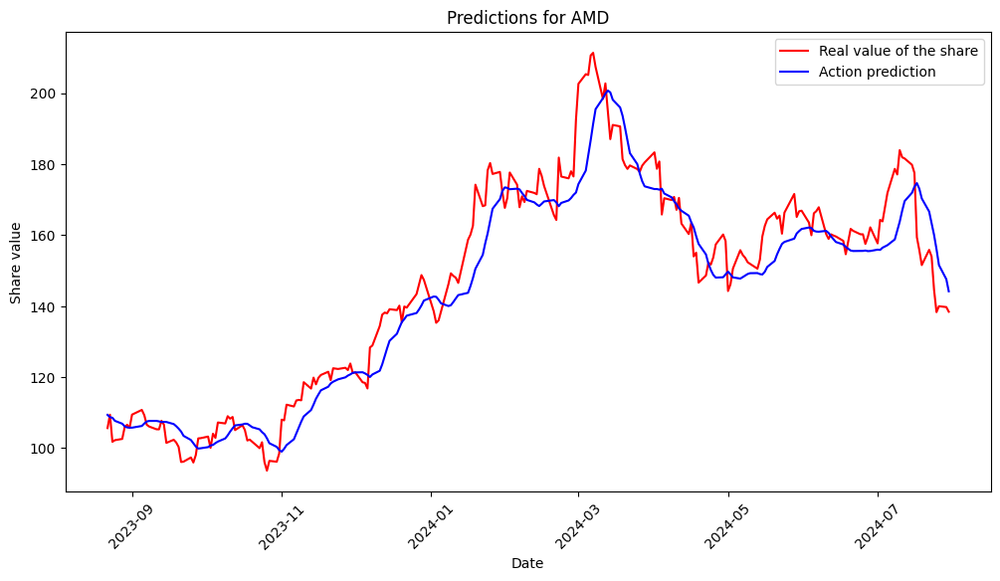

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CSCO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para CSCO: 0.8605385828323838, MAE: 0.7283873108841539, R2: 0.8650086654313719


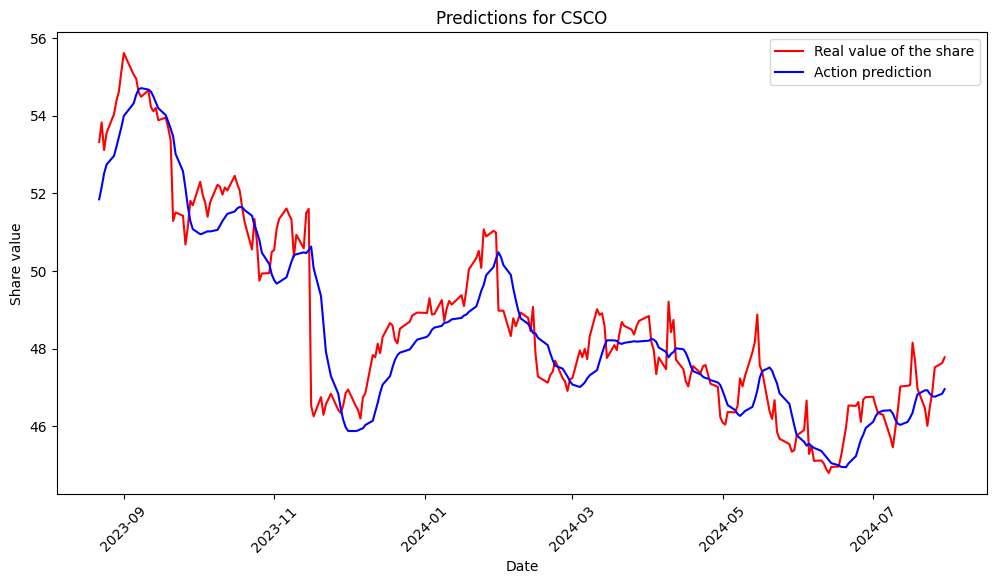

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ACN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ACN: 163.74751612285257, MAE: 10.671940927660735, R2: 0.7656383366683808


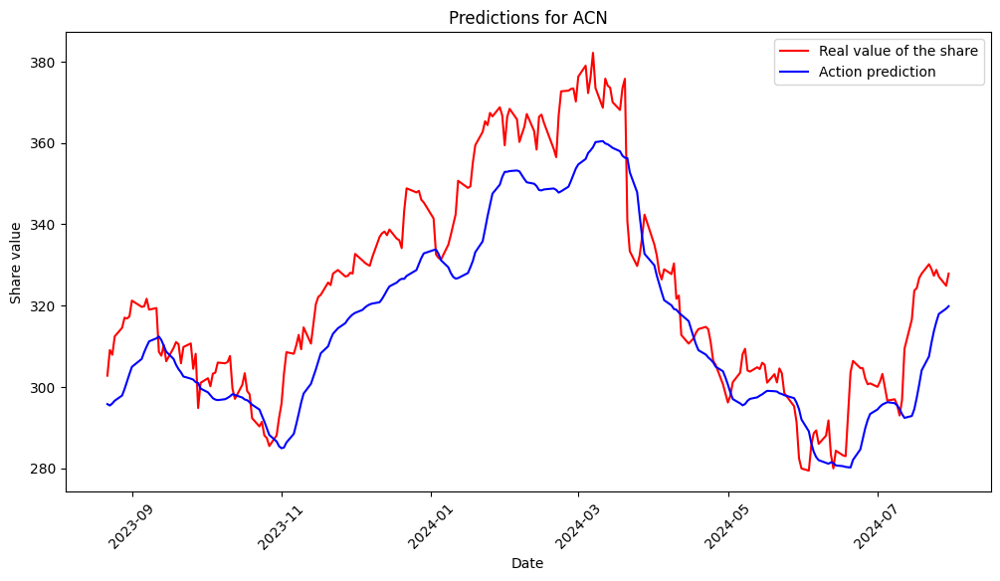

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ADBE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ADBE: 380.5704852066229, MAE: 14.753241801548157, R2: 0.8440172813629088


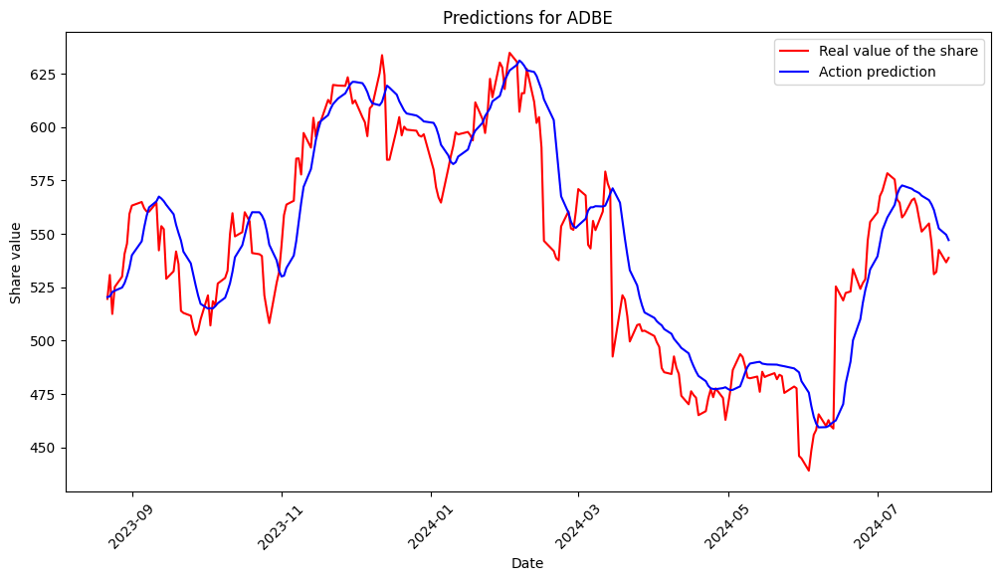

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TXN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para TXN: 58.88264407843697, MAE: 6.239382561896782, R2: 0.8065498595350216


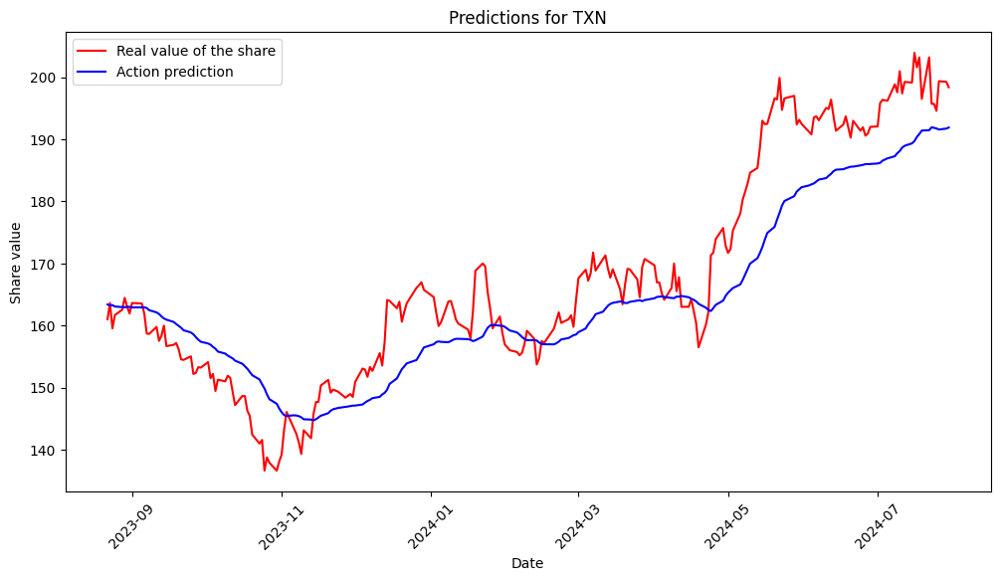

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para IBM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para IBM: 14.804220248791777, MAE: 2.912937402981657, R2: 0.9533531270700528


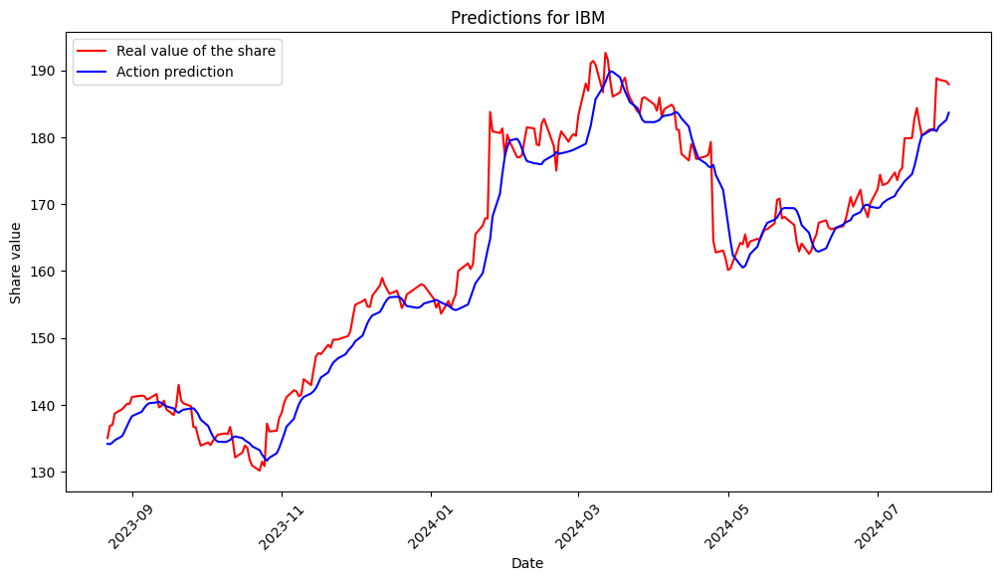

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para QCOM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para QCOM: 53.884593570729784, MAE: 5.614283120090371, R2: 0.9531621456024805


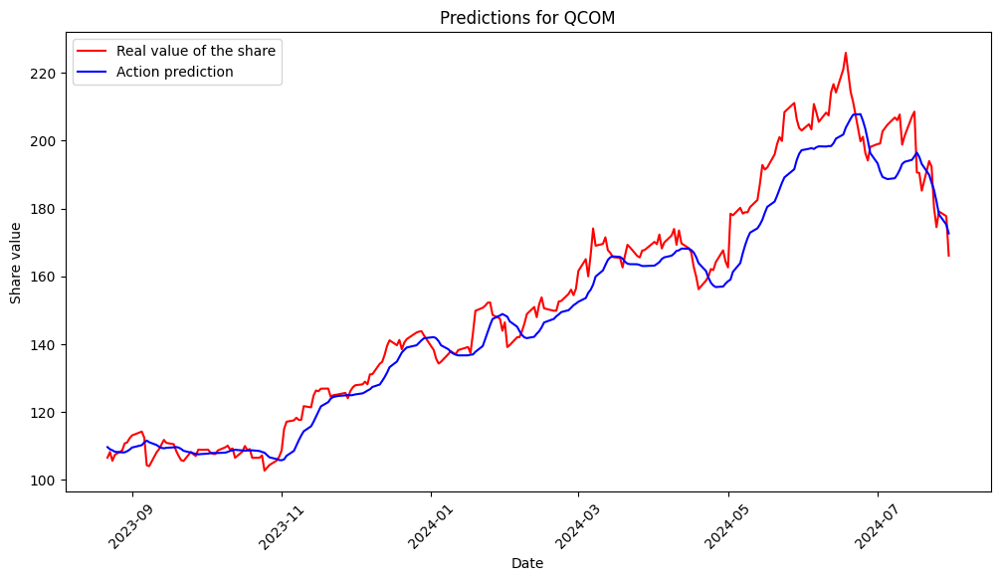

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para INTU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para INTU: 631.1684849254516, MAE: 19.410687709970492, R2: 0.777304719686031


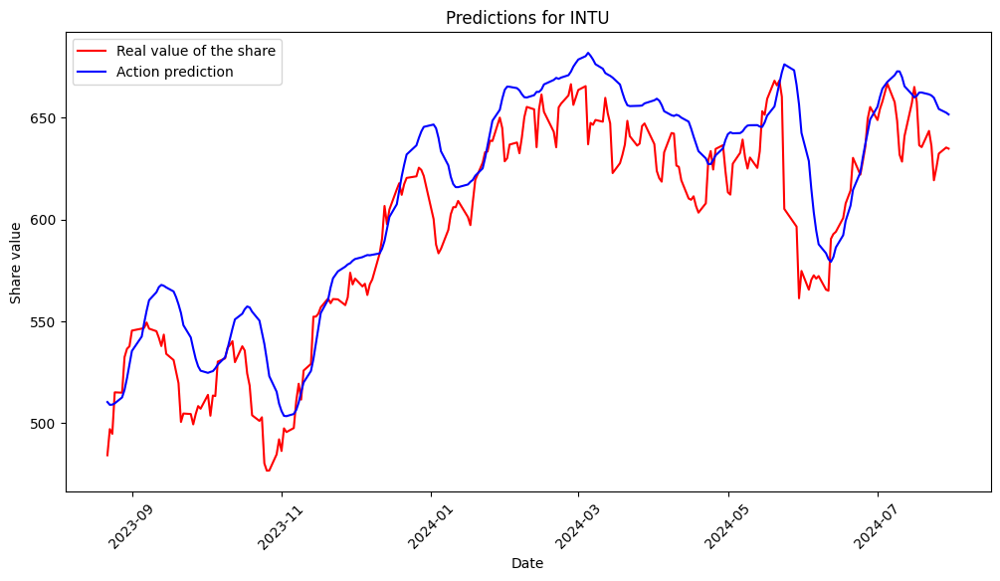

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AMAT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para AMAT: 72.68531258013525, MAE: 6.775805650335237, R2: 0.9402444541787094


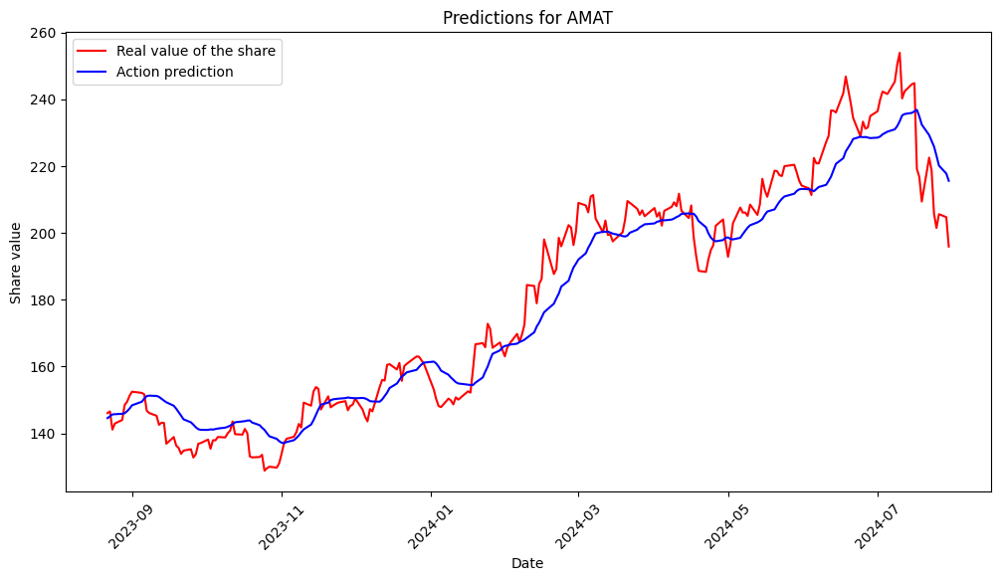

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para MU: 29.601254710921527, MAE: 3.825862547419465, R2: 0.9507193397959224


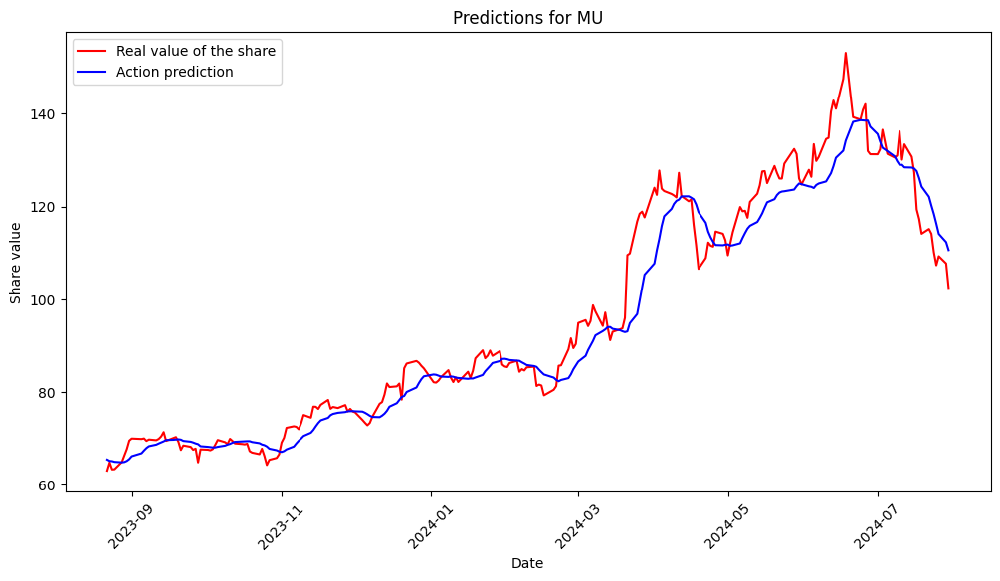

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para LRCX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para LRCX: 44.2063832164804, MAE: 4.826843356425115, R2: 0.8032832342719511


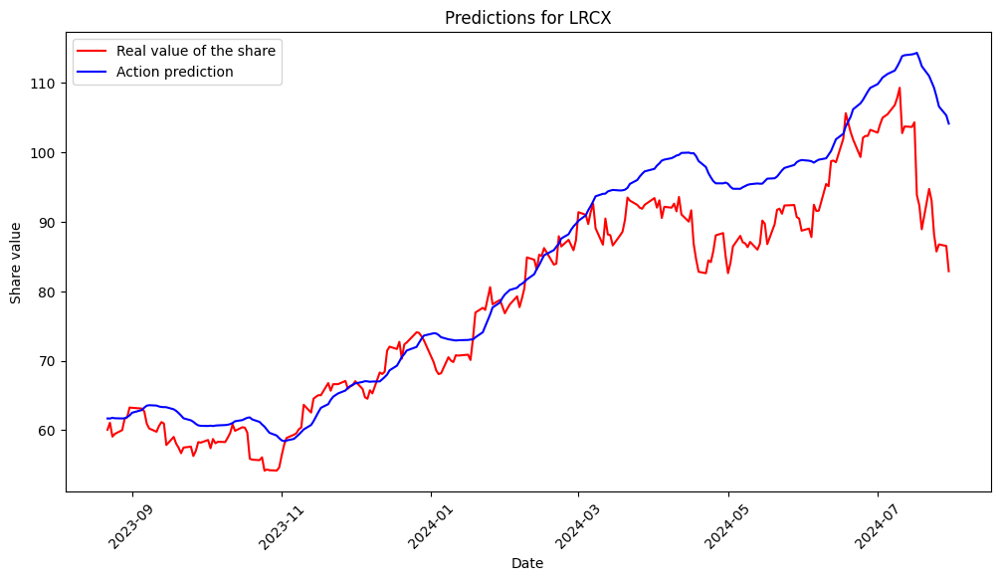

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NOW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para NOW: 1699.5013724530977, MAE: 35.33534444375176, R2: 0.7353122428252926


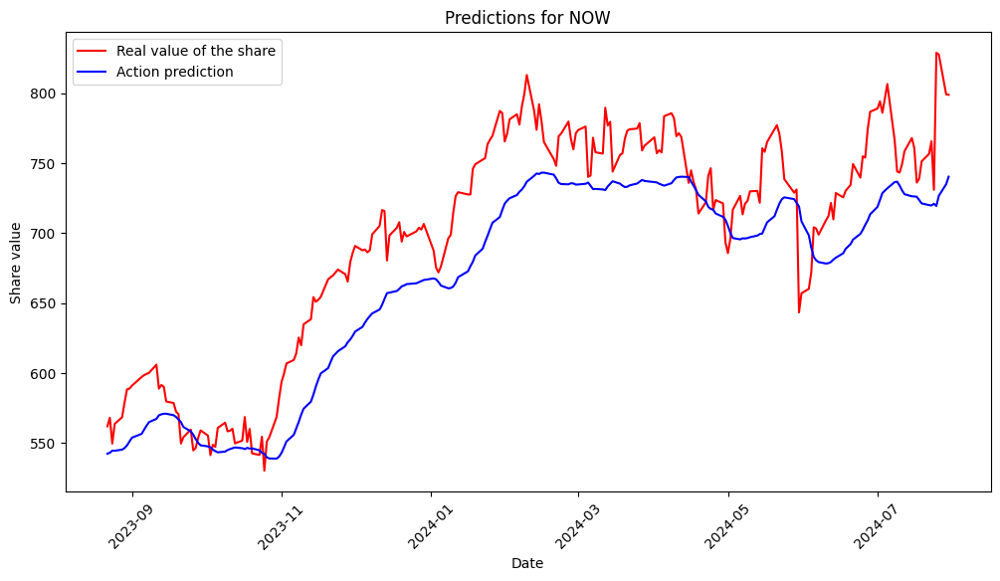

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PANW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para PANW: 312.891775246476, MAE: 12.749533342805279, R2: 0.7677970330776523


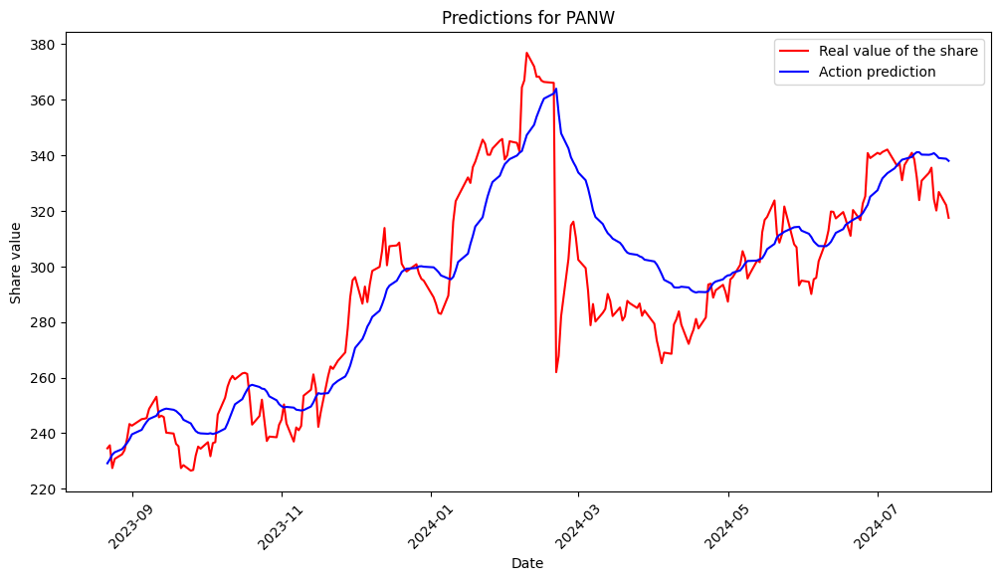

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para SNPS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para SNPS: 452.0857756839631, MAE: 15.96821584495104, R2: 0.8043159692376827


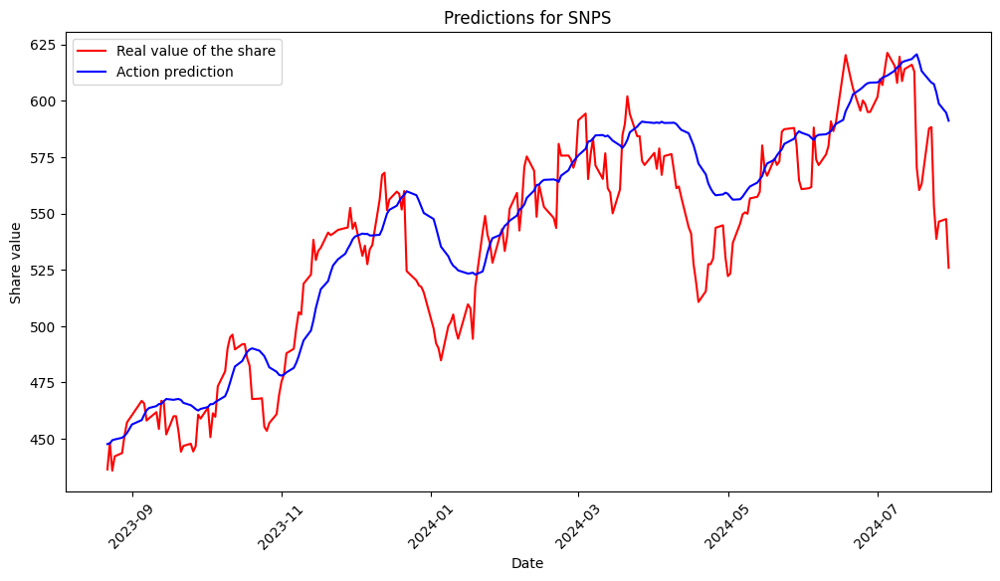

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False



Entrenando modelo para CDNS...


INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para CDNS: 111.51019146843542, MAE: 8.327868046233956, R2: 0.8513644911879839


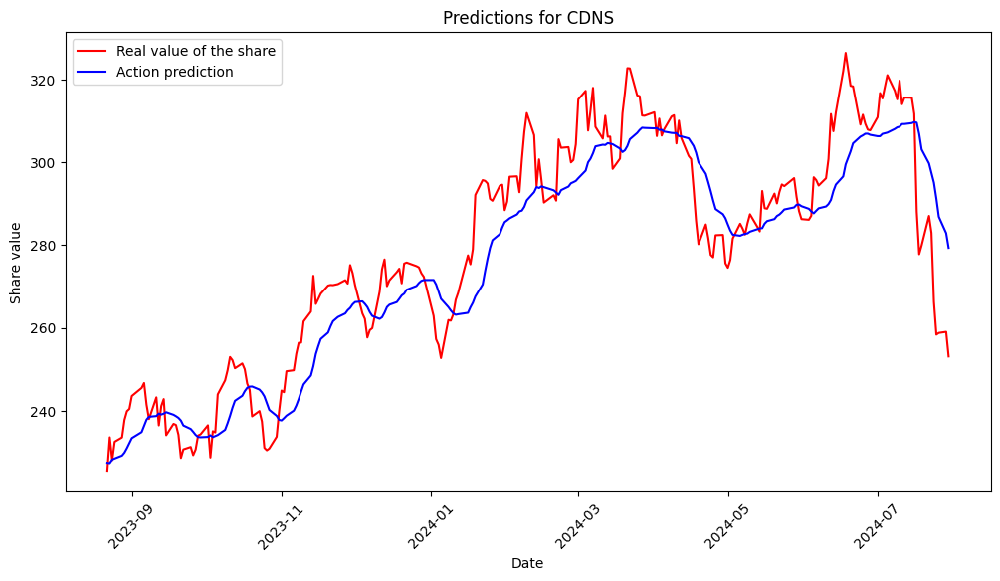

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ANET...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ANET: 154.8367458984719, MAE: 9.13393710241139, R2: 0.9438607078699502


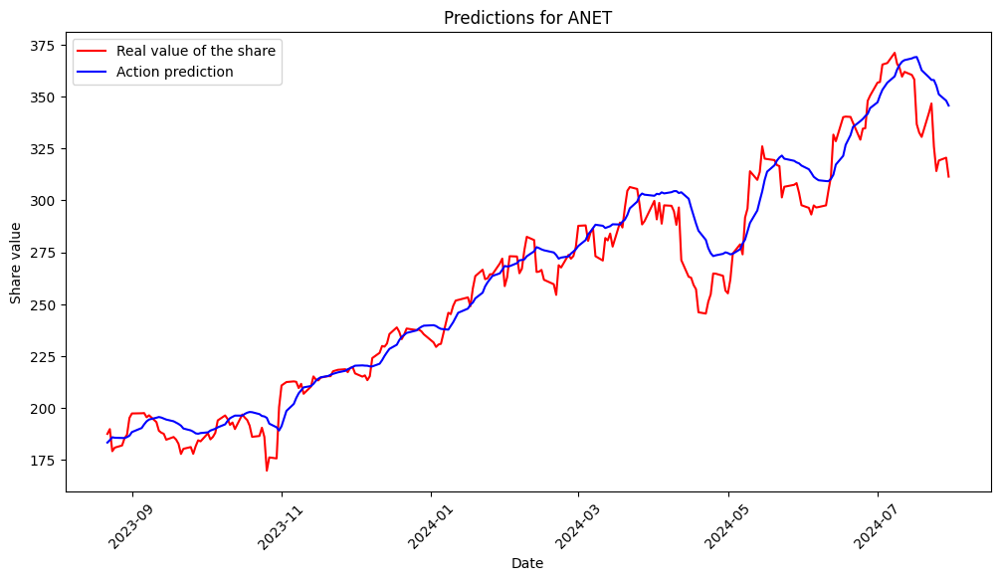

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para FTNT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para FTNT: 8.409874571942515, MAE: 2.3922964018572177, R2: 0.702035716607029


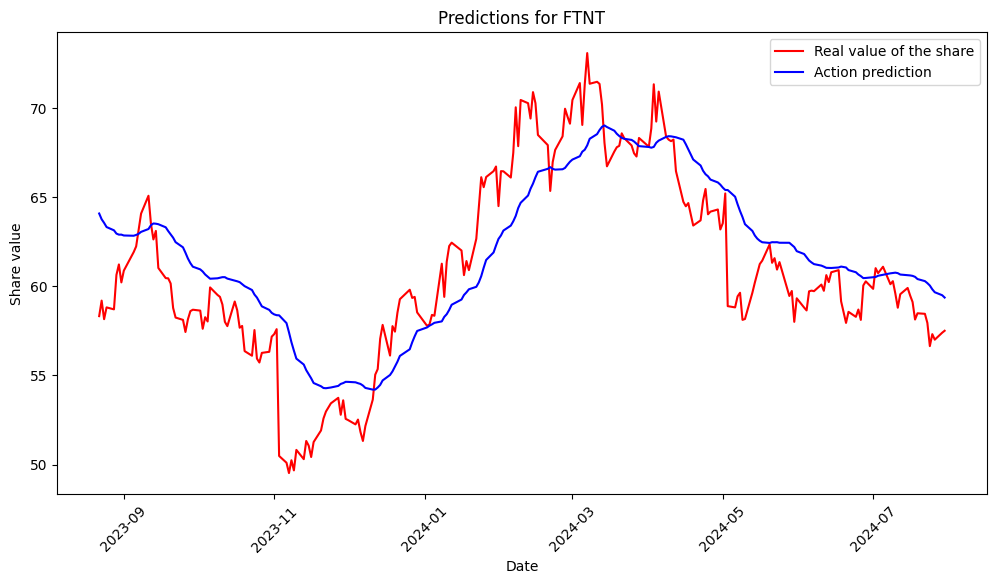

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para KLAC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para KLAC: 784.1481058181427, MAE: 21.00232970640283, R2: 0.9476339617640247


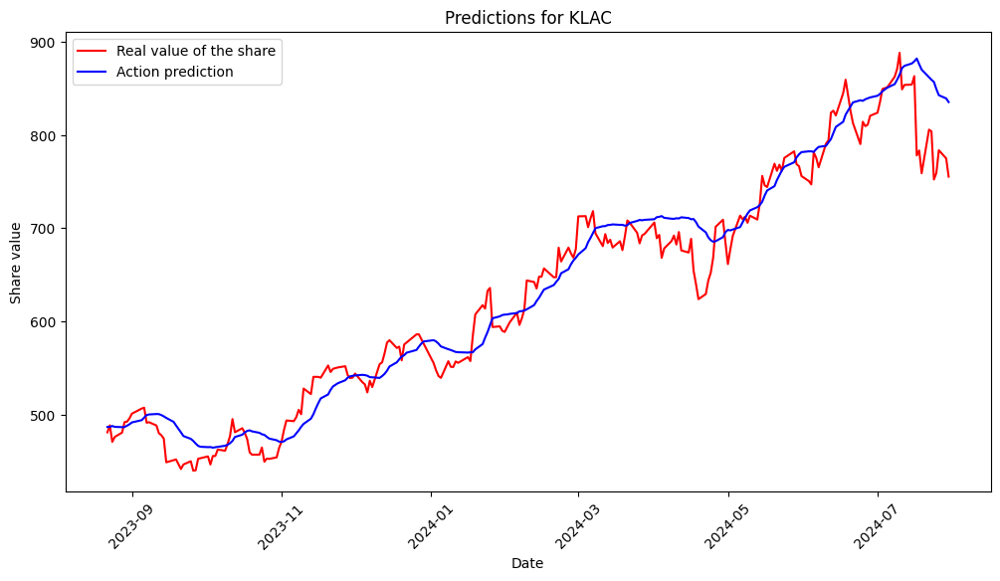

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para APH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para APH: 8.466190946943138, MAE: 2.4870791733353155, R2: 0.9050622812266595


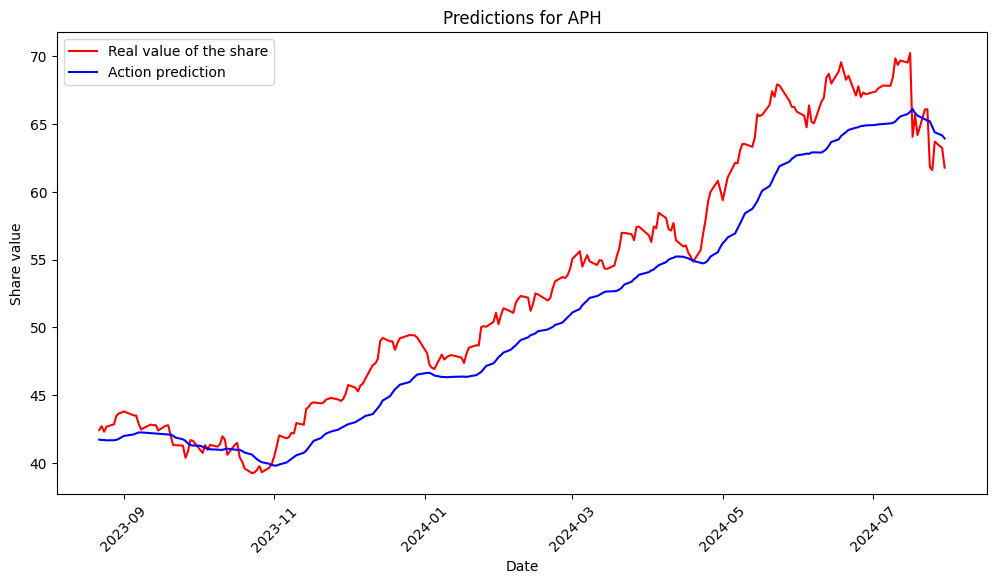

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TEL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para TEL: 14.73583585406424, MAE: 3.1317658393608196, R2: 0.8725100124837171


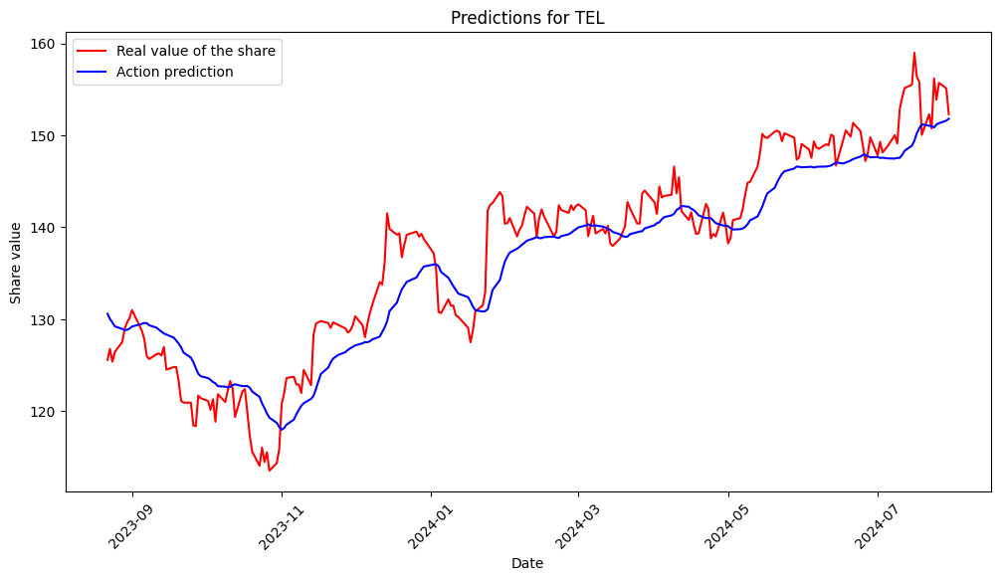

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MCHP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para MCHP: 7.92686583234417, MAE: 2.229099611472639, R2: 0.8140036300167885


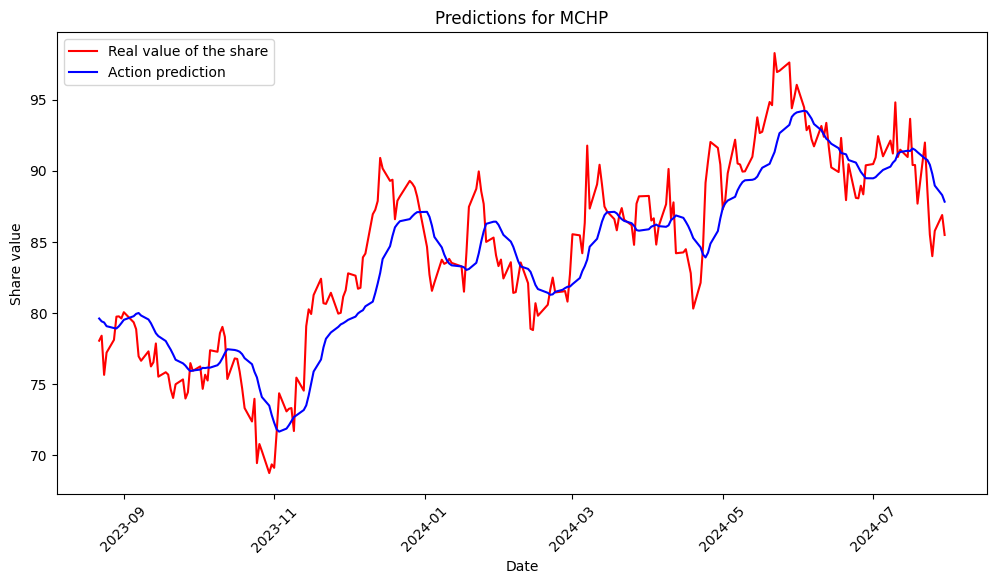

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NXPI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para NXPI: 84.92914716002183, MAE: 7.488751574598565, R2: 0.910918503663946


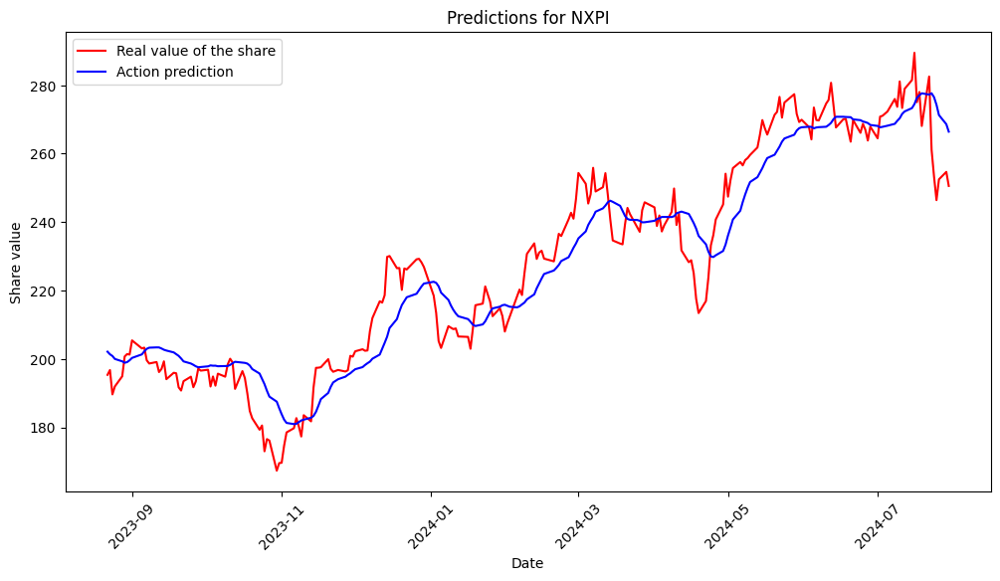

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ON...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ON: 34.78539093880102, MAE: 4.370297581842025, R2: 0.5856518460822983


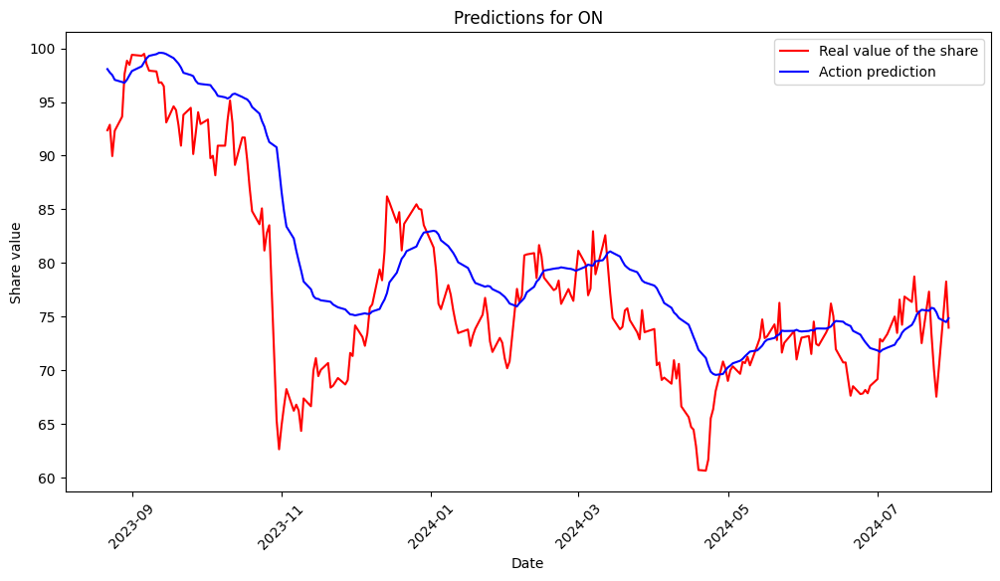

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MPWR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para MPWR: 1664.2767609072355, MAE: 33.90152917977563, R2: 0.8928925525024654


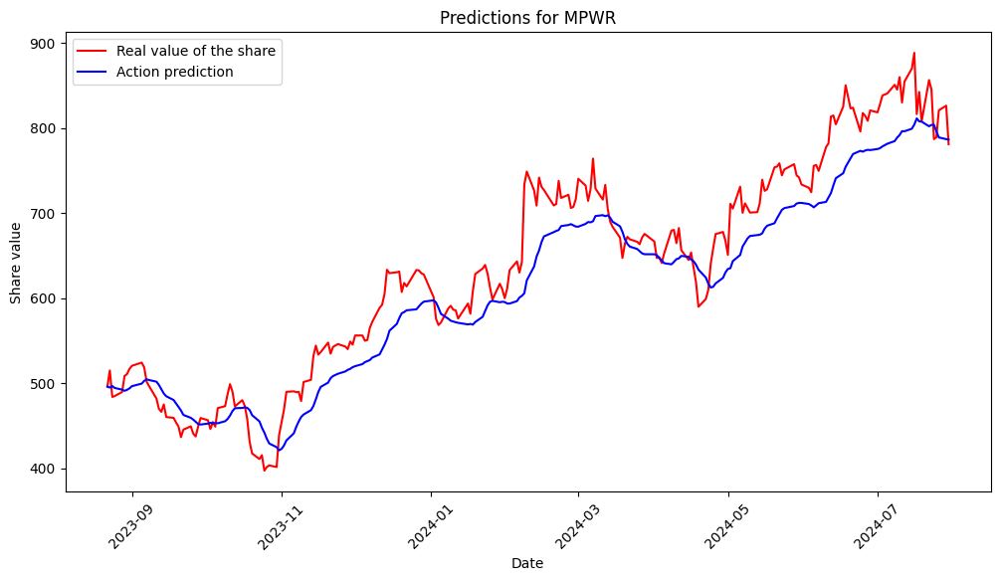

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ADI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ADI: 53.15052122532622, MAE: 5.989627132808614, R2: 0.8889941976995372


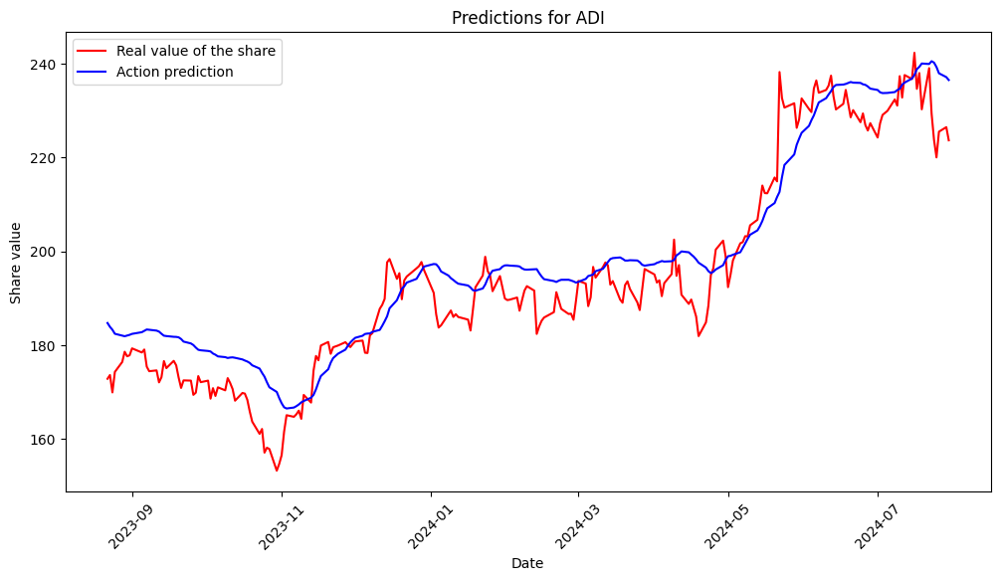

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para KEYS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para KEYS: 30.10268319282888, MAE: 4.1673787658642985, R2: 0.764498678424886


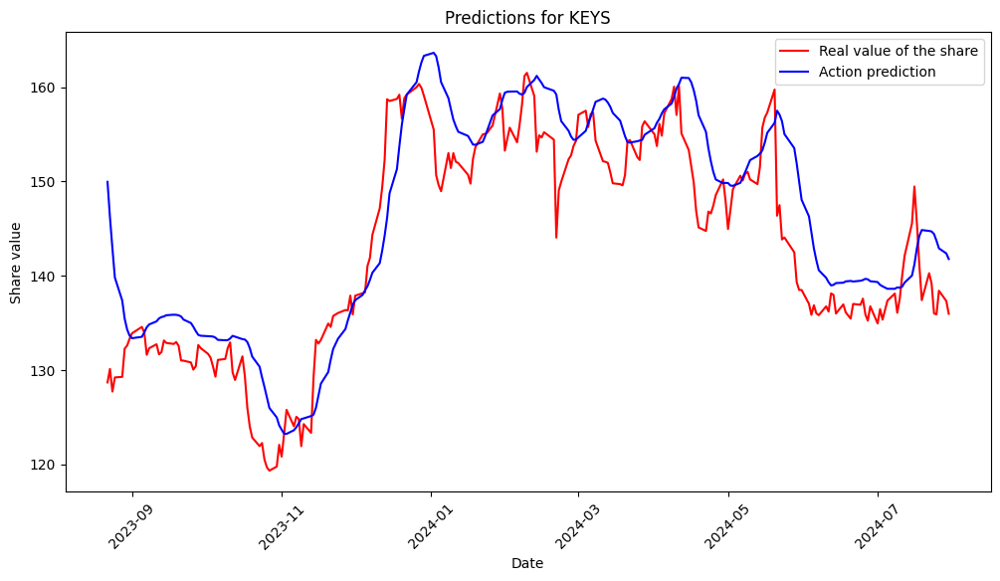

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CDW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para CDW: 58.784501326283674, MAE: 6.350325002529517, R2: 0.7565978770179727


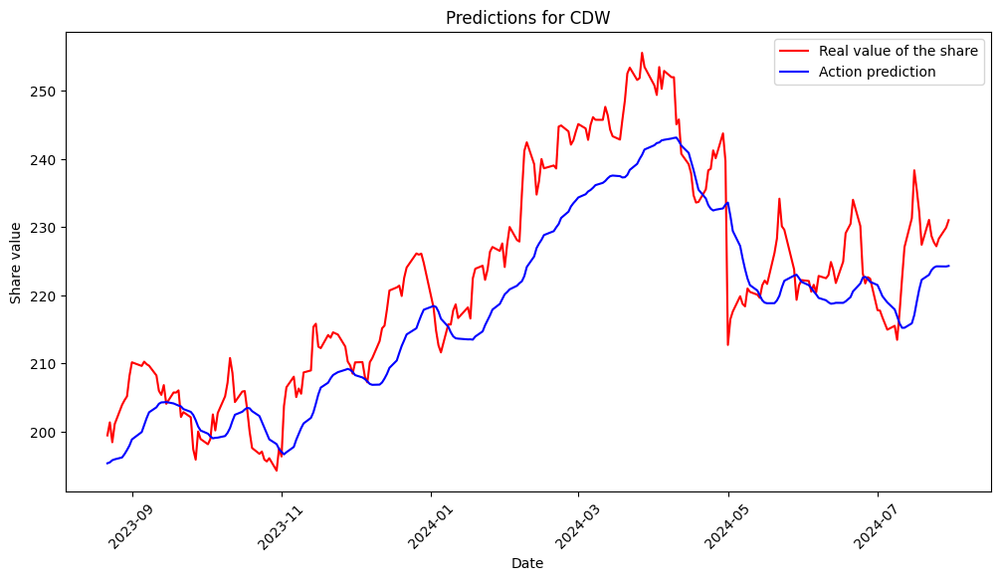

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ANSS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ANSS: 172.6231925745353, MAE: 10.816629453998619, R2: 0.6002419170798048


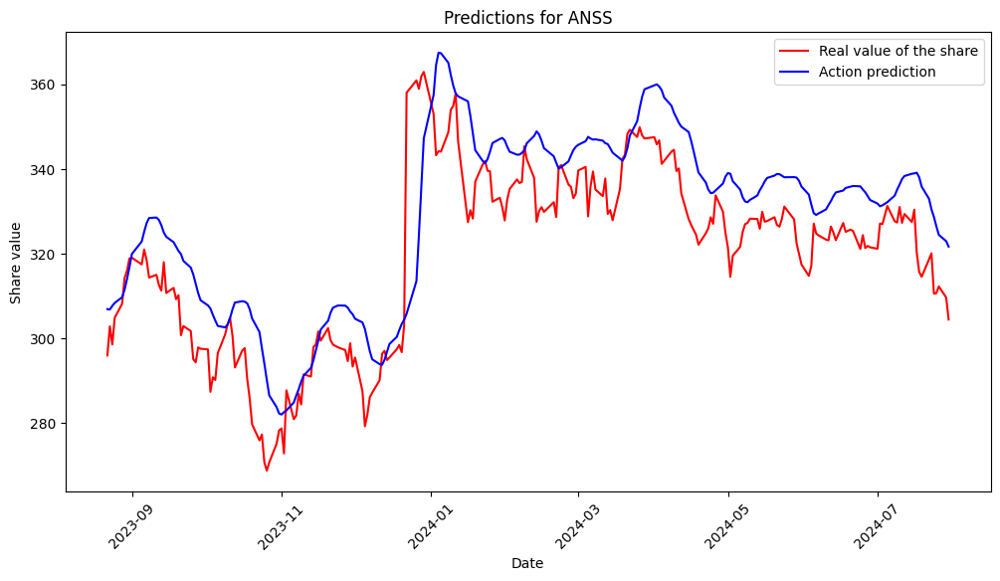

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PAYC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para PAYC: 363.2048263503617, MAE: 14.551879055666477, R2: 0.7885047948093998


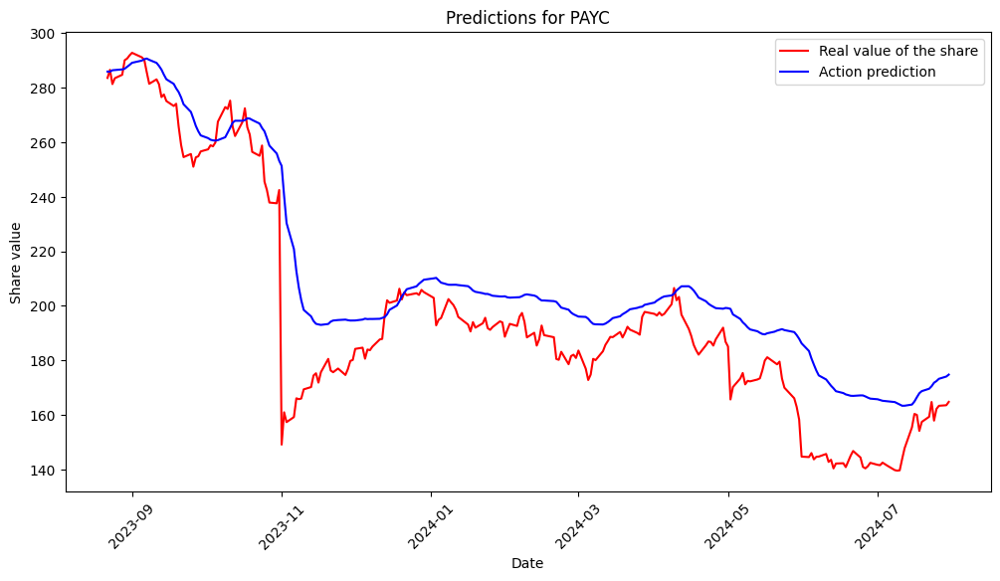

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GDDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para GDDY: 62.80806369226759, MAE: 6.485707830353552, R2: 0.8909647147440768


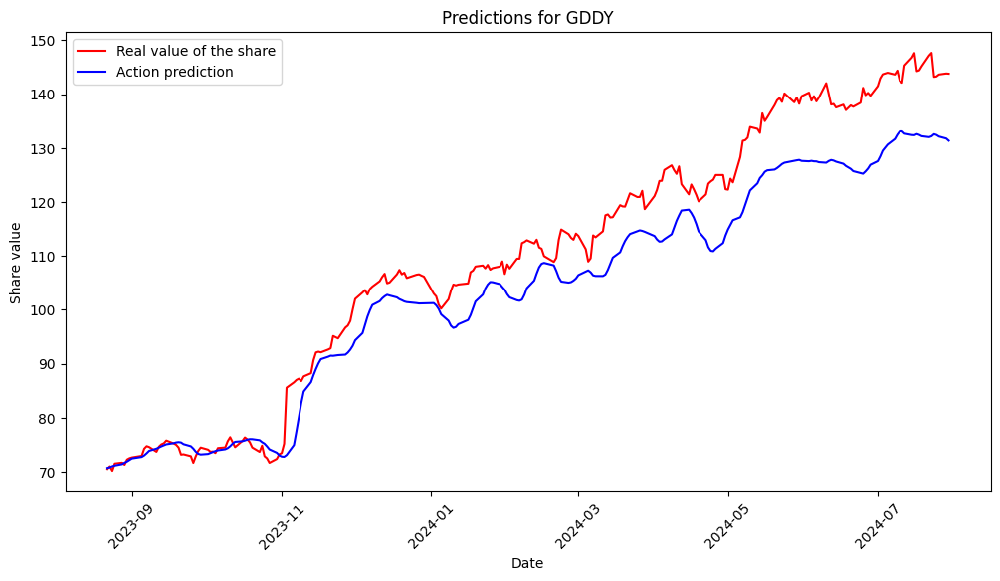

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TYL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para TYL: 279.61120426698517, MAE: 12.09189394825577, R2: 0.8623485456653335


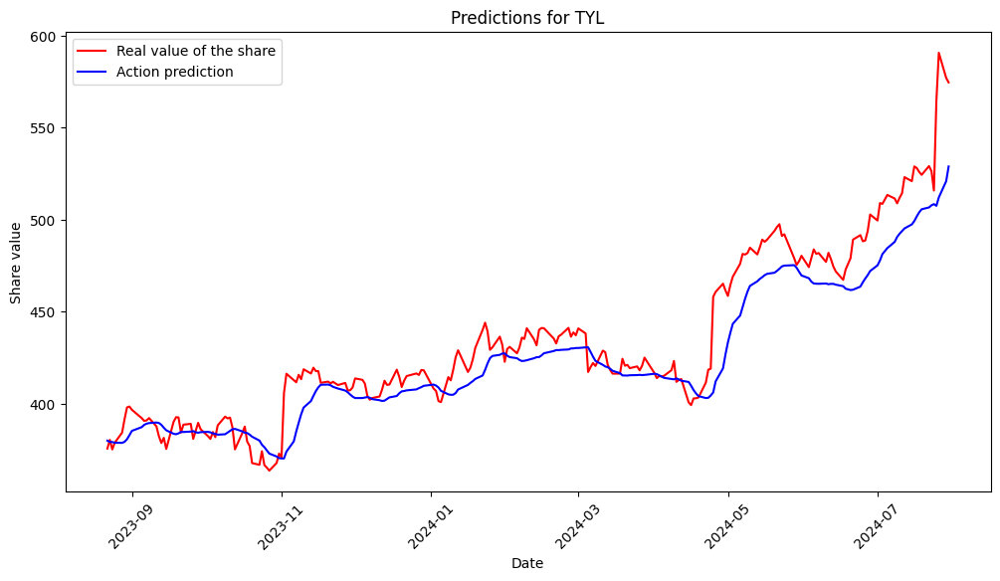

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para SSNC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para SSNC: 2.7545803638864625, MAE: 1.2678612799467155, R2: 0.8837680129726624


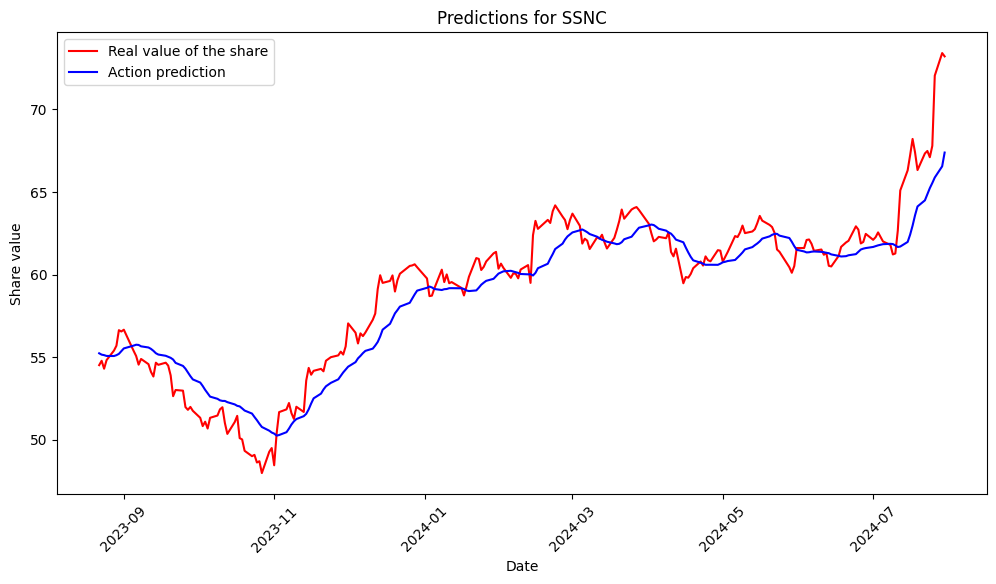

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JKHY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para JKHY: 10.756567295270408, MAE: 2.6266276527851655, R2: 0.8763176341824918


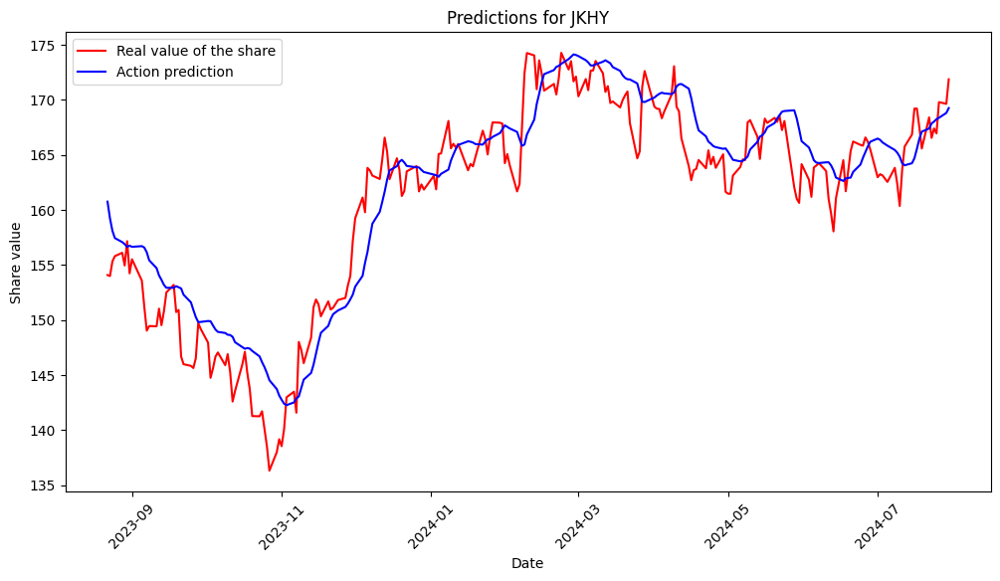

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para EPAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para EPAM: 224.22598930676088, MAE: 11.487781720650311, R2: 0.8664693031790094


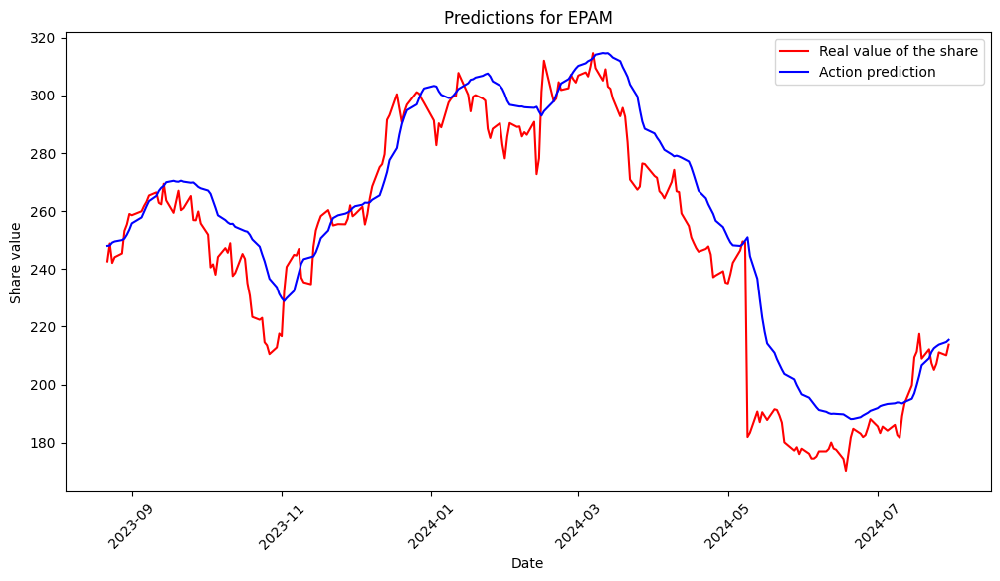

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GLW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para GLW: 2.6224359637926637, MAE: 1.1409717744411294, R2: 0.8721891087383489


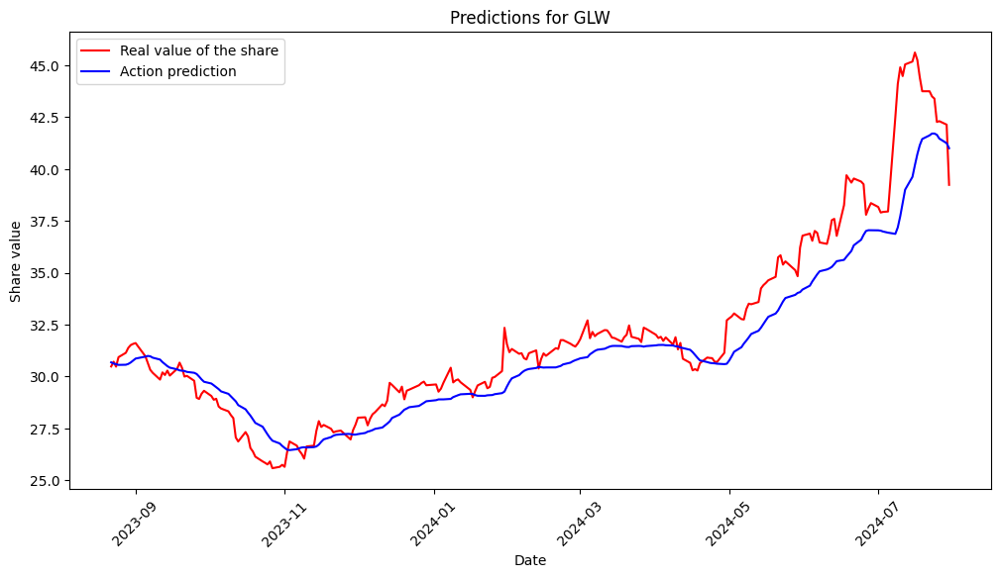

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para HPQ...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para HPQ: 2.1470629372274965, MAE: 1.101114976669801, R2: 0.8100693000987362


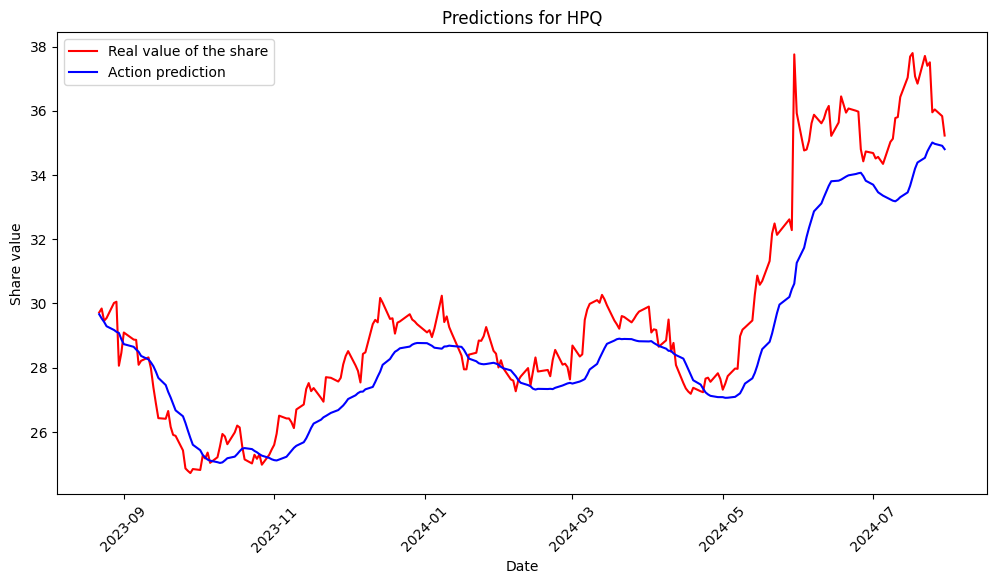

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para DXC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para DXC: 0.774366382013533, MAE: 0.6183505722446654, R2: 0.8021535666322037


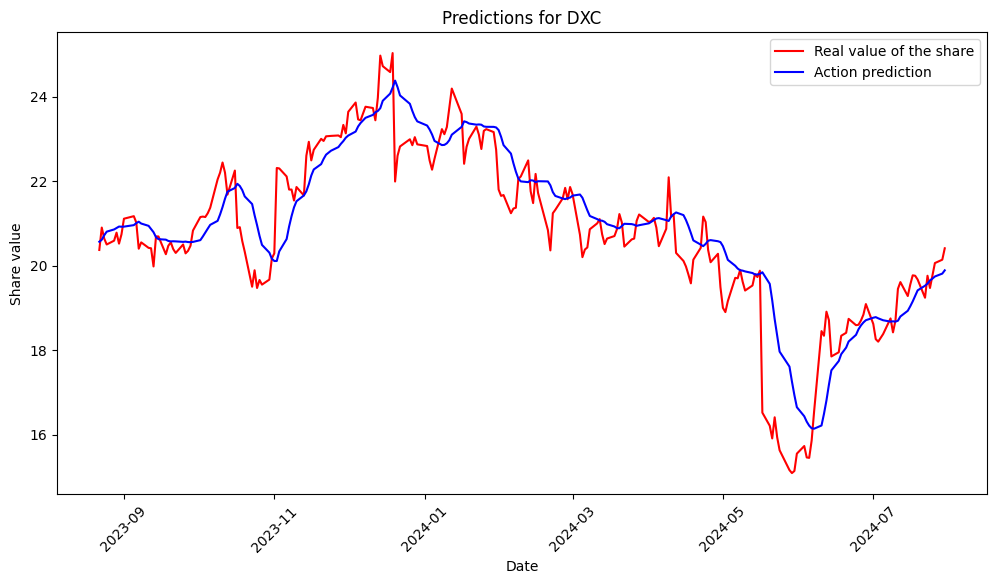

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para IT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para IT: 240.87631425458792, MAE: 11.50851880224353, R2: 0.8831450691929927


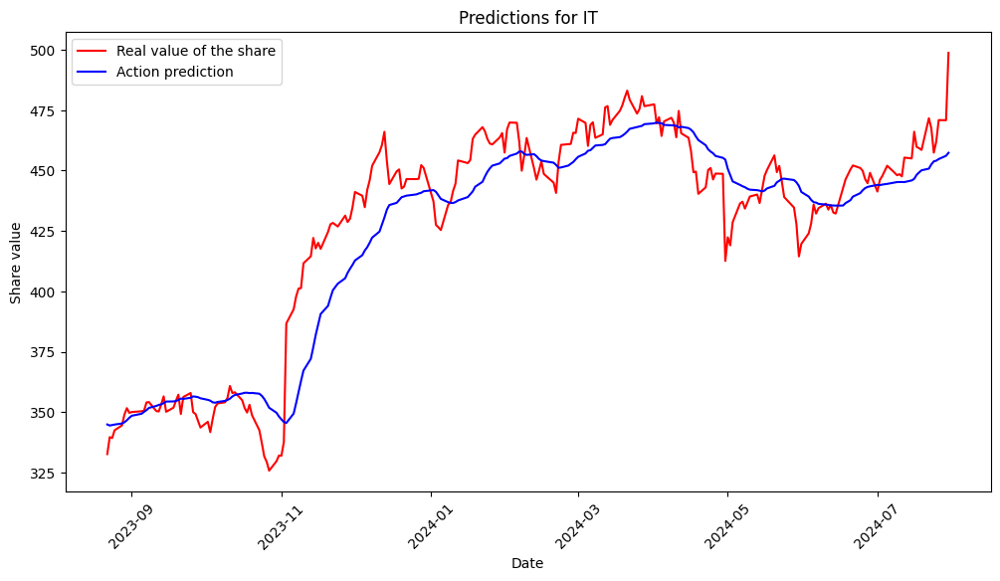

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para LDOS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para LDOS: 10.12563933324212, MAE: 2.374803604818249, R2: 0.975065547157247


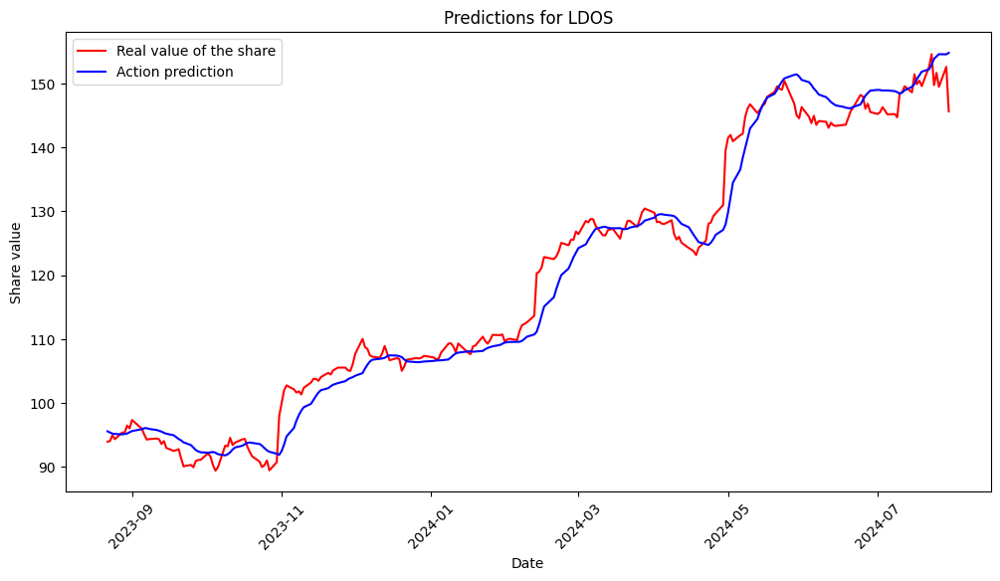

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AKAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para AKAM: 9.02951525276662, MAE: 2.11892738776666, R2: 0.9057779162151028


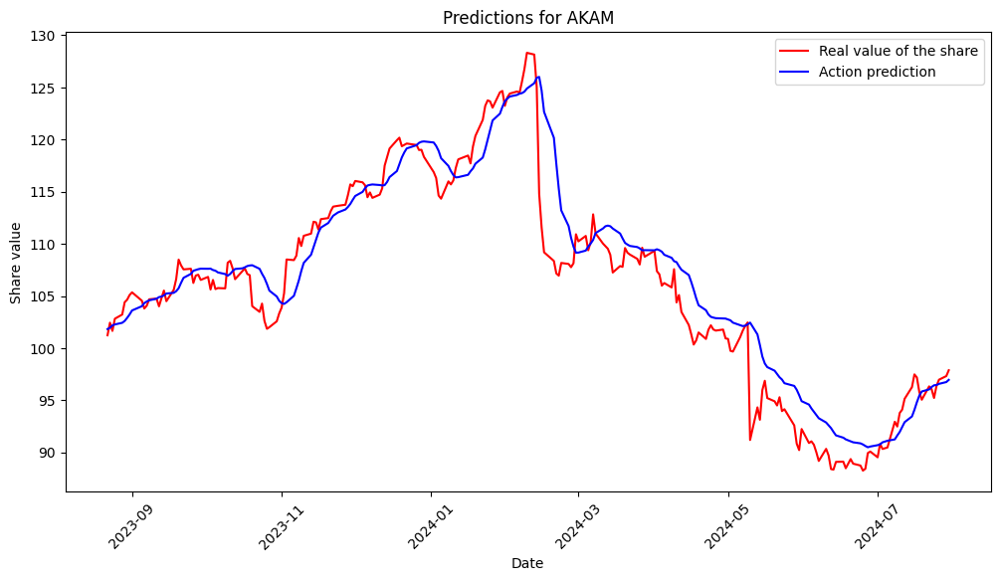

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NTAP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para NTAP: 40.6907269371313, MAE: 4.828100197014288, R2: 0.8810964154333577


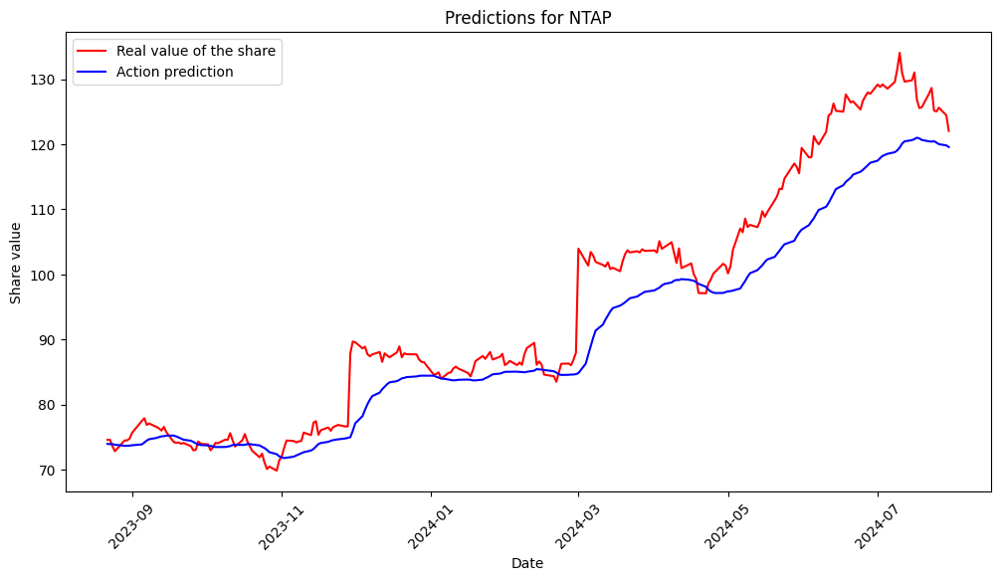

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para VRSN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para VRSN: 13.018205461759212, MAE: 2.8420802263521434, R2: 0.929520048032838


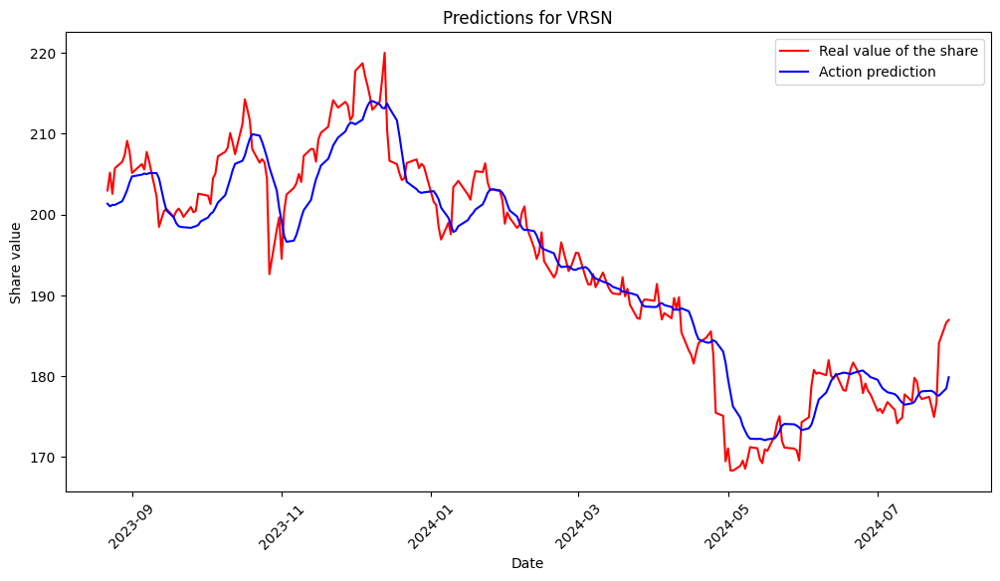

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para FFIV...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para FFIV: 18.374584834060833, MAE: 3.066009351060004, R2: 0.8714853378378412


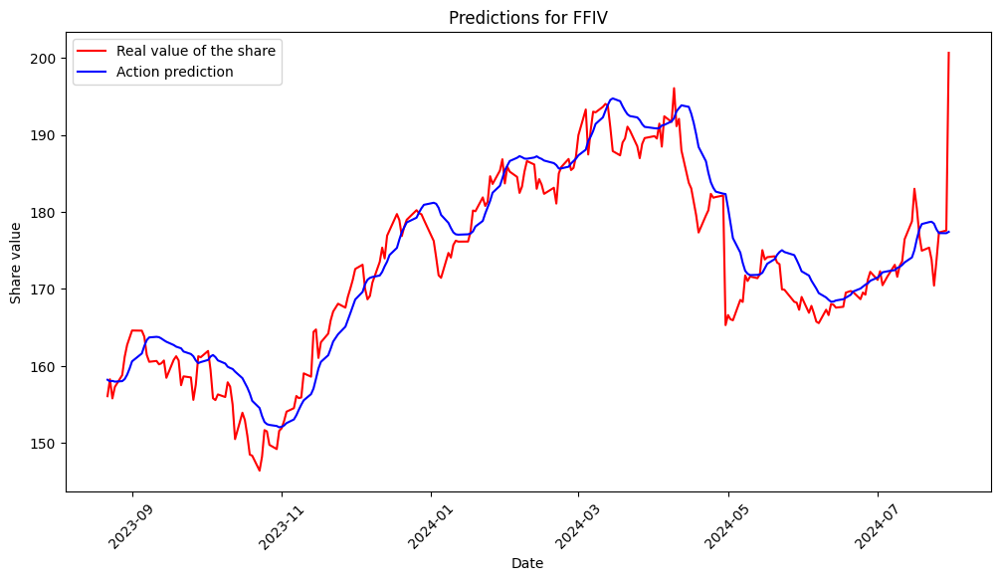

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para XRX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para XRX: 0.6830908745565918, MAE: 0.6111849446414893, R2: 0.8350109172394748


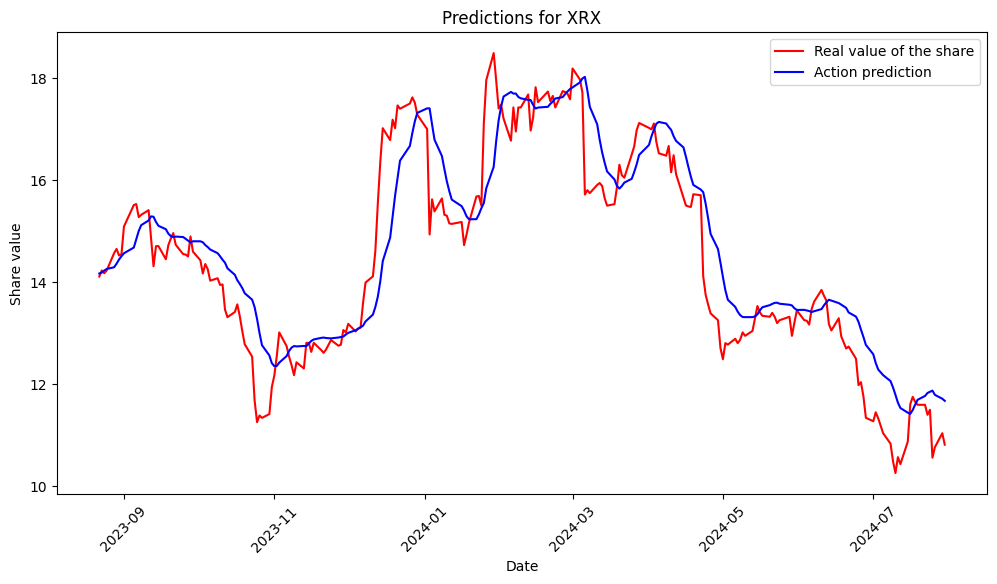

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JNPR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para JNPR: 1.12721945601575, MAE: 0.6174234111312175, R2: 0.9432417024309537


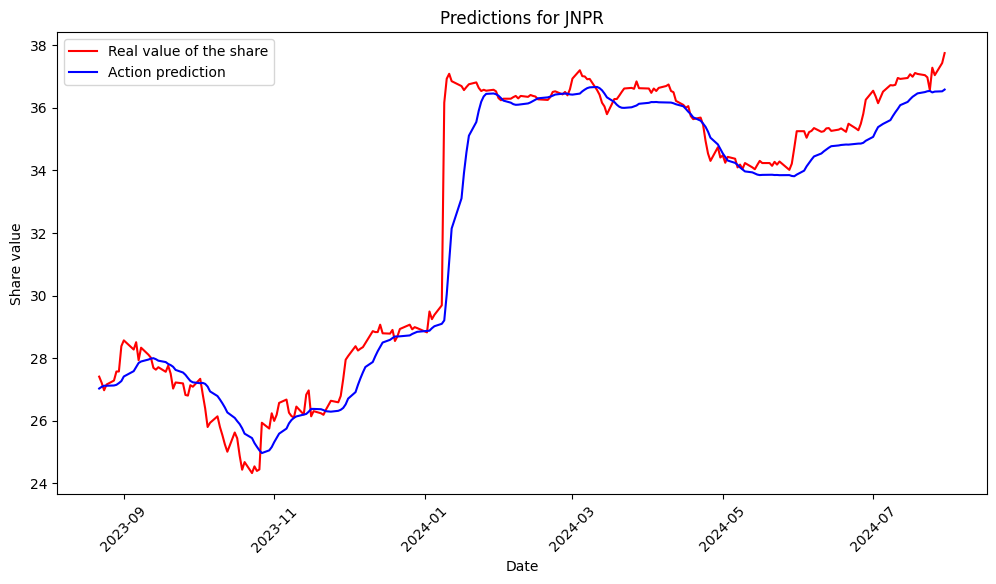

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CSGP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para CSGP: 6.144969948788848, MAE: 1.8920979972499872, R2: 0.8377106809688788


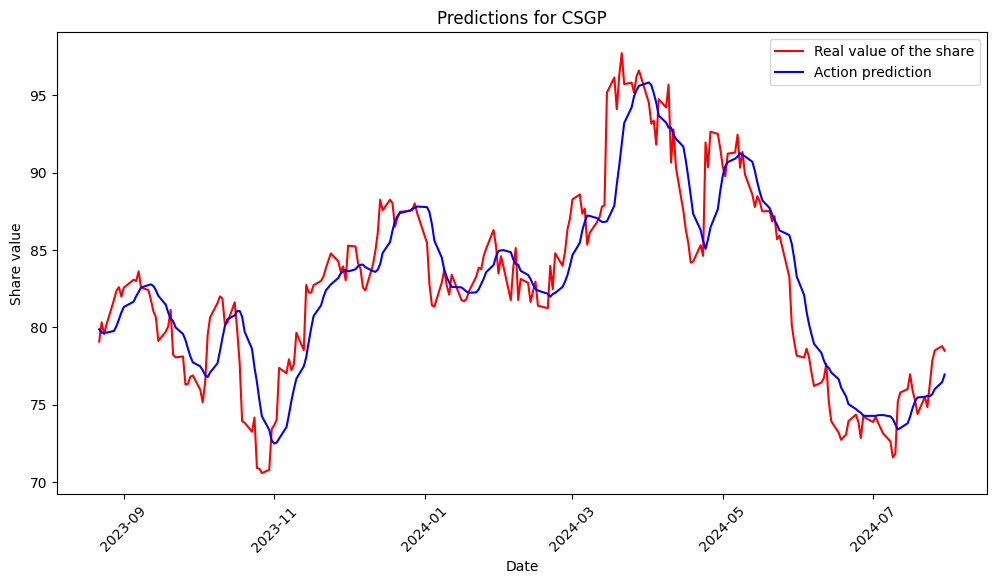

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TRMB...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para TRMB: 7.576900553368805, MAE: 2.0832240378390385, R2: 0.7593716850473649


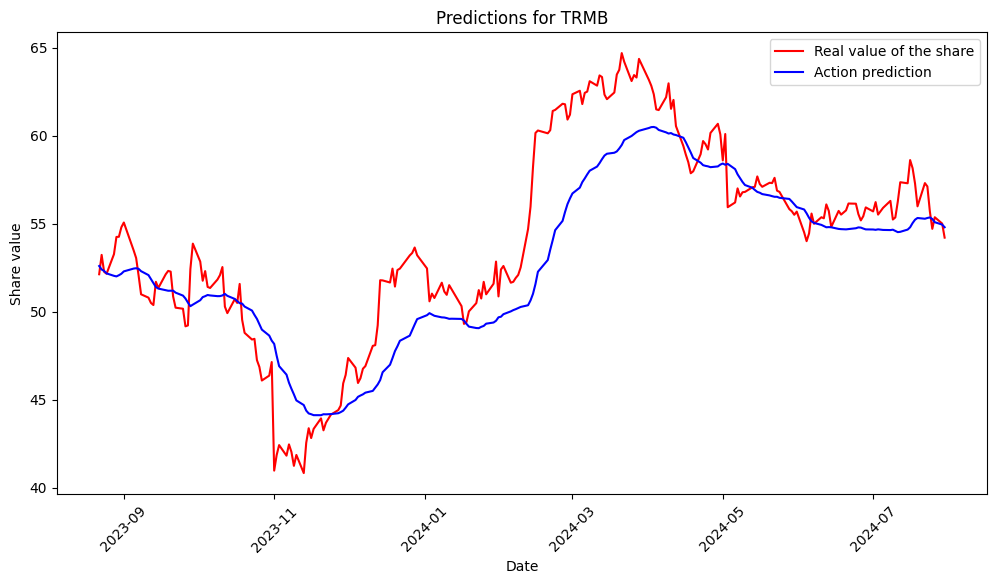

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GRMN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para GRMN: 22.453955731045298, MAE: 3.5370451216951584, R2: 0.9590240941371547


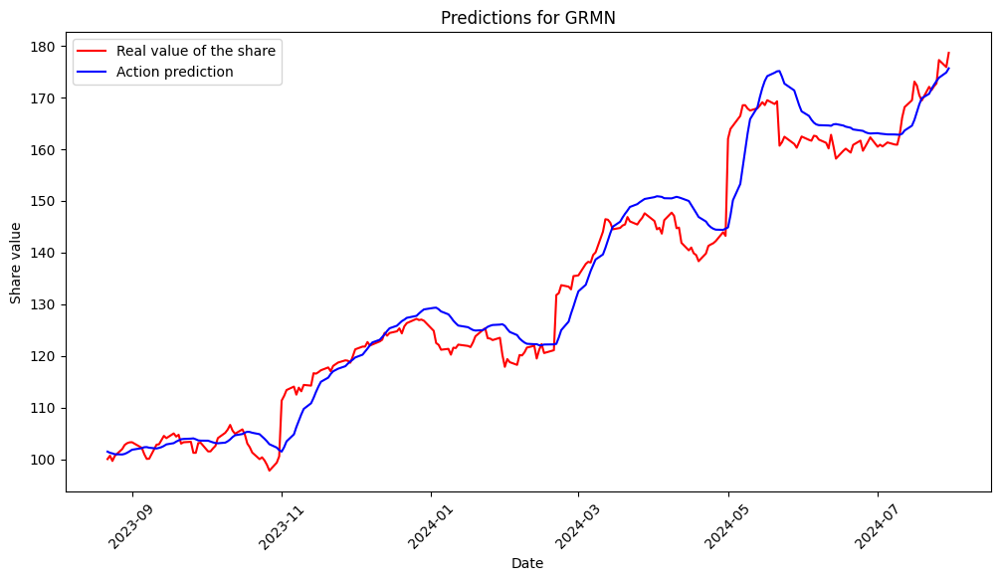

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ZBRA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para ZBRA: 159.74678056502677, MAE: 10.04550055067338, R2: 0.8846755813771858


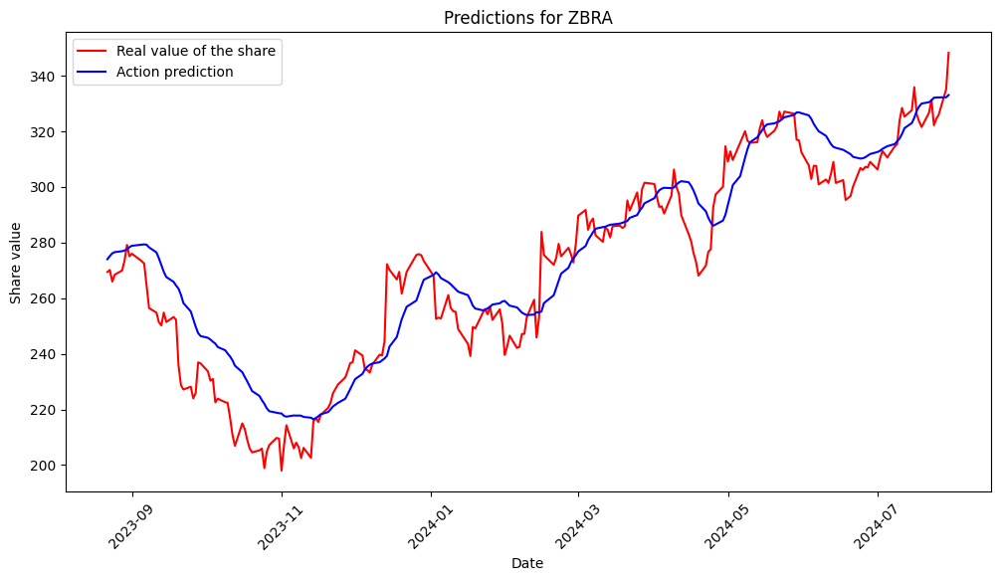

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para BR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para BR: 34.685109808628745, MAE: 4.971063291676281, R2: 0.6847620371709029


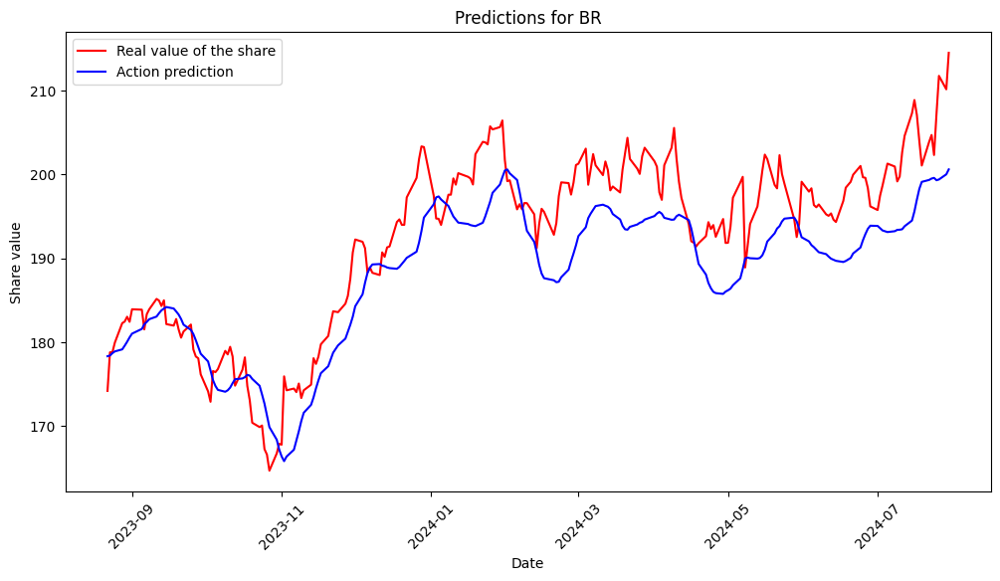

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PTC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para PTC: 20.401945707763893, MAE: 3.7150101097815416, R2: 0.9253707435622878


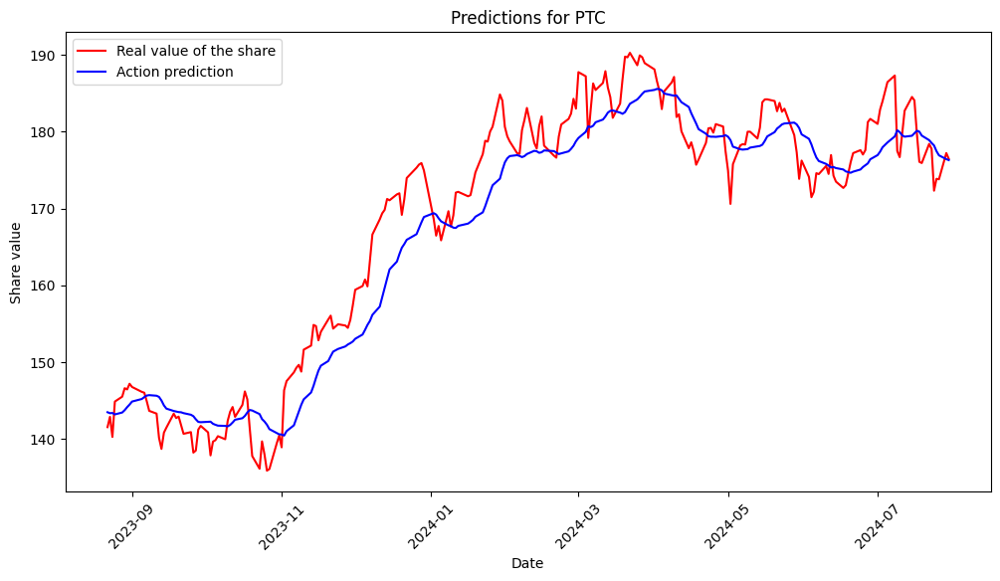

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CTSH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para CTSH: 3.6032986952588812, MAE: 1.60323474570311, R2: 0.7986484817179627


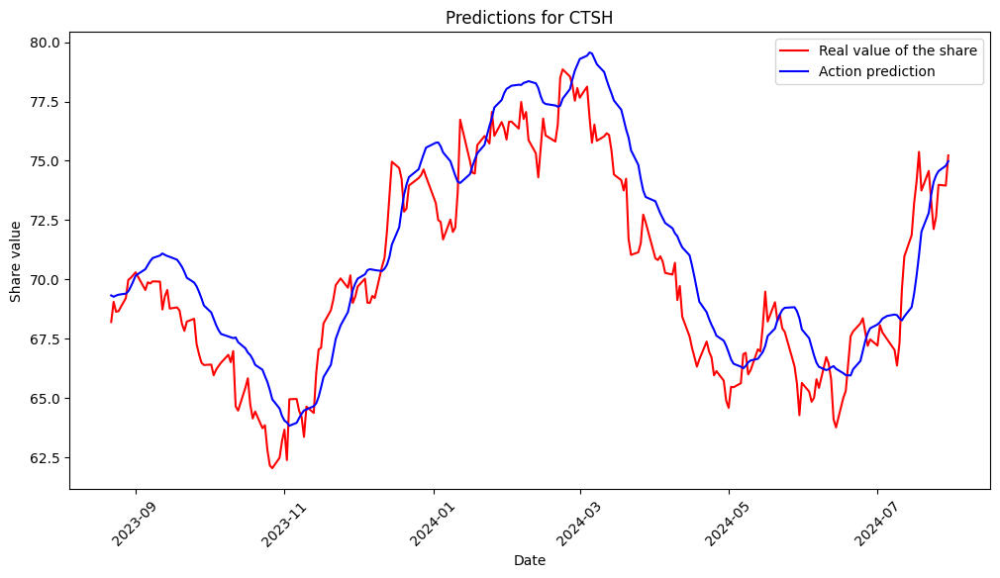

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para HPE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para HPE: 0.6623461555422046, MAE: 0.5991533133567223, R2: 0.7997065867009797


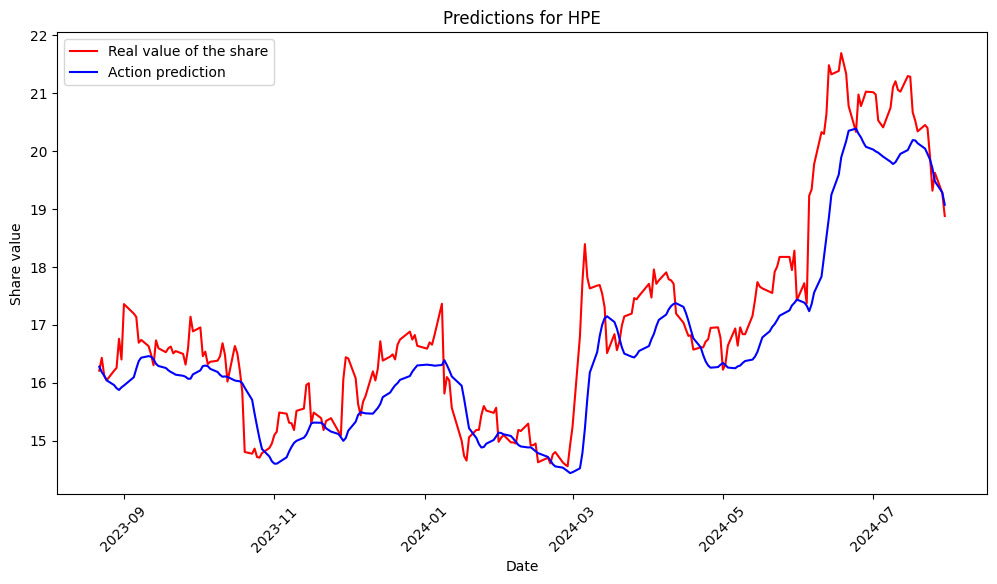

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MSI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para MSI: 124.43326965659561, MAE: 9.310597969152754, R2: 0.9059985049560086


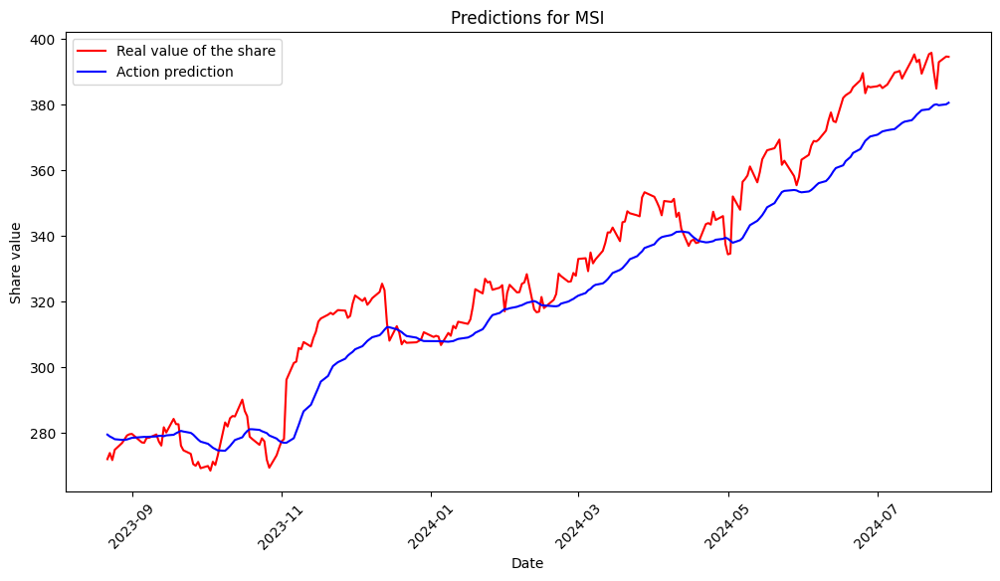

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para TDY: 86.82044228385253, MAE: 7.258142736848533, R2: 0.7475347877246938


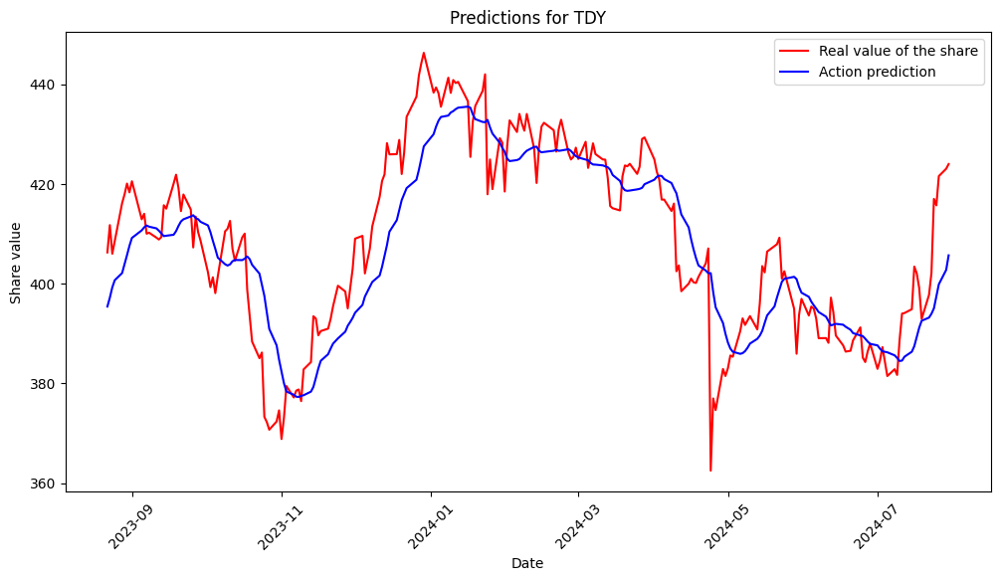

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para WDC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para WDC: 4.466868195260109, MAE: 1.6180565274413652, R2: 0.9722819593923626


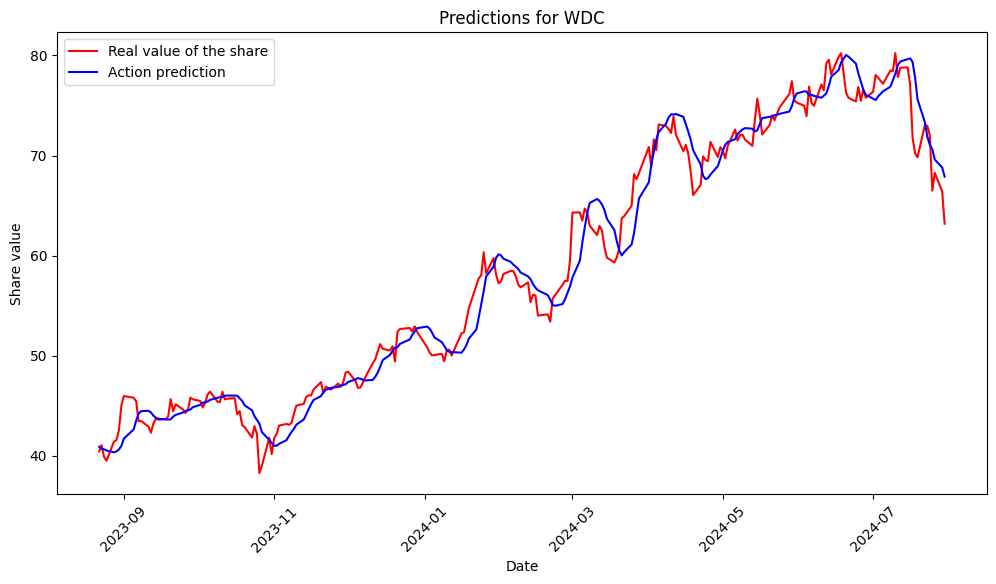

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para STX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


MSE para STX: 9.544491955829425, MAE: 2.3954304266935704, R2: 0.9434052914912422


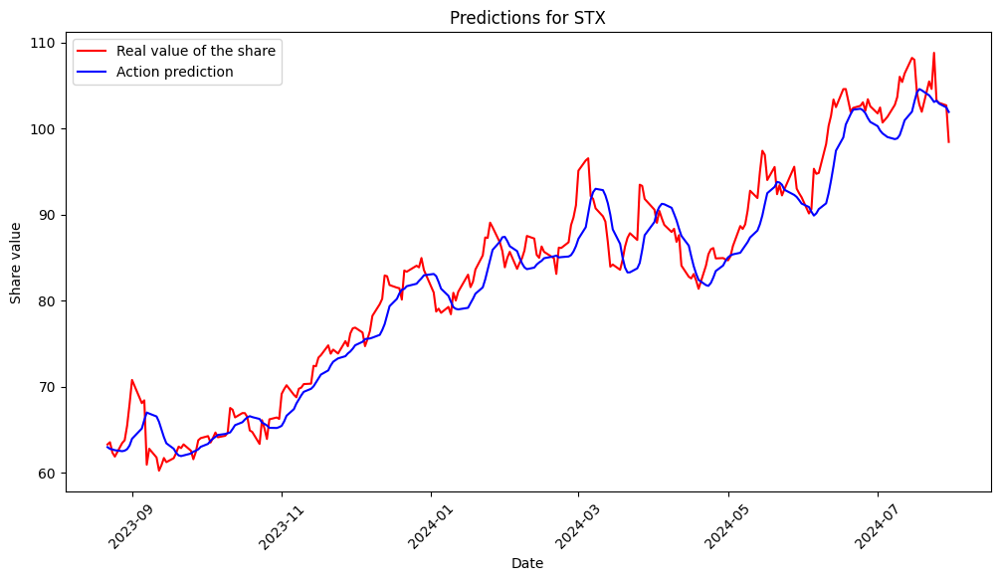


Métricas de rendimiento:
   ticker         mse        mae        r2
0    AAPL   59.966175   6.552963  0.765746
1    MSFT  203.808818  12.092011  0.881776
2    NVDA   50.128018   4.821945  0.940716
3    AVGO   53.955416   5.469260  0.924256
4    ORCL   30.543815   4.287667  0.775802
..    ...         ...        ...       ...
57    HPE    0.662346   0.599153  0.799707
58    MSI  124.433270   9.310598  0.905999
59    TDY   86.820442   7.258143  0.747535
60    WDC    4.466868   1.618057  0.972282
61    STX    9.544492   2.395430  0.943405

[62 rows x 4 columns]


In [36]:
# **Modelo 3. Análisis de sentimientos con TRANSFORMERS**
import requests
from bs4 import BeautifulSoup
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np
import torch
from torch.utils.data import DataLoader, TensorDataset
import pytorch_lightning as pl
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Cargar modelo y tokenizador FinBERT
tokenizer = AutoTokenizer.from_pretrained("yiyanghkust/finbert-tone")
model = AutoModelForSequenceClassification.from_pretrained("yiyanghkust/finbert-tone")

def analizar_sentimiento_finbert(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, max_length=512)
    with torch.no_grad():
        outputs = model(**inputs)
    logits = outputs.logits
    probabilities = torch.nn.functional.softmax(logits, dim=-1)
    sentiment_score = probabilities[0][2].item() - probabilities[0][0].item()
    return sentiment_score

# Agregar sentimiento de noticias al conjunto de datos
def agregar_sentimiento_noticias(stock_data):
    for ticker in stock_data.keys():
        data = stock_data[ticker]

        if 'sentimiento_noticias' not in data.columns:
            data['sentimiento_noticias'] = 0  # Por defecto, sentimiento neutral

        stock_data[ticker] = data
    return stock_data

# Definir el modelo LSTM
class LSTMModel(pl.LightningModule):
    def __init__(self, input_size=5, hidden_layer_size=100, output_size=1, lr=0.001):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = torch.nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = torch.nn.Linear(hidden_layer_size, output_size)
        self.lr = lr
        self.criterion = torch.nn.MSELoss()

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1])
        return predictions

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('train_loss', loss)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)

# Entrenar y evaluar el modelo
future_prices = {}

def train_and_evaluate_model(ticker):
    print(f"\nEntrenando modelo para {ticker}...")
    features = ['Adj Close', 'MA_10', 'MA_30', 'MA_60', 'sentimiento_noticias']

    data = stock_data[ticker]
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])

    time_step = 60
    X, y = [], []
    for i in range(time_step, len(scaled_data)):
        X.append(scaled_data[i-time_step:i])
        y.append(scaled_data[i, 0])

    X = np.array(X)
    y = np.array(y)

    train_size = int(len(X) * 0.8)
    X_train, X_val = X[:train_size], X[train_size:]
    y_train, y_val = y[:train_size], y[train_size:]

    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
    X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
    y_val_tensor = torch.tensor(y_val, dtype=torch.float32).unsqueeze(1)

    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

    model = LSTMModel(input_size=len(features))
    trainer = pl.Trainer(max_epochs=10, logger=False, enable_checkpointing=False)
    trainer.fit(model, train_loader)

    model.eval()
    with torch.no_grad():
        predictions = model(X_val_tensor).numpy()

    predictions_descaled = scaler.inverse_transform(np.concatenate(
        [predictions, np.zeros((predictions.shape[0], len(features) - 1))], axis=1))[:, 0]

    y_val_descaled = scaler.inverse_transform(np.concatenate(
        [y_val.reshape(-1, 1), np.zeros((y_val.shape[0], len(features) - 1))], axis=1))[:, 0]

    mse = mean_squared_error(y_val_descaled, predictions_descaled)
    mae = mean_absolute_error(y_val_descaled, predictions_descaled)
    r2 = r2_score(y_val_descaled, predictions_descaled)

    future_prices[ticker] = pd.DataFrame({
        'Real': y_val_descaled,
        'Prediction': predictions_descaled
    })

    print(f"MSE para {ticker}: {mse}, MAE: {mae}, R2: {r2}")

    # Llamar a la función graficar_predicciones
    val_dates = data.index[-len(y_val_descaled):]  # Fechas correspondientes al conjunto de validación
    graficar_predicciones(y_val_descaled, predictions_descaled, val_dates, ticker)


    return {'ticker': ticker, 'mse': mse, 'mae': mae, 'r2': r2}

# Procesar datos y entrenar modelos
stock_data = agregar_sentimiento_noticias(stock_data)

results = []
for ticker in stock_data.keys():
    result = train_and_evaluate_model(ticker)
    results.append(result)

metrics_df = pd.DataFrame(results)
print("\nMétricas de rendimiento:")
print(metrics_df)

# Guardar predicciones
for ticker, df in future_prices.items():
    df.to_csv(f"future_prices_{ticker}.csv", index=False)


# Optimización y Comparación del Portafolio

En esta sección, se optimiza un portafolio utilizando las predicciones de los modelos entrenados y se compara su desempeño con los índices **XLK** (sector tecnológico) y **S&P 500**.

## Proceso de Optimización del Portafolio
1. **Predicciones del Modelo**:
   - Se utilizan las predicciones generadas por los modelos para calcular los retornos esperados de las acciones seleccionadas.
2. **Cálculo del Ratio de Sharpe**:
   - El Ratio de Sharpe es la métrica principal para la optimización:

$\text{Sharpe Ratio} = \frac{\mathbb{E}[R_p] - R_f}{\sigma_p}$

Donde:
- $\mathbb{E}[R_p]$: Retorno esperado del portafolio.
- $R_f$: Tasa libre de riesgo.
- $\sigma_p$: Volatilidad del portafolio (desviación estándar de los retornos).


- **Retornos esperados**: Se calculan utilizando las predicciones de los modelos.
- **Volatilidad**: Basada en la matriz de covarianza de los retornos históricos.
- **Restricciones**: La suma de las ponderaciones debe ser igual a 1.
- Las ponderaciones individuales no pueden ser negativas (long-only portfolio).

Rendimientos esperados diarios:
AAPL    0.000862
MSFT    0.001307
NVDA    0.003888
AVGO    0.002902
ORCL    0.000837
AMD     0.000929
ACN     0.000217
ADBE    0.000237
TXN     0.000694
IBM     0.001789
QCOM    0.002030
INTU    0.000988
AMAT    0.001536
MU      0.002255
LRCX    0.002056
NOW     0.001367
PANW    0.001560
SNPS    0.001127
CDNS    0.000959
ANET    0.002379
KLAC    0.002161
dtype: float64

Matriz de covarianza diaria:
          AAPL          MSFT      NVDA      AVGO      ORCL       AMD  \
AAPL  0.000013  3.957188e-06  0.000010  0.000008  0.000008  0.000015   
MSFT  0.000004  5.357671e-06  0.000009  0.000006  0.000007  0.000013   
NVDA  0.000010  9.031027e-06  0.000077  0.000022  0.000015  0.000057   
AVGO  0.000008  6.110311e-06  0.000022  0.000022  0.000008  0.000032   
ORCL  0.000008  6.555268e-06  0.000015  0.000008  0.000019  0.000005   
AMD   0.000015  1.325481e-05  0.000057  0.000032  0.000005  0.000161   
ACN   0.000003  2.877410e-06  0.000003  0.000005  0.000004  0.

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.10/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.10/dist-packages/scipy/optimize/_slsqp_py.py:495: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  a_eq = vstack([con['jac'](x, *con['args'])


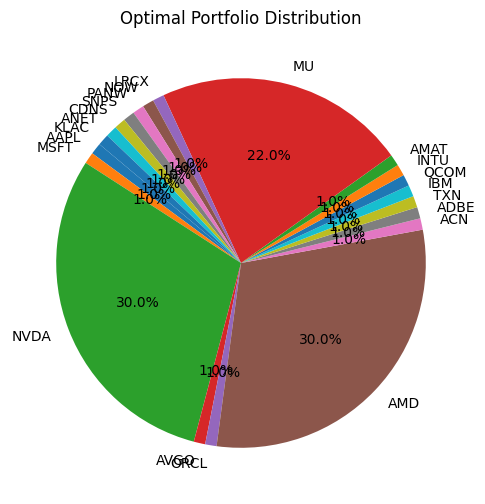

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize

# Cálculo de rendimientos diarios esperados y matriz de covarianza
expected_returns_daily = future_prices_df.pct_change().mean()
cov_matrix_daily = future_prices_df.pct_change().cov()

# Excluir acciones con rendimientos esperados negativos
positive_return_tickers = expected_returns_daily[expected_returns_daily > 0].index
expected_returns_daily = expected_returns_daily[positive_return_tickers]
cov_matrix_daily = cov_matrix_daily.loc[positive_return_tickers, positive_return_tickers]

top_tickers = positive_return_tickers
expected_returns_daily_top = expected_returns_daily[top_tickers]
cov_matrix_daily_top = cov_matrix_daily.loc[top_tickers, top_tickers]

# Mostrar los rendimientos esperados diarios y matriz de covarianza
print("Rendimientos esperados diarios:")
print(expected_returns_daily_top)
print("\nMatriz de covarianza diaria:")
print(cov_matrix_daily_top)

# Función para calcular el rendimiento y la volatilidad del portafolio
def portfolio_performance(weights, expected_returns, cov_matrix):
    portfolio_return = np.dot(weights, expected_returns)
    portfolio_std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    return portfolio_return, portfolio_std

# Función objetivo para la optimización (maximización del Sharpe ratio)
def negative_sharpe_ratio(weights, expected_returns, cov_matrix, risk_free_rate=0.0045):
    p_returns, p_std = portfolio_performance(weights, expected_returns, cov_matrix)
    return -(p_returns - risk_free_rate) / p_std

# Restricciones y límites para la optimización
num_assets = len(expected_returns_daily_top)
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # La suma de los pesos debe ser 1
bounds = tuple((0.01, 0.3) for _ in range(num_assets))  # Limitar el peso de cada acción entre 1% y 33%

# Inicializar pesos aleatorios
initial_weights = num_assets * [1. / num_assets]

# Optimización para maximizar el Sharpe ratio
opt_results = minimize(negative_sharpe_ratio, initial_weights, args=(expected_returns_daily_top, cov_matrix_daily_top),
                       method='SLSQP', bounds=bounds, constraints=constraints)

# Pesos óptimos del portafolio
optimal_weights = opt_results.x

# Mostrar los pesos óptimos para cada acción
print("Pesos óptimos del portafolio:")
for ticker, weight in zip(top_tickers, optimal_weights):
    print(f"{ticker}: {weight:.4f}")

# Evaluar el rendimiento y la volatilidad del portafolio optimizado
p_returns, p_std = portfolio_performance(optimal_weights, expected_returns_daily_top, cov_matrix_daily_top)
sharpe_ratio = (p_returns - 0.01) / p_std  # Suponiendo una tasa libre de riesgo del 0.5%

print(f"\nExpected return of the portfolio: {p_returns:.4f}")
print(f"Portfolio volatility: {p_std:.4f}")
print(f"Portfolio Sharpe Ratio: {sharpe_ratio:.4f}")

# Visualización de la distribución del portafolio optimizado
plt.figure(figsize=(10, 6))
plt.pie(optimal_weights, labels=top_tickers, autopct='%1.1f%%', startangle=140)
plt.title('Optimal Portfolio Distribution')
plt.show()


## Comparación con Índices de Referencia
El desempeño del portafolio optimizado se compara con los índices **XLK** y **S&P 500** para evaluar su rendimiento relativo.

### Métricas de Evaluación:
1. **Retorno acumulado**:

2. **Volatilidad**:

3. **Ratio de Sharpe**:


In [ ]:
# Rendimientos diarios históricos de las acciones seleccionadas
daily_returns = future_prices_df[positive_return_tickers].pct_change()

# Calcular los retornos diarios del portafolio optimizado
portfolio_daily_returns = daily_returns.dot(optimal_weights)

# Mostrar los primeros días de retornos diarios
print("Retornos diarios del portafolio optimizado:")
print(portfolio_daily_returns.head())


Retornos diarios del portafolio optimizado:
0         NaN
1   -0.002177
2    0.001512
3    0.003839
4    0.006686
dtype: float64


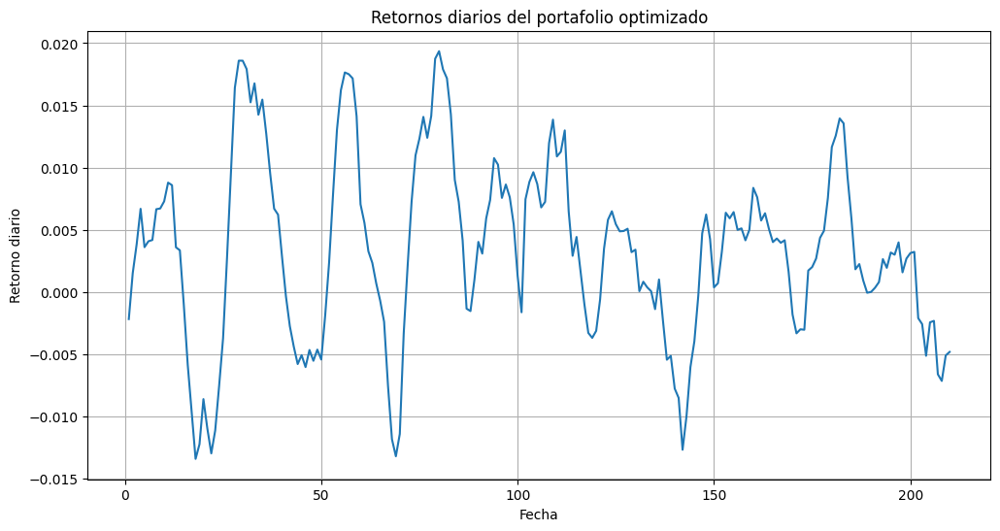

In [ ]:
plt.figure(figsize=(12, 6))
portfolio_daily_returns.plot()
plt.title("Retornos diarios del portafolio optimizado")
plt.xlabel("Fecha")
plt.ylabel("Retorno diario")
plt.grid(True)
plt.show()


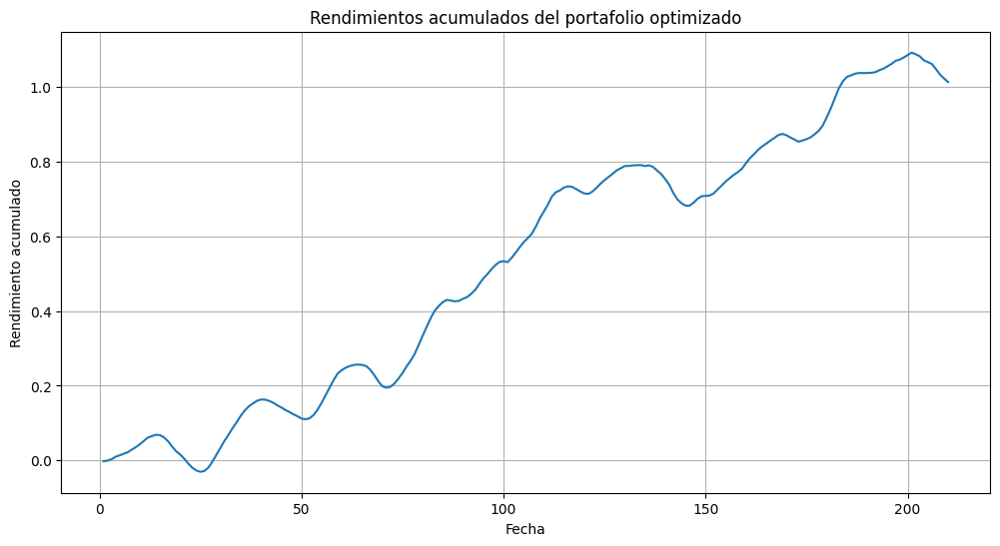

In [ ]:
portfolio_cumulative_returns = (1 + portfolio_daily_returns).cumprod() - 1

plt.figure(figsize=(12, 6))
portfolio_cumulative_returns.plot()
plt.title("Rendimientos acumulados del portafolio optimizado")
plt.xlabel("Fecha")
plt.ylabel("Rendimiento acumulado")
plt.grid(True)
plt.show()

In [ ]:
import yfinance as yf

# Descargar datos históricos de XLK
ticker = "XLK"
start_date = "2023-11-01"
end_date = "2024-07-31"

xlk_data = yf.download(ticker, start=start_date, end=end_date)
xlk_daily_returns = xlk_data['Adj Close'].pct_change()

# Mostrar los primeros datos
print("Retornos diarios de XLK:")
print(xlk_daily_returns.head())


[*********************100%***********************]  1 of 1 completed

Retornos diarios de XLK:
Ticker                          XLK
Date                               
2023-11-01 00:00:00+00:00       NaN
2023-11-02 00:00:00+00:00  0.016928
2023-11-03 00:00:00+00:00  0.010294
2023-11-06 00:00:00+00:00  0.006579
2023-11-07 00:00:00+00:00  0.010932


In [ ]:
print("Tipo de índice del portafolio:", portfolio_daily_returns.index)

Tipo de índice del portafolio: RangeIndex(start=0, stop=211, step=1)


In [ ]:
# Crear un índice de fechas
start_date_portfolio = "2023-11-01"
portfolio_daily_returns.index = pd.date_range(start=start_date_portfolio, periods=len(portfolio_daily_returns), freq="B")  # Días hábiles


In [ ]:
# Convertir el índice de XLK a naive (sin zona horaria)
xlk_daily_returns.index = xlk_daily_returns.index.tz_localize(None)

# Convertir el índice del portafolio a datetime naive
portfolio_daily_returns.index = pd.to_datetime(portfolio_daily_returns.index)  # Asegurarse de que sea datetime

In [ ]:
# Filtrar el portafolio al rango de fechas
portfolio_daily_returns_period = portfolio_daily_returns.loc["2023-11-01":"2024-07-31"]

# Filtrar XLK al rango de fechas (por si acaso)
xlk_daily_returns_period = xlk_daily_returns.loc["2023-11-01":"2024-07-31"]

In [ ]:
# Combinar retornos del portafolio y XLK
comparison_df = pd.concat([portfolio_daily_returns_period, xlk_daily_returns_period], axis=1)
comparison_df.columns = ["Portfolio Returns", "XLK Returns"]
comparison_df = comparison_df.dropna()  # Eliminar filas con valores nulos

# Verificar los datos alineados
print(comparison_df.head())

            Portfolio Returns  XLK Returns
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664


In [ ]:
# Verificar índices después de la normalización
print(f"Índice del portafolio: {portfolio_daily_returns.index}")
print(f"Índice de XLK: {xlk_daily_returns.index}")

# Verificar dimensiones después de filtrar
print(f"Dimensiones del portafolio filtrado: {portfolio_daily_returns_period.shape}")
print(f"Dimensiones de XLK filtrado: {xlk_daily_returns_period.shape}")


Índice del portafolio: DatetimeIndex(['2023-11-01', '2023-11-02', '2023-11-03', '2023-11-06',
               '2023-11-07', '2023-11-08', '2023-11-09', '2023-11-10',
               '2023-11-13', '2023-11-14',
               ...
               '2024-08-08', '2024-08-09', '2024-08-12', '2024-08-13',
               '2024-08-14', '2024-08-15', '2024-08-16', '2024-08-19',
               '2024-08-20', '2024-08-21'],
              dtype='datetime64[ns]', length=211, freq='B')
Índice de XLK: DatetimeIndex(['2023-11-01', '2023-11-02', '2023-11-03', '2023-11-06',
               '2023-11-07', '2023-11-08', '2023-11-09', '2023-11-10',
               '2023-11-13', '2023-11-14',
               ...
               '2024-07-17', '2024-07-18', '2024-07-19', '2024-07-22',
               '2024-07-23', '2024-07-24', '2024-07-25', '2024-07-26',
               '2024-07-29', '2024-07-30'],
              dtype='datetime64[ns]', name='Date', length=186, freq=None)
Dimensiones del portafolio filtrado: (196,)
Dime

In [ ]:
# Reindexar el portafolio para que coincida con XLK
portfolio_daily_returns_aligned = portfolio_daily_returns_period.reindex(xlk_daily_returns.index)

# Combinar los datos
comparison_df = pd.concat([portfolio_daily_returns_aligned, xlk_daily_returns], axis=1)
comparison_df.columns = ["Portfolio Returns", "XLK Returns"]

# Eliminar filas con valores nulos
comparison_df = comparison_df.dropna()

# Verificar los datos alineados
print(comparison_df.head())

            Portfolio Returns  XLK Returns
Date                                      
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664


In [ ]:
print(f"Dimensiones finales: {comparison_df.shape}")

Dimensiones finales: (185, 2)


## Visualización de Resultados
Se grafican las siguientes series para analizar el desempeño:
- **Rendimiento acumulado**:
  - Línea del portafolio optimizado.
  - Líneas de los índices **XLK** y **S&P 500** para comparación.
- **Comparación de métricas**:
  - Tablas que resumen el retorno, volatilidad y Ratio de Sharpe de cada opción.

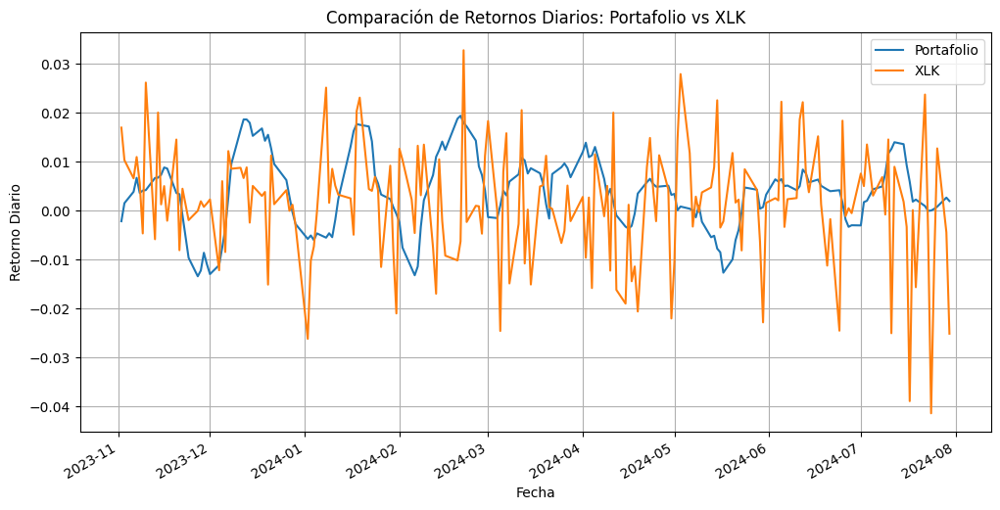

In [ ]:
import matplotlib.pyplot as plt

# Graficar los retornos diarios
comparison_df.plot(figsize=(12, 6))
plt.title("Comparación de Retornos Diarios: Portafolio vs XLK")
plt.xlabel("Fecha")
plt.ylabel("Retorno Diario")
plt.legend(["Portafolio", "XLK"])
plt.grid(True)
plt.show()

In [ ]:
print(comparison_df.head())
print(comparison_df.columns)

            Portfolio Returns  XLK Returns
Date                                      
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664
Index(['Portfolio Returns', 'XLK Returns'], dtype='object')


In [ ]:
# Calcular métricas clave para el portafolio y XLK
risk_free_rate = 0.0045 / 252  # Tasa libre de riesgo anualizada dividida por días hábiles

# Portafolio
portfolio_mean = comparison_df["Portfolio Returns"].mean()
portfolio_std = comparison_df["Portfolio Returns"].std()
portfolio_cumulative = (1 + comparison_df["Portfolio Returns"]).cumprod().iloc[-1] - 1
portfolio_drawdown = (comparison_df["Portfolio Returns"].cumsum() - comparison_df["Portfolio Returns"].cumsum().cummax()).min()
portfolio_sharpe = (portfolio_mean - risk_free_rate) / portfolio_std

# XLK
xlk_mean = comparison_df["XLK Returns"].mean()
xlk_std = comparison_df["XLK Returns"].std()
xlk_cumulative = (1 + comparison_df["XLK Returns"]).cumprod().iloc[-1] - 1
xlk_drawdown = (comparison_df["XLK Returns"].cumsum() - comparison_df["XLK Returns"].cumsum().cummax()).min()
xlk_sharpe = (xlk_mean - risk_free_rate) / xlk_std


In [ ]:
# Crear un DataFrame con las métricas
comparison_metrics = pd.DataFrame({
    "Métrica": ["Rendimiento Promedio Diario", "Volatilidad Diaria", "Rendimiento Acumulado",
                "Máximo Drawdown", "Sharpe Ratio"],
    "Portafolio": [portfolio_mean, portfolio_std, portfolio_cumulative, portfolio_drawdown, portfolio_sharpe],
    "XLK": [xlk_mean, xlk_std, xlk_cumulative, xlk_drawdown, xlk_sharpe]
})

# Mejorar el formato para visualización
comparison_metrics["Portafolio"] = comparison_metrics["Portafolio"].map("{:.4f}".format)
comparison_metrics["XLK"] = comparison_metrics["XLK"].map("{:.4f}".format)

In [ ]:
# Guardar la tabla en el directorio actual
comparison_metrics.to_csv('Tabla_Comparativa_Portafolio_XLK.csv', index=False)

# Mostrar mensaje de éxito
print("La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK.csv'.")

# Descargar el archivo en Google Colab
from google.colab import files
files.download('Tabla_Comparativa_Portafolio_XLK.csv')

La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK.csv'.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## **Comparacion con SP \&500**

[*********************100%***********************]  1 of 1 completed


            Portfolio Returns  SP500 Returns
2023-11-02          -0.002177       0.018859
2023-11-03           0.001512       0.009394
2023-11-06           0.003839       0.001753
2023-11-07           0.006686       0.002840
2023-11-08           0.003603       0.001005
Index(['Portfolio Returns', 'SP500 Returns'], dtype='object')


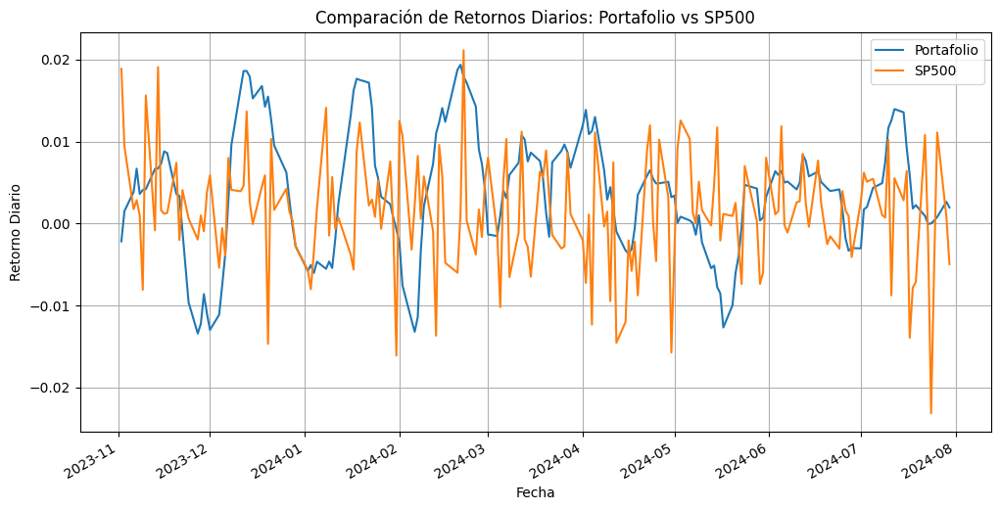

La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK_SP500.csv'.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import yfinance as yf
import pandas as pd
from google.colab import files
import matplotlib.pyplot as plt

# Descargar datos históricos del S&P 500
ticker_sp500 = "^GSPC"
sp500_data = yf.download(ticker_sp500, start="2023-11-01", end="2024-07-31")
sp500_daily_returns = sp500_data['Adj Close'].pct_change()

# Convertir el índice de SP500 a naive (sin zona horaria)
sp500_daily_returns.index = sp500_daily_returns.index.tz_localize(None)

# Alinear fechas del portafolio y SP500 al mismo rango
portfolio_daily_returns.index = pd.date_range(start="2023-11-01", periods=len(portfolio_daily_returns), freq="B")
portfolio_daily_returns_period = portfolio_daily_returns.loc["2023-11-01":"2024-07-31"]

sp500_daily_returns_period = sp500_daily_returns.loc["2023-11-01":"2024-07-31"]

# Combinar datos para comparación
comparison_df = pd.concat([portfolio_daily_returns_period, sp500_daily_returns_period], axis=1)
comparison_df.columns = ["Portfolio Returns", "SP500 Returns"]
comparison_df = comparison_df.dropna()

# Verificar los datos alineados
print(comparison_df.head())
print(comparison_df.columns)

# Graficar los retornos diarios
comparison_df.plot(figsize=(12, 6))
plt.title("Comparación de Retornos Diarios: Portafolio vs SP500")
plt.xlabel("Fecha")
plt.ylabel("Retorno Diario")
plt.legend(["Portafolio", "SP500"])
plt.grid(True)
plt.show()

# Calcular métricas clave para el portafolio y SP500
risk_free_rate = 0.0045 / 252  # Tasa libre de riesgo anualizada dividida por días hábiles

# Portafolio
portfolio_mean = comparison_df["Portfolio Returns"].mean()
portfolio_std = comparison_df["Portfolio Returns"].std()
portfolio_cumulative = (1 + comparison_df["Portfolio Returns"]).cumprod().iloc[-1] - 1
portfolio_drawdown = (comparison_df["Portfolio Returns"].cumsum() - comparison_df["Portfolio Returns"].cumsum().cummax()).min()
portfolio_sharpe = (portfolio_mean - risk_free_rate) / portfolio_std

# SP500
sp500_mean = comparison_df["SP500 Returns"].mean()
sp500_std = comparison_df["SP500 Returns"].std()
sp500_cumulative = (1 + comparison_df["SP500 Returns"]).cumprod().iloc[-1] - 1
sp500_drawdown = (comparison_df["SP500 Returns"].cumsum() - comparison_df["SP500 Returns"].cumsum().cummax()).min()
sp500_sharpe = (sp500_mean - risk_free_rate) / sp500_std

# Actualizar la tabla comparativa
comparison_metrics["SP500"] = [
    f"{sp500_mean:.4f}",
    f"{sp500_std:.4f}",
    f"{sp500_cumulative:.4f}",
    f"{sp500_drawdown:.4f}",
    f"{sp500_sharpe:.4f}"
]

# Guardar la tabla actualizada
comparison_metrics.to_csv('Tabla_Comparativa_Portafolio_XLK_SP500.csv', index=False)

# Descargar el archivo actualizado
print("La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK_SP500.csv'.")
files.download('Tabla_Comparativa_Portafolio_XLK_SP500.csv')
